<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Input" data-toc-modified-id="Input-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Input</a></span></li><li><span><a href="#Network-plot" data-toc-modified-id="Network-plot-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Network plot</a></span></li><li><span><a href="#Effector-to-sensor-path" data-toc-modified-id="Effector-to-sensor-path-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Effector to sensor path</a></span><ul class="toc-item"><li><span><a href="#Go-enrichment-of-paths" data-toc-modified-id="Go-enrichment-of-paths-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Go enrichment of paths</a></span></li></ul></li></ul></div>

In [1]:
%load_ext autoreload
%autoreload 2
from matplotlib.lines import Line2D

import ipycytoscape
import ipywidgets as widgets
import matplotlib.pyplot as plt
import matplotlib as mpl
import networkx as nx
import numpy as np
import pandas as pd
import pickle
import os
import re
import itertools as itr
from enm.visualize.visualize import plot_correlation_density, plot_vector, plot_lambda_collectivity
from enm.enm import Enm

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


/home/oma21/miniconda3/envs/enm/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
from enm.utils import *

In [3]:
%load_ext rpy2.ipython


/home/oma21/miniconda3/envs/enm/lib/python3.7/site-packages/rpy2/robjects/pandas2ri.py:14: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import Index as PandasIndex


# Input

In [4]:
os.chdir('../')

In [5]:

with open(f'data/interim/pcc_0909/pcc.pickle','rb') as f:
    e_pcc = pickle.load(f)



In [6]:
e_pcc.figure_path = 'reports/figures'

In [7]:
gc = e_pcc.graph_gc.copy()
for i , j in gc.nodes(data=True):
    del j['pos']

In [8]:
e_pcc.spring_pos()

In [9]:
pos = e_pcc.graph_gc.nodes('pos')

In [10]:
nx.set_node_attributes(e_pcc.graph_gc, dict(zip(e_pcc.df.orf_name, e_pcc.df['Systematic gene name'])), 'orf_name')

In [11]:
sgd_tab = pd.read_csv('data/raw/ontology/SGD_features.tab','\t',header=None)
sgd_tab_comb = pd.merge(sgd_tab, e_pcc.df, left_on=3, right_on='Systematic gene name')

In [12]:
nx.set_node_attributes(e_pcc.graph_gc, dict(zip(sgd_tab_comb.orf_name, sgd_tab_comb[15])), 'description')

# Network plot

In [13]:
sensors_pcc = e_pcc.df.loc[e_pcc.df.sens>np.quantile(e_pcc.df.sens,0.99)]
sensor_sub_pcc = get_subnetwork(e_pcc.graph_gc, sensors_pcc.orf_name.values)
is_sensor = dict(zip(sensor_sub_pcc.nodes, [True if i in sensors_pcc.orf_name.values else False  for i in sensor_sub_pcc.nodes]))
nx.set_node_attributes(sensor_sub_pcc, is_sensor, 'is_sensor')
sensor_go_terms_separate = [
    'iron ion\ntransport',
    'phenylalanine\ntransport',
    None, 
    None,
    None,
    None,
    'tricarboxylic\nacid cycle', 
    'hexose metabolic\nprocess',
    'protein folding',
    'mitochondria-nucleus\nsignaling pathway/TCA',
    None,
    None,
    None,
    None,
    None,
    None,
    None,
]
sensor_connected_components = sorted([sorted(list(i)) for i in nx.connected_components(nx.induced_subgraph(e_pcc.graph_gc, sensors_pcc.orf_name))], key=lambda x: x[0])
sensor_go_terms= {}
for i in range(len(sensor_go_terms_separate)):
    for j in sensor_connected_components[i]:
        sensor_go_terms[j] = sensor_go_terms_separate[i]

In [14]:
sensors_pcc = sensors_pcc.merge(pd.DataFrame.from_dict(sensor_go_terms,orient='index',columns=['go_group']),right_index=True,left_on='orf_name')

In [15]:
sensors_pcc

,orf_name,deg,eig_0,eig_1,eig_2,eig_3,eig_4,eig_5,eig_6,eig_7,...,Systematic gene name,Allele Gene name,num,cat,bin,group,cat_,neighbor_btw,neighbor_degree,go_group
734,fet3,3,0.002546,0.000522,-0.000066,0.000445,-0.000312,0.037728,-0.000773,0.000572,...,YMR058W,fet3,7947,na.nq,80,nonessential,Nonessential\nquery and array,0.000386,1.333333,iron ion\ntransport
735,aft1,1,-0.001958,-0.005585,0.000031,-0.000325,0.000231,-0.012176,0.000592,-0.000136,...,YGL071W,aft1,4406,nq.nxes,45,nonessential,Nonessential query,0.000772,3.000000,iron ion\ntransport
754,dal81,2,0.002108,0.001594,-0.000104,0.012430,0.007908,-0.000826,0.005730,0.000128,...,YIR023W,dal81,8760,na.nq.nxes,88,nonessential,Nonessential\nquery and array,0.000772,2.000000,phenylalanine\ntransport
755,agp1,1,-0.001621,-0.017052,0.000049,-0.009071,-0.005859,0.000266,-0.004391,-0.000030,...,YCL025C,agp1,8132,na.nq,82,nonessential,Nonessential\nquery and array,0.000386,2.000000,phenylalanine\ntransport
983,ypr039w,2,0.016159,0.000316,0.012675,0.003137,-0.012458,-0.000586,-0.010021,-0.001287,...,YPR039W,ypr039w,4264,na.only,43,nonessential,Nonessential array,0.000386,3.000000,None
984,akr2,1,-0.012427,-0.003384,-0.005991,-0.002289,0.009230,0.000189,0.007680,0.000306,...,YOR034C,akr2,7018,na.nq,71,nonessential,Nonessential\nquery and array,0.000386,2.000000,None
1450,inm1,2,-0.023530,-0.044944,-0.003940,-0.009277,-0.001824,0.000534,-0.004255,0.000686,...,YHR046C,inm1,7791,na.nq,78,nonessential,Nonessential\nquery and array,0.000772,2.000000,None
1451,apt2,2,-0.050196,-0.003872,0.006127,-0.025810,-0.004660,-0.000301,-0.009221,-0.000231,...,YDR441C,apt2,4410,na.only,45,nonessential,Nonessential array,0.000386,1.500000,None
1452,ypl109c,1,0.038604,0.041434,-0.002896,0.018835,0.003453,0.000097,0.007066,0.000055,...,YPL109C,ypl109c,7853,na.nq,79,nonessential,Nonessential\nquery and array,0.000386,2.000000,None
2096,stp1,3,0.000988,0.018496,0.000067,0.004468,0.003094,0.001466,0.002644,-0.000380,...,YDR463W,stp1,4343,na.only,44,nonessential,Nonessential array,0.000900,2.000000,phenylalanine\ntransport


In [16]:
effector_pcc = e_pcc.df.loc[e_pcc.df.eff>np.quantile(e_pcc.df.eff,0.99)]
effector_sub_pcc = get_subnetwork(e_pcc.graph_gc, effector_pcc.orf_name.values)
is_effector = dict(zip(effector_sub_pcc.nodes, [True if i in effector_pcc.orf_name.values else False  for i in effector_sub_pcc.nodes]))
nx.set_node_attributes(effector_sub_pcc, is_effector, 'is_effector')
effectors_connected_comp = sorted([sorted(list(i)) for i in nx.connected_components(nx.induced_subgraph(e_pcc.graph_gc, effector_pcc.orf_name.tolist()))], key=lambda x:x[0])
effector_pcc.loc[:, 'go_group'] = ['mito' if i in effectors_connected_comp[0] else 'golgi' if i in effectors_connected_comp[1] else 'chromatin' for i in effector_pcc.orf_name]

/home/oma21/miniconda3/envs/enm/lib/python3.7/site-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/home/oma21/miniconda3/envs/enm/lib/python3.7/site-packages/pandas/core/indexing.py:1743: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)


# Effector to sensor path

In [20]:
from itertools import permutations, product
a = effector_pcc.orf_name.tolist()
b = sensors_pcc.orf_name.tolist()

product_a_b = [list(product(a,[i])) for i in b]


In [767]:
e_pcc.get_prs(no_diag=True)

@> Calculating covariance matrix
INFO:.prody:Calculating covariance matrix
@> Covariance matrix calculated in 0.0s.
DEBUG:.prody:Covariance matrix calculated in 0.0s.
@> Calculating perturbation response
INFO:.prody:Calculating perturbation response
@> Perturbation response matrix calculated in 0.1s.
DEBUG:.prody:Perturbation response matrix calculated in 0.1s.
@> Perturbation response scanning completed in 1.1s.
DEBUG:.prody:Perturbation response scanning completed in 1.1s.


In [34]:
weighted_shortest_path = [e_pcc.get_prs_weighted_path(source=u[0],target=u[1]) for sublist in product_a_b for u in sublist]


In [41]:
edges = [ ]
all_paths = [ ]
for i in b:
    product_a_b = list(product(a, [i]))
    weighted_shortest_path =  [e_pcc.get_prs_weighted_path(source=u[0],target=u[1]) for u in product_a_b ]#for u in sublist]
    shortest_path =[j for i,j in weighted_shortest_path]# [nx.shortest_path(gc,u[0],u[1]) for u in product_a_b]
    paths = [i for i in shortest_path if len(i) == min([len(i) for i in shortest_path])]
    all_paths.append(paths)
    for r in paths:
        route_edges = [(r[n],r[n+1]) for n in range(len(r)-1)]
        edges.append(route_edges)

In [245]:
maximal_subsets = get_maximal_subsets([ item for sublist in all_paths for item in sublist])

NameError: name 'all_paths' is not defined

In [246]:
all_res_sh = []
commonality_percentage_sh = []
for i in effector_pcc.orf_name:
    for j in sensors_pcc.orf_name:
        source = i#'ctf4'
        target = j#'aft1'
        l1 = e_pcc.get_prs_weighted_path(source,target)[1]
        l2 = nx.shortest_path(e_pcc.graph_gc,source,target)
        #l1.extend(l2)
        res = l1 == l2
        all_res_sh.append(res)
        commonality_percentage_sh.append(sum([i==j for i in l1 for j in l2])/max(len(l1),len(l2)))

Only 7% of the paths are same between prs weighted path and regular shortest path

In [256]:
source = 'met3'
target = 'met10'
l1 = e_pcc.get_prs_weighted_path(source,target)[1]
l2 = nx.shortest_path(e_pcc.graph_gc,source,target)
#l1.extend(l2)
res = l1 == l2

In [255]:
[i for i in l1 if i in effector_pcc.orf_name.tolist()]

['ctf4']

In [257]:
l1

['met3', 'gpm2', 'pau16', 'sps19', 'met10']

In [258]:
l2

['met3', 'asi2', 'pus2', 'met10']

In [247]:
sum(all_res_sh)/len(effector_pcc.orf_name)**2

0.07618343195266272

(array([ 84., 252., 289., 546., 582., 371., 121.,  70., 173., 216.]),
 array([0.14285714, 0.22857143, 0.31428571, 0.4       , 0.48571429,
        0.57142857, 0.65714286, 0.74285714, 0.82857143, 0.91428571,
        1.        ]),
 <BarContainer object of 10 artists>)

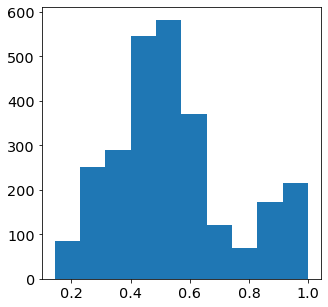

In [248]:
plt.hist(commonality_percentage_sh)

## Go enrichment of paths

In [17]:
goea, geneid2name = create_goea(gaf = 'data/raw/ontology/sgd.gaf', obo_fname='data/raw/ontology/go-basic.obo', background='data/interim/costanzo_gc_bg.tsv', sgd_info_tab = 'data/raw/ontology/SGD_features.tab')

data/raw/ontology/go-basic.obo: fmt(1.2) rel(2019-06-01) 47,444 GO Terms
HMS:0:00:03.787560 119,640 annotations READ: data/raw/ontology/sgd.gaf 

Load BP Gene Ontology Analysis ...
fisher module not installed.  Falling back on scipy.stats.fisher_exact
 84%  3,934 of  4,660 population items found in association

Load CC Gene Ontology Analysis ...
fisher module not installed.  Falling back on scipy.stats.fisher_exact
 89%  4,168 of  4,660 population items found in association

Load MF Gene Ontology Analysis ...
fisher module not installed.  Falling back on scipy.stats.fisher_exact
 73%  3,399 of  4,660 population items found in association


In [18]:

def query_goatools(query, goea,geneid2name):
    query_gene_ids = [key for key,value in geneid2name.items() if value in query.loc[:,'Systematic gene name'].unique()]
    goea_res_all = goea.run_study(query_gene_ids)
    goea_res_sig = [r for r in goea_res_all if r.p_fdr_bh <0.1]
    go_df_sensor = goea_to_pandas(goea_res_sig, geneid2name)
    return go_df_sensor

In [19]:
with open('data/interim/rwr_ranked_goa.pickle','rb') as f:
    rwr_ranked_goa_results = pickle.load(f)
with open('data/interim/prs_ranked_goa.pickle','rb') as f:
    ranked_goa_results = pickle.load(f)

In [360]:
# ranked_goa_results= []
# for i in tqdm(e_pcc.nodes):
#     goa_df = query_goatools(e_pcc.df.loc[e_pcc.df.orf_name.isin(e_pcc.prs_mat_df[i].sort_values(ascending=False)[:50].index)],
#                goea,geneid2name)
#     ranked_goa_results.append(goa_df)


  0%|          | 0/5183 [00:00<?, ?it/s]


Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      62 GO terms are associated with     44 of     49 


  0%|          | 1/5183 [00:03<5:19:03,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 2/5183 [00:07<5:19:48,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 3/5183 [00:11<5:20:28,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 88%     37 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 4/5183 [00:14<5:20:55,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 5/5183 [00:18<5:21:52,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 6/5183 [00:22<5:20:33,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 7/5183 [00:25<5:19:13,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 8/5183 [00:29<5:18:43,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 9/5183 [00:33<5:19:14,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 10/5183 [00:37<5:22:45,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 11/5183 [00:40<5:22:37,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 12/5183 [00:44<5:24:40,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 13/5183 [00:48<5:27:32,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 14/5183 [00:52<5:31:03,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 15/5183 [00:56<5:28:40,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 16/5183 [01:00<5:25:14,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 17/5183 [01:03<5:25:25,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 18/5183 [01:07<5:24:43,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 19/5183 [01:11<5:22:58,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 20/5183 [01:15<5:23:40,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 21/5183 [01:19<5:28:53,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 22/5183 [01:22<5:25:56,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 23/5183 [01:26<5:23:47,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 24/5183 [01:30<5:21:30,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 25/5183 [01:33<5:18:10,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 26/5183 [01:37<5:16:51,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 27/5183 [01:41<5:24:28,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 28/5183 [01:45<5:25:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 29/5183 [01:49<5:25:59,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 30/5183 [01:52<5:22:35,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 31/5183 [01:56<5:23:17,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 32/5183 [02:00<5:20:58,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 33/5183 [02:03<5:20:12,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 34/5183 [02:09<6:10:49,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 35/5183 [02:13<5:54:51,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 36/5183 [02:17<5:45:29,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 37/5183 [02:20<5:38:22,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 38/5183 [02:24<5:33:29,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 39/5183 [02:28<5:36:12,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 40/5183 [02:32<5:32:15,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 82%     33 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 41/5183 [02:36<5:27:47,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 73%     33 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 42/5183 [02:39<5:23:11,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 43/5183 [02:43<5:36:40,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 44/5183 [02:47<5:31:12,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 45/5183 [02:51<5:26:38,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 78%     35 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 46/5183 [02:54<5:21:08,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     29 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 47/5183 [02:58<5:21:27,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 77%     30 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     30 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 48/5183 [03:02<5:25:52,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     22 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 80%     35 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 49/5183 [03:07<5:45:19,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     30 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 50/5183 [03:11<5:59:24,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 51/5183 [03:16<6:00:56,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 52/5183 [03:20<6:00:47,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 53/5183 [03:24<5:56:25,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 54/5183 [03:28<5:56:22,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 55/5183 [03:32<5:55:18,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 56/5183 [03:36<5:51:10,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 57/5183 [03:40<5:49:15,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 58/5183 [03:44<5:53:32,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     30 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 59/5183 [03:49<5:57:31,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 60/5183 [03:53<5:49:38,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      33 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 61/5183 [03:57<5:49:47,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 62/5183 [04:01<5:51:18,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 63/5183 [04:05<5:53:16,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 64/5183 [04:09<5:49:39,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 65/5183 [04:13<5:50:38,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 66/5183 [04:17<5:51:25,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 67/5183 [04:22<5:55:16,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 68/5183 [04:26<6:06:01,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 69/5183 [04:31<6:05:58,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 70/5183 [04:38<7:14:43,  5.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 71/5183 [04:42<6:45:43,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 72/5183 [04:46<6:42:11,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 73/5183 [04:51<6:36:17,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 74/5183 [04:55<6:19:54,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      46 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 75/5183 [04:59<6:12:29,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 76/5183 [05:03<6:09:07,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 77/5183 [05:07<6:07:41,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 78/5183 [05:11<5:58:50,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 79/5183 [05:16<5:58:46,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 80/5183 [05:20<5:58:46,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 81/5183 [05:24<5:54:18,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 82/5183 [05:28<5:49:32,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 83/5183 [05:32<5:52:44,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 84/5183 [05:36<5:49:42,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 85/5183 [05:40<5:54:12,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 86/5183 [05:45<5:57:13,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 87/5183 [05:49<5:54:41,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 88/5183 [05:53<5:55:03,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 89/5183 [05:57<5:56:08,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 90/5183 [06:01<5:56:31,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 91/5183 [06:06<5:56:30,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 92/5183 [06:10<5:58:00,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 93/5183 [06:14<5:58:35,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 94/5183 [06:18<6:00:31,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 95/5183 [06:23<6:03:34,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 96/5183 [06:27<6:05:11,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 97/5183 [06:31<6:03:23,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 98/5183 [06:36<6:10:17,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 99/5183 [06:40<6:11:07,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 100/5183 [06:45<6:15:20,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 101/5183 [06:49<6:16:10,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 102/5183 [06:54<6:15:02,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 103/5183 [06:58<6:18:32,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 104/5183 [07:03<6:19:09,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 105/5183 [07:07<6:20:54,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      35 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 106/5183 [07:12<6:23:07,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      20 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 107/5183 [07:16<6:23:07,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 108/5183 [07:23<7:14:47,  5.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 109/5183 [07:28<7:03:46,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 110/5183 [07:33<6:57:48,  4.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 111/5183 [07:37<6:50:31,  4.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 112/5183 [07:42<6:44:23,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 113/5183 [07:46<6:35:18,  4.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 114/5183 [07:51<6:29:46,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 115/5183 [07:55<6:22:30,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 116/5183 [08:00<6:25:22,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 117/5183 [08:04<6:26:34,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 118/5183 [08:09<6:21:35,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 119/5183 [08:13<6:20:30,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 120/5183 [08:17<6:13:42,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 121/5183 [08:22<6:07:51,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 122/5183 [08:26<6:13:10,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 123/5183 [08:31<6:13:34,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      33 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 124/5183 [08:35<6:12:47,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      35 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 125/5183 [08:39<6:10:10,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 126/5183 [08:44<6:13:44,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 127/5183 [08:48<6:10:28,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 128/5183 [08:53<6:12:56,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 129/5183 [08:57<6:11:02,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 130/5183 [09:01<6:11:32,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 70%     32 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 131/5183 [09:06<6:11:57,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     25 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 132/5183 [09:10<6:05:17,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 133/5183 [09:14<6:02:25,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 134/5183 [09:19<6:01:11,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 135/5183 [09:23<5:56:04,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 136/5183 [09:27<6:06:09,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 137/5183 [09:32<6:04:46,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 138/5183 [09:36<5:59:07,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 139/5183 [09:40<6:03:53,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 140/5183 [09:45<6:08:20,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 81%     34 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 141/5183 [09:49<6:10:00,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 142/5183 [09:53<6:09:05,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 143/5183 [09:58<6:11:25,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 144/5183 [10:04<6:54:52,  4.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 145/5183 [10:08<6:39:41,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 146/5183 [10:13<6:27:51,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 147/5183 [10:17<6:26:07,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 148/5183 [10:22<6:16:03,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 149/5183 [10:26<6:14:40,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 150/5183 [10:30<6:14:27,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 151/5183 [10:35<6:14:13,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 152/5183 [10:39<6:09:14,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 153/5183 [10:44<6:13:46,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 154/5183 [10:48<6:16:35,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 155/5183 [10:53<6:15:22,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 156/5183 [10:57<6:09:47,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 157/5183 [11:02<6:20:10,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 158/5183 [11:06<6:17:48,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 159/5183 [11:11<6:14:55,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 160/5183 [11:15<6:11:20,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 161/5183 [11:19<6:11:19,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 162/5183 [11:24<6:06:34,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 163/5183 [11:28<6:06:52,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 164/5183 [11:32<6:06:07,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 165/5183 [11:37<6:01:49,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 166/5183 [11:41<6:07:57,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 167/5183 [11:46<6:10:16,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 168/5183 [11:51<6:26:39,  4.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 169/5183 [11:56<6:44:03,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 170/5183 [12:01<6:43:46,  4.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 171/5183 [12:06<6:45:01,  4.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 172/5183 [12:11<6:40:52,  4.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 173/5183 [12:15<6:43:36,  4.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 174/5183 [12:20<6:45:39,  4.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 175/5183 [12:25<6:36:14,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 176/5183 [12:30<6:33:44,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 177/5183 [12:34<6:31:56,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 178/5183 [12:39<6:32:24,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 179/5183 [12:44<6:34:35,  4.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 180/5183 [12:49<6:37:16,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 181/5183 [12:53<6:35:07,  4.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 31 IDs ...100%     31 of     31 study items found in association
100%     31 of     31 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     31 of     31 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 182/5183 [13:00<7:22:17,  5.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     29 of     31 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 183/5183 [13:05<7:06:49,  5.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 184/5183 [13:09<6:58:33,  5.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 185/5183 [13:14<6:50:32,  4.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 186/5183 [13:19<6:47:21,  4.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 187/5183 [13:23<6:41:11,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 188/5183 [13:28<6:39:27,  4.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 189/5183 [13:33<6:37:08,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 190/5183 [13:38<6:35:47,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 191/5183 [13:43<6:46:16,  4.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 192/5183 [13:47<6:40:51,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 193/5183 [13:52<6:39:24,  4.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 194/5183 [13:57<6:42:48,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 195/5183 [14:02<6:40:36,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 196/5183 [14:07<6:42:27,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 197/5183 [14:12<6:49:14,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 80%     35 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 198/5183 [14:17<6:53:50,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     25 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 199/5183 [14:22<6:57:59,  5.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 200/5183 [14:27<6:51:40,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 201/5183 [14:32<6:46:54,  4.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 202/5183 [14:37<6:48:47,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 203/5183 [14:41<6:41:01,  4.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 204/5183 [14:46<6:44:45,  4.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 205/5183 [14:51<6:40:16,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 206/5183 [14:56<6:47:06,  4.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 207/5183 [15:01<6:46:02,  4.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 208/5183 [15:05<6:34:16,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 209/5183 [15:10<6:24:15,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 210/5183 [15:14<6:19:46,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 211/5183 [15:18<6:06:55,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 212/5183 [15:23<6:02:11,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 213/5183 [15:26<5:50:30,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 214/5183 [15:31<5:45:30,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 215/5183 [15:35<5:40:47,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 216/5183 [15:38<5:32:14,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 217/5183 [15:42<5:31:20,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 218/5183 [15:48<6:15:24,  4.54s/it]


Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      54 GO terms are associated with     39 of     49 


  4%|▍         | 219/5183 [15:52<5:58:42,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 220/5183 [15:56<5:44:46,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 221/5183 [16:00<5:41:04,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 222/5183 [16:04<5:41:26,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 223/5183 [16:08<5:44:45,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 224/5183 [16:12<5:47:47,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 225/5183 [16:16<5:39:28,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 226/5183 [16:20<5:36:14,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 227/5183 [16:24<5:30:35,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 228/5183 [16:28<5:32:33,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 229/5183 [16:32<5:33:23,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 230/5183 [16:37<5:38:39,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 231/5183 [16:41<5:39:48,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 232/5183 [16:45<5:44:48,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 233/5183 [16:49<5:34:38,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 234/5183 [16:53<5:28:52,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 235/5183 [16:56<5:23:47,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 236/5183 [17:00<5:16:18,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 237/5183 [17:04<5:20:03,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 238/5183 [17:08<5:19:49,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 239/5183 [17:12<5:24:11,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 240/5183 [17:16<5:29:51,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 241/5183 [17:20<5:32:19,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 242/5183 [17:24<5:34:08,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 243/5183 [17:28<5:33:29,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 244/5183 [17:32<5:29:30,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 245/5183 [17:36<5:31:04,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 246/5183 [17:40<5:30:53,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 247/5183 [17:44<5:31:54,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 248/5183 [17:48<5:29:26,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 249/5183 [17:53<5:36:03,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 250/5183 [17:56<5:29:49,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 251/5183 [18:00<5:26:41,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 252/5183 [18:04<5:21:23,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 253/5183 [18:08<5:25:25,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 254/5183 [18:12<5:20:39,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 255/5183 [18:16<5:17:20,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 256/5183 [18:21<6:00:26,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 257/5183 [18:25<5:47:49,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 258/5183 [18:29<5:40:49,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 259/5183 [18:33<5:34:03,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 260/5183 [18:37<5:33:42,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 261/5183 [18:41<5:33:46,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 262/5183 [18:45<5:26:55,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 263/5183 [18:49<5:26:03,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 264/5183 [18:53<5:20:19,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 265/5183 [18:57<5:22:30,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 266/5183 [19:01<5:23:05,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 267/5183 [19:05<5:22:46,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 268/5183 [19:09<5:27:56,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 269/5183 [19:13<5:37:58,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     31 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 270/5183 [19:17<5:38:40,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 271/5183 [19:22<5:46:00,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 272/5183 [19:26<5:48:00,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 273/5183 [19:30<5:45:19,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 274/5183 [19:34<5:40:29,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 275/5183 [19:39<5:46:11,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 276/5183 [19:43<5:43:51,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 277/5183 [19:47<5:35:45,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 278/5183 [19:51<5:32:57,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 279/5183 [19:55<5:36:33,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 280/5183 [19:59<5:31:52,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 281/5183 [20:03<5:29:58,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 282/5183 [20:07<5:27:38,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 283/5183 [20:11<5:23:45,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 284/5183 [20:15<5:28:28,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 285/5183 [20:19<5:25:58,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 286/5183 [20:23<5:31:58,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 287/5183 [20:27<5:29:03,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 288/5183 [20:31<5:24:54,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 289/5183 [20:35<5:28:14,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 290/5183 [20:39<5:28:43,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 291/5183 [20:43<5:29:00,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 292/5183 [20:47<5:29:16,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 65%     31 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 293/5183 [20:51<5:28:16,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     24 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 294/5183 [20:57<6:23:58,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 295/5183 [21:01<6:11:54,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 296/5183 [21:06<6:12:23,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 297/5183 [21:10<5:57:41,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 298/5183 [21:14<5:44:32,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 299/5183 [21:18<5:33:47,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 300/5183 [21:22<5:28:34,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 301/5183 [21:26<5:28:38,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 302/5183 [21:30<5:25:05,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 303/5183 [21:33<5:21:01,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 304/5183 [21:38<5:30:40,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 305/5183 [21:42<5:26:36,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 306/5183 [21:45<5:23:28,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 307/5183 [21:50<5:29:34,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 308/5183 [21:54<5:25:54,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 309/5183 [21:58<5:28:25,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 310/5183 [22:02<5:28:49,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 311/5183 [22:06<5:28:11,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 312/5183 [22:10<5:32:13,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 313/5183 [22:14<5:27:30,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 314/5183 [22:18<5:34:36,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 315/5183 [22:22<5:29:17,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 316/5183 [22:26<5:24:46,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 317/5183 [22:30<5:23:00,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 318/5183 [22:34<5:27:22,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 319/5183 [22:38<5:24:22,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 320/5183 [22:42<5:23:53,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 321/5183 [22:46<5:21:27,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 322/5183 [22:50<5:17:09,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 323/5183 [22:54<5:14:46,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 324/5183 [22:58<5:17:16,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 325/5183 [23:01<5:16:40,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 326/5183 [23:05<5:18:35,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 327/5183 [23:09<5:16:42,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 328/5183 [23:13<5:19:14,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 329/5183 [23:17<5:20:36,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      35 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 330/5183 [23:22<5:36:26,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      23 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 331/5183 [23:28<6:26:20,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 332/5183 [23:32<6:03:50,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 333/5183 [23:36<5:49:56,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 334/5183 [23:40<5:41:47,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 335/5183 [23:44<5:35:37,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 81%     35 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 336/5183 [23:48<5:32:45,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     26 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 337/5183 [23:52<5:27:49,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     25 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 338/5183 [23:57<5:48:56,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 339/5183 [24:01<5:42:25,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 340/5183 [24:05<5:30:00,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 341/5183 [24:09<5:25:56,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 342/5183 [24:12<5:18:10,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 343/5183 [24:16<5:13:57,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 344/5183 [24:20<5:11:16,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 345/5183 [24:24<5:14:02,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 346/5183 [24:28<5:16:02,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 347/5183 [24:32<5:20:57,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 348/5183 [24:36<5:25:27,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 72%     29 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     29 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 349/5183 [24:40<5:24:29,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     25 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 82%     31 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 350/5183 [24:44<5:23:34,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     23 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 87%     34 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 351/5183 [24:48<5:20:51,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     24 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 84%     32 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 352/5183 [24:52<5:30:17,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     24 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 353/5183 [24:56<5:30:13,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 354/5183 [25:01<5:30:47,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 355/5183 [25:05<5:31:00,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 62%     30 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 356/5183 [25:09<5:39:14,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     22 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 86%     36 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 357/5183 [25:13<5:40:40,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 358/5183 [25:17<5:30:20,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 359/5183 [25:21<5:27:36,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 360/5183 [25:25<5:27:11,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 361/5183 [25:29<5:26:41,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 362/5183 [25:34<5:37:00,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 363/5183 [25:38<5:43:09,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 364/5183 [25:43<5:49:14,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 365/5183 [25:48<6:01:19,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 366/5183 [25:52<6:08:17,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 367/5183 [25:57<6:10:58,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 368/5183 [26:02<6:18:22,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 369/5183 [26:09<7:08:34,  5.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 80%     37 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 370/5183 [26:14<6:59:42,  5.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 371/5183 [26:19<6:47:13,  5.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 372/5183 [26:23<6:37:49,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 373/5183 [26:28<6:34:25,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 374/5183 [26:33<6:30:18,  4.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 375/5183 [26:38<6:28:09,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 376/5183 [26:43<6:37:33,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 377/5183 [26:48<6:35:23,  4.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 378/5183 [26:53<6:36:57,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 379/5183 [26:58<6:34:04,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 380/5183 [27:02<6:32:12,  4.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 381/5183 [27:07<6:26:26,  4.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 382/5183 [27:12<6:35:53,  4.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 383/5183 [27:17<6:33:59,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 384/5183 [27:22<6:31:39,  4.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 385/5183 [27:27<6:34:14,  4.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 386/5183 [27:32<6:34:23,  4.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 387/5183 [27:37<6:30:27,  4.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 27 IDs ...100%     27 of     27 study items found in association
100%     27 of     27 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     27 of     27 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 388/5183 [27:42<6:32:46,  4.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     25 of     27 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 389/5183 [27:47<6:34:33,  4.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 390/5183 [27:51<6:25:36,  4.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     27 of     30 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 391/5183 [27:56<6:21:15,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     26 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 27 IDs ... 96%     26 of     27 study items found in association
100%     27 of     27 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     26 of     27 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 392/5183 [28:01<6:20:56,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     23 of     27 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 393/5183 [28:06<6:23:38,  4.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     32 of     35 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 394/5183 [28:11<6:28:51,  4.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 395/5183 [28:15<6:24:17,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 396/5183 [28:20<6:22:22,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 397/5183 [28:25<6:29:40,  4.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 398/5183 [28:29<6:07:06,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     27 of     30 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 399/5183 [28:33<5:56:09,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 400/5183 [28:38<5:55:42,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ...100%     33 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     33 of     33 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 401/5183 [28:42<5:54:06,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     29 of     33 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 402/5183 [28:47<5:54:39,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     27 of     30 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 403/5183 [28:51<5:52:41,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     32 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 404/5183 [28:55<5:53:48,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 405/5183 [29:00<5:46:03,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 27 IDs ...100%     27 of     27 study items found in association
100%     27 of     27 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     27 of     27 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 406/5183 [29:04<5:39:05,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     26 of     27 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 407/5183 [29:10<6:26:00,  4.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 31 IDs ...100%     31 of     31 study items found in association
100%     31 of     31 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     31 of     31 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 408/5183 [29:14<6:12:41,  4.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     29 of     31 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 32 IDs ...100%     32 of     32 study items found in association
100%     32 of     32 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     32 of     32 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 409/5183 [29:19<6:06:24,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     30 of     32 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 410/5183 [29:23<5:53:14,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 411/5183 [29:27<5:45:26,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 94%     32 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     32 of     34 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 412/5183 [29:31<5:43:05,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     28 of     34 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 413/5183 [29:35<5:43:56,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 90%     37 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 414/5183 [29:40<5:43:29,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 415/5183 [29:44<5:50:11,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 27 IDs ...100%     27 of     27 study items found in association
100%     27 of     27 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     27 of     27 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 416/5183 [29:49<5:50:18,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     26 of     27 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 417/5183 [29:53<5:49:23,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 418/5183 [29:57<5:44:54,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 419/5183 [30:01<5:39:30,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 420/5183 [30:06<5:41:53,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 421/5183 [30:10<5:41:25,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 422/5183 [30:14<5:39:31,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 423/5183 [30:19<5:39:24,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ...100%     34 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     34 of     34 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 424/5183 [30:23<5:35:06,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     30 of     34 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 31 IDs ...100%     31 of     31 study items found in association
100%     31 of     31 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     31 of     31 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 425/5183 [30:27<5:35:00,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     29 of     31 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 426/5183 [30:31<5:36:49,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 427/5183 [30:36<5:46:33,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 428/5183 [30:40<5:47:42,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 429/5183 [30:45<5:50:20,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 430/5183 [30:49<5:44:45,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 431/5183 [30:53<5:39:37,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     32 of     37 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 432/5183 [30:57<5:40:38,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 433/5183 [31:02<5:38:59,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 434/5183 [31:06<5:37:38,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 27 IDs ...100%     27 of     27 study items found in association
100%     27 of     27 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     27 of     27 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 435/5183 [31:10<5:36:08,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     26 of     27 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 436/5183 [31:15<5:42:17,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     29 of     30 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 437/5183 [31:19<5:42:39,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 438/5183 [31:23<5:44:12,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 97%     33 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     33 of     34 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 439/5183 [31:28<5:41:56,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 440/5183 [31:32<5:46:18,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 441/5183 [31:36<5:44:12,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 442/5183 [31:40<5:37:06,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ...100%     33 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     33 of     33 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 443/5183 [31:45<5:34:00,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     29 of     33 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 31 IDs ...100%     31 of     31 study items found in association
100%     31 of     31 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     31 of     31 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 444/5183 [31:51<6:20:43,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     31 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 445/5183 [31:55<6:07:00,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 446/5183 [31:59<5:58:09,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 447/5183 [32:04<5:52:24,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 448/5183 [32:08<5:56:06,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 449/5183 [32:13<5:51:27,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ...100%     34 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     34 of     34 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 450/5183 [32:17<5:49:37,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     30 of     34 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 451/5183 [32:21<5:49:52,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 452/5183 [32:26<5:54:36,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 86%     36 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 453/5183 [32:30<5:51:31,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 454/5183 [32:35<5:54:14,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 455/5183 [32:39<5:50:20,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 456/5183 [32:44<5:47:30,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     29 of     30 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      46 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 457/5183 [32:48<5:53:08,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 458/5183 [32:53<5:56:03,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 459/5183 [32:58<6:03:42,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 460/5183 [33:02<6:01:11,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 461/5183 [33:07<6:00:05,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 462/5183 [33:11<5:55:16,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 463/5183 [33:16<5:57:59,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 464/5183 [33:20<5:54:53,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 88%     37 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 465/5183 [33:25<5:54:13,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 466/5183 [33:29<5:51:48,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 467/5183 [33:34<5:56:56,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 468/5183 [33:38<5:55:10,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 469/5183 [33:43<5:56:59,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 470/5183 [33:47<5:55:12,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 471/5183 [33:52<5:48:47,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 472/5183 [33:56<5:51:03,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 86%     36 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 473/5183 [34:01<6:08:01,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 474/5183 [34:06<6:10:28,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 80%     35 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 475/5183 [34:11<6:24:56,  4.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     29 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 476/5183 [34:16<6:26:30,  4.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     29 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 477/5183 [34:22<6:30:23,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 478/5183 [34:27<6:33:31,  5.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 479/5183 [34:32<6:36:35,  5.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 480/5183 [34:37<6:35:42,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 481/5183 [34:43<6:52:07,  5.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 482/5183 [34:50<7:35:30,  5.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 483/5183 [34:55<7:12:31,  5.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 484/5183 [35:00<7:02:17,  5.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 485/5183 [35:05<6:57:51,  5.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 486/5183 [35:10<6:55:38,  5.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 487/5183 [35:15<6:49:10,  5.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 488/5183 [35:21<6:52:37,  5.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 489/5183 [35:26<6:46:03,  5.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 490/5183 [35:31<6:49:38,  5.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 491/5183 [35:36<6:51:22,  5.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 492/5183 [35:41<6:47:48,  5.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 493/5183 [35:46<6:44:09,  5.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     21 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 494/5183 [35:52<6:45:39,  5.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 495/5183 [35:57<6:41:20,  5.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 496/5183 [36:02<6:36:05,  5.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 497/5183 [36:07<6:40:07,  5.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 498/5183 [36:12<6:41:59,  5.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 73%     32 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 499/5183 [36:17<6:40:42,  5.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 500/5183 [36:22<6:47:04,  5.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 501/5183 [36:28<6:45:25,  5.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 502/5183 [36:33<6:42:35,  5.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 503/5183 [36:38<6:42:27,  5.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 80%     36 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 504/5183 [36:43<6:48:27,  5.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 505/5183 [36:49<6:53:51,  5.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 506/5183 [36:54<6:51:52,  5.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 507/5183 [36:59<6:41:38,  5.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      41 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 508/5183 [37:03<6:09:38,  4.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 509/5183 [37:06<5:45:40,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 510/5183 [37:10<5:29:12,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 511/5183 [37:14<5:19:08,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 512/5183 [37:18<5:12:40,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 513/5183 [37:21<5:05:24,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 514/5183 [37:25<5:02:29,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      37 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 515/5183 [37:29<5:01:34,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      31 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 516/5183 [37:33<5:02:04,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 517/5183 [37:37<4:57:43,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 518/5183 [37:40<4:54:25,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 519/5183 [37:44<4:53:50,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 520/5183 [37:50<5:35:42,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 521/5183 [37:53<5:23:14,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 522/5183 [37:57<5:15:12,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 523/5183 [38:01<5:10:13,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 524/5183 [38:05<5:06:58,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 525/5183 [38:09<5:04:34,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 526/5183 [38:13<4:59:15,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 527/5183 [38:17<5:01:25,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 528/5183 [38:20<5:00:12,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 529/5183 [38:24<5:00:17,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 530/5183 [38:28<4:57:02,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 531/5183 [38:32<4:55:18,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 532/5183 [38:36<4:55:37,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 533/5183 [38:39<4:56:16,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 534/5183 [38:43<4:54:50,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 535/5183 [38:47<4:52:29,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 536/5183 [38:51<4:52:11,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 537/5183 [38:54<4:53:34,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 538/5183 [38:58<4:52:38,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 539/5183 [39:02<4:51:59,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 540/5183 [39:06<4:52:25,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 541/5183 [39:10<4:52:40,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 542/5183 [39:13<4:52:28,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 543/5183 [39:17<4:51:28,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 544/5183 [39:21<4:49:46,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 545/5183 [39:25<4:50:07,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 546/5183 [39:28<4:52:51,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 547/5183 [39:32<4:52:29,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 548/5183 [39:36<4:51:08,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 549/5183 [39:40<4:51:07,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 550/5183 [39:44<5:00:07,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 551/5183 [39:48<4:57:29,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 552/5183 [39:51<4:54:30,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 553/5183 [39:55<4:51:32,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 554/5183 [39:59<4:51:49,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 555/5183 [40:03<4:53:07,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 556/5183 [40:07<4:56:46,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 557/5183 [40:10<4:55:09,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 558/5183 [40:16<5:33:45,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 559/5183 [40:20<5:22:59,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 560/5183 [40:24<5:15:03,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 561/5183 [40:27<5:05:58,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 562/5183 [40:31<4:59:12,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 563/5183 [40:35<4:58:28,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 564/5183 [40:39<4:58:42,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 565/5183 [40:43<4:56:46,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 566/5183 [40:46<4:53:10,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 567/5183 [40:50<4:52:58,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 568/5183 [40:54<4:54:19,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 569/5183 [40:58<4:53:27,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 570/5183 [41:01<4:51:08,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 571/5183 [41:05<4:48:08,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 572/5183 [41:09<4:49:14,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 573/5183 [41:13<4:51:29,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 574/5183 [41:16<4:48:46,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 575/5183 [41:20<4:46:45,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 576/5183 [41:24<4:46:56,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 577/5183 [41:28<4:49:50,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 578/5183 [41:32<4:51:53,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 579/5183 [41:35<4:50:17,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 580/5183 [41:39<4:49:22,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 581/5183 [41:43<4:50:05,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 67%     30 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     30 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 582/5183 [41:47<4:49:15,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     24 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 583/5183 [41:50<4:49:14,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 584/5183 [41:54<4:48:08,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 585/5183 [41:58<4:48:42,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 586/5183 [42:02<4:53:11,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 587/5183 [42:06<4:51:30,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 588/5183 [42:09<4:48:08,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 589/5183 [42:13<4:46:16,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 590/5183 [42:17<4:46:33,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 591/5183 [42:21<4:48:16,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 592/5183 [42:24<4:47:09,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 593/5183 [42:28<4:45:34,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 594/5183 [42:32<4:53:05,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 595/5183 [42:38<5:32:48,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 596/5183 [42:41<5:18:45,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 597/5183 [42:45<5:07:40,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 598/5183 [42:49<5:01:47,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 599/5183 [42:53<4:58:05,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 600/5183 [42:56<4:55:53,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 601/5183 [43:00<4:55:25,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 602/5183 [43:04<4:51:58,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 603/5183 [43:08<4:51:47,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 604/5183 [43:12<4:53:33,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 605/5183 [43:16<4:53:30,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 606/5183 [43:19<4:48:59,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 607/5183 [43:23<4:48:01,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 608/5183 [43:27<4:47:18,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 609/5183 [43:31<4:51:04,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 610/5183 [43:34<4:52:04,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 611/5183 [43:38<4:49:02,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 612/5183 [43:42<4:48:51,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 613/5183 [43:46<4:48:55,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 614/5183 [43:49<4:45:56,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 615/5183 [43:53<4:44:27,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 616/5183 [43:57<4:47:05,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 617/5183 [44:01<4:46:31,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 618/5183 [44:05<4:47:27,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 619/5183 [44:08<4:44:16,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 620/5183 [44:12<4:42:52,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 621/5183 [44:16<4:46:45,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 622/5183 [44:20<4:49:51,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 623/5183 [44:24<4:55:08,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 624/5183 [44:28<4:52:53,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 625/5183 [44:31<4:52:06,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 626/5183 [44:35<4:49:34,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 627/5183 [44:39<4:47:42,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 628/5183 [44:43<4:49:05,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 629/5183 [44:46<4:47:54,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 630/5183 [44:50<4:45:55,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 631/5183 [44:54<4:44:46,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 632/5183 [44:58<4:43:48,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 633/5183 [45:01<4:45:21,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 634/5183 [45:07<5:26:58,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 635/5183 [45:11<5:20:12,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 636/5183 [45:15<5:16:54,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 637/5183 [45:19<5:09:59,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 638/5183 [45:23<5:02:19,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 639/5183 [45:26<4:56:47,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 640/5183 [45:30<4:59:35,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 641/5183 [45:34<4:53:13,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 642/5183 [45:38<4:51:32,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 643/5183 [45:42<4:47:35,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 644/5183 [45:46<4:53:25,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 645/5183 [45:50<4:51:34,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 646/5183 [45:53<4:49:52,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 647/5183 [45:57<4:47:26,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 648/5183 [46:01<4:47:11,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 649/5183 [46:05<4:49:22,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 650/5183 [46:09<4:50:45,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 651/5183 [46:12<4:47:38,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      43 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 652/5183 [46:16<4:46:20,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 653/5183 [46:20<4:51:16,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      41 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 654/5183 [46:24<4:50:51,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      39 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 655/5183 [46:28<4:49:39,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      37 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 656/5183 [46:32<4:48:29,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      36 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 657/5183 [46:35<4:48:03,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 658/5183 [46:39<4:44:14,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 659/5183 [46:44<5:05:01,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 660/5183 [46:48<5:13:19,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 661/5183 [46:52<5:08:34,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 662/5183 [46:56<5:13:28,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 663/5183 [47:01<5:17:26,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 664/5183 [47:05<5:17:13,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 665/5183 [47:09<5:16:26,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 666/5183 [47:13<5:15:16,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 667/5183 [47:17<5:11:06,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 668/5183 [47:21<5:07:20,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 669/5183 [47:25<5:05:51,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 670/5183 [47:29<5:10:01,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 671/5183 [47:36<5:53:52,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 672/5183 [47:40<5:41:44,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 673/5183 [47:44<5:31:10,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 674/5183 [47:48<5:27:26,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 675/5183 [47:52<5:22:30,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 676/5183 [47:56<5:17:27,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 677/5183 [48:00<5:15:52,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 678/5183 [48:04<5:12:36,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 679/5183 [48:09<5:15:59,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 680/5183 [48:13<5:15:33,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 681/5183 [48:17<5:18:30,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 682/5183 [48:22<5:17:06,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 683/5183 [48:26<5:14:31,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 684/5183 [48:30<5:12:25,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 685/5183 [48:34<5:14:27,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 686/5183 [48:38<5:15:12,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 687/5183 [48:42<5:13:11,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 688/5183 [48:46<5:08:01,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 689/5183 [48:50<5:02:51,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 690/5183 [48:54<5:04:04,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 691/5183 [48:59<5:16:40,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 692/5183 [49:03<5:14:52,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 693/5183 [49:07<5:07:45,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 694/5183 [49:11<5:12:06,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 695/5183 [49:16<5:22:05,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 696/5183 [49:20<5:11:08,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 697/5183 [49:24<5:17:07,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 698/5183 [49:28<5:16:03,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 699/5183 [49:33<5:18:54,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 700/5183 [49:37<5:17:37,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 701/5183 [49:41<5:19:50,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     20 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 702/5183 [49:45<5:17:44,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 703/5183 [49:50<5:19:12,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 704/5183 [49:54<5:20:09,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 705/5183 [49:59<5:22:56,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 706/5183 [50:03<5:24:29,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 707/5183 [50:07<5:25:05,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 70%     33 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 708/5183 [50:12<5:23:42,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 59%     29 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 709/5183 [50:16<5:25:09,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 710/5183 [50:22<6:09:57,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 711/5183 [50:27<5:56:48,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 712/5183 [50:31<5:46:13,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 713/5183 [50:35<5:39:00,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 714/5183 [50:40<5:33:38,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 715/5183 [50:44<5:31:41,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 716/5183 [50:49<5:31:37,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 717/5183 [50:53<5:35:45,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 718/5183 [50:58<5:33:38,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 719/5183 [51:02<5:30:20,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 720/5183 [51:06<5:30:08,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 721/5183 [51:11<5:28:16,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 722/5183 [51:15<5:28:17,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 723/5183 [51:20<5:27:16,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 724/5183 [51:24<5:28:26,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 725/5183 [51:29<5:32:47,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 726/5183 [51:33<5:29:03,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 727/5183 [51:37<5:30:52,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 728/5183 [51:42<5:30:26,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 729/5183 [51:46<5:26:42,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 68%     32 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 730/5183 [51:51<5:26:44,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     25 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 731/5183 [51:55<5:25:30,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 732/5183 [51:59<5:21:59,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 733/5183 [52:04<5:23:58,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 734/5183 [52:08<5:22:31,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 735/5183 [52:12<5:18:38,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 736/5183 [52:17<5:24:34,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 74%     34 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 737/5183 [52:21<5:28:39,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     27 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 738/5183 [52:25<5:24:14,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 739/5183 [52:30<5:21:45,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 740/5183 [52:34<5:20:00,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 741/5183 [52:38<5:18:51,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 742/5183 [52:43<5:21:39,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 743/5183 [52:47<5:16:44,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 744/5183 [52:51<5:12:55,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 745/5183 [52:55<5:12:04,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 746/5183 [52:59<5:11:55,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 747/5183 [53:04<5:11:55,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 748/5183 [53:10<5:53:51,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 749/5183 [53:14<5:51:07,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 750/5183 [53:19<5:43:06,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 751/5183 [53:23<5:40:48,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 752/5183 [53:28<5:35:25,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     26 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 753/5183 [53:32<5:33:53,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 754/5183 [53:37<5:32:51,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     27 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 755/5183 [53:41<5:27:45,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 756/5183 [53:45<5:24:37,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 757/5183 [53:50<5:23:35,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 758/5183 [53:54<5:22:42,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 759/5183 [53:58<5:16:34,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 760/5183 [54:03<5:23:16,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 761/5183 [54:07<5:24:53,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 762/5183 [54:12<5:25:39,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 763/5183 [54:16<5:19:51,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 68%     32 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 764/5183 [54:20<5:18:15,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     25 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 765/5183 [54:24<5:19:24,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     25 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 766/5183 [54:29<5:17:03,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 767/5183 [54:33<5:17:49,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 768/5183 [54:37<5:16:19,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 769/5183 [54:42<5:18:49,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 770/5183 [54:46<5:23:11,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 771/5183 [54:50<5:15:10,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 772/5183 [54:55<5:19:24,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 773/5183 [54:59<5:20:10,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 774/5183 [55:03<5:17:04,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 775/5183 [55:07<5:12:11,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 776/5183 [55:12<5:15:54,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 777/5183 [55:17<5:37:15,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 778/5183 [55:22<5:49:02,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 779/5183 [55:28<6:07:29,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 780/5183 [55:33<6:18:25,  5.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 781/5183 [55:39<6:24:51,  5.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 782/5183 [55:44<6:34:24,  5.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 783/5183 [55:50<6:33:26,  5.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 784/5183 [55:55<6:36:11,  5.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 785/5183 [56:03<7:24:12,  6.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 786/5183 [56:08<7:11:42,  5.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 787/5183 [56:14<6:59:08,  5.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 788/5183 [56:19<6:44:24,  5.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 789/5183 [56:24<6:39:20,  5.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 790/5183 [56:29<6:39:13,  5.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 791/5183 [56:35<6:41:58,  5.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 792/5183 [56:40<6:30:42,  5.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 793/5183 [56:45<6:23:29,  5.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 794/5183 [56:50<6:11:00,  5.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 795/5183 [56:55<6:15:04,  5.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 796/5183 [57:00<6:18:50,  5.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 797/5183 [57:06<6:25:58,  5.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 798/5183 [57:11<6:27:50,  5.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      51 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 799/5183 [57:16<6:28:37,  5.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 800/5183 [57:22<6:25:19,  5.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 801/5183 [57:27<6:19:33,  5.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 802/5183 [57:32<6:25:47,  5.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 803/5183 [57:37<6:24:28,  5.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 804/5183 [57:42<6:20:46,  5.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 805/5183 [57:48<6:22:42,  5.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 806/5183 [57:53<6:26:56,  5.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 807/5183 [57:58<6:22:17,  5.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 808/5183 [58:04<6:23:08,  5.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 809/5183 [58:09<6:28:22,  5.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 810/5183 [58:15<6:30:20,  5.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 811/5183 [58:20<6:36:42,  5.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 812/5183 [58:25<6:27:55,  5.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 813/5183 [58:29<6:00:24,  4.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 814/5183 [58:33<5:34:40,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 815/5183 [58:37<5:18:14,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 816/5183 [58:41<5:05:34,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      29 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 817/5183 [58:45<4:58:46,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 818/5183 [58:49<4:56:42,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 819/5183 [58:53<4:53:11,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 820/5183 [58:57<4:52:10,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 71%     32 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 821/5183 [59:00<4:50:20,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     24 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 822/5183 [59:06<5:25:54,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 823/5183 [59:10<5:17:19,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 824/5183 [59:14<5:10:24,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 825/5183 [59:18<5:04:23,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 56%     28 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 826/5183 [59:22<4:58:10,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 89%     34 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 827/5183 [59:26<4:56:32,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 828/5183 [59:30<4:51:34,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 829/5183 [59:34<4:48:37,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 830/5183 [59:38<4:44:31,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 831/5183 [59:42<4:44:38,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 832/5183 [59:46<4:44:49,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 833/5183 [59:49<4:42:07,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 834/5183 [59:53<4:41:11,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 835/5183 [59:57<4:39:59,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 836/5183 [1:00:01<4:51:00,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 837/5183 [1:00:06<4:52:19,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 838/5183 [1:00:10<4:52:19,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 839/5183 [1:00:13<4:45:58,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 840/5183 [1:00:17<4:42:06,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 841/5183 [1:00:21<4:44:03,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 842/5183 [1:00:25<4:40:31,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 843/5183 [1:00:29<4:38:37,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 844/5183 [1:00:32<4:37:36,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 845/5183 [1:00:36<4:37:18,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 74%     31 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 846/5183 [1:00:40<4:40:04,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     25 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 74%     31 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 847/5183 [1:00:44<4:39:15,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 848/5183 [1:00:48<4:39:53,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 71%     30 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 849/5183 [1:00:52<4:38:35,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 850/5183 [1:00:56<4:37:42,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 74%     31 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 851/5183 [1:00:59<4:36:32,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 852/5183 [1:01:03<4:39:26,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 853/5183 [1:01:07<4:38:05,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 854/5183 [1:01:11<4:43:37,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 855/5183 [1:01:15<4:41:26,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 856/5183 [1:01:19<4:39:41,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 857/5183 [1:01:23<4:39:05,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 858/5183 [1:01:27<4:42:20,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 859/5183 [1:01:31<4:39:57,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 860/5183 [1:01:37<5:29:21,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 861/5183 [1:01:41<5:22:11,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 862/5183 [1:01:45<5:14:07,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 27 IDs ...100%     27 of     27 study items found in association
100%     27 of     27 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     27 of     27 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 863/5183 [1:01:49<5:03:11,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     24 of     27 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 864/5183 [1:01:53<4:53:25,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 865/5183 [1:01:57<4:52:15,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 866/5183 [1:02:01<4:49:14,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 867/5183 [1:02:05<4:52:30,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 868/5183 [1:02:09<4:52:52,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 869/5183 [1:02:13<4:56:07,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 870/5183 [1:02:17<4:48:44,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 871/5183 [1:02:21<4:43:35,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 872/5183 [1:02:25<4:39:26,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 873/5183 [1:02:28<4:39:07,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 874/5183 [1:02:32<4:38:45,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 875/5183 [1:02:36<4:35:32,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 876/5183 [1:02:40<4:34:24,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 877/5183 [1:02:44<4:31:37,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 878/5183 [1:02:47<4:31:49,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 879/5183 [1:02:51<4:31:19,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 880/5183 [1:02:55<4:31:15,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 881/5183 [1:02:59<4:31:48,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 882/5183 [1:03:02<4:31:20,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 883/5183 [1:03:06<4:30:57,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 884/5183 [1:03:10<4:32:28,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 885/5183 [1:03:14<4:37:23,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 886/5183 [1:03:18<4:38:28,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 887/5183 [1:03:22<4:36:47,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 888/5183 [1:03:26<4:40:19,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 889/5183 [1:03:30<4:38:27,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 890/5183 [1:03:34<4:41:29,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 891/5183 [1:03:37<4:37:12,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 892/5183 [1:03:42<4:40:51,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 893/5183 [1:03:45<4:36:45,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 894/5183 [1:03:49<4:39:33,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 895/5183 [1:03:53<4:46:16,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 896/5183 [1:03:57<4:40:55,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 897/5183 [1:04:01<4:37:58,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     26 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 898/5183 [1:04:05<4:38:35,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 899/5183 [1:04:11<5:17:20,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 900/5183 [1:04:15<5:07:34,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 901/5183 [1:04:19<5:01:09,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 902/5183 [1:04:23<4:53:44,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 903/5183 [1:04:27<4:50:57,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 904/5183 [1:04:30<4:44:33,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 905/5183 [1:04:34<4:38:07,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 906/5183 [1:04:38<4:37:02,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 907/5183 [1:04:42<4:35:27,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 908/5183 [1:04:46<4:34:51,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 909/5183 [1:04:49<4:33:52,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 910/5183 [1:04:53<4:31:47,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 911/5183 [1:04:57<4:31:01,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 912/5183 [1:05:01<4:30:03,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 913/5183 [1:05:04<4:29:20,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 914/5183 [1:05:08<4:29:30,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 915/5183 [1:05:12<4:28:47,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 916/5183 [1:05:16<4:27:48,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 917/5183 [1:05:20<4:30:46,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 918/5183 [1:05:24<4:35:07,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 919/5183 [1:05:28<4:35:24,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 920/5183 [1:05:31<4:32:47,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 82%     37 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 921/5183 [1:05:35<4:34:51,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     30 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 922/5183 [1:05:39<4:35:27,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 923/5183 [1:05:43<4:33:53,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 924/5183 [1:05:47<4:31:33,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 925/5183 [1:05:50<4:31:17,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 926/5183 [1:05:54<4:34:04,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 927/5183 [1:05:58<4:34:16,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 928/5183 [1:06:02<4:34:07,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 929/5183 [1:06:06<4:34:39,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 930/5183 [1:06:10<4:36:26,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 931/5183 [1:06:14<4:37:51,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 932/5183 [1:06:18<4:44:02,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 933/5183 [1:06:22<4:40:11,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 934/5183 [1:06:26<4:37:05,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 935/5183 [1:06:30<4:35:00,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 936/5183 [1:06:33<4:31:34,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 937/5183 [1:06:39<5:10:38,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 938/5183 [1:06:43<4:58:22,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 939/5183 [1:06:47<4:55:00,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 940/5183 [1:06:51<4:46:49,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 72%     31 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 941/5183 [1:06:55<4:41:58,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     25 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 942/5183 [1:06:59<4:41:57,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 943/5183 [1:07:03<4:41:18,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 944/5183 [1:07:06<4:37:42,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 945/5183 [1:07:11<4:46:54,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 946/5183 [1:07:15<4:44:43,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 947/5183 [1:07:19<4:46:21,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 948/5183 [1:07:23<4:43:58,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 949/5183 [1:07:27<4:41:25,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 950/5183 [1:07:31<4:43:06,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 951/5183 [1:07:35<4:40:16,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 952/5183 [1:07:38<4:36:17,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 953/5183 [1:07:42<4:38:28,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 954/5183 [1:07:46<4:36:55,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 955/5183 [1:07:50<4:35:05,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 956/5183 [1:07:54<4:38:22,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 957/5183 [1:07:58<4:36:40,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 958/5183 [1:08:02<4:33:58,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 959/5183 [1:08:06<4:38:51,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 960/5183 [1:08:10<4:37:26,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 961/5183 [1:08:14<4:35:34,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 962/5183 [1:08:18<4:35:32,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 963/5183 [1:08:22<4:34:35,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 964/5183 [1:08:25<4:34:50,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 74%     34 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 965/5183 [1:08:29<4:33:50,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 966/5183 [1:08:33<4:31:12,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 967/5183 [1:08:37<4:33:43,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 968/5183 [1:08:41<4:34:35,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 969/5183 [1:08:45<4:40:22,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 970/5183 [1:08:49<4:44:50,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 971/5183 [1:08:53<4:43:18,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 80%     37 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 972/5183 [1:08:58<4:47:27,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 973/5183 [1:09:02<4:44:30,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 974/5183 [1:09:06<4:48:09,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     28 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 80%     37 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 975/5183 [1:09:12<5:30:37,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 976/5183 [1:09:16<5:20:44,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 977/5183 [1:09:20<5:04:29,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 978/5183 [1:09:24<4:53:04,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 979/5183 [1:09:28<4:44:54,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 980/5183 [1:09:31<4:39:59,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     208 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 981/5183 [1:09:35<4:38:11,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     203 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 982/5183 [1:09:39<4:35:32,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 983/5183 [1:09:43<4:32:38,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 984/5183 [1:09:47<4:31:08,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 985/5183 [1:09:51<4:28:43,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 986/5183 [1:09:55<4:30:12,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 987/5183 [1:09:58<4:30:49,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 988/5183 [1:10:02<4:29:58,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 56%     28 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 989/5183 [1:10:06<4:30:12,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 990/5183 [1:10:11<4:44:00,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 991/5183 [1:10:15<4:45:32,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 52%     26 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 992/5183 [1:10:19<4:57:44,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 52%     26 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 993/5183 [1:10:24<4:56:34,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 994/5183 [1:10:28<4:54:24,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 995/5183 [1:10:32<4:52:05,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 996/5183 [1:10:36<4:55:11,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 997/5183 [1:10:40<4:53:19,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 998/5183 [1:10:44<4:47:34,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 999/5183 [1:10:49<4:52:41,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1000/5183 [1:10:53<4:52:29,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1001/5183 [1:10:57<4:49:59,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1002/5183 [1:11:01<4:47:45,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1003/5183 [1:11:05<4:46:35,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1004/5183 [1:11:09<4:48:05,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1005/5183 [1:11:13<4:48:51,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1006/5183 [1:11:18<4:52:20,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1007/5183 [1:11:22<4:58:59,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 62%     30 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1008/5183 [1:11:27<4:58:33,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1009/5183 [1:11:31<4:55:39,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1010/5183 [1:11:35<4:54:17,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1011/5183 [1:11:39<4:51:40,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1012/5183 [1:11:43<4:55:01,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1013/5183 [1:11:49<5:32:22,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1014/5183 [1:11:54<5:21:16,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1015/5183 [1:11:58<5:16:39,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1016/5183 [1:12:02<5:07:45,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1017/5183 [1:12:07<5:06:03,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1018/5183 [1:12:11<4:58:30,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1019/5183 [1:12:15<4:58:49,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1020/5183 [1:12:19<4:57:09,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1021/5183 [1:12:23<4:54:44,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1022/5183 [1:12:28<4:56:20,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1023/5183 [1:12:32<4:56:26,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1024/5183 [1:12:36<4:52:46,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1025/5183 [1:12:40<4:51:13,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1026/5183 [1:12:44<4:48:49,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1027/5183 [1:12:48<4:45:32,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1028/5183 [1:12:53<4:52:03,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1029/5183 [1:12:57<4:56:58,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1030/5183 [1:13:01<4:54:51,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1031/5183 [1:13:06<4:59:49,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1032/5183 [1:13:11<5:06:03,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1033/5183 [1:13:15<5:06:46,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1034/5183 [1:13:20<5:11:54,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1035/5183 [1:13:24<5:05:05,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1036/5183 [1:13:28<5:07:10,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1037/5183 [1:13:33<5:02:48,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1038/5183 [1:13:37<5:04:02,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1039/5183 [1:13:42<5:07:14,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1040/5183 [1:13:46<5:04:50,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1041/5183 [1:13:50<5:00:52,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1042/5183 [1:13:55<5:01:47,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1043/5183 [1:13:59<4:59:12,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1044/5183 [1:14:03<4:55:41,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1045/5183 [1:14:07<4:58:21,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1046/5183 [1:14:12<4:57:11,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1047/5183 [1:14:16<4:58:18,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1048/5183 [1:14:20<4:55:36,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1049/5183 [1:14:25<4:55:40,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1050/5183 [1:14:31<5:38:15,  4.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1051/5183 [1:14:35<5:25:57,  4.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1052/5183 [1:14:40<5:17:17,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1053/5183 [1:14:44<5:14:20,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1054/5183 [1:14:48<5:10:58,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1055/5183 [1:14:53<5:08:09,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1056/5183 [1:14:57<5:03:09,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1057/5183 [1:15:02<5:06:52,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1058/5183 [1:15:06<5:02:51,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1059/5183 [1:15:10<5:00:12,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1060/5183 [1:15:15<4:59:12,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1061/5183 [1:15:19<4:56:13,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1062/5183 [1:15:23<4:57:02,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1063/5183 [1:15:28<4:58:14,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1064/5183 [1:15:32<4:51:25,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1065/5183 [1:15:36<4:48:45,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1066/5183 [1:15:40<4:46:53,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1067/5183 [1:15:44<4:52:34,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1068/5183 [1:15:52<6:01:11,  5.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1069/5183 [1:16:01<7:21:43,  6.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1070/5183 [1:16:06<6:50:21,  5.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1071/5183 [1:16:10<6:11:53,  5.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1072/5183 [1:16:15<5:58:27,  5.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1073/5183 [1:16:20<5:47:28,  5.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1074/5183 [1:16:24<5:40:33,  4.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1075/5183 [1:16:29<5:39:21,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1076/5183 [1:16:34<5:28:57,  4.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1077/5183 [1:16:38<5:23:11,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1078/5183 [1:16:43<5:18:13,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1079/5183 [1:16:47<5:14:13,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1080/5183 [1:16:52<5:18:06,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1081/5183 [1:16:57<5:18:02,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1082/5183 [1:17:01<5:15:52,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1083/5183 [1:17:06<5:15:26,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1084/5183 [1:17:10<5:15:49,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1085/5183 [1:17:15<5:14:35,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1086/5183 [1:17:20<5:16:57,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1087/5183 [1:17:24<5:18:23,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1088/5183 [1:17:29<5:26:35,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1089/5183 [1:17:36<6:03:50,  5.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1090/5183 [1:17:41<5:48:08,  5.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1091/5183 [1:17:45<5:41:03,  5.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1092/5183 [1:17:50<5:29:43,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1093/5183 [1:17:54<5:21:27,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1094/5183 [1:18:01<6:08:01,  5.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1095/5183 [1:18:08<6:44:02,  5.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1096/5183 [1:18:13<6:12:21,  5.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1097/5183 [1:18:17<5:48:22,  5.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1098/5183 [1:18:22<5:41:27,  5.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1099/5183 [1:18:26<5:29:21,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1100/5183 [1:18:31<5:23:32,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1101/5183 [1:18:35<5:16:20,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1102/5183 [1:18:40<5:12:54,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1103/5183 [1:18:44<5:08:31,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1104/5183 [1:18:49<5:06:49,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1105/5183 [1:18:53<5:04:09,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1106/5183 [1:18:58<5:16:34,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1107/5183 [1:19:03<5:20:51,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1108/5183 [1:19:08<5:24:51,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1109/5183 [1:19:13<5:25:18,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1110/5183 [1:19:18<5:30:13,  4.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1111/5183 [1:19:23<5:42:46,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1112/5183 [1:19:28<5:42:30,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1113/5183 [1:19:34<5:49:12,  5.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1114/5183 [1:19:39<5:52:52,  5.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1115/5183 [1:19:45<6:03:24,  5.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1116/5183 [1:19:50<6:07:08,  5.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1117/5183 [1:19:56<6:12:40,  5.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1118/5183 [1:20:02<6:16:36,  5.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1119/5183 [1:20:07<6:19:59,  5.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1120/5183 [1:20:13<6:18:25,  5.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1121/5183 [1:20:18<6:13:42,  5.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1122/5183 [1:20:24<6:18:59,  5.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1123/5183 [1:20:30<6:17:29,  5.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1124/5183 [1:20:35<6:08:44,  5.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1125/5183 [1:20:40<6:07:17,  5.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1126/5183 [1:20:46<6:07:15,  5.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1127/5183 [1:20:53<6:50:20,  6.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1128/5183 [1:20:59<6:40:22,  5.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1129/5183 [1:21:04<6:18:42,  5.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1130/5183 [1:21:09<6:12:44,  5.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1131/5183 [1:21:14<6:12:09,  5.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1132/5183 [1:21:20<6:13:59,  5.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1133/5183 [1:21:25<6:13:05,  5.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1134/5183 [1:21:31<6:14:28,  5.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1135/5183 [1:21:36<6:07:17,  5.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1136/5183 [1:21:42<6:10:01,  5.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1137/5183 [1:21:47<6:11:17,  5.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1138/5183 [1:21:53<6:18:31,  5.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1139/5183 [1:21:59<6:12:55,  5.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1140/5183 [1:22:05<6:21:16,  5.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1141/5183 [1:22:10<6:19:09,  5.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1142/5183 [1:22:16<6:16:21,  5.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1143/5183 [1:22:21<6:12:19,  5.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1144/5183 [1:22:27<6:17:23,  5.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1145/5183 [1:22:32<6:18:03,  5.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1146/5183 [1:22:38<6:12:06,  5.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1147/5183 [1:22:43<6:04:29,  5.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1148/5183 [1:22:47<5:34:46,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1149/5183 [1:22:51<5:15:45,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1150/5183 [1:22:55<4:57:27,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1151/5183 [1:22:59<4:57:00,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      28 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1152/5183 [1:23:03<4:43:51,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      28 GO terms are associated with     31 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1153/5183 [1:23:07<4:38:11,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1154/5183 [1:23:11<4:30:31,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1155/5183 [1:23:15<4:29:18,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1156/5183 [1:23:19<4:29:34,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1157/5183 [1:23:23<4:29:45,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1158/5183 [1:23:28<4:59:33,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1159/5183 [1:23:34<5:18:20,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1160/5183 [1:23:38<5:08:03,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1161/5183 [1:23:42<4:57:22,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1162/5183 [1:23:49<5:44:38,  5.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1163/5183 [1:23:53<5:29:28,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1164/5183 [1:23:59<5:48:12,  5.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1165/5183 [1:24:03<5:21:01,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1166/5183 [1:24:07<5:02:13,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1167/5183 [1:24:10<4:48:12,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1168/5183 [1:24:14<4:40:45,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1169/5183 [1:24:18<4:37:55,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1170/5183 [1:24:23<4:39:11,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1171/5183 [1:24:27<4:33:36,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1172/5183 [1:24:30<4:30:43,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1173/5183 [1:24:34<4:24:35,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1174/5183 [1:24:38<4:23:37,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1175/5183 [1:24:42<4:23:59,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1176/5183 [1:24:46<4:25:46,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     179 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1177/5183 [1:24:50<4:27:44,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1178/5183 [1:24:54<4:26:36,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1179/5183 [1:24:58<4:30:10,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1180/5183 [1:25:02<4:30:25,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1181/5183 [1:25:07<4:31:39,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1182/5183 [1:25:11<4:39:22,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1183/5183 [1:25:15<4:35:29,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1184/5183 [1:25:20<4:43:25,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1185/5183 [1:25:24<4:42:44,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1186/5183 [1:25:28<4:34:48,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1187/5183 [1:25:31<4:28:48,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1188/5183 [1:25:35<4:25:53,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1189/5183 [1:25:40<4:32:31,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1190/5183 [1:25:44<4:37:42,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1191/5183 [1:25:48<4:32:19,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1192/5183 [1:25:52<4:26:53,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1193/5183 [1:25:56<4:22:00,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1194/5183 [1:26:00<4:26:42,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1195/5183 [1:26:04<4:31:42,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1196/5183 [1:26:08<4:29:41,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1197/5183 [1:26:12<4:25:41,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1198/5183 [1:26:16<4:26:22,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1199/5183 [1:26:20<4:24:34,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1200/5183 [1:26:24<4:25:12,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1201/5183 [1:26:28<4:25:06,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1202/5183 [1:26:32<4:25:29,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1203/5183 [1:26:37<4:59:02,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1204/5183 [1:26:41<4:44:40,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1205/5183 [1:26:45<4:35:52,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     28 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1206/5183 [1:26:49<4:27:47,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     27 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1207/5183 [1:26:53<4:23:22,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1208/5183 [1:26:57<4:23:10,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1209/5183 [1:27:01<4:29:24,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1210/5183 [1:27:05<4:28:26,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1211/5183 [1:27:09<4:27:30,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1212/5183 [1:27:13<4:27:57,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1213/5183 [1:27:17<4:26:43,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1214/5183 [1:27:21<4:24:38,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     29 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1215/5183 [1:27:25<4:20:40,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1216/5183 [1:27:29<4:18:01,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     29 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1217/5183 [1:27:33<4:29:44,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1218/5183 [1:27:37<4:29:55,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1219/5183 [1:27:41<4:27:22,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     28 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1220/5183 [1:27:47<5:04:03,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1221/5183 [1:27:55<6:19:17,  5.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1222/5183 [1:27:59<5:43:39,  5.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1223/5183 [1:28:03<5:14:39,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1224/5183 [1:28:07<4:54:56,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1225/5183 [1:28:11<4:40:20,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 67%     32 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1226/5183 [1:28:15<4:33:29,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     24 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1227/5183 [1:28:18<4:27:00,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1228/5183 [1:28:22<4:21:31,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1229/5183 [1:28:26<4:16:57,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1230/5183 [1:28:30<4:15:04,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1231/5183 [1:28:34<4:13:15,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1232/5183 [1:28:37<4:12:58,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1233/5183 [1:28:41<4:12:12,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1234/5183 [1:28:45<4:10:49,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1235/5183 [1:28:49<4:11:59,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1236/5183 [1:28:52<4:09:25,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1237/5183 [1:28:56<4:09:32,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1238/5183 [1:29:00<4:09:52,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1239/5183 [1:29:04<4:13:51,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1240/5183 [1:29:08<4:12:55,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1241/5183 [1:29:13<4:46:36,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1242/5183 [1:29:18<4:40:57,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1243/5183 [1:29:21<4:32:48,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1244/5183 [1:29:25<4:25:30,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1245/5183 [1:29:29<4:21:02,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1246/5183 [1:29:33<4:19:32,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1247/5183 [1:29:37<4:26:09,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1248/5183 [1:29:41<4:20:24,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1249/5183 [1:29:45<4:15:39,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1250/5183 [1:29:49<4:14:48,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1251/5183 [1:29:53<4:15:50,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1252/5183 [1:29:56<4:14:02,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1253/5183 [1:30:00<4:11:47,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1254/5183 [1:30:04<4:10:56,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1255/5183 [1:30:08<4:08:03,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1256/5183 [1:30:11<4:06:42,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1257/5183 [1:30:15<4:08:53,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1258/5183 [1:30:19<4:12:30,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1259/5183 [1:30:23<4:17:50,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1260/5183 [1:30:28<4:26:06,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1261/5183 [1:30:32<4:24:48,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1262/5183 [1:30:36<4:24:20,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1263/5183 [1:30:40<4:26:40,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1264/5183 [1:30:44<4:25:16,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1265/5183 [1:30:48<4:19:54,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     30 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1266/5183 [1:30:51<4:14:44,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1267/5183 [1:30:55<4:13:50,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 74%     34 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1268/5183 [1:30:59<4:16:30,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1269/5183 [1:31:03<4:13:23,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1270/5183 [1:31:07<4:10:21,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1271/5183 [1:31:11<4:08:08,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     30 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1272/5183 [1:31:14<4:09:57,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1273/5183 [1:31:18<4:10:41,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1274/5183 [1:31:22<4:11:08,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     29 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1275/5183 [1:31:26<4:08:39,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1276/5183 [1:31:30<4:08:46,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1277/5183 [1:31:34<4:07:17,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1278/5183 [1:31:38<4:11:17,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1279/5183 [1:31:43<4:44:15,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1280/5183 [1:31:52<6:15:51,  5.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1281/5183 [1:31:56<5:42:43,  5.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 76%     35 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1282/5183 [1:32:00<5:21:57,  4.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 76%     35 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1283/5183 [1:32:05<5:07:02,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     27 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1284/5183 [1:32:09<4:53:03,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1285/5183 [1:32:13<4:41:15,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 73%     33 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1286/5183 [1:32:17<4:38:45,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     26 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 79%     34 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1287/5183 [1:32:21<4:38:04,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     25 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 78%     35 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1288/5183 [1:32:25<4:32:44,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     27 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1289/5183 [1:32:29<4:30:02,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1290/5183 [1:32:35<4:54:15,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1291/5183 [1:32:43<6:05:43,  5.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1292/5183 [1:32:46<5:28:50,  5.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1293/5183 [1:32:50<5:06:04,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1294/5183 [1:32:54<4:49:37,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1295/5183 [1:32:58<4:36:59,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1296/5183 [1:33:02<4:28:11,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1297/5183 [1:33:06<4:20:42,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1298/5183 [1:33:10<4:19:00,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1299/5183 [1:33:13<4:15:56,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1300/5183 [1:33:17<4:12:53,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1301/5183 [1:33:21<4:11:27,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1302/5183 [1:33:25<4:08:15,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1303/5183 [1:33:29<4:10:51,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1304/5183 [1:33:33<4:10:22,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1305/5183 [1:33:36<4:08:28,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1306/5183 [1:33:40<4:05:42,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      39 GO terms found significant (< 0.05=alpha) ( 39 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1307/5183 [1:33:44<4:04:24,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1308/5183 [1:33:48<4:07:54,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1309/5183 [1:33:52<4:05:07,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      37 GO terms found significant (< 0.05=alpha) ( 37 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1310/5183 [1:33:55<4:06:24,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1311/5183 [1:33:59<4:10:03,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1312/5183 [1:34:03<4:09:48,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      37 GO terms found significant (< 0.05=alpha) ( 37 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1313/5183 [1:34:07<4:08:58,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1314/5183 [1:34:11<4:07:56,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1315/5183 [1:34:15<4:14:32,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1316/5183 [1:34:20<4:33:20,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1317/5183 [1:34:25<4:40:41,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1318/5183 [1:34:31<5:21:07,  4.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1319/5183 [1:34:36<5:10:19,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1320/5183 [1:34:40<4:59:53,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1321/5183 [1:34:44<4:53:45,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1322/5183 [1:34:49<4:52:27,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1323/5183 [1:34:53<4:51:12,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1324/5183 [1:34:57<4:47:41,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1325/5183 [1:35:02<4:49:53,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1326/5183 [1:35:07<4:49:01,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1327/5183 [1:35:11<4:50:44,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1328/5183 [1:35:16<4:48:30,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1329/5183 [1:35:20<4:52:59,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1330/5183 [1:35:25<4:57:18,  4.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1331/5183 [1:35:30<4:55:15,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1332/5183 [1:35:34<4:57:42,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1333/5183 [1:35:39<5:03:18,  4.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1334/5183 [1:35:44<5:01:25,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1335/5183 [1:35:49<4:59:53,  4.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1336/5183 [1:35:53<4:55:56,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1337/5183 [1:35:57<4:53:22,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1338/5183 [1:36:02<4:49:21,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1339/5183 [1:36:06<4:44:44,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1340/5183 [1:36:10<4:39:55,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1341/5183 [1:36:15<4:43:23,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1342/5183 [1:36:19<4:42:55,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      51 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1343/5183 [1:36:24<4:39:59,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1344/5183 [1:36:28<4:46:10,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1345/5183 [1:36:33<4:47:30,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1346/5183 [1:36:37<4:46:27,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1347/5183 [1:36:42<4:46:34,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1348/5183 [1:36:54<7:06:03,  6.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1349/5183 [1:37:03<7:55:18,  7.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1350/5183 [1:37:07<7:00:56,  6.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1351/5183 [1:37:12<6:16:19,  5.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1352/5183 [1:37:16<5:46:08,  5.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1353/5183 [1:37:20<5:25:58,  5.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1354/5183 [1:37:25<5:11:09,  4.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1355/5183 [1:37:30<5:29:21,  5.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1356/5183 [1:37:35<5:11:43,  4.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1357/5183 [1:37:39<4:59:19,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1358/5183 [1:37:43<4:51:37,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1359/5183 [1:37:48<4:51:59,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1360/5183 [1:37:52<4:49:00,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1361/5183 [1:37:57<4:45:57,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1362/5183 [1:38:01<4:45:51,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1363/5183 [1:38:05<4:40:41,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1364/5183 [1:38:10<4:42:36,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1365/5183 [1:38:14<4:40:01,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1366/5183 [1:38:19<4:46:12,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1367/5183 [1:38:24<4:48:40,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1368/5183 [1:38:28<4:52:44,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1369/5183 [1:38:33<4:51:01,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1370/5183 [1:38:37<4:46:47,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1371/5183 [1:38:42<4:48:26,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1372/5183 [1:38:46<4:44:48,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1373/5183 [1:38:53<5:24:07,  5.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1374/5183 [1:38:57<5:12:02,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1375/5183 [1:39:02<5:05:20,  4.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1376/5183 [1:39:06<4:54:33,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1377/5183 [1:39:10<4:51:00,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1378/5183 [1:39:15<4:51:09,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1379/5183 [1:39:20<4:52:22,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1380/5183 [1:39:25<4:55:42,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1381/5183 [1:39:29<4:54:13,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1382/5183 [1:39:34<4:52:07,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1383/5183 [1:39:38<4:53:08,  4.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1384/5183 [1:39:43<4:51:50,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1385/5183 [1:39:47<4:51:57,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1386/5183 [1:39:52<4:49:30,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1387/5183 [1:39:56<4:47:46,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1388/5183 [1:40:01<4:47:53,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1389/5183 [1:40:06<4:49:38,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1390/5183 [1:40:10<4:46:32,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1391/5183 [1:40:14<4:43:01,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1392/5183 [1:40:19<4:47:59,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     27 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1393/5183 [1:40:26<5:30:01,  5.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     27 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1394/5183 [1:40:30<5:14:10,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      29 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 80%     35 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1395/5183 [1:40:35<4:59:34,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1396/5183 [1:40:39<4:50:35,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      29 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1397/5183 [1:40:43<4:44:03,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      30 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1398/5183 [1:40:47<4:39:27,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1399/5183 [1:40:52<4:36:27,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1400/5183 [1:40:56<4:35:15,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1401/5183 [1:41:00<4:32:27,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1402/5183 [1:41:04<4:27:23,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     29 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1403/5183 [1:41:09<4:31:16,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1404/5183 [1:41:13<4:30:50,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1405/5183 [1:41:17<4:33:28,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1406/5183 [1:41:21<4:27:48,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1407/5183 [1:41:26<4:28:10,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 81%     34 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1408/5183 [1:41:30<4:25:28,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1409/5183 [1:41:34<4:26:36,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1410/5183 [1:41:39<4:29:15,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1411/5183 [1:41:43<4:30:53,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1412/5183 [1:41:47<4:30:35,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1413/5183 [1:41:51<4:26:03,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1414/5183 [1:41:55<4:22:36,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1415/5183 [1:42:00<4:23:47,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1416/5183 [1:42:04<4:24:32,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1417/5183 [1:42:08<4:22:40,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     29 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1418/5183 [1:42:12<4:25:18,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 54%     27 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1419/5183 [1:42:17<4:27:09,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1420/5183 [1:42:21<4:27:37,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1421/5183 [1:42:25<4:28:25,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1422/5183 [1:42:29<4:24:57,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1423/5183 [1:42:34<4:26:33,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1424/5183 [1:42:38<4:28:49,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1425/5183 [1:42:42<4:31:28,  4.33s/it]

   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      79 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signific


 28%|██▊       | 1448/5183 [1:44:41<5:51:40,  5.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1449/5183 [1:44:47<5:50:57,  5.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1450/5183 [1:44:53<5:52:51,  5.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1451/5183 [1:44:58<5:56:38,  5.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1452/5183 [1:45:04<5:52:33,  5.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1453/5183 [1:45:10<5:53:58,  5.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1454/5183 [1:45:15<5:55:50,  5.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1455/5183 [1:45:21<5:51:03,  5.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1456/5183 [1:45:27<5:49:58,  5.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1457/5183 [1:45:32<5:49:52,  5.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1458/5183 [1:45:38<5:47:52,  5.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1459/5183 [1:45:43<5:49:40,  5.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1460/5183 [1:45:49<5:49:40,  5.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 59%     29 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1461/5183 [1:45:55<5:49:52,  5.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1462/5183 [1:46:00<5:49:04,  5.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1463/5183 [1:46:06<5:50:13,  5.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1464/5183 [1:46:12<5:48:55,  5.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1465/5183 [1:46:17<5:48:55,  5.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 59%     29 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1466/5183 [1:46:22<5:40:59,  5.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     23 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1467/5183 [1:46:26<5:14:07,  5.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1468/5183 [1:46:31<5:03:36,  4.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1469/5183 [1:46:35<4:47:46,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1470/5183 [1:46:42<5:22:07,  5.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1471/5183 [1:46:45<4:58:01,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1472/5183 [1:46:50<4:49:04,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1473/5183 [1:46:54<4:35:18,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1474/5183 [1:46:58<4:26:33,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1475/5183 [1:47:02<4:24:16,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1476/5183 [1:47:06<4:14:25,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1477/5183 [1:47:10<4:12:31,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1478/5183 [1:47:14<4:15:32,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1479/5183 [1:47:18<4:18:13,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1480/5183 [1:47:22<4:14:15,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1481/5183 [1:47:26<4:14:08,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      39 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1482/5183 [1:47:30<4:12:14,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      29 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      35 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      46 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1483/5183 [1:47:34<4:10:31,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      30 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1484/5183 [1:47:38<4:10:58,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1485/5183 [1:47:42<4:07:15,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1486/5183 [1:47:46<4:05:10,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1487/5183 [1:47:50<4:01:54,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1488/5183 [1:47:54<4:00:37,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 97%     34 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     34 of     35 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1489/5183 [1:47:58<4:00:48,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     31 of     35 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1490/5183 [1:48:02<3:59:05,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1491/5183 [1:48:05<3:57:37,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1492/5183 [1:48:09<4:01:15,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1493/5183 [1:48:13<3:58:43,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1494/5183 [1:48:17<3:58:50,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1495/5183 [1:48:21<3:59:45,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1496/5183 [1:48:25<3:59:16,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1497/5183 [1:48:29<3:59:22,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 80%     37 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1498/5183 [1:48:33<3:59:01,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 82%     37 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1499/5183 [1:48:37<3:56:13,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 82%     37 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1500/5183 [1:48:40<3:54:09,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 59%     29 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1501/5183 [1:48:44<3:57:42,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1502/5183 [1:48:48<4:00:19,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1503/5183 [1:48:52<3:57:06,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 68%     32 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1504/5183 [1:48:56<3:58:24,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1505/5183 [1:49:00<3:57:05,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1506/5183 [1:49:04<3:59:13,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1507/5183 [1:49:08<4:04:19,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 74%     34 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1508/5183 [1:49:14<4:43:25,  4.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     27 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1509/5183 [1:49:18<4:29:30,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1510/5183 [1:49:22<4:21:59,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1511/5183 [1:49:26<4:15:54,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1512/5183 [1:49:30<4:08:55,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 65%     31 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1513/5183 [1:49:33<4:03:41,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1514/5183 [1:49:37<3:59:15,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1515/5183 [1:49:41<3:56:59,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1516/5183 [1:49:45<3:57:25,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1517/5183 [1:49:49<3:59:47,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1518/5183 [1:49:53<4:01:58,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1519/5183 [1:49:57<4:03:59,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 54%     27 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1520/5183 [1:50:01<4:01:19,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1521/5183 [1:50:05<4:01:02,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1522/5183 [1:50:09<4:00:44,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1523/5183 [1:50:13<4:01:02,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1524/5183 [1:50:17<3:58:16,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1525/5183 [1:50:20<3:57:08,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1526/5183 [1:50:24<4:00:23,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1527/5183 [1:50:29<4:02:22,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1528/5183 [1:50:33<4:02:37,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1529/5183 [1:50:36<4:01:04,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1530/5183 [1:50:40<3:57:40,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1531/5183 [1:50:44<3:56:49,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1532/5183 [1:50:48<3:58:18,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1533/5183 [1:50:52<3:56:52,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1534/5183 [1:50:56<3:58:25,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1535/5183 [1:51:00<3:57:03,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1536/5183 [1:51:04<3:56:46,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 59%     29 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1537/5183 [1:51:07<3:54:10,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     20 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 66%     31 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1538/5183 [1:51:11<3:56:30,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     24 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 67%     32 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1539/5183 [1:51:15<3:55:33,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1540/5183 [1:51:19<3:57:49,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     22 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 77%     30 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     30 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1541/5183 [1:51:23<4:00:12,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     20 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1542/5183 [1:51:27<3:59:39,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1543/5183 [1:51:31<4:03:51,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1544/5183 [1:51:35<4:03:16,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1545/5183 [1:51:40<4:07:47,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 67%     32 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1546/5183 [1:51:43<4:02:39,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1547/5183 [1:51:49<4:35:10,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     22 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1548/5183 [1:51:53<4:21:49,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1549/5183 [1:51:57<4:14:19,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1550/5183 [1:52:01<4:08:43,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1551/5183 [1:52:05<4:03:59,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1552/5183 [1:52:09<4:03:51,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1553/5183 [1:52:12<3:59:02,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1554/5183 [1:52:16<3:57:57,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1555/5183 [1:52:21<4:02:19,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1556/5183 [1:52:24<3:59:40,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1557/5183 [1:52:29<4:01:57,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1558/5183 [1:52:32<4:00:42,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1559/5183 [1:52:36<3:57:22,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1560/5183 [1:52:40<3:55:11,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1561/5183 [1:52:44<3:51:23,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1562/5183 [1:52:48<4:00:43,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1563/5183 [1:52:52<3:58:19,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1564/5183 [1:52:56<3:56:31,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1565/5183 [1:53:00<3:59:59,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1566/5183 [1:53:04<3:58:17,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1567/5183 [1:53:08<3:55:20,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1568/5183 [1:53:11<3:52:47,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1569/5183 [1:53:15<3:54:13,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1570/5183 [1:53:19<3:54:19,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1571/5183 [1:53:23<3:53:35,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1572/5183 [1:53:27<3:54:38,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1573/5183 [1:53:31<3:54:43,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1574/5183 [1:53:35<4:00:11,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1575/5183 [1:53:39<4:01:25,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1576/5183 [1:53:43<3:59:24,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1577/5183 [1:53:47<4:00:51,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1578/5183 [1:53:51<4:02:54,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1579/5183 [1:53:55<3:59:35,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1580/5183 [1:53:59<3:58:54,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1581/5183 [1:54:03<4:05:10,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1582/5183 [1:54:07<4:01:38,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1583/5183 [1:54:12<4:06:27,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1584/5183 [1:54:15<3:59:25,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1585/5183 [1:54:21<4:31:20,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1586/5183 [1:54:25<4:17:25,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1587/5183 [1:54:29<4:09:10,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1588/5183 [1:54:33<4:04:48,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1589/5183 [1:54:36<3:59:53,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1590/5183 [1:54:41<4:03:00,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1591/5183 [1:54:45<4:01:49,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1592/5183 [1:54:49<4:05:23,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1593/5183 [1:54:53<4:10:59,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1594/5183 [1:54:57<4:10:07,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1595/5183 [1:55:01<4:03:13,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1596/5183 [1:55:05<3:57:14,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1597/5183 [1:55:09<3:58:06,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1598/5183 [1:55:13<3:53:39,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1599/5183 [1:55:17<3:54:40,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1600/5183 [1:55:21<3:52:55,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1601/5183 [1:55:24<3:51:54,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1602/5183 [1:55:28<3:52:36,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1603/5183 [1:55:32<3:56:08,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1604/5183 [1:55:36<3:57:38,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1605/5183 [1:55:40<3:56:34,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1606/5183 [1:55:45<4:00:47,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1607/5183 [1:55:49<4:03:41,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1608/5183 [1:55:53<4:01:03,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1609/5183 [1:55:57<3:55:31,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1610/5183 [1:56:00<3:52:50,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      46 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1611/5183 [1:56:04<3:54:28,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1612/5183 [1:56:08<3:54:37,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1613/5183 [1:56:12<3:54:29,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1614/5183 [1:56:16<3:58:35,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1615/5183 [1:56:21<4:04:54,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1616/5183 [1:56:25<4:05:52,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1617/5183 [1:56:29<4:05:38,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1618/5183 [1:56:33<4:09:58,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1619/5183 [1:56:38<4:08:22,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1620/5183 [1:56:41<4:03:58,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1621/5183 [1:56:46<4:03:27,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      28 GO terms are associated with     27 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1622/5183 [1:56:49<3:59:50,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1623/5183 [1:56:55<4:30:04,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1624/5183 [1:56:59<4:23:21,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1625/5183 [1:57:04<4:21:20,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1626/5183 [1:57:08<4:18:33,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1627/5183 [1:57:12<4:15:24,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1628/5183 [1:57:16<4:11:55,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1629/5183 [1:57:20<4:09:54,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1630/5183 [1:57:25<4:09:32,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1631/5183 [1:57:29<4:10:56,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1632/5183 [1:57:33<4:06:51,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1633/5183 [1:57:37<4:03:40,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1634/5183 [1:57:41<4:05:18,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      36 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      46 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1635/5183 [1:57:45<4:00:26,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1636/5183 [1:57:49<4:00:16,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1637/5183 [1:57:53<4:02:05,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1638/5183 [1:57:58<4:06:00,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1639/5183 [1:58:02<4:06:24,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1640/5183 [1:58:06<4:10:21,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1641/5183 [1:58:11<4:13:11,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1642/5183 [1:58:15<4:13:15,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 65%     30 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1643/5183 [1:58:19<4:13:56,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     27 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1644/5183 [1:58:23<4:11:55,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1645/5183 [1:58:28<4:11:02,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1646/5183 [1:58:32<4:10:05,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1647/5183 [1:58:36<4:10:20,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1648/5183 [1:58:40<4:11:45,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1649/5183 [1:58:45<4:12:03,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1650/5183 [1:58:49<4:10:36,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1651/5183 [1:58:53<4:09:48,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1652/5183 [1:58:58<4:17:23,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1653/5183 [1:59:02<4:19:48,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1654/5183 [1:59:06<4:13:16,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1655/5183 [1:59:11<4:18:14,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1656/5183 [1:59:15<4:14:24,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1657/5183 [1:59:20<4:15:36,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1658/5183 [1:59:24<4:11:50,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1659/5183 [1:59:28<4:13:19,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1660/5183 [1:59:32<4:12:56,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1661/5183 [1:59:37<4:14:12,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1662/5183 [1:59:43<4:45:47,  4.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1663/5183 [1:59:47<4:36:21,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1664/5183 [1:59:52<4:33:00,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1665/5183 [1:59:56<4:24:21,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1666/5183 [2:00:00<4:23:13,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1667/5183 [2:00:05<4:27:35,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1668/5183 [2:00:10<4:27:31,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 88%     37 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1669/5183 [2:00:14<4:22:57,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1670/5183 [2:00:18<4:19:08,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1671/5183 [2:00:23<4:18:35,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1672/5183 [2:00:27<4:25:28,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      37 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1673/5183 [2:00:32<4:21:49,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      34 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1674/5183 [2:00:36<4:22:52,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1675/5183 [2:00:41<4:19:16,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1676/5183 [2:00:45<4:24:58,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1677/5183 [2:00:50<4:31:06,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1678/5183 [2:00:55<4:30:19,  4.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1679/5183 [2:00:59<4:25:36,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1680/5183 [2:01:04<4:25:31,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1681/5183 [2:01:08<4:22:03,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1682/5183 [2:01:13<4:20:52,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1683/5183 [2:01:17<4:25:51,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1684/5183 [2:01:22<4:27:03,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1685/5183 [2:01:26<4:23:59,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1686/5183 [2:01:31<4:21:38,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1687/5183 [2:01:36<4:25:42,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1688/5183 [2:01:40<4:23:56,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1689/5183 [2:01:45<4:25:29,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1690/5183 [2:01:50<4:33:07,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1691/5183 [2:01:54<4:30:16,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1692/5183 [2:01:59<4:26:18,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1693/5183 [2:02:03<4:23:48,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1694/5183 [2:02:07<4:21:49,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1695/5183 [2:02:12<4:16:42,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1696/5183 [2:02:16<4:13:31,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1697/5183 [2:02:20<4:14:19,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1698/5183 [2:02:24<4:09:37,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1699/5183 [2:02:28<4:06:17,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1700/5183 [2:02:35<4:40:07,  4.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1701/5183 [2:02:39<4:32:36,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1702/5183 [2:02:44<4:28:00,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1703/5183 [2:02:48<4:23:51,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1704/5183 [2:02:52<4:22:05,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1705/5183 [2:02:57<4:20:50,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1706/5183 [2:03:01<4:17:36,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1707/5183 [2:03:06<4:20:56,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1708/5183 [2:03:10<4:20:01,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1709/5183 [2:03:15<4:21:25,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1710/5183 [2:03:19<4:19:57,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1711/5183 [2:03:24<4:20:34,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1712/5183 [2:03:28<4:21:46,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1713/5183 [2:03:33<4:18:51,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1714/5183 [2:03:37<4:15:38,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1715/5183 [2:03:41<4:13:48,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1716/5183 [2:03:46<4:10:29,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1717/5183 [2:03:51<4:23:57,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1718/5183 [2:03:55<4:22:17,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1719/5183 [2:04:00<4:22:30,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1720/5183 [2:04:04<4:25:33,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1721/5183 [2:04:09<4:23:37,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1722/5183 [2:04:13<4:23:32,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1723/5183 [2:04:18<4:26:52,  4.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1724/5183 [2:04:23<4:23:49,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1725/5183 [2:04:27<4:20:30,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1726/5183 [2:04:32<4:28:07,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1727/5183 [2:04:37<4:28:02,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1728/5183 [2:04:41<4:22:43,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1729/5183 [2:04:46<4:23:04,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1730/5183 [2:04:50<4:16:48,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1731/5183 [2:04:54<4:15:29,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1732/5183 [2:04:59<4:16:42,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1733/5183 [2:05:03<4:18:39,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1734/5183 [2:05:09<4:38:08,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1735/5183 [2:05:14<4:37:11,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1736/5183 [2:05:19<4:42:33,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1737/5183 [2:05:25<4:54:41,  5.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1738/5183 [2:05:33<5:45:41,  6.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1739/5183 [2:05:38<5:38:12,  5.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1740/5183 [2:05:44<5:30:45,  5.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 73%     33 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1741/5183 [2:05:49<5:23:04,  5.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     27 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1742/5183 [2:05:55<5:22:16,  5.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1743/5183 [2:06:00<5:24:56,  5.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1744/5183 [2:06:06<5:20:03,  5.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1745/5183 [2:06:11<5:15:27,  5.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     26 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     199 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1746/5183 [2:06:17<5:16:40,  5.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1747/5183 [2:06:22<5:18:09,  5.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1748/5183 [2:06:28<5:16:51,  5.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1749/5183 [2:06:34<5:22:47,  5.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1750/5183 [2:06:39<5:25:52,  5.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1751/5183 [2:06:45<5:23:56,  5.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1752/5183 [2:06:51<5:23:44,  5.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      47 GO terms found significant (< 0.05=alpha) ( 47 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1753/5183 [2:06:56<5:22:22,  5.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1754/5183 [2:07:02<5:23:29,  5.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      48 GO terms found significant (< 0.05=alpha) ( 48 enriched +   0 purified): statsmodels fdr_bh
      46 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1755/5183 [2:07:08<5:28:10,  5.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1756/5183 [2:07:13<5:22:37,  5.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      57 GO terms found significant (< 0.05=alpha) ( 57 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1757/5183 [2:07:19<5:19:36,  5.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1758/5183 [2:07:25<5:20:36,  5.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1759/5183 [2:07:30<5:22:12,  5.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      47 GO terms found significant (< 0.05=alpha) ( 47 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1760/5183 [2:07:36<5:15:35,  5.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      49 GO terms found significant (< 0.05=alpha) ( 49 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1761/5183 [2:07:41<5:15:12,  5.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1762/5183 [2:07:47<5:19:46,  5.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1763/5183 [2:07:53<5:23:34,  5.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      57 GO terms found significant (< 0.05=alpha) ( 57 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1764/5183 [2:07:59<5:26:51,  5.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1765/5183 [2:08:04<5:29:04,  5.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1766/5183 [2:08:09<5:17:22,  5.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1767/5183 [2:08:15<5:16:04,  5.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1768/5183 [2:08:21<5:16:20,  5.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1769/5183 [2:08:26<5:12:04,  5.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1770/5183 [2:08:30<4:47:10,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1771/5183 [2:08:34<4:27:19,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1772/5183 [2:08:38<4:13:11,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 56%     28 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1773/5183 [2:08:42<4:03:39,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 54%     27 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1774/5183 [2:08:45<3:53:52,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1775/5183 [2:08:49<3:49:05,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 54%     27 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1776/5183 [2:08:53<3:50:03,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1777/5183 [2:08:59<4:23:32,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1778/5183 [2:09:03<4:13:22,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1779/5183 [2:09:07<4:01:43,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1780/5183 [2:09:11<3:57:22,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 48%     24 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1781/5183 [2:09:15<3:54:52,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     21 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 56%     28 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1782/5183 [2:09:19<3:51:49,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1783/5183 [2:09:23<3:53:49,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1784/5183 [2:09:28<3:56:30,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1785/5183 [2:09:32<3:54:13,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 54%     27 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1786/5183 [2:09:35<3:48:02,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1787/5183 [2:09:39<3:45:13,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 65%     30 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1788/5183 [2:09:43<3:43:51,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     22 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1789/5183 [2:09:47<3:42:09,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1790/5183 [2:09:51<3:40:17,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1791/5183 [2:09:55<3:41:16,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1792/5183 [2:09:59<3:41:07,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1793/5183 [2:10:03<3:43:10,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1794/5183 [2:10:07<3:54:41,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1795/5183 [2:10:12<3:53:40,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1796/5183 [2:10:16<3:52:42,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 81%     35 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1797/5183 [2:10:20<3:52:09,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1798/5183 [2:10:24<3:52:13,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1799/5183 [2:10:28<3:51:23,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1800/5183 [2:10:32<3:52:12,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 77%     33 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1801/5183 [2:10:36<3:52:52,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     28 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1802/5183 [2:10:40<3:52:51,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1803/5183 [2:10:44<3:51:36,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1804/5183 [2:10:48<3:48:55,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 81%     34 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1805/5183 [2:10:52<3:46:25,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1806/5183 [2:10:56<3:48:30,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1807/5183 [2:11:00<3:44:05,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1808/5183 [2:11:04<3:43:31,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1809/5183 [2:11:08<3:46:29,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 73%     32 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1810/5183 [2:11:12<3:45:51,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1811/5183 [2:11:16<3:44:07,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 80%     33 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1812/5183 [2:11:20<3:40:37,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     28 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 78%     32 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1813/5183 [2:11:24<3:39:26,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1814/5183 [2:11:28<3:38:20,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 73%     32 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1815/5183 [2:11:34<4:16:27,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1816/5183 [2:11:38<4:07:07,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1817/5183 [2:11:42<4:04:45,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1818/5183 [2:11:46<3:58:05,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 77%     33 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1819/5183 [2:11:50<3:52:47,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     26 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 77%     33 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1820/5183 [2:11:54<3:50:15,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1821/5183 [2:11:58<3:45:42,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1822/5183 [2:12:02<3:45:11,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1823/5183 [2:12:06<3:43:09,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 77%     33 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1824/5183 [2:12:10<3:52:53,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     28 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 82%     37 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1825/5183 [2:12:15<3:55:20,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     28 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1826/5183 [2:12:19<3:56:03,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 79%     34 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1827/5183 [2:12:23<3:55:20,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     28 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1828/5183 [2:12:27<3:57:31,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 78%     32 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1829/5183 [2:12:31<3:52:21,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1830/5183 [2:12:35<3:46:25,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     30 of     37 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 78%     32 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1831/5183 [2:12:39<3:42:30,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 51%     25 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1832/5183 [2:12:43<3:44:20,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     20 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1833/5183 [2:12:47<3:40:01,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 81%     34 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1834/5183 [2:12:51<3:36:33,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     29 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1835/5183 [2:12:55<3:35:54,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 74%     31 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1836/5183 [2:12:59<3:41:28,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 65%     30 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1837/5183 [2:13:02<3:37:41,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 79%     34 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1838/5183 [2:13:06<3:35:02,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1839/5183 [2:13:10<3:31:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 79%     34 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1840/5183 [2:13:14<3:29:10,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1841/5183 [2:13:17<3:29:15,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     28 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1842/5183 [2:13:21<3:29:39,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     30 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1843/5183 [2:13:25<3:28:08,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1844/5183 [2:13:29<3:29:52,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1845/5183 [2:13:32<3:31:51,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1846/5183 [2:13:36<3:31:14,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1847/5183 [2:13:40<3:30:14,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      36 GO terms found significant (< 0.05=alpha) ( 36 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1848/5183 [2:13:44<3:29:25,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1849/5183 [2:13:48<3:31:11,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1850/5183 [2:13:51<3:31:06,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1851/5183 [2:13:55<3:29:16,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1852/5183 [2:13:59<3:28:57,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1853/5183 [2:14:04<3:59:12,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1854/5183 [2:14:08<3:50:33,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1855/5183 [2:14:12<3:42:57,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1856/5183 [2:14:16<3:39:35,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1857/5183 [2:14:20<3:36:17,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1858/5183 [2:14:23<3:34:50,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1859/5183 [2:14:27<3:33:36,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      35 GO terms found significant (< 0.05=alpha) ( 35 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1860/5183 [2:14:31<3:31:06,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1861/5183 [2:14:35<3:30:13,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      35 GO terms found significant (< 0.05=alpha) ( 35 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1862/5183 [2:14:39<3:32:34,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1863/5183 [2:14:42<3:31:33,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1864/5183 [2:14:46<3:29:51,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1865/5183 [2:14:50<3:30:10,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1866/5183 [2:14:54<3:30:19,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1867/5183 [2:14:58<3:30:53,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1868/5183 [2:15:01<3:30:03,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      37 GO terms found significant (< 0.05=alpha) ( 37 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1869/5183 [2:15:05<3:28:29,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1870/5183 [2:15:09<3:27:39,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1871/5183 [2:15:13<3:28:40,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1872/5183 [2:15:16<3:28:50,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1873/5183 [2:15:20<3:27:24,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1874/5183 [2:15:24<3:26:05,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      36 GO terms found significant (< 0.05=alpha) ( 36 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1875/5183 [2:15:28<3:28:06,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      44 GO terms are associated with     41 of     43 


 56%|█████▌    | 2885/5183 [3:27:50<2:26:02,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2886/5183 [3:27:53<2:25:14,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2887/5183 [3:27:57<2:24:17,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2888/5183 [3:28:01<2:25:59,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2889/5183 [3:28:05<2:26:20,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2890/5183 [3:28:09<2:25:59,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2891/5183 [3:28:13<2:27:17,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2892/5183 [3:28:16<2:26:26,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2893/5183 [3:28:20<2:25:42,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2894/5183 [3:28:24<2:25:10,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2895/5183 [3:28:28<2:26:13,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2896/5183 [3:28:32<2:24:46,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2897/5183 [3:28:36<2:26:02,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2898/5183 [3:28:40<2:27:49,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2899/5183 [3:28:45<2:47:32,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2900/5183 [3:28:49<2:41:23,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2901/5183 [3:28:53<2:35:39,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2902/5183 [3:28:57<2:31:55,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2903/5183 [3:29:00<2:28:50,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2904/5183 [3:29:04<2:28:21,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2905/5183 [3:29:08<2:28:32,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2906/5183 [3:29:12<2:27:03,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2907/5183 [3:29:16<2:25:26,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2908/5183 [3:29:20<2:26:41,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2909/5183 [3:29:23<2:25:37,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2910/5183 [3:29:27<2:24:52,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2911/5183 [3:29:31<2:23:39,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2912/5183 [3:29:35<2:24:05,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2913/5183 [3:29:39<2:25:36,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2914/5183 [3:29:42<2:24:00,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2915/5183 [3:29:46<2:24:14,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2916/5183 [3:29:50<2:23:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2917/5183 [3:29:54<2:22:51,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2918/5183 [3:29:57<2:22:17,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2919/5183 [3:30:01<2:23:39,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2920/5183 [3:30:05<2:22:53,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2921/5183 [3:30:09<2:22:08,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2922/5183 [3:30:13<2:23:15,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     29 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2923/5183 [3:30:16<2:22:20,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2924/5183 [3:30:20<2:21:35,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     32 of     37 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2925/5183 [3:30:24<2:21:50,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2926/5183 [3:30:28<2:21:35,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     28 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2927/5183 [3:30:32<2:23:32,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2928/5183 [3:30:35<2:23:17,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2929/5183 [3:30:39<2:23:04,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2930/5183 [3:30:43<2:23:35,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2931/5183 [3:30:47<2:24:16,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2932/5183 [3:30:51<2:23:39,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2933/5183 [3:30:55<2:24:27,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2934/5183 [3:30:59<2:26:17,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      49 GO terms found significant (< 0.05=alpha) ( 49 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2935/5183 [3:31:03<2:28:15,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2936/5183 [3:31:07<2:26:35,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2937/5183 [3:31:11<2:27:18,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2938/5183 [3:31:14<2:25:44,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2939/5183 [3:31:20<2:43:37,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2940/5183 [3:31:24<2:40:06,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2941/5183 [3:31:28<2:37:12,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2942/5183 [3:31:32<2:32:32,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2943/5183 [3:31:36<2:32:14,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2944/5183 [3:31:40<2:29:49,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2945/5183 [3:31:44<2:28:52,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2946/5183 [3:31:48<2:28:18,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2947/5183 [3:31:52<2:30:30,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2948/5183 [3:31:56<2:30:27,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2949/5183 [3:32:00<2:27:33,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2950/5183 [3:32:04<2:29:08,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2951/5183 [3:32:08<2:27:44,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2952/5183 [3:32:11<2:25:26,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2953/5183 [3:32:15<2:23:36,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2954/5183 [3:32:19<2:22:31,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2955/5183 [3:32:23<2:22:21,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2956/5183 [3:32:26<2:20:50,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2957/5183 [3:32:30<2:22:23,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2958/5183 [3:32:34<2:21:47,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2959/5183 [3:32:38<2:21:25,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2960/5183 [3:32:42<2:21:30,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2961/5183 [3:32:46<2:22:21,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2962/5183 [3:32:49<2:22:07,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2963/5183 [3:32:53<2:24:00,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2964/5183 [3:32:58<2:25:34,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2965/5183 [3:33:01<2:24:36,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2966/5183 [3:33:05<2:24:00,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2967/5183 [3:33:09<2:23:17,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2968/5183 [3:33:13<2:21:28,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2969/5183 [3:33:17<2:20:40,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      35 GO terms found significant (< 0.05=alpha) ( 35 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2970/5183 [3:33:20<2:20:47,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2971/5183 [3:33:24<2:21:20,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2972/5183 [3:33:28<2:21:02,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2973/5183 [3:33:32<2:24:23,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2974/5183 [3:33:36<2:24:12,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2975/5183 [3:33:40<2:22:19,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2976/5183 [3:33:44<2:21:59,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2977/5183 [3:33:50<2:43:38,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2978/5183 [3:33:53<2:35:24,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2979/5183 [3:33:57<2:31:52,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2980/5183 [3:34:01<2:27:56,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2981/5183 [3:34:05<2:24:31,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2982/5183 [3:34:08<2:23:01,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2983/5183 [3:34:12<2:21:30,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2984/5183 [3:34:16<2:24:15,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 82%     36 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2985/5183 [3:34:20<2:21:42,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2986/5183 [3:34:24<2:20:41,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2987/5183 [3:34:28<2:19:14,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2988/5183 [3:34:31<2:19:07,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2989/5183 [3:34:36<2:23:14,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2990/5183 [3:34:40<2:23:46,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2991/5183 [3:34:43<2:21:45,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2992/5183 [3:34:47<2:22:32,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2993/5183 [3:34:51<2:21:54,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2994/5183 [3:34:55<2:20:16,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2995/5183 [3:34:59<2:19:19,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2996/5183 [3:35:02<2:19:33,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2997/5183 [3:35:06<2:18:43,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      42 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2998/5183 [3:35:10<2:19:32,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      31 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2999/5183 [3:35:14<2:19:08,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3000/5183 [3:35:18<2:22:35,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3001/5183 [3:35:22<2:21:48,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3002/5183 [3:35:26<2:20:34,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3003/5183 [3:35:29<2:19:22,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3004/5183 [3:35:33<2:20:29,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3005/5183 [3:35:37<2:19:56,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      36 GO terms found significant (< 0.05=alpha) ( 36 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3006/5183 [3:35:41<2:22:55,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3007/5183 [3:35:45<2:22:43,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3008/5183 [3:35:49<2:22:27,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3009/5183 [3:35:53<2:22:53,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3010/5183 [3:35:57<2:21:22,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     28 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3011/5183 [3:36:01<2:22:12,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3012/5183 [3:36:05<2:20:30,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3013/5183 [3:36:09<2:21:31,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 90%     37 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3014/5183 [3:36:13<2:20:28,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     28 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3015/5183 [3:36:16<2:19:53,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3016/5183 [3:36:22<2:39:35,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3017/5183 [3:36:26<2:33:13,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3018/5183 [3:36:30<2:28:52,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3019/5183 [3:36:34<2:27:14,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3020/5183 [3:36:38<2:23:25,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3021/5183 [3:36:41<2:20:57,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3022/5183 [3:36:45<2:20:13,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3023/5183 [3:36:49<2:19:46,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3024/5183 [3:36:53<2:20:43,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3025/5183 [3:36:57<2:21:13,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3026/5183 [3:37:01<2:22:12,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3027/5183 [3:37:05<2:20:43,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3028/5183 [3:37:09<2:20:53,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3029/5183 [3:37:13<2:21:06,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3030/5183 [3:37:17<2:24:14,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3031/5183 [3:37:21<2:23:23,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3032/5183 [3:37:25<2:23:04,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3033/5183 [3:37:29<2:22:13,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3034/5183 [3:37:33<2:21:55,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3035/5183 [3:37:37<2:23:55,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3036/5183 [3:37:41<2:21:10,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3037/5183 [3:37:45<2:22:51,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3038/5183 [3:37:49<2:21:45,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     30 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3039/5183 [3:37:52<2:20:56,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3040/5183 [3:37:56<2:19:57,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3041/5183 [3:38:00<2:19:50,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3042/5183 [3:38:04<2:18:43,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3043/5183 [3:38:08<2:18:17,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3044/5183 [3:38:12<2:18:20,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3045/5183 [3:38:16<2:22:55,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3046/5183 [3:38:21<2:26:41,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3047/5183 [3:38:24<2:24:58,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3048/5183 [3:38:29<2:25:54,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3049/5183 [3:38:33<2:26:15,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3050/5183 [3:38:37<2:26:29,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3051/5183 [3:38:41<2:29:06,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3052/5183 [3:38:46<2:30:10,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3053/5183 [3:38:50<2:29:41,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3054/5183 [3:38:56<2:49:52,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3055/5183 [3:39:00<2:42:36,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3056/5183 [3:39:04<2:37:47,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3057/5183 [3:39:08<2:33:49,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3058/5183 [3:39:13<2:34:50,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3059/5183 [3:39:17<2:32:48,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3060/5183 [3:39:21<2:34:40,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3061/5183 [3:39:25<2:31:56,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3062/5183 [3:39:29<2:28:28,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3063/5183 [3:39:34<2:29:32,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 70%     31 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3064/5183 [3:39:38<2:30:14,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3065/5183 [3:39:42<2:30:35,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3066/5183 [3:39:47<2:30:28,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3067/5183 [3:39:51<2:30:20,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3068/5183 [3:39:55<2:30:43,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3069/5183 [3:39:59<2:29:21,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3070/5183 [3:40:03<2:28:11,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3071/5183 [3:40:08<2:28:04,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3072/5183 [3:40:12<2:30:31,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3073/5183 [3:40:17<2:34:29,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3074/5183 [3:40:22<2:39:19,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3075/5183 [3:40:27<2:43:19,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3076/5183 [3:40:31<2:44:39,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3077/5183 [3:40:36<2:46:51,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3078/5183 [3:40:41<2:46:53,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3079/5183 [3:40:46<2:50:54,  4.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3080/5183 [3:40:51<2:55:00,  4.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3081/5183 [3:40:57<2:55:46,  5.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3082/5183 [3:41:02<2:56:42,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3083/5183 [3:41:06<2:54:10,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3084/5183 [3:41:11<2:53:09,  4.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3085/5183 [3:41:16<2:51:22,  4.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3086/5183 [3:41:21<2:54:58,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3087/5183 [3:41:26<2:52:11,  4.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3088/5183 [3:41:30<2:40:15,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3089/5183 [3:41:34<2:35:19,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3090/5183 [3:41:39<2:35:30,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3091/5183 [3:41:43<2:38:34,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3092/5183 [3:41:48<2:40:54,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3093/5183 [3:41:55<3:02:44,  5.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 79%     31 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     31 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3094/5183 [3:41:59<2:55:40,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     22 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 78%     32 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3095/5183 [3:42:04<2:51:10,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     24 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3096/5183 [3:42:09<2:49:12,  4.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3097/5183 [3:42:13<2:44:38,  4.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3098/5183 [3:42:18<2:43:18,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3099/5183 [3:42:22<2:43:20,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3100/5183 [3:42:28<2:46:59,  4.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3101/5183 [3:42:32<2:45:02,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3102/5183 [3:42:37<2:41:23,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 67%     32 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3103/5183 [3:42:41<2:37:34,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3104/5183 [3:42:45<2:38:22,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3105/5183 [3:42:50<2:41:48,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3106/5183 [3:42:55<2:43:25,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3107/5183 [3:43:00<2:43:46,  4.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3108/5183 [3:43:05<2:44:58,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3109/5183 [3:43:10<2:45:21,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3110/5183 [3:43:14<2:41:11,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3111/5183 [3:43:19<2:46:58,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3112/5183 [3:43:24<2:44:28,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3113/5183 [3:43:28<2:40:26,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3114/5183 [3:43:32<2:35:56,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3115/5183 [3:43:37<2:37:38,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3116/5183 [3:43:42<2:36:49,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3117/5183 [3:43:47<2:39:25,  4.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3118/5183 [3:43:51<2:39:45,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 88%     37 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3119/5183 [3:43:56<2:40:31,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3120/5183 [3:44:00<2:38:38,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3121/5183 [3:44:05<2:41:14,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3122/5183 [3:44:10<2:40:12,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3123/5183 [3:44:15<2:41:18,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3124/5183 [3:44:19<2:41:50,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3125/5183 [3:44:24<2:42:24,  4.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3126/5183 [3:44:29<2:44:58,  4.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3127/5183 [3:44:34<2:40:07,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3128/5183 [3:44:38<2:37:21,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3129/5183 [3:44:42<2:34:18,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3130/5183 [3:44:46<2:30:27,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3131/5183 [3:44:51<2:30:30,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3132/5183 [3:44:55<2:28:42,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3133/5183 [3:45:01<2:47:22,  4.90s/it]


Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      44 GO terms are associated with     49 of     50 


 60%|██████    | 3134/5183 [3:45:06<2:42:57,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3135/5183 [3:45:10<2:39:47,  4.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3136/5183 [3:45:15<2:39:28,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3137/5183 [3:45:19<2:36:28,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3138/5183 [3:45:23<2:31:44,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3139/5183 [3:45:28<2:30:37,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3140/5183 [3:45:32<2:31:55,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3141/5183 [3:45:37<2:32:41,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3142/5183 [3:45:41<2:30:45,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3143/5183 [3:45:45<2:30:16,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3144/5183 [3:45:50<2:32:32,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3145/5183 [3:45:55<2:35:11,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3146/5183 [3:45:59<2:35:16,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3147/5183 [3:46:04<2:31:46,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3148/5183 [3:46:08<2:29:39,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 84%     37 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3149/5183 [3:46:13<2:31:08,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     30 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3150/5183 [3:46:17<2:30:56,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 72%     33 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3151/5183 [3:46:21<2:30:41,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     25 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 73%     32 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3152/5183 [3:46:26<2:30:59,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 81%     35 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3153/5183 [3:46:30<2:31:52,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3154/5183 [3:46:35<2:32:50,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3155/5183 [3:46:40<2:33:04,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3156/5183 [3:46:44<2:30:54,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3157/5183 [3:46:48<2:31:56,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3158/5183 [3:46:53<2:31:01,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3159/5183 [3:46:58<2:33:08,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3160/5183 [3:47:02<2:30:04,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3161/5183 [3:47:06<2:28:41,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3162/5183 [3:47:11<2:30:25,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3163/5183 [3:47:15<2:30:11,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3164/5183 [3:47:20<2:28:31,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3165/5183 [3:47:24<2:30:23,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3166/5183 [3:47:29<2:31:03,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3167/5183 [3:47:33<2:31:35,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3168/5183 [3:47:38<2:34:17,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3169/5183 [3:47:44<2:44:27,  4.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3170/5183 [3:47:49<2:51:23,  5.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3171/5183 [3:47:55<2:54:53,  5.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3172/5183 [3:48:03<3:22:30,  6.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3173/5183 [3:48:09<3:21:43,  6.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3174/5183 [3:48:14<3:15:06,  5.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3175/5183 [3:48:19<3:10:38,  5.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3176/5183 [3:48:25<3:10:23,  5.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3177/5183 [3:48:31<3:09:56,  5.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3178/5183 [3:48:36<3:09:00,  5.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3179/5183 [3:48:42<3:09:52,  5.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3180/5183 [3:48:47<3:06:42,  5.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3181/5183 [3:48:53<3:04:07,  5.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3182/5183 [3:48:58<3:04:25,  5.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3183/5183 [3:49:04<3:06:20,  5.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3184/5183 [3:49:09<3:03:04,  5.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3185/5183 [3:49:15<3:04:43,  5.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3186/5183 [3:49:21<3:05:45,  5.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3187/5183 [3:49:26<3:05:07,  5.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3188/5183 [3:49:32<3:07:41,  5.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3189/5183 [3:49:38<3:09:42,  5.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3190/5183 [3:49:43<3:07:26,  5.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     177 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3191/5183 [3:49:49<3:06:13,  5.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3192/5183 [3:49:55<3:09:47,  5.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3193/5183 [3:50:01<3:09:40,  5.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3194/5183 [3:50:06<3:10:44,  5.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3195/5183 [3:50:12<3:10:59,  5.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3196/5183 [3:50:18<3:09:29,  5.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3197/5183 [3:50:24<3:12:02,  5.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3198/5183 [3:50:30<3:16:18,  5.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3199/5183 [3:50:36<3:14:09,  5.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3200/5183 [3:50:41<3:10:51,  5.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3201/5183 [3:50:47<3:10:06,  5.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3202/5183 [3:50:53<3:09:47,  5.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3203/5183 [3:50:58<3:05:15,  5.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3204/5183 [3:51:02<2:46:55,  5.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3205/5183 [3:51:06<2:33:29,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3206/5183 [3:51:10<2:29:17,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3207/5183 [3:51:14<2:21:42,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3208/5183 [3:51:18<2:17:38,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3209/5183 [3:51:21<2:14:17,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3210/5183 [3:51:25<2:12:21,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3211/5183 [3:51:31<2:30:05,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3212/5183 [3:51:35<2:22:57,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3213/5183 [3:51:39<2:17:51,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3214/5183 [3:51:43<2:15:56,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 65%     30 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3215/5183 [3:51:47<2:12:13,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     27 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 56%     28 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3216/5183 [3:51:51<2:11:20,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 54%     27 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3217/5183 [3:51:54<2:09:06,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 54%     27 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3218/5183 [3:51:58<2:11:38,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     21 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 48%     24 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3219/5183 [3:52:02<2:11:14,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     21 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 56%     28 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3220/5183 [3:52:07<2:11:31,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 56%     28 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3221/5183 [3:52:10<2:10:04,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3222/5183 [3:52:14<2:08:26,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3223/5183 [3:52:18<2:06:56,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3224/5183 [3:52:22<2:05:46,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3225/5183 [3:52:26<2:07:50,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3226/5183 [3:52:30<2:06:08,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3227/5183 [3:52:33<2:05:19,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3228/5183 [3:52:37<2:06:03,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3229/5183 [3:52:41<2:04:45,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3230/5183 [3:52:45<2:03:26,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3231/5183 [3:52:49<2:06:11,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3232/5183 [3:52:53<2:06:04,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3233/5183 [3:52:57<2:05:13,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3234/5183 [3:53:00<2:04:22,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3235/5183 [3:53:04<2:07:18,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3236/5183 [3:53:08<2:07:55,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3237/5183 [3:53:12<2:06:19,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3238/5183 [3:53:16<2:06:22,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3239/5183 [3:53:20<2:05:50,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3240/5183 [3:53:24<2:05:17,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3241/5183 [3:53:28<2:06:14,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3242/5183 [3:53:32<2:05:59,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3243/5183 [3:53:35<2:05:15,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3244/5183 [3:53:39<2:05:16,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3245/5183 [3:53:43<2:04:24,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3246/5183 [3:53:47<2:03:35,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3247/5183 [3:53:51<2:03:07,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3248/5183 [3:53:54<2:01:39,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3249/5183 [3:53:58<2:02:33,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3250/5183 [3:54:02<2:02:38,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3251/5183 [3:54:08<2:20:33,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3252/5183 [3:54:12<2:15:31,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3253/5183 [3:54:15<2:11:27,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3254/5183 [3:54:19<2:08:25,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3255/5183 [3:54:23<2:07:05,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3256/5183 [3:54:27<2:07:58,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      47 GO terms found significant (< 0.05=alpha) ( 47 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3257/5183 [3:54:31<2:05:50,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      46 GO terms found significant (< 0.05=alpha) ( 46 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3258/5183 [3:54:35<2:04:39,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3259/5183 [3:54:38<2:04:04,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3260/5183 [3:54:42<2:03:32,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3261/5183 [3:54:46<2:06:14,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3262/5183 [3:54:50<2:04:52,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      35 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3263/5183 [3:54:54<2:04:52,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3264/5183 [3:54:58<2:04:48,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3265/5183 [3:55:02<2:04:30,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      57 GO terms found significant (< 0.05=alpha) ( 57 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3266/5183 [3:55:06<2:03:34,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      58 GO terms found significant (< 0.05=alpha) ( 58 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3267/5183 [3:55:10<2:03:28,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3268/5183 [3:55:13<2:02:52,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3269/5183 [3:55:17<2:03:49,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3270/5183 [3:55:21<2:05:09,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      37 GO terms found significant (< 0.05=alpha) ( 37 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3271/5183 [3:55:25<2:04:53,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3272/5183 [3:55:29<2:05:35,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3273/5183 [3:55:33<2:04:24,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3274/5183 [3:55:37<2:03:47,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3275/5183 [3:55:41<2:03:38,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3276/5183 [3:55:45<2:04:57,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3277/5183 [3:55:49<2:05:24,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3278/5183 [3:55:53<2:03:36,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 76%     35 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3279/5183 [3:55:56<2:03:04,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3280/5183 [3:56:01<2:04:19,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3281/5183 [3:56:04<2:04:08,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3282/5183 [3:56:08<2:03:26,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3283/5183 [3:56:12<2:03:56,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3284/5183 [3:56:16<2:03:41,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3285/5183 [3:56:20<2:02:02,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3286/5183 [3:56:24<2:01:39,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3287/5183 [3:56:28<2:03:12,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3288/5183 [3:56:32<2:04:00,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3289/5183 [3:56:36<2:04:34,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3290/5183 [3:56:42<2:24:25,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3291/5183 [3:56:46<2:19:08,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3292/5183 [3:56:50<2:14:55,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3293/5183 [3:56:53<2:09:59,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3294/5183 [3:56:57<2:07:39,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3295/5183 [3:57:01<2:05:32,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3296/5183 [3:57:05<2:06:03,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3297/5183 [3:57:09<2:03:33,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3298/5183 [3:57:13<2:03:22,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 88%     36 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3299/5183 [3:57:17<2:01:55,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3300/5183 [3:57:21<2:01:18,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3301/5183 [3:57:24<2:00:42,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3302/5183 [3:57:28<2:00:32,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3303/5183 [3:57:32<2:00:22,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3304/5183 [3:57:36<2:01:50,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3305/5183 [3:57:40<2:02:07,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3306/5183 [3:57:44<2:01:50,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3307/5183 [3:57:48<2:01:06,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      51 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3308/5183 [3:57:51<2:00:04,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3309/5183 [3:57:55<2:00:41,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3310/5183 [3:57:59<1:59:05,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3311/5183 [3:58:03<2:00:46,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      47 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3312/5183 [3:58:07<2:01:42,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4353/5183 [5:11:40<50:56,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4354/5183 [5:11:44<51:52,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4355/5183 [5:11:48<51:56,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4356/5183 [5:11:51<51:36,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4357/5183 [5:11:55<51:13,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4358/5183 [5:11:59<51:15,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4359/5183 [5:12:03<51:24,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4360/5183 [5:12:06<51:36,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4361/5183 [5:12:10<51:16,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4362/5183 [5:12:16<58:15,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4363/5183 [5:12:19<56:09,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4364/5183 [5:12:23<54:40,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4365/5183 [5:12:27<53:09,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4366/5183 [5:12:30<51:50,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4367/5183 [5:12:34<50:50,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4368/5183 [5:12:38<50:19,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4369/5183 [5:12:41<50:17,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4370/5183 [5:12:45<49:52,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4371/5183 [5:12:48<49:39,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4372/5183 [5:12:52<49:33,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4373/5183 [5:12:56<50:18,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4374/5183 [5:13:00<50:08,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4375/5183 [5:13:03<49:44,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4376/5183 [5:13:07<49:26,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4377/5183 [5:13:11<49:38,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4378/5183 [5:13:15<50:11,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4379/5183 [5:13:18<49:45,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4380/5183 [5:13:22<50:05,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4381/5183 [5:13:26<50:01,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4382/5183 [5:13:30<49:55,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4383/5183 [5:13:33<49:21,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     181 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4384/5183 [5:13:37<49:10,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4385/5183 [5:13:40<48:58,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4386/5183 [5:13:44<48:50,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4387/5183 [5:13:48<49:05,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 80%     32 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4388/5183 [5:13:52<48:47,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     24 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 85%     33 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4389/5183 [5:13:55<48:22,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4390/5183 [5:13:59<48:28,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4391/5183 [5:14:03<48:40,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      35 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4392/5183 [5:14:06<48:36,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      23 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4393/5183 [5:14:10<48:58,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      40 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4394/5183 [5:14:14<48:41,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      37 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4395/5183 [5:14:18<49:06,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      31 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4396/5183 [5:14:21<49:24,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      29 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      37 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4397/5183 [5:14:25<49:11,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      31 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4398/5183 [5:14:29<48:43,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4399/5183 [5:14:32<48:29,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4400/5183 [5:14:36<49:08,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      42 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4401/5183 [5:14:42<56:07,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      24 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 68%     30 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     30 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4402/5183 [5:14:46<53:33,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     25 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 97%     35 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     35 of     36 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4403/5183 [5:14:49<51:30,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 97%     35 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     35 of     36 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4404/5183 [5:14:53<50:02,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4405/5183 [5:14:56<49:01,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 97%     35 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     35 of     36 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4406/5183 [5:15:00<48:11,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4407/5183 [5:15:04<47:38,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4408/5183 [5:15:07<47:25,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4409/5183 [5:15:11<47:11,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4410/5183 [5:15:15<49:07,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4411/5183 [5:15:19<51:47,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 76%     35 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4412/5183 [5:15:24<52:50,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4413/5183 [5:15:28<52:27,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4414/5183 [5:15:32<52:44,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4415/5183 [5:15:36<52:21,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4416/5183 [5:15:40<52:05,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4417/5183 [5:15:44<51:53,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4418/5183 [5:15:48<52:08,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4419/5183 [5:15:52<51:39,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4420/5183 [5:15:56<51:22,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4421/5183 [5:16:00<51:43,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4422/5183 [5:16:05<51:58,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4423/5183 [5:16:09<51:43,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4424/5183 [5:16:13<52:02,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4425/5183 [5:16:17<51:21,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4426/5183 [5:16:21<52:20,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      37 GO terms found significant (< 0.05=alpha) ( 37 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4427/5183 [5:16:25<52:17,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4428/5183 [5:16:29<51:57,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      48 GO terms found significant (< 0.05=alpha) ( 48 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4429/5183 [5:16:33<51:39,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4430/5183 [5:16:38<51:55,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4431/5183 [5:16:42<52:35,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4432/5183 [5:16:46<51:53,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4433/5183 [5:16:50<51:25,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     196 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4434/5183 [5:16:54<51:46,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4435/5183 [5:16:59<53:42,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      37 GO terms found significant (< 0.05=alpha) ( 37 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4436/5183 [5:17:04<56:16,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4437/5183 [5:17:09<57:00,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4438/5183 [5:17:14<58:02,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4439/5183 [5:17:18<58:25,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      44 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4440/5183 [5:17:23<58:19,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4441/5183 [5:17:28<59:01,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4442/5183 [5:17:35<1:06:56,  5.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4443/5183 [5:17:40<1:04:46,  5.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4444/5183 [5:17:45<1:04:13,  5.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4445/5183 [5:17:50<1:03:08,  5.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4446/5183 [5:17:55<1:02:34,  5.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4447/5183 [5:17:59<57:59,  4.73s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4448/5183 [5:18:03<55:17,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4449/5183 [5:18:07<54:38,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     29 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4450/5183 [5:18:11<54:04,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 91%     31 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4451/5183 [5:18:16<52:53,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     29 of     34 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4452/5183 [5:18:20<52:23,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 32 IDs ... 94%     30 of     32 study items found in association
100%     32 of     32 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     30 of     32 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4453/5183 [5:18:24<52:16,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     32 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 91%     31 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4454/5183 [5:18:28<51:17,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     29 of     34 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ... 91%     30 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     30 of     33 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4455/5183 [5:18:32<51:46,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     33 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 85%     33 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4456/5183 [5:18:37<52:26,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4457/5183 [5:18:42<53:23,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4458/5183 [5:18:46<53:05,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4459/5183 [5:18:50<53:01,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4460/5183 [5:18:55<53:43,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4461/5183 [5:18:59<53:25,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4462/5183 [5:19:04<52:33,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4463/5183 [5:19:08<52:18,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4464/5183 [5:19:12<52:49,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4465/5183 [5:19:17<52:14,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4466/5183 [5:19:21<51:08,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4467/5183 [5:19:25<51:27,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     177 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4468/5183 [5:19:29<51:44,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4469/5183 [5:19:34<52:37,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4470/5183 [5:19:39<52:44,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4471/5183 [5:19:43<51:53,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4472/5183 [5:19:47<51:14,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4473/5183 [5:19:51<51:37,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4474/5183 [5:19:56<51:40,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4475/5183 [5:20:00<51:34,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4476/5183 [5:20:05<51:29,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4477/5183 [5:20:09<51:30,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      43 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4478/5183 [5:20:13<50:33,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      31 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4479/5183 [5:20:18<50:56,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4480/5183 [5:20:22<50:32,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4481/5183 [5:20:26<50:30,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4482/5183 [5:20:32<57:23,  4.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4483/5183 [5:20:37<55:08,  4.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4484/5183 [5:20:41<54:04,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4485/5183 [5:20:46<53:20,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     27 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4486/5183 [5:20:50<52:45,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4487/5183 [5:20:54<52:14,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      36 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4488/5183 [5:20:59<51:47,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4489/5183 [5:21:04<52:42,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4490/5183 [5:21:08<53:09,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4491/5183 [5:21:13<53:04,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4492/5183 [5:21:17<52:03,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4493/5183 [5:21:21<50:32,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4494/5183 [5:21:26<50:45,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4495/5183 [5:21:30<51:06,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     22 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4496/5183 [5:21:35<51:37,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4497/5183 [5:21:39<50:54,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 94%     32 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     32 of     34 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4498/5183 [5:21:44<50:14,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     25 of     34 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4499/5183 [5:21:48<49:16,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4500/5183 [5:21:52<49:12,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4501/5183 [5:21:57<49:45,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4502/5183 [5:22:01<49:52,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4503/5183 [5:22:05<49:17,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4504/5183 [5:22:09<48:48,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4505/5183 [5:22:14<49:08,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      41 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4506/5183 [5:22:18<48:52,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4507/5183 [5:22:23<48:44,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4508/5183 [5:22:27<48:17,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4509/5183 [5:22:31<49:16,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4510/5183 [5:22:35<48:18,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4511/5183 [5:22:40<48:01,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4512/5183 [5:22:44<48:25,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4513/5183 [5:22:48<47:57,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     25 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4514/5183 [5:22:53<48:58,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4515/5183 [5:22:57<48:48,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4516/5183 [5:23:02<49:30,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4517/5183 [5:23:06<49:04,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4518/5183 [5:23:11<49:07,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4519/5183 [5:23:15<48:48,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4520/5183 [5:23:19<48:12,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4521/5183 [5:23:26<55:02,  4.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4522/5183 [5:23:30<52:47,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     26 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4523/5183 [5:23:35<51:23,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4524/5183 [5:23:39<49:48,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4525/5183 [5:23:43<48:46,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4526/5183 [5:23:47<47:42,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4527/5183 [5:23:52<47:52,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4528/5183 [5:23:56<47:19,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4529/5183 [5:24:00<47:12,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4530/5183 [5:24:04<46:59,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4531/5183 [5:24:10<49:54,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4532/5183 [5:24:15<51:44,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4533/5183 [5:24:20<52:48,  4.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4534/5183 [5:24:25<53:55,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4535/5183 [5:24:30<53:34,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4536/5183 [5:24:35<54:03,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4537/5183 [5:24:40<53:22,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4538/5183 [5:24:45<53:42,  5.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4539/5183 [5:24:50<53:14,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4540/5183 [5:24:55<53:17,  4.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4541/5183 [5:25:00<51:42,  4.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4542/5183 [5:25:04<50:10,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4543/5183 [5:25:09<49:54,  4.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4544/5183 [5:25:13<48:50,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4545/5183 [5:25:18<49:04,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4546/5183 [5:25:22<49:16,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4547/5183 [5:25:27<50:13,  4.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4548/5183 [5:25:32<50:06,  4.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4549/5183 [5:25:37<49:55,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4550/5183 [5:25:41<49:31,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4551/5183 [5:25:46<50:06,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4552/5183 [5:25:51<49:42,  4.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4553/5183 [5:25:56<49:32,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4554/5183 [5:26:01<50:11,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4555/5183 [5:26:05<49:47,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4556/5183 [5:26:10<49:21,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4557/5183 [5:26:15<49:46,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4558/5183 [5:26:20<50:11,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4559/5183 [5:26:24<49:23,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4560/5183 [5:26:29<48:40,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4561/5183 [5:26:34<49:09,  4.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4562/5183 [5:26:41<56:17,  5.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4563/5183 [5:26:46<55:36,  5.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4564/5183 [5:26:51<54:16,  5.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4565/5183 [5:26:56<53:08,  5.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4566/5183 [5:27:01<53:44,  5.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4567/5183 [5:27:06<52:06,  5.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4568/5183 [5:27:11<52:29,  5.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4569/5183 [5:27:16<52:18,  5.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4570/5183 [5:27:21<51:47,  5.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4571/5183 [5:27:26<51:44,  5.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4572/5183 [5:27:31<51:32,  5.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4573/5183 [5:27:37<51:50,  5.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4574/5183 [5:27:41<49:06,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4575/5183 [5:27:45<46:35,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4576/5183 [5:27:49<44:04,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4577/5183 [5:27:52<42:22,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4578/5183 [5:27:56<41:17,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     21 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4579/5183 [5:28:00<40:37,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4580/5183 [5:28:04<40:57,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4581/5183 [5:28:08<40:04,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4582/5183 [5:28:12<39:29,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4583/5183 [5:28:16<38:57,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4584/5183 [5:28:20<38:36,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4585/5183 [5:28:23<38:18,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4586/5183 [5:28:27<38:07,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 46%     23 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4587/5183 [5:28:31<37:48,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     18 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4588/5183 [5:28:35<37:27,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4589/5183 [5:28:39<37:49,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4590/5183 [5:28:42<37:42,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4591/5183 [5:28:46<38:08,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4592/5183 [5:28:50<38:00,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      46 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4593/5183 [5:28:54<37:42,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4594/5183 [5:28:58<37:21,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4595/5183 [5:29:02<37:28,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4596/5183 [5:29:05<37:19,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4597/5183 [5:29:09<36:56,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4598/5183 [5:29:13<36:26,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 80%     33 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4599/5183 [5:29:16<36:05,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4600/5183 [5:29:20<36:25,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4601/5183 [5:29:24<36:06,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4602/5183 [5:29:29<40:52,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4603/5183 [5:29:33<39:13,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4604/5183 [5:29:37<38:08,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     32 of     37 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4605/5183 [5:29:40<37:20,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     31 of     37 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4606/5183 [5:29:44<37:05,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     31 of     37 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4607/5183 [5:29:48<36:38,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4608/5183 [5:29:52<36:28,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     31 of     37 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4609/5183 [5:29:55<36:10,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4610/5183 [5:29:59<36:22,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4611/5183 [5:30:03<36:15,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     189 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4612/5183 [5:30:07<36:07,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4613/5183 [5:30:11<35:59,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4614/5183 [5:30:14<35:42,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4615/5183 [5:30:18<35:29,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4616/5183 [5:30:22<35:17,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4617/5183 [5:30:25<35:11,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4618/5183 [5:30:29<35:01,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4619/5183 [5:30:33<35:00,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4620/5183 [5:30:37<34:47,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4621/5183 [5:30:40<34:32,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4622/5183 [5:30:44<34:22,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4623/5183 [5:30:48<34:22,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4624/5183 [5:30:51<34:39,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4625/5183 [5:30:55<35:02,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4626/5183 [5:30:59<35:26,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4627/5183 [5:31:03<35:21,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4628/5183 [5:31:07<35:16,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4629/5183 [5:31:11<35:25,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4630/5183 [5:31:14<35:17,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4631/5183 [5:31:18<35:23,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4632/5183 [5:31:22<35:17,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4633/5183 [5:31:26<35:02,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4634/5183 [5:31:30<34:49,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4635/5183 [5:31:33<34:27,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4636/5183 [5:31:37<34:12,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4637/5183 [5:31:41<34:00,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4638/5183 [5:31:45<34:05,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4639/5183 [5:31:49<34:29,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4640/5183 [5:31:52<34:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4641/5183 [5:31:56<34:21,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4642/5183 [5:32:00<34:07,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4643/5183 [5:32:06<39:07,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4644/5183 [5:32:09<37:23,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4645/5183 [5:32:13<36:07,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4646/5183 [5:32:17<35:37,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4647/5183 [5:32:21<35:16,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4648/5183 [5:32:24<34:34,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     31 of     37 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4649/5183 [5:32:28<34:03,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      30 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4650/5183 [5:32:32<33:44,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4651/5183 [5:32:36<33:44,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4652/5183 [5:32:39<33:38,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4653/5183 [5:32:43<33:20,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4654/5183 [5:32:47<33:03,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4655/5183 [5:32:51<33:10,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4656/5183 [5:32:55<33:20,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4657/5183 [5:32:58<33:03,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4658/5183 [5:33:02<32:44,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4659/5183 [5:33:06<32:29,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4660/5183 [5:33:09<32:19,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4661/5183 [5:33:13<32:20,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 73%     33 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4662/5183 [5:33:17<32:03,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     27 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4663/5183 [5:33:20<31:46,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4664/5183 [5:33:24<31:50,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     27 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4665/5183 [5:33:28<32:22,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4666/5183 [5:33:32<32:19,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4667/5183 [5:33:35<32:05,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4668/5183 [5:33:39<31:55,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4669/5183 [5:33:43<32:11,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4670/5183 [5:33:47<32:18,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4671/5183 [5:33:51<32:17,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4672/5183 [5:33:54<31:57,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4673/5183 [5:33:58<32:15,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      36 GO terms found significant (< 0.05=alpha) ( 36 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4674/5183 [5:34:02<32:11,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      36 GO terms found significant (< 0.05=alpha) ( 36 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4675/5183 [5:34:06<32:02,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4676/5183 [5:34:09<31:48,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4677/5183 [5:34:13<31:28,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4678/5183 [5:34:17<31:29,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      42 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4679/5183 [5:34:21<31:32,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      24 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4680/5183 [5:34:24<31:30,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4681/5183 [5:34:28<31:12,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4682/5183 [5:34:34<35:55,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4683/5183 [5:34:37<34:38,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4684/5183 [5:34:41<34:03,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4685/5183 [5:34:45<33:14,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4686/5183 [5:34:49<32:25,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4687/5183 [5:34:53<31:54,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4688/5183 [5:34:56<31:45,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4689/5183 [5:35:00<31:09,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4690/5183 [5:35:04<30:39,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4691/5183 [5:35:07<30:23,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4692/5183 [5:35:11<30:28,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4693/5183 [5:35:15<30:34,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4694/5183 [5:35:18<30:10,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      40 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4695/5183 [5:35:22<29:55,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4696/5183 [5:35:26<29:50,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      41 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4697/5183 [5:35:30<30:05,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4698/5183 [5:35:33<30:13,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4699/5183 [5:35:37<29:54,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      40 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4700/5183 [5:35:41<30:03,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4701/5183 [5:35:45<30:12,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      31 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4702/5183 [5:35:48<29:56,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      30 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4703/5183 [5:35:52<29:39,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4704/5183 [5:35:56<29:18,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      44 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4705/5183 [5:35:59<29:27,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4706/5183 [5:36:03<29:38,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 83%     35 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4707/5183 [5:36:07<29:18,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4708/5183 [5:36:10<29:08,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4709/5183 [5:36:14<29:02,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     200 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4710/5183 [5:36:18<29:22,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4711/5183 [5:36:22<29:19,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4712/5183 [5:36:25<29:04,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4713/5183 [5:36:29<28:53,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4714/5183 [5:36:33<29:06,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4715/5183 [5:36:36<29:02,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4716/5183 [5:36:40<29:08,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4717/5183 [5:36:44<28:54,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4718/5183 [5:36:48<28:39,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4719/5183 [5:36:51<29:02,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4720/5183 [5:36:55<28:51,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4721/5183 [5:36:59<28:49,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4722/5183 [5:37:03<28:32,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4723/5183 [5:37:08<32:51,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4724/5183 [5:37:12<31:41,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4725/5183 [5:37:16<30:30,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4726/5183 [5:37:19<29:37,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4727/5183 [5:37:23<29:04,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4728/5183 [5:37:27<28:45,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4729/5183 [5:37:31<28:55,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4730/5183 [5:37:34<28:33,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4731/5183 [5:37:38<28:13,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4732/5183 [5:37:42<28:14,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4733/5183 [5:37:45<28:07,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4734/5183 [5:37:49<28:01,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4735/5183 [5:37:53<27:47,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4736/5183 [5:37:57<27:42,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4737/5183 [5:38:00<27:55,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4738/5183 [5:38:04<27:51,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4739/5183 [5:38:08<27:31,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4740/5183 [5:38:11<27:23,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4741/5183 [5:38:15<27:35,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4742/5183 [5:38:19<27:42,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4743/5183 [5:38:23<27:24,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4744/5183 [5:38:26<27:17,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4745/5183 [5:38:30<27:20,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4746/5183 [5:38:34<27:18,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4747/5183 [5:38:38<27:06,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     32 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4748/5183 [5:38:41<26:47,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4749/5183 [5:38:45<26:53,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4750/5183 [5:38:49<26:59,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4751/5183 [5:38:53<27:05,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4752/5183 [5:38:56<26:56,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4753/5183 [5:39:00<26:49,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4754/5183 [5:39:04<26:47,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4755/5183 [5:39:08<26:51,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4756/5183 [5:39:11<26:49,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4757/5183 [5:39:15<26:31,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4758/5183 [5:39:19<26:13,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 94%     33 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     33 of     35 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4759/5183 [5:39:22<26:06,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     26 of     35 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4760/5183 [5:39:26<26:03,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4761/5183 [5:39:30<26:08,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4762/5183 [5:39:34<26:04,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4763/5183 [5:39:39<29:48,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4764/5183 [5:39:43<28:41,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4765/5183 [5:39:47<27:47,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4766/5183 [5:39:50<26:57,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4767/5183 [5:39:54<26:28,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4768/5183 [5:39:58<26:13,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4769/5183 [5:40:01<25:56,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     30 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 78%     35 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4770/5183 [5:40:05<25:42,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     27 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 66%     31 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4771/5183 [5:40:09<25:22,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4772/5183 [5:40:12<25:16,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4773/5183 [5:40:16<25:26,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4774/5183 [5:40:20<25:24,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4775/5183 [5:40:23<25:12,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4776/5183 [5:40:27<25:06,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4777/5183 [5:40:31<25:10,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4778/5183 [5:40:35<25:07,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4779/5183 [5:40:38<24:53,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4780/5183 [5:40:42<24:42,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [20]:
len([i for i in ranked_goa_results if i is not None])

4087

In [381]:
# rwr_ranked_goa_results= []
# for i in tqdm(e_pcc.nodes):
#     goa_df = query_goatools(e_pcc.df.loc[e_pcc.df.orf_name.isin(e_pcc.rwr_mat_df[i].sort_values(ascending=False)[:50].index)],
#                goea,geneid2name)
#     rwr_ranked_goa_results.append(goa_df)


  0%|          | 0/5183 [00:00<?, ?it/s]


Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      50 GO terms are associated with     43 of     50 


  0%|          | 1/5183 [00:03<5:30:28,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 2/5183 [00:07<5:34:08,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 3/5183 [00:11<5:36:12,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 80%     35 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 4/5183 [00:15<5:34:36,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 80%     37 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 5/5183 [00:19<5:33:09,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 6/5183 [00:23<5:31:51,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 7/5183 [00:27<5:30:05,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 8/5183 [00:30<5:30:11,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 9/5183 [00:34<5:29:35,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 10/5183 [00:38<5:36:18,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 11/5183 [00:42<5:33:39,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     110 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 12/5183 [00:46<5:28:22,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 13/5183 [00:49<5:26:50,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 14/5183 [00:53<5:25:02,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 15/5183 [00:57<5:23:45,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 16/5183 [01:01<5:24:15,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 17/5183 [01:04<5:22:34,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 18/5183 [01:08<5:22:48,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 19/5183 [01:14<6:12:06,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 20/5183 [01:18<6:08:31,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 21/5183 [01:22<5:56:53,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 22/5183 [01:26<5:47:02,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 23/5183 [01:29<5:36:57,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 24/5183 [01:33<5:30:32,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  0%|          | 25/5183 [01:37<5:31:36,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 26/5183 [01:40<5:27:11,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 27/5183 [01:44<5:28:06,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 74%     28 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     28 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 28/5183 [01:48<5:25:28,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     25 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 29/5183 [01:52<5:28:42,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 30/5183 [01:56<5:25:37,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 31/5183 [02:00<5:28:36,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 32/5183 [02:03<5:28:51,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 33/5183 [02:07<5:28:36,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 34/5183 [02:11<5:27:46,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 35/5183 [02:15<5:25:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 36/5183 [02:19<5:27:39,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 37/5183 [02:22<5:24:37,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 38/5183 [02:26<5:21:54,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 39/5183 [02:30<5:19:59,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 40/5183 [02:34<5:21:33,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     112 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 76%     31 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     31 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 41/5183 [02:37<5:18:43,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 42/5183 [02:41<5:17:38,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 43/5183 [02:45<5:20:09,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 44/5183 [02:48<5:22:25,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 45/5183 [02:52<5:20:56,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 46/5183 [02:56<5:26:20,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 47/5183 [03:00<5:26:09,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 73%     30 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     30 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 48/5183 [03:04<5:23:18,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     21 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 84%     37 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 49/5183 [03:07<5:20:39,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 50/5183 [03:11<5:27:22,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 51/5183 [03:15<5:35:18,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 52/5183 [03:19<5:32:38,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 78%     32 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 53/5183 [03:23<5:25:44,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 54/5183 [03:27<5:22:23,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 55/5183 [03:30<5:21:05,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 56/5183 [03:34<5:19:18,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 57/5183 [03:38<5:23:47,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 58/5183 [03:42<5:21:21,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 59/5183 [03:45<5:18:52,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 60/5183 [03:51<6:11:54,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 61/5183 [03:55<5:54:24,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 62/5183 [03:59<5:43:50,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 63/5183 [04:02<5:39:53,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|          | 64/5183 [04:06<5:35:31,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 65/5183 [04:10<5:29:44,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 66/5183 [04:14<5:27:06,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 67/5183 [04:17<5:22:20,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 68/5183 [04:21<5:19:37,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 69/5183 [04:25<5:17:44,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 70/5183 [04:28<5:15:01,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 71/5183 [04:32<5:14:12,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 72/5183 [04:36<5:18:12,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 73/5183 [04:40<5:20:22,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 74/5183 [04:43<5:17:29,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 75/5183 [04:47<5:16:08,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 76/5183 [04:51<5:13:12,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  1%|▏         | 77/5183 [04:55<5:21:15,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 78/5183 [04:58<5:20:26,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 79/5183 [05:02<5:25:00,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 80/5183 [05:06<5:23:12,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 81/5183 [05:10<5:20:14,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 82/5183 [05:13<5:17:11,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 83/5183 [05:17<5:24:04,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 84/5183 [05:21<5:19:39,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 85/5183 [05:25<5:22:07,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 86/5183 [05:29<5:18:07,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 87/5183 [05:32<5:21:18,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 88/5183 [05:36<5:27:01,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 89/5183 [05:40<5:26:56,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 90/5183 [05:44<5:28:02,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 91/5183 [05:48<5:25:31,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 92/5183 [05:52<5:24:37,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 93/5183 [05:56<5:23:37,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 94/5183 [05:59<5:23:46,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 95/5183 [06:03<5:22:59,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 96/5183 [06:07<5:28:48,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 97/5183 [06:11<5:37:10,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 98/5183 [06:16<5:41:37,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 99/5183 [06:19<5:39:55,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 100/5183 [06:25<6:26:27,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      45 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 101/5183 [06:29<6:15:52,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 102/5183 [06:33<6:04:36,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 103/5183 [06:38<6:02:19,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      51 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 104/5183 [06:42<5:55:36,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 105/5183 [06:46<5:54:27,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      37 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 106/5183 [06:50<5:54:00,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      24 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 107/5183 [06:54<5:49:52,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 108/5183 [06:58<5:44:09,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 109/5183 [07:02<5:36:23,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 110/5183 [07:06<5:34:52,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 111/5183 [07:10<5:34:01,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 112/5183 [07:14<5:34:25,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 113/5183 [07:17<5:33:07,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 114/5183 [07:22<5:39:06,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 115/5183 [07:26<5:39:19,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 116/5183 [07:30<5:40:13,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 117/5183 [07:34<5:44:14,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 118/5183 [07:38<5:42:35,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 81%     34 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 119/5183 [07:42<5:39:17,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 120/5183 [07:46<5:38:38,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 121/5183 [07:50<5:34:11,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 122/5183 [07:54<5:35:48,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 123/5183 [07:58<5:35:52,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      39 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 124/5183 [08:02<5:37:07,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      39 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 125/5183 [08:06<5:36:50,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 126/5183 [08:10<5:36:15,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 127/5183 [08:14<5:39:14,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 128/5183 [08:18<5:35:28,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  2%|▏         | 129/5183 [08:22<5:33:30,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 130/5183 [08:26<5:34:12,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 131/5183 [08:30<5:37:37,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 132/5183 [08:34<5:38:14,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 133/5183 [08:38<5:40:48,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 134/5183 [08:42<5:40:47,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 135/5183 [08:46<5:40:32,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 136/5183 [08:50<5:38:23,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 137/5183 [08:54<5:47:36,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 138/5183 [08:59<5:52:07,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 139/5183 [09:03<5:52:41,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 140/5183 [09:09<6:43:15,  4.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 88%     37 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 141/5183 [09:13<6:21:48,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 142/5183 [09:17<6:12:30,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 143/5183 [09:21<6:04:10,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 144/5183 [09:25<5:53:24,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 145/5183 [09:29<5:50:52,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 146/5183 [09:34<6:01:24,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 147/5183 [09:38<6:07:15,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 148/5183 [09:43<6:08:15,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 149/5183 [09:47<6:07:01,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     186 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 150/5183 [09:52<6:05:40,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 151/5183 [09:55<5:53:42,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 152/5183 [10:00<5:53:27,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 153/5183 [10:04<5:53:08,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 154/5183 [10:08<5:54:16,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 155/5183 [10:12<5:47:33,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 156/5183 [10:16<5:41:24,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 157/5183 [10:20<5:44:05,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 158/5183 [10:24<5:45:22,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 159/5183 [10:29<5:48:11,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 160/5183 [10:32<5:42:32,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 161/5183 [10:37<5:43:40,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 162/5183 [10:41<5:49:17,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 163/5183 [10:45<5:47:44,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 164/5183 [10:49<5:46:34,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 165/5183 [10:53<5:44:08,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 166/5183 [10:57<5:45:22,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 167/5183 [11:02<5:48:04,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 168/5183 [11:06<5:51:47,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 169/5183 [11:10<5:50:17,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 170/5183 [11:14<5:52:32,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 171/5183 [11:18<5:48:32,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 26 IDs ...100%     26 of     26 study items found in association
100%     26 of     26 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     26 of     26 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 172/5183 [11:23<5:47:42,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     24 of     26 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 25 IDs ...100%     25 of     25 study items found in association
100%     25 of     25 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     25 of     25 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 173/5183 [11:27<5:48:40,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     23 of     25 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 23 IDs ...100%     23 of     23 study items found in association
100%     23 of     23 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     23 of     23 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 174/5183 [11:31<5:43:52,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     23 of     23 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 25 IDs ...100%     25 of     25 study items found in association
100%     25 of     25 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     25 of     25 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 175/5183 [11:36<5:58:57,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     23 of     25 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 176/5183 [11:40<5:54:47,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     27 of     30 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 26 IDs ...100%     26 of     26 study items found in association
100%     26 of     26 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     26 of     26 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 177/5183 [11:43<5:43:33,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     25 of     26 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 26 IDs ...100%     26 of     26 study items found in association
100%     26 of     26 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     26 of     26 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 178/5183 [11:48<5:42:19,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     26 of     26 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 27 IDs ... 96%     26 of     27 study items found in association
100%     27 of     27 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     26 of     27 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 179/5183 [11:52<5:41:48,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     24 of     27 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 180/5183 [11:56<5:45:52,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  3%|▎         | 181/5183 [12:00<5:53:37,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     26 of     28 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 182/5183 [12:07<6:42:02,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 183/5183 [12:11<6:28:55,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 184/5183 [12:15<6:23:35,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 185/5183 [12:19<6:09:21,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 186/5183 [12:23<6:02:54,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 187/5183 [12:28<5:54:29,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 188/5183 [12:32<5:48:23,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 189/5183 [12:36<5:48:32,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 190/5183 [12:40<5:51:07,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 191/5183 [12:44<5:50:45,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 192/5183 [12:49<5:55:45,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 193/5183 [12:53<6:04:24,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▎         | 194/5183 [12:58<6:03:25,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 195/5183 [13:02<5:56:15,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 65%     30 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 196/5183 [13:06<5:57:34,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     25 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 68%     32 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 197/5183 [13:10<5:57:29,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     21 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 198/5183 [13:14<5:52:52,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 199/5183 [13:19<5:57:47,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 97%     33 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     33 of     34 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 200/5183 [13:23<5:55:58,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 201/5183 [13:28<5:58:29,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 202/5183 [13:32<5:51:02,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 203/5183 [13:36<5:50:31,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 204/5183 [13:40<5:49:46,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 205/5183 [13:44<5:47:34,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 206/5183 [13:48<5:44:24,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 207/5183 [13:52<5:42:54,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 208/5183 [13:57<5:46:15,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 209/5183 [14:01<5:53:48,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 210/5183 [14:05<5:58:25,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 211/5183 [14:10<6:12:22,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 212/5183 [14:15<6:20:47,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 213/5183 [14:20<6:28:08,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 214/5183 [14:25<6:32:16,  4.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 215/5183 [14:30<6:36:13,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 216/5183 [14:35<6:39:40,  4.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 217/5183 [14:40<6:42:08,  4.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 218/5183 [14:45<6:49:44,  4.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 219/5183 [14:50<6:51:59,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 220/5183 [14:55<6:48:14,  4.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 221/5183 [15:00<6:53:02,  4.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 222/5183 [15:07<7:53:40,  5.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 223/5183 [15:13<7:43:05,  5.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 224/5183 [15:18<7:31:06,  5.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 225/5183 [15:23<7:26:45,  5.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 226/5183 [15:28<7:07:27,  5.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 227/5183 [15:33<7:09:55,  5.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 228/5183 [15:38<7:07:39,  5.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 229/5183 [15:43<7:09:31,  5.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 230/5183 [15:48<7:01:54,  5.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 231/5183 [15:53<7:03:17,  5.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 232/5183 [15:58<6:54:46,  5.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  4%|▍         | 233/5183 [16:03<6:50:41,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     31 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 234/5183 [16:08<6:56:33,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     31 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 235/5183 [16:13<6:54:59,  5.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 236/5183 [16:19<7:04:28,  5.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 237/5183 [16:24<6:58:01,  5.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 238/5183 [16:28<6:50:33,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 239/5183 [16:33<6:49:02,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 240/5183 [16:39<6:59:40,  5.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 241/5183 [16:43<6:49:37,  4.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     30 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 242/5183 [16:49<6:56:21,  5.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 243/5183 [16:54<6:52:58,  5.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     25 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 244/5183 [16:57<6:26:08,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     24 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 245/5183 [17:02<6:13:24,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 246/5183 [17:05<5:56:23,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 247/5183 [17:09<5:45:42,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     29 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 248/5183 [17:13<5:34:08,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     29 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 249/5183 [17:17<5:37:51,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     24 of     39 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 250/5183 [17:21<5:27:54,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     31 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 251/5183 [17:25<5:21:14,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     30 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 252/5183 [17:28<5:16:21,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 253/5183 [17:32<5:13:32,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 254/5183 [17:36<5:10:20,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 255/5183 [17:40<5:11:43,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     31 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 256/5183 [17:43<5:08:59,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 257/5183 [17:47<5:06:15,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     31 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 258/5183 [17:51<5:03:50,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▍         | 259/5183 [17:54<5:04:54,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 260/5183 [17:58<5:09:31,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 261/5183 [18:02<5:14:40,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 262/5183 [18:06<5:17:11,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     25 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 263/5183 [18:10<5:18:40,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     24 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 264/5183 [18:16<6:05:25,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 265/5183 [18:20<5:54:42,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     24 of     38 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 266/5183 [18:24<5:43:16,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 267/5183 [18:28<5:39:31,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     29 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 268/5183 [18:32<5:32:50,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 269/5183 [18:36<5:30:24,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 270/5183 [18:40<5:35:22,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 271/5183 [18:44<5:27:28,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     31 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 272/5183 [18:48<5:22:01,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 273/5183 [18:51<5:16:51,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 274/5183 [18:55<5:14:25,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 275/5183 [18:59<5:10:49,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 276/5183 [19:03<5:16:43,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      52 GO terms found significant (< 0.05=alpha) ( 52 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 277/5183 [19:07<5:21:46,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 278/5183 [19:11<5:21:44,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     25 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 279/5183 [19:15<5:22:52,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 280/5183 [19:19<5:20:07,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 281/5183 [19:22<5:17:54,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 282/5183 [19:26<5:12:38,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     25 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 283/5183 [19:30<5:07:37,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 284/5183 [19:34<5:07:50,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  5%|▌         | 285/5183 [19:37<5:11:01,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     30 of     38 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      49 GO terms found significant (< 0.05=alpha) ( 49 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 286/5183 [19:41<5:14:23,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      54 GO terms found significant (< 0.05=alpha) ( 54 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 287/5183 [19:45<5:11:28,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      36 GO terms found significant (< 0.05=alpha) ( 36 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 288/5183 [19:49<5:08:29,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 289/5183 [19:53<5:10:59,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 290/5183 [19:56<5:07:04,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 291/5183 [20:00<5:07:31,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 292/5183 [20:04<5:08:09,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 293/5183 [20:08<5:13:13,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 294/5183 [20:12<5:13:56,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 295/5183 [20:16<5:15:25,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 296/5183 [20:20<5:12:34,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 297/5183 [20:24<5:17:42,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 298/5183 [20:27<5:16:44,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 299/5183 [20:31<5:12:00,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 300/5183 [20:35<5:07:38,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 301/5183 [20:39<5:06:55,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 83%     35 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 302/5183 [20:43<5:13:35,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 303/5183 [20:48<5:58:57,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 304/5183 [20:52<5:42:43,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     186 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 305/5183 [20:56<5:31:57,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 306/5183 [21:00<5:23:35,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 307/5183 [21:03<5:16:22,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 308/5183 [21:07<5:16:24,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 66%     31 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 309/5183 [21:11<5:11:03,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     24 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 310/5183 [21:15<5:12:10,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 311/5183 [21:19<5:14:41,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 312/5183 [21:22<5:11:11,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 82%     36 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 313/5183 [21:26<5:13:45,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 314/5183 [21:30<5:10:47,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 315/5183 [21:34<5:07:20,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 84%     37 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 316/5183 [21:37<5:03:47,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 317/5183 [21:41<5:02:31,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 318/5183 [21:45<5:02:24,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 319/5183 [21:49<5:02:34,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 320/5183 [21:52<5:02:37,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 321/5183 [21:56<5:05:02,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 322/5183 [22:00<5:09:36,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▌         | 323/5183 [22:04<5:11:02,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 324/5183 [22:08<5:14:08,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 325/5183 [22:12<5:10:17,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 326/5183 [22:15<5:07:23,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 327/5183 [22:19<5:08:09,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 328/5183 [22:23<5:08:52,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 329/5183 [22:27<5:11:05,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 330/5183 [22:31<5:10:48,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 331/5183 [22:35<5:07:53,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 332/5183 [22:38<5:06:59,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 333/5183 [22:42<5:09:53,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 334/5183 [22:46<5:07:52,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 335/5183 [22:50<5:12:29,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 90%     37 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  6%|▋         | 336/5183 [22:54<5:11:19,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 337/5183 [22:58<5:08:22,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 338/5183 [23:01<5:05:59,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 90%     37 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 339/5183 [23:05<5:02:41,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 340/5183 [23:09<5:13:58,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 341/5183 [23:13<5:08:49,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 81%     35 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 342/5183 [23:17<5:12:11,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     25 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 343/5183 [23:21<5:08:45,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 344/5183 [23:26<5:53:38,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 345/5183 [23:30<5:40:06,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 346/5183 [23:34<5:27:31,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 347/5183 [23:37<5:19:05,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 348/5183 [23:41<5:14:06,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 74%     29 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     29 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 349/5183 [23:45<5:11:52,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     26 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 82%     33 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 350/5183 [23:49<5:07:44,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     24 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 351/5183 [23:53<5:10:32,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 75%     30 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     30 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 352/5183 [23:57<5:12:00,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     22 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 353/5183 [24:00<5:08:06,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 354/5183 [24:04<5:06:33,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 355/5183 [24:08<5:04:30,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 356/5183 [24:12<5:04:02,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 70%     30 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 357/5183 [24:16<5:09:30,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     24 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 358/5183 [24:19<5:06:48,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 359/5183 [24:23<5:03:40,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 360/5183 [24:27<5:01:36,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 361/5183 [24:30<5:02:11,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 82%     37 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 362/5183 [24:34<5:04:31,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 363/5183 [24:38<5:10:19,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 364/5183 [24:43<5:16:41,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 365/5183 [24:46<5:15:10,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 366/5183 [24:50<5:09:30,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 367/5183 [24:54<5:11:52,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 368/5183 [24:58<5:07:49,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 369/5183 [25:01<5:04:29,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 370/5183 [25:05<5:05:01,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 371/5183 [25:09<5:05:16,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 372/5183 [25:13<5:02:59,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 373/5183 [25:17<5:04:46,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 374/5183 [25:21<5:17:22,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 375/5183 [25:25<5:17:33,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     179 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 376/5183 [25:29<5:17:21,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 377/5183 [25:33<5:11:46,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 378/5183 [25:37<5:21:27,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 379/5183 [25:41<5:18:41,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 380/5183 [25:45<5:20:48,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 31 IDs ... 94%     29 of     31 study items found in association
100%     31 of     31 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     29 of     31 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 381/5183 [25:49<5:23:55,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      31 GO terms are associated with     28 of     31 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 382/5183 [25:53<5:15:51,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 25 IDs ...100%     25 of     25 study items found in association
100%     25 of     25 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     25 of     25 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 383/5183 [25:56<5:08:58,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     24 of     25 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 25 IDs ...100%     25 of     25 study items found in association
100%     25 of     25 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     25 of     25 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 384/5183 [26:00<5:09:19,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     22 of     25 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ... 96%     27 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 385/5183 [26:06<5:51:47,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     24 of     28 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 27 IDs ...100%     27 of     27 study items found in association
100%     27 of     27 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     27 of     27 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 386/5183 [26:10<5:32:44,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     26 of     27 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 387/5183 [26:13<5:23:54,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 88%     30 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     30 of     34 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  7%|▋         | 388/5183 [26:17<5:15:18,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     29 of     34 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 26 IDs ...100%     26 of     26 study items found in association
100%     26 of     26 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     26 of     26 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 389/5183 [26:21<5:07:44,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     25 of     26 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ... 97%     32 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     32 of     33 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 390/5183 [26:25<5:07:10,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     31 of     33 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ... 82%     27 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     27 of     33 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 391/5183 [26:28<5:03:31,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     24 of     33 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 81%     29 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 392/5183 [26:32<5:01:41,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     26 of     36 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 94%     34 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 393/5183 [26:36<5:04:16,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     30 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ... 94%     31 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     31 of     33 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 394/5183 [26:40<5:01:57,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     27 of     33 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 97%     34 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     34 of     35 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 395/5183 [26:43<4:59:45,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     32 of     35 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 89%     33 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 396/5183 [26:47<4:55:17,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     29 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 397/5183 [26:51<4:56:16,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 32 IDs ... 94%     30 of     32 study items found in association
100%     32 of     32 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     30 of     32 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 398/5183 [26:55<5:03:12,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     27 of     32 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 399/5183 [26:58<5:03:24,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 400/5183 [27:02<5:04:17,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 401/5183 [27:06<5:01:15,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ... 97%     29 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     29 of     30 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 402/5183 [27:10<5:03:25,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 97%     34 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     34 of     35 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 403/5183 [27:13<4:59:44,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     33 of     35 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 404/5183 [27:17<5:00:39,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 26 IDs ... 88%     23 of     26 study items found in association
100%     26 of     26 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     23 of     26 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 405/5183 [27:21<4:58:16,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     23 of     26 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ... 96%     27 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 406/5183 [27:25<5:07:41,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     25 of     28 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ...100%     33 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     33 of     33 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 407/5183 [27:29<5:10:25,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     31 of     33 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 408/5183 [27:33<5:13:10,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ...100%     33 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     33 of     33 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 409/5183 [27:37<5:10:54,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     29 of     33 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 94%     33 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     33 of     35 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 410/5183 [27:41<5:13:04,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     31 of     35 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 97%     35 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     35 of     36 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 411/5183 [27:45<5:19:06,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 412/5183 [27:49<5:18:54,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 413/5183 [27:53<5:17:19,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 414/5183 [27:57<5:16:41,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 415/5183 [28:01<5:14:09,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     26 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 25 IDs ... 96%     24 of     25 study items found in association
100%     25 of     25 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     24 of     25 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 416/5183 [28:05<5:11:18,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     22 of     25 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ... 97%     28 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 417/5183 [28:09<5:11:57,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 31 IDs ... 97%     30 of     31 study items found in association
100%     31 of     31 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     30 of     31 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 418/5183 [28:13<5:11:45,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     25 of     31 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ...100%     33 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     33 of     33 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 419/5183 [28:17<5:11:34,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     32 of     33 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 420/5183 [28:21<5:14:46,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 421/5183 [28:25<5:14:05,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ... 97%     28 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     28 of     29 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 422/5183 [28:28<5:12:13,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     26 of     29 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 423/5183 [28:32<5:09:52,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 424/5183 [28:36<5:14:28,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     35 of     36 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 94%     33 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     35 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 425/5183 [28:42<6:00:41,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 31 IDs ... 90%     28 of     31 study items found in association
100%     31 of     31 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     28 of     31 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 426/5183 [28:46<5:51:30,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     25 of     31 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 427/5183 [28:50<5:40:24,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     25 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ... 94%     31 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     31 of     33 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 428/5183 [28:54<5:35:21,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     28 of     33 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 429/5183 [28:59<5:31:12,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     25 of     28 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 430/5183 [29:03<5:26:12,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 92%     33 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 431/5183 [29:07<5:26:02,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     26 of     36 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 432/5183 [29:11<5:22:12,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 433/5183 [29:15<5:21:49,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 27 IDs ...100%     27 of     27 study items found in association
100%     27 of     27 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     27 of     27 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 434/5183 [29:19<5:18:44,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     26 of     27 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ... 97%     29 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     29 of     30 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 435/5183 [29:23<5:15:58,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     24 of     30 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 27 IDs ...100%     27 of     27 study items found in association
100%     27 of     27 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     27 of     27 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 436/5183 [29:26<5:14:33,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     26 of     27 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 28 IDs ...100%     28 of     28 study items found in association
100%     28 of     28 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     28 of     28 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 437/5183 [29:30<5:13:54,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     27 of     28 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 25 IDs ...100%     25 of     25 study items found in association
100%     25 of     25 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     25 of     25 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 438/5183 [29:34<5:14:56,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     24 of     25 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 91%     32 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     32 of     35 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 439/5183 [29:38<5:12:43,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     29 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ...100%     30 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     30 of     30 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  8%|▊         | 440/5183 [29:42<5:14:55,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     26 of     30 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 29 IDs ...100%     29 of     29 study items found in association
100%     29 of     29 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     29 of     29 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 441/5183 [29:46<5:17:15,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     27 of     29 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 25 IDs ...100%     25 of     25 study items found in association
100%     25 of     25 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     25 of     25 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 442/5183 [29:51<5:20:07,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     22 of     25 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ... 97%     32 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     32 of     33 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 443/5183 [29:54<5:16:21,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     29 of     33 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 444/5183 [29:59<5:23:47,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     28 of     37 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 25 IDs ...100%     25 of     25 study items found in association
100%     25 of     25 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     25 of     25 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 445/5183 [30:03<5:27:52,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     22 of     25 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 97%     33 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     33 of     34 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 446/5183 [30:07<5:22:31,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 32 IDs ...100%     32 of     32 study items found in association
100%     32 of     32 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     32 of     32 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 447/5183 [30:11<5:22:38,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     31 of     32 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 448/5183 [30:15<5:23:46,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 90%     37 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 449/5183 [30:20<5:29:10,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 450/5183 [30:24<5:26:42,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 451/5183 [30:28<5:25:10,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 76%     35 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 452/5183 [30:32<5:28:12,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     188 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▊         | 453/5183 [30:36<5:31:24,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     180 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 454/5183 [30:41<5:32:58,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 94%     34 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 455/5183 [30:45<5:29:36,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ... 93%     28 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 456/5183 [30:49<5:30:18,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     24 of     30 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      36 GO terms found significant (< 0.05=alpha) ( 36 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 457/5183 [30:53<5:29:45,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 458/5183 [30:57<5:27:48,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 459/5183 [31:01<5:28:07,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 88%     37 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 460/5183 [31:05<5:26:48,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 461/5183 [31:10<5:31:51,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     27 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 462/5183 [31:14<5:30:43,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 463/5183 [31:18<5:34:23,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 464/5183 [31:22<5:26:30,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 465/5183 [31:26<5:27:02,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 94%     33 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     33 of     35 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 466/5183 [31:33<6:13:04,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 467/5183 [31:36<5:52:20,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 468/5183 [31:40<5:43:28,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 469/5183 [31:45<5:39:46,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 470/5183 [31:49<5:38:27,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 471/5183 [31:53<5:34:13,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 472/5183 [31:57<5:34:39,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 473/5183 [32:02<5:38:39,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 474/5183 [32:06<5:34:29,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 475/5183 [32:11<5:42:45,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 476/5183 [32:15<5:42:31,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 477/5183 [32:19<5:44:52,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 478/5183 [32:24<5:48:50,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 479/5183 [32:28<5:45:43,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 480/5183 [32:33<5:50:20,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 481/5183 [32:37<5:50:08,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 482/5183 [32:42<5:54:04,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 483/5183 [32:46<5:50:44,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 484/5183 [32:51<5:50:13,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 485/5183 [32:56<5:58:31,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 486/5183 [33:00<5:57:04,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 487/5183 [33:05<5:59:27,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 488/5183 [33:10<6:08:39,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 489/5183 [33:14<5:57:19,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 490/5183 [33:19<5:55:12,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 491/5183 [33:23<5:53:49,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


  9%|▉         | 492/5183 [33:28<6:01:02,  4.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 493/5183 [33:33<6:13:42,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 494/5183 [33:38<6:24:43,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 495/5183 [33:43<6:11:56,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 496/5183 [33:47<6:06:34,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 497/5183 [33:52<6:13:34,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 498/5183 [33:57<6:04:05,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 499/5183 [34:01<5:57:55,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 500/5183 [34:05<5:49:32,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 501/5183 [34:10<6:05:44,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 502/5183 [34:15<6:01:49,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 503/5183 [34:20<6:04:12,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 504/5183 [34:25<6:11:39,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 505/5183 [34:30<6:13:56,  4.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 506/5183 [34:34<6:17:10,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 507/5183 [34:41<7:01:10,  5.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 508/5183 [34:46<6:39:25,  5.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 509/5183 [34:50<6:27:23,  4.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 510/5183 [34:55<6:20:37,  4.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 511/5183 [35:00<6:12:18,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 512/5183 [35:04<6:05:58,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 513/5183 [35:09<6:14:38,  4.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     183 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 514/5183 [35:14<6:17:27,  4.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 515/5183 [35:19<6:26:51,  4.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 516/5183 [35:24<6:22:36,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 517/5183 [35:29<6:24:48,  4.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|▉         | 518/5183 [35:34<6:24:00,  4.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 519/5183 [35:39<6:32:46,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 520/5183 [35:45<6:44:10,  5.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 521/5183 [35:50<6:38:33,  5.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 522/5183 [35:55<6:31:27,  5.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 523/5183 [36:00<6:29:23,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 524/5183 [36:05<6:32:32,  5.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 525/5183 [36:10<6:33:16,  5.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 526/5183 [36:15<6:26:45,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 527/5183 [36:19<6:19:50,  4.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 528/5183 [36:25<6:26:06,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 529/5183 [36:29<6:23:22,  4.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 530/5183 [36:34<6:26:35,  4.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 531/5183 [36:39<6:21:41,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 532/5183 [36:44<6:22:39,  4.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 533/5183 [36:49<6:17:32,  4.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 534/5183 [36:54<6:20:29,  4.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 535/5183 [36:58<6:05:26,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 536/5183 [37:02<5:40:26,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 537/5183 [37:06<5:25:18,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 538/5183 [37:09<5:11:56,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 539/5183 [37:13<5:03:33,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 540/5183 [37:17<4:57:08,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 541/5183 [37:20<4:52:51,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 542/5183 [37:24<4:52:55,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 543/5183 [37:28<4:50:20,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 10%|█         | 544/5183 [37:32<4:53:30,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 545/5183 [37:35<4:52:59,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 546/5183 [37:39<4:49:18,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 547/5183 [37:43<4:47:50,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 548/5183 [37:48<5:29:22,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 549/5183 [37:52<5:17:09,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 550/5183 [37:56<5:08:10,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 551/5183 [37:59<5:01:25,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 552/5183 [38:03<4:55:42,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 553/5183 [38:07<4:58:09,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 554/5183 [38:11<4:53:50,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 555/5183 [38:14<4:50:27,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 556/5183 [38:18<4:50:19,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 557/5183 [38:22<4:49:17,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 558/5183 [38:26<4:49:03,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 559/5183 [38:29<4:47:07,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 560/5183 [38:33<4:47:31,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 561/5183 [38:37<4:49:51,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 562/5183 [38:41<4:49:13,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 563/5183 [38:44<4:50:12,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 564/5183 [38:48<4:50:10,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 565/5183 [38:52<4:52:05,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 566/5183 [38:56<4:50:21,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 567/5183 [39:00<4:53:03,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 568/5183 [39:03<4:50:39,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 569/5183 [39:07<4:48:32,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 570/5183 [39:11<4:45:48,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 571/5183 [39:14<4:45:32,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 572/5183 [39:18<4:50:05,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 573/5183 [39:22<4:45:40,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 574/5183 [39:26<4:54:21,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 575/5183 [39:30<4:51:15,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 576/5183 [39:33<4:49:52,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 577/5183 [39:37<4:48:55,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 578/5183 [39:41<4:49:11,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 579/5183 [39:45<4:48:33,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 580/5183 [39:48<4:46:50,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 581/5183 [39:52<4:46:36,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 81%     35 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 582/5183 [39:56<4:44:11,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     25 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█         | 583/5183 [39:59<4:43:47,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 584/5183 [40:03<4:42:43,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 585/5183 [40:07<4:48:35,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 586/5183 [40:11<4:46:54,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 587/5183 [40:15<4:52:47,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 588/5183 [40:20<5:35:08,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 589/5183 [40:24<5:21:32,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 590/5183 [40:28<5:08:57,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 591/5183 [40:32<5:03:36,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 592/5183 [40:35<4:58:01,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 593/5183 [40:39<4:52:35,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 594/5183 [40:43<4:49:11,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 595/5183 [40:46<4:48:45,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 11%|█▏        | 596/5183 [40:50<4:51:16,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 597/5183 [40:54<4:54:46,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 598/5183 [40:58<4:59:44,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 599/5183 [41:02<4:58:33,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 600/5183 [41:06<4:59:24,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 601/5183 [41:10<4:53:26,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      46 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 602/5183 [41:14<5:08:37,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 603/5183 [41:22<6:40:52,  5.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 604/5183 [41:26<6:08:52,  4.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 605/5183 [41:30<5:45:04,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 606/5183 [41:34<5:28:46,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 607/5183 [41:38<5:18:44,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 608/5183 [41:41<5:08:53,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 609/5183 [41:45<5:03:18,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 610/5183 [41:49<5:05:32,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 611/5183 [41:53<5:00:09,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 612/5183 [41:57<5:00:35,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 613/5183 [42:01<4:55:43,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 614/5183 [42:05<4:53:56,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 615/5183 [42:08<4:50:24,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 616/5183 [42:12<4:48:37,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 617/5183 [42:16<4:51:07,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 618/5183 [42:20<4:54:01,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 619/5183 [42:24<4:55:04,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 620/5183 [42:28<4:54:27,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 621/5183 [42:32<4:57:52,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 622/5183 [42:36<4:56:34,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 623/5183 [42:39<4:54:18,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 624/5183 [42:43<4:58:41,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 625/5183 [42:47<4:56:05,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 626/5183 [42:51<4:57:34,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 627/5183 [42:55<4:55:04,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 628/5183 [42:59<4:56:08,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 629/5183 [43:05<5:45:25,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 630/5183 [43:09<5:27:45,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 631/5183 [43:13<5:19:09,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 632/5183 [43:17<5:10:08,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 633/5183 [43:21<5:07:13,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 634/5183 [43:25<5:12:39,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 635/5183 [43:29<5:09:04,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 636/5183 [43:33<5:03:10,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 637/5183 [43:37<5:02:10,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 638/5183 [43:40<4:58:13,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 639/5183 [43:44<4:57:28,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 640/5183 [43:48<4:56:15,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 641/5183 [43:52<4:58:45,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 642/5183 [43:56<4:55:38,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 643/5183 [44:00<4:49:59,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 644/5183 [44:03<4:47:10,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 645/5183 [44:07<4:50:23,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 646/5183 [44:11<4:50:56,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 12%|█▏        | 647/5183 [44:15<4:50:26,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 648/5183 [44:19<4:54:19,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 649/5183 [44:23<4:53:48,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 650/5183 [44:27<4:52:37,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 651/5183 [44:32<5:24:10,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 652/5183 [44:39<6:13:18,  4.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 653/5183 [44:42<5:44:42,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 654/5183 [44:46<5:26:06,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 655/5183 [44:50<5:16:13,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 656/5183 [44:54<5:07:23,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 657/5183 [44:57<5:01:13,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 658/5183 [45:01<4:57:27,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 659/5183 [45:05<4:54:03,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 660/5183 [45:09<4:51:52,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 661/5183 [45:13<4:51:33,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 662/5183 [45:17<4:50:22,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 663/5183 [45:20<4:50:41,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 664/5183 [45:25<4:55:56,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 665/5183 [45:28<4:50:57,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 666/5183 [45:32<4:50:16,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 667/5183 [45:36<4:47:49,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 668/5183 [45:40<4:45:12,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 669/5183 [45:43<4:43:52,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 670/5183 [45:49<5:30:47,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 671/5183 [45:54<5:31:43,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 672/5183 [45:58<5:37:20,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 673/5183 [46:03<5:37:53,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 674/5183 [46:07<5:43:11,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 675/5183 [46:12<5:48:20,  4.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 676/5183 [46:17<5:46:26,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 677/5183 [46:21<5:40:59,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 678/5183 [46:26<5:41:43,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 679/5183 [46:31<5:51:40,  4.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 680/5183 [46:36<5:53:47,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 681/5183 [46:41<5:58:46,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 682/5183 [46:45<5:57:21,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 683/5183 [46:50<5:59:17,  4.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 684/5183 [46:55<6:03:01,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 685/5183 [47:00<6:04:44,  4.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 686/5183 [47:05<5:58:03,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 687/5183 [47:09<5:59:41,  4.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 688/5183 [47:14<5:57:05,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 689/5183 [47:19<5:56:47,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 690/5183 [47:23<5:50:57,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 691/5183 [47:28<5:50:55,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 692/5183 [47:33<5:56:18,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 693/5183 [47:38<5:51:25,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 694/5183 [47:42<5:52:29,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 695/5183 [47:47<5:56:01,  4.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 696/5183 [47:52<5:51:50,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 697/5183 [47:56<5:53:11,  4.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 698/5183 [48:02<6:04:47,  4.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 13%|█▎        | 699/5183 [48:06<5:50:29,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 700/5183 [48:10<5:36:24,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 701/5183 [48:15<5:37:31,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 702/5183 [48:19<5:38:06,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 703/5183 [48:24<5:42:43,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 704/5183 [48:28<5:41:30,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 705/5183 [48:33<5:40:05,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 706/5183 [48:37<5:36:46,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     20 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 707/5183 [48:42<5:38:41,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 708/5183 [48:46<5:35:13,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 709/5183 [48:52<5:55:27,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 710/5183 [48:58<6:34:11,  5.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 711/5183 [49:03<6:23:08,  5.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▎        | 712/5183 [49:08<6:11:12,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 713/5183 [49:12<6:01:59,  4.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 714/5183 [49:17<5:55:07,  4.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 715/5183 [49:21<5:47:02,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 716/5183 [49:25<5:37:52,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 717/5183 [49:30<5:35:10,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 718/5183 [49:35<5:42:18,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 719/5183 [49:39<5:41:57,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 720/5183 [49:44<5:36:38,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 721/5183 [49:48<5:32:45,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 722/5183 [49:52<5:33:39,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 723/5183 [49:57<5:32:06,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 724/5183 [50:01<5:32:04,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 725/5183 [50:06<5:35:35,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 726/5183 [50:11<5:35:07,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 727/5183 [50:15<5:31:57,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 728/5183 [50:20<5:38:10,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 729/5183 [50:26<6:12:15,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 730/5183 [50:30<5:56:59,  4.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 731/5183 [50:34<5:47:05,  4.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 732/5183 [50:39<5:49:34,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 733/5183 [50:44<5:47:39,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 734/5183 [50:48<5:38:14,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 735/5183 [50:53<5:41:07,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 736/5183 [50:57<5:38:41,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 737/5183 [51:02<5:36:37,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 738/5183 [51:06<5:33:42,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 739/5183 [51:11<5:29:07,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 740/5183 [51:15<5:22:49,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 741/5183 [51:19<5:15:37,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 742/5183 [51:23<5:18:20,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 743/5183 [51:27<5:18:22,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 744/5183 [51:32<5:17:56,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 745/5183 [51:36<5:17:17,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 746/5183 [51:40<5:14:57,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 747/5183 [51:44<5:14:49,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 748/5183 [51:48<5:09:23,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 749/5183 [51:53<5:07:17,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 750/5183 [51:57<5:04:38,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 14%|█▍        | 751/5183 [52:02<5:43:54,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 752/5183 [52:07<5:30:26,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 753/5183 [52:11<5:22:10,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 754/5183 [52:15<5:21:04,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 755/5183 [52:19<5:15:35,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 756/5183 [52:23<5:13:54,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 757/5183 [52:27<5:09:55,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 758/5183 [52:32<5:11:06,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 759/5183 [52:35<5:04:04,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 760/5183 [52:39<4:59:40,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 761/5183 [52:45<5:37:58,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     122 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 762/5183 [52:49<5:30:11,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 763/5183 [52:54<5:25:12,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 764/5183 [52:58<5:20:34,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 765/5183 [53:02<5:14:13,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 766/5183 [53:06<5:09:12,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 767/5183 [53:10<5:07:35,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 768/5183 [53:14<5:06:03,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 769/5183 [53:18<5:02:15,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 770/5183 [53:22<4:59:58,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 771/5183 [53:26<5:00:47,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 772/5183 [53:30<4:59:02,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 773/5183 [53:35<5:02:46,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 774/5183 [53:39<5:04:55,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 775/5183 [53:43<5:05:17,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 776/5183 [53:47<5:04:37,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▍        | 777/5183 [53:51<5:03:41,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 778/5183 [53:55<4:58:28,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 779/5183 [54:00<5:05:19,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 780/5183 [54:04<5:14:27,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 781/5183 [54:09<5:17:34,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 782/5183 [54:13<5:26:03,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 783/5183 [54:18<5:41:23,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 784/5183 [54:24<5:52:34,  4.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 785/5183 [54:29<6:07:27,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 786/5183 [54:34<6:04:25,  4.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 787/5183 [54:39<6:06:43,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 788/5183 [54:44<6:03:41,  4.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 789/5183 [54:49<6:00:36,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 790/5183 [54:53<5:53:04,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 791/5183 [54:58<5:49:38,  4.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 792/5183 [55:05<6:39:17,  5.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 793/5183 [55:10<6:24:24,  5.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 794/5183 [55:15<6:15:34,  5.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 795/5183 [55:20<6:18:11,  5.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 796/5183 [55:25<6:09:55,  5.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 797/5183 [55:30<6:06:17,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 798/5183 [55:35<6:08:55,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 799/5183 [55:40<6:08:49,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 800/5183 [55:45<6:02:50,  4.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 801/5183 [55:50<6:08:27,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 802/5183 [55:55<6:04:11,  4.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 15%|█▌        | 803/5183 [56:00<6:04:31,  4.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 804/5183 [56:05<6:08:27,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 805/5183 [56:09<5:59:36,  4.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 806/5183 [56:15<6:03:13,  4.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 807/5183 [56:20<6:08:57,  5.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 808/5183 [56:25<6:08:15,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 809/5183 [56:30<6:06:18,  5.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 810/5183 [56:35<6:09:56,  5.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 811/5183 [56:40<6:07:17,  5.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 812/5183 [56:45<6:04:57,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 813/5183 [56:50<6:04:53,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 814/5183 [56:55<6:01:03,  4.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 815/5183 [57:00<6:03:22,  4.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 816/5183 [57:05<6:04:23,  5.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 817/5183 [57:10<6:03:04,  4.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 818/5183 [57:14<5:39:37,  4.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 819/5183 [57:17<5:17:37,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 820/5183 [57:21<5:01:49,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 821/5183 [57:25<4:53:15,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 822/5183 [57:29<4:46:02,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 823/5183 [57:32<4:40:11,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 824/5183 [57:36<4:34:49,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 825/5183 [57:40<4:33:17,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 826/5183 [57:43<4:31:00,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 827/5183 [57:47<4:30:35,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 90%     35 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 828/5183 [57:50<4:27:16,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 87%     34 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 829/5183 [57:54<4:26:11,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     31 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 70%     33 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 830/5183 [57:58<4:26:14,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 831/5183 [58:01<4:24:25,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 832/5183 [58:05<4:23:30,  3.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 80%     36 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 833/5183 [58:11<5:06:42,  4.23s/it]


Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      55 GO terms are associated with     44 of     49 


 16%|█▌        | 834/5183 [58:14<4:55:31,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 835/5183 [58:18<4:45:50,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 836/5183 [58:22<4:38:38,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 837/5183 [58:25<4:33:46,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 838/5183 [58:29<4:33:58,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 839/5183 [58:33<4:31:24,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 840/5183 [58:36<4:28:11,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 841/5183 [58:40<4:27:07,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▌        | 842/5183 [58:44<4:26:19,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 843/5183 [58:47<4:27:01,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 844/5183 [58:51<4:27:38,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 82%     36 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 845/5183 [58:55<4:26:20,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 74%     34 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 846/5183 [58:58<4:24:51,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     27 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 82%     37 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 847/5183 [59:02<4:24:11,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 848/5183 [59:06<4:22:57,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 849/5183 [59:09<4:21:35,  3.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 80%     35 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 850/5183 [59:13<4:24:28,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     29 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 80%     36 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 851/5183 [59:17<4:25:44,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 852/5183 [59:20<4:30:23,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 853/5183 [59:24<4:27:54,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 854/5183 [59:28<4:26:37,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 16%|█▋        | 855/5183 [59:31<4:25:57,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 856/5183 [59:35<4:27:06,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 857/5183 [59:39<4:27:06,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 858/5183 [59:43<4:26:56,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 859/5183 [59:46<4:25:57,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 860/5183 [59:50<4:26:50,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     112 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 861/5183 [59:54<4:24:50,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 862/5183 [59:57<4:24:06,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 75%     30 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     30 of     40 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 863/5183 [1:00:01<4:29:05,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     26 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 864/5183 [1:00:05<4:28:54,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 80%     33 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 865/5183 [1:00:09<4:27:45,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 866/5183 [1:00:12<4:28:27,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 867/5183 [1:00:16<4:30:53,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 868/5183 [1:00:20<4:30:09,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 869/5183 [1:00:24<4:30:52,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 870/5183 [1:00:27<4:28:08,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 871/5183 [1:00:31<4:26:58,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 872/5183 [1:00:35<4:25:53,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 873/5183 [1:00:38<4:26:30,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 874/5183 [1:00:44<5:04:48,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 875/5183 [1:00:48<4:54:01,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 876/5183 [1:00:51<4:45:54,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 877/5183 [1:00:55<4:39:25,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 878/5183 [1:00:59<4:33:11,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 879/5183 [1:01:02<4:30:49,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 880/5183 [1:01:06<4:29:09,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 881/5183 [1:01:10<4:27:06,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 882/5183 [1:01:14<4:29:04,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 883/5183 [1:01:17<4:29:38,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 884/5183 [1:01:21<4:28:21,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 885/5183 [1:01:25<4:27:09,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 886/5183 [1:01:28<4:27:13,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 887/5183 [1:01:32<4:28:22,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 888/5183 [1:01:36<4:28:10,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 889/5183 [1:01:40<4:33:03,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 890/5183 [1:01:44<4:35:40,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 891/5183 [1:01:48<4:33:01,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 892/5183 [1:01:51<4:32:12,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 85%     34 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 893/5183 [1:01:55<4:31:32,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     26 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 92%     33 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 894/5183 [1:01:59<4:29:53,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     26 of     36 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 895/5183 [1:02:03<4:29:26,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 896/5183 [1:02:06<4:29:31,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 91%     31 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 897/5183 [1:02:10<4:27:22,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     27 of     34 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 898/5183 [1:02:15<4:44:05,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 899/5183 [1:02:19<4:46:10,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 900/5183 [1:02:22<4:40:29,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 901/5183 [1:02:26<4:36:23,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 902/5183 [1:02:30<4:32:03,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     109 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 903/5183 [1:02:34<4:32:18,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 904/5183 [1:02:37<4:29:58,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 905/5183 [1:02:41<4:27:14,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 906/5183 [1:02:45<4:24:31,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 17%|█▋        | 907/5183 [1:02:48<4:24:12,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 908/5183 [1:02:52<4:27:11,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 909/5183 [1:02:57<4:41:12,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 910/5183 [1:03:01<4:43:15,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 911/5183 [1:03:05<4:42:32,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 912/5183 [1:03:08<4:37:58,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 913/5183 [1:03:12<4:36:33,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 914/5183 [1:03:18<5:13:19,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 915/5183 [1:03:22<5:05:49,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 916/5183 [1:03:26<4:59:46,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 917/5183 [1:03:30<4:52:38,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 918/5183 [1:03:34<4:46:38,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 919/5183 [1:03:37<4:39:34,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 920/5183 [1:03:41<4:35:21,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 921/5183 [1:03:45<4:38:33,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 922/5183 [1:03:49<4:45:24,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 923/5183 [1:03:54<4:47:16,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 924/5183 [1:03:57<4:41:42,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 925/5183 [1:04:01<4:39:43,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 926/5183 [1:04:05<4:36:27,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 927/5183 [1:04:09<4:33:41,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 928/5183 [1:04:13<4:36:05,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 929/5183 [1:04:16<4:33:40,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 930/5183 [1:04:20<4:30:19,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 931/5183 [1:04:24<4:30:00,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 932/5183 [1:04:28<4:33:31,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 933/5183 [1:04:32<4:30:43,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 86%     32 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     32 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 934/5183 [1:04:36<4:31:04,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     22 of     37 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 935/5183 [1:04:39<4:31:19,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     25 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 936/5183 [1:04:43<4:31:21,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     29 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 937/5183 [1:04:47<4:30:39,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     27 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 90%     35 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 938/5183 [1:04:51<4:28:03,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     29 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 90%     37 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 939/5183 [1:04:54<4:25:06,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 940/5183 [1:04:59<4:36:41,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     26 of     38 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 76%     34 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 941/5183 [1:05:02<4:33:19,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     26 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 942/5183 [1:05:06<4:33:39,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 943/5183 [1:05:10<4:33:35,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 944/5183 [1:05:14<4:30:17,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 945/5183 [1:05:18<4:28:15,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 946/5183 [1:05:21<4:26:32,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 947/5183 [1:05:25<4:26:54,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 948/5183 [1:05:29<4:29:53,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 949/5183 [1:05:33<4:28:01,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 950/5183 [1:05:37<4:27:06,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 951/5183 [1:05:41<4:30:25,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 952/5183 [1:05:44<4:28:51,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 953/5183 [1:05:48<4:32:31,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 954/5183 [1:05:52<4:30:19,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 955/5183 [1:05:56<4:28:14,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 956/5183 [1:06:01<5:04:59,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 957/5183 [1:06:05<4:50:50,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 18%|█▊        | 958/5183 [1:06:09<4:40:44,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 959/5183 [1:06:13<4:40:11,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 960/5183 [1:06:16<4:37:07,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 961/5183 [1:06:20<4:30:35,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 962/5183 [1:06:24<4:26:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 963/5183 [1:06:28<4:32:18,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 964/5183 [1:06:32<4:29:30,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 965/5183 [1:06:35<4:27:17,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 966/5183 [1:06:39<4:25:22,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 967/5183 [1:06:43<4:23:52,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 968/5183 [1:06:46<4:22:36,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 969/5183 [1:06:50<4:23:16,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 970/5183 [1:06:54<4:24:01,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▊        | 971/5183 [1:06:58<4:24:14,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 972/5183 [1:07:01<4:23:59,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 973/5183 [1:07:05<4:24:22,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 974/5183 [1:07:09<4:30:10,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 975/5183 [1:07:13<4:26:56,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 976/5183 [1:07:17<4:28:18,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 977/5183 [1:07:21<4:27:05,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 978/5183 [1:07:24<4:25:42,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 979/5183 [1:07:28<4:27:21,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 980/5183 [1:07:32<4:25:43,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     209 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 981/5183 [1:07:36<4:24:33,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     200 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 982/5183 [1:07:40<4:24:09,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     114 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     181 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 983/5183 [1:07:43<4:25:34,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 984/5183 [1:07:47<4:23:50,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 985/5183 [1:07:51<4:22:23,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 986/5183 [1:07:55<4:21:56,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 987/5183 [1:07:58<4:26:39,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 988/5183 [1:08:02<4:26:30,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 989/5183 [1:08:06<4:28:55,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 990/5183 [1:08:10<4:27:03,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 991/5183 [1:08:14<4:26:11,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 992/5183 [1:08:17<4:23:45,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     21 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 52%     26 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 993/5183 [1:08:21<4:22:00,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     21 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 994/5183 [1:08:25<4:22:15,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 995/5183 [1:08:29<4:24:12,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 996/5183 [1:08:35<5:10:08,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 997/5183 [1:08:39<4:55:17,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 998/5183 [1:08:42<4:46:46,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 999/5183 [1:08:46<4:41:39,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1000/5183 [1:08:50<4:40:16,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1001/5183 [1:08:55<4:46:28,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1002/5183 [1:08:59<4:45:09,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 79%     34 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1003/5183 [1:09:03<4:44:11,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1004/5183 [1:09:07<4:43:04,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1005/5183 [1:09:11<4:41:59,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1006/5183 [1:09:15<4:42:18,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1007/5183 [1:09:19<4:46:22,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1008/5183 [1:09:23<4:48:23,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1009/5183 [1:09:27<4:49:45,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 19%|█▉        | 1010/5183 [1:09:31<4:45:49,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1011/5183 [1:09:35<4:45:28,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1012/5183 [1:09:40<4:44:54,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1013/5183 [1:09:44<4:45:23,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1014/5183 [1:09:47<4:39:19,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1015/5183 [1:09:51<4:36:48,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1016/5183 [1:09:55<4:37:24,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1017/5183 [1:10:00<4:48:35,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1018/5183 [1:10:05<5:02:08,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1019/5183 [1:10:09<5:06:16,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1020/5183 [1:10:14<5:10:49,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1021/5183 [1:10:19<5:12:32,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1022/5183 [1:10:23<5:14:57,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1023/5183 [1:10:28<5:18:44,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1024/5183 [1:10:32<5:16:41,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1025/5183 [1:10:37<5:17:15,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1026/5183 [1:10:42<5:25:43,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1027/5183 [1:10:47<5:22:47,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1028/5183 [1:10:51<5:26:06,  4.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1029/5183 [1:10:56<5:25:03,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1030/5183 [1:11:01<5:22:45,  4.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1031/5183 [1:11:05<5:17:53,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1032/5183 [1:11:10<5:19:08,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1033/5183 [1:11:14<5:14:44,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1034/5183 [1:11:19<5:12:38,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1035/5183 [1:11:23<5:14:36,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|█▉        | 1036/5183 [1:11:28<5:18:17,  4.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1037/5183 [1:11:32<5:14:35,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1038/5183 [1:11:39<5:59:29,  5.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1039/5183 [1:11:44<5:53:09,  5.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1040/5183 [1:11:48<5:24:03,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1041/5183 [1:11:51<5:03:01,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1042/5183 [1:11:55<4:47:07,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1043/5183 [1:11:59<4:36:20,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1044/5183 [1:12:02<4:27:44,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1045/5183 [1:12:06<4:22:01,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1046/5183 [1:12:09<4:17:42,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1047/5183 [1:12:13<4:15:20,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1048/5183 [1:12:17<4:12:22,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1049/5183 [1:12:20<4:13:23,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1050/5183 [1:12:24<4:13:25,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1051/5183 [1:12:28<4:13:51,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1052/5183 [1:12:31<4:11:32,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1053/5183 [1:12:35<4:11:04,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1054/5183 [1:12:39<4:16:55,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1055/5183 [1:12:43<4:16:59,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1056/5183 [1:12:46<4:19:26,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1057/5183 [1:12:50<4:17:48,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1058/5183 [1:12:54<4:18:19,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1059/5183 [1:12:58<4:20:16,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1060/5183 [1:13:02<4:19:27,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1061/5183 [1:13:05<4:16:54,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 20%|██        | 1062/5183 [1:13:09<4:16:49,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1063/5183 [1:13:13<4:17:48,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1064/5183 [1:13:17<4:20:19,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1065/5183 [1:13:20<4:18:05,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 81%     34 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1066/5183 [1:13:24<4:14:09,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 83%     35 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1067/5183 [1:13:27<4:12:37,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1068/5183 [1:13:31<4:11:22,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1069/5183 [1:13:35<4:11:03,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1070/5183 [1:13:38<4:12:31,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1071/5183 [1:13:42<4:12:18,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1072/5183 [1:13:46<4:10:39,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1073/5183 [1:13:49<4:09:29,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1074/5183 [1:13:53<4:08:27,  3.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1075/5183 [1:13:57<4:08:24,  3.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1076/5183 [1:14:00<4:07:03,  3.61s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1077/5183 [1:14:04<4:07:47,  3.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1078/5183 [1:14:09<4:48:22,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1079/5183 [1:14:13<4:35:42,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1080/5183 [1:14:17<4:26:55,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1081/5183 [1:14:20<4:21:09,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1082/5183 [1:14:24<4:18:13,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1083/5183 [1:14:27<4:13:45,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     32 of     37 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1084/5183 [1:14:31<4:13:28,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1085/5183 [1:14:35<4:11:33,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1086/5183 [1:14:38<4:10:49,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1087/5183 [1:14:42<4:11:13,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1088/5183 [1:14:46<4:10:15,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1089/5183 [1:14:49<4:08:49,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1090/5183 [1:14:53<4:09:16,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1091/5183 [1:14:57<4:09:55,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1092/5183 [1:15:00<4:08:44,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1093/5183 [1:15:04<4:07:43,  3.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1094/5183 [1:15:08<4:07:51,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1095/5183 [1:15:11<4:07:42,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1096/5183 [1:15:15<4:07:54,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1097/5183 [1:15:19<4:08:39,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1098/5183 [1:15:22<4:11:09,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1099/5183 [1:15:26<4:19:01,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1100/5183 [1:15:30<4:19:31,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██        | 1101/5183 [1:15:34<4:18:07,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1102/5183 [1:15:38<4:15:09,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1103/5183 [1:15:41<4:14:21,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1104/5183 [1:15:45<4:12:47,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1105/5183 [1:15:49<4:12:09,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1106/5183 [1:15:52<4:09:57,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1107/5183 [1:15:56<4:11:18,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 83%     35 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1108/5183 [1:16:00<4:11:21,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 88%     36 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1109/5183 [1:16:03<4:11:12,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1110/5183 [1:16:07<4:11:20,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1111/5183 [1:16:11<4:09:26,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1112/5183 [1:16:14<4:09:26,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1113/5183 [1:16:18<4:07:57,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 21%|██▏       | 1114/5183 [1:16:22<4:10:18,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1115/5183 [1:16:26<4:09:30,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1116/5183 [1:16:29<4:08:32,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1117/5183 [1:16:33<4:07:46,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1118/5183 [1:16:36<4:06:15,  3.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1119/5183 [1:16:42<4:43:12,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1120/5183 [1:16:45<4:31:19,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1121/5183 [1:16:49<4:23:41,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1122/5183 [1:16:53<4:19:47,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1123/5183 [1:16:56<4:16:18,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1124/5183 [1:17:00<4:16:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1125/5183 [1:17:04<4:13:21,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1126/5183 [1:17:07<4:10:21,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1127/5183 [1:17:11<4:08:40,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1128/5183 [1:17:15<4:07:28,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1129/5183 [1:17:18<4:09:34,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1130/5183 [1:17:22<4:08:02,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1131/5183 [1:17:26<4:09:28,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1132/5183 [1:17:30<4:10:39,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1133/5183 [1:17:33<4:13:47,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1134/5183 [1:17:37<4:14:37,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1135/5183 [1:17:41<4:11:57,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1136/5183 [1:17:45<4:12:59,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1137/5183 [1:17:48<4:12:38,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1138/5183 [1:17:53<4:22:25,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1139/5183 [1:17:56<4:16:15,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1140/5183 [1:18:00<4:11:30,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1141/5183 [1:18:04<4:10:18,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1142/5183 [1:18:07<4:09:51,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1143/5183 [1:18:11<4:07:27,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1144/5183 [1:18:15<4:14:53,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1145/5183 [1:18:19<4:12:54,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1146/5183 [1:18:22<4:11:34,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1147/5183 [1:18:26<4:13:02,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1148/5183 [1:18:30<4:12:05,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1149/5183 [1:18:33<4:10:31,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1150/5183 [1:18:37<4:10:05,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1151/5183 [1:18:41<4:10:20,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1152/5183 [1:18:44<4:07:11,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1153/5183 [1:18:48<4:06:47,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1154/5183 [1:18:52<4:06:35,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1155/5183 [1:18:55<4:06:10,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1156/5183 [1:18:59<4:05:06,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1157/5183 [1:19:03<4:07:23,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1158/5183 [1:19:07<4:09:41,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1159/5183 [1:19:10<4:09:44,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1160/5183 [1:19:14<4:07:56,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1161/5183 [1:19:20<4:45:06,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1162/5183 [1:19:23<4:33:20,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1163/5183 [1:19:27<4:25:02,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1164/5183 [1:19:31<4:25:28,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1165/5183 [1:19:35<4:21:18,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 22%|██▏       | 1166/5183 [1:19:38<4:16:22,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1167/5183 [1:19:42<4:19:21,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1168/5183 [1:19:46<4:14:34,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1169/5183 [1:19:50<4:13:59,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1170/5183 [1:19:54<4:14:49,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1171/5183 [1:19:57<4:11:45,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1172/5183 [1:20:01<4:11:42,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1173/5183 [1:20:05<4:09:54,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1174/5183 [1:20:09<4:12:37,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1175/5183 [1:20:12<4:13:21,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1176/5183 [1:20:16<4:12:51,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1177/5183 [1:20:20<4:11:50,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1178/5183 [1:20:23<4:09:16,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1179/5183 [1:20:27<4:09:22,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1180/5183 [1:20:31<4:09:17,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1181/5183 [1:20:35<4:07:40,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1182/5183 [1:20:38<4:06:34,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1183/5183 [1:20:42<4:10:37,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1184/5183 [1:20:46<4:10:03,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1185/5183 [1:20:50<4:09:14,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1186/5183 [1:20:53<4:07:43,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1187/5183 [1:20:57<4:07:03,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1188/5183 [1:21:01<4:09:44,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1189/5183 [1:21:05<4:14:26,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1190/5183 [1:21:08<4:10:39,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1191/5183 [1:21:12<4:08:58,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1192/5183 [1:21:16<4:07:37,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1193/5183 [1:21:20<4:10:53,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1194/5183 [1:21:24<4:14:05,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1195/5183 [1:21:27<4:13:18,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1196/5183 [1:21:31<4:09:13,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     25 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1197/5183 [1:21:35<4:06:47,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     28 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1198/5183 [1:21:38<4:05:11,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     24 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1199/5183 [1:21:42<4:02:58,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1200/5183 [1:21:46<4:05:16,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     28 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 88%     37 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1201/5183 [1:21:51<4:40:08,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1202/5183 [1:21:55<4:28:00,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     25 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1203/5183 [1:21:58<4:19:45,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     28 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1204/5183 [1:22:02<4:13:42,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1205/5183 [1:22:06<4:09:56,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     24 of     38 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1206/5183 [1:22:09<4:06:45,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     26 of     37 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1207/5183 [1:22:13<4:05:29,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     29 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1208/5183 [1:22:17<4:03:51,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1209/5183 [1:22:20<4:01:56,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     25 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1210/5183 [1:22:24<4:01:31,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     25 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1211/5183 [1:22:27<4:02:29,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1212/5183 [1:22:31<4:03:15,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1213/5183 [1:22:35<4:03:32,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     23 of     38 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1214/5183 [1:22:39<4:02:55,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      30 GO terms are associated with     23 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1215/5183 [1:22:42<4:00:35,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     24 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1216/5183 [1:22:46<4:01:10,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      30 GO terms are associated with     23 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1217/5183 [1:22:49<4:02:23,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 23%|██▎       | 1218/5183 [1:22:53<4:03:47,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1219/5183 [1:22:57<4:07:04,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     24 of     38 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 97%     35 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     35 of     36 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1220/5183 [1:23:01<4:07:15,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      26 GO terms are associated with     23 of     36 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1221/5183 [1:23:05<4:06:24,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     27 of     37 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1222/5183 [1:23:08<4:08:40,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1223/5183 [1:23:12<4:09:48,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1224/5183 [1:23:16<4:09:59,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1225/5183 [1:23:20<4:11:10,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1226/5183 [1:23:24<4:10:45,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1227/5183 [1:23:27<4:09:08,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1228/5183 [1:23:31<4:09:18,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1229/5183 [1:23:35<4:10:39,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▎       | 1230/5183 [1:23:39<4:08:54,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1231/5183 [1:23:43<4:22:33,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1232/5183 [1:23:47<4:16:04,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1233/5183 [1:23:51<4:13:40,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1234/5183 [1:23:54<4:10:37,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1235/5183 [1:23:58<4:09:01,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1236/5183 [1:24:02<4:07:14,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1237/5183 [1:24:06<4:07:27,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1238/5183 [1:24:09<4:05:14,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1239/5183 [1:24:13<4:05:04,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1240/5183 [1:24:17<4:10:48,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1241/5183 [1:24:21<4:10:00,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1242/5183 [1:24:24<4:09:21,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1243/5183 [1:24:30<4:51:00,  4.43s/it]


Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      55 GO terms are associated with     44 of     50 


 24%|██▍       | 1244/5183 [1:24:34<4:37:44,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1245/5183 [1:24:38<4:30:06,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1246/5183 [1:24:42<4:24:32,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1247/5183 [1:24:46<4:20:03,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1248/5183 [1:24:50<4:18:43,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1249/5183 [1:24:53<4:13:31,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1250/5183 [1:24:57<4:09:02,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1251/5183 [1:25:01<4:07:52,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1252/5183 [1:25:04<4:06:01,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1253/5183 [1:25:08<4:02:44,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     198 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1254/5183 [1:25:12<4:03:40,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1255/5183 [1:25:15<4:03:06,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1256/5183 [1:25:19<4:03:37,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1257/5183 [1:25:23<4:02:48,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1258/5183 [1:25:26<4:00:56,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1259/5183 [1:25:30<4:02:25,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1260/5183 [1:25:34<4:02:38,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1261/5183 [1:25:37<4:00:24,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1262/5183 [1:25:41<4:00:27,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1263/5183 [1:25:45<4:05:22,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1264/5183 [1:25:49<4:06:38,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1265/5183 [1:25:53<4:08:23,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1266/5183 [1:25:56<4:04:49,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1267/5183 [1:26:00<4:05:35,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1268/5183 [1:26:04<4:04:19,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 82%     37 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 24%|██▍       | 1269/5183 [1:26:08<4:03:31,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1270/5183 [1:26:11<4:03:00,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1271/5183 [1:26:15<4:05:41,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1272/5183 [1:26:19<4:04:35,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1273/5183 [1:26:23<4:03:51,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1274/5183 [1:26:26<4:02:48,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1275/5183 [1:26:30<4:02:36,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1276/5183 [1:26:34<4:03:00,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1277/5183 [1:26:38<4:03:02,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1278/5183 [1:26:41<4:02:24,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1279/5183 [1:26:45<4:00:43,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1280/5183 [1:26:49<4:00:33,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1281/5183 [1:26:52<4:01:37,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1282/5183 [1:26:56<4:04:10,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1283/5183 [1:27:00<4:03:39,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 68%     32 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1284/5183 [1:27:06<4:40:55,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     26 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1285/5183 [1:27:09<4:26:55,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1286/5183 [1:27:13<4:17:10,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1287/5183 [1:27:16<4:10:03,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     26 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1288/5183 [1:27:20<4:04:19,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1289/5183 [1:27:24<4:03:09,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1290/5183 [1:27:27<4:03:52,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1291/5183 [1:27:31<4:02:38,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1292/5183 [1:27:35<4:02:17,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 97%     34 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     34 of     35 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1293/5183 [1:27:39<4:01:31,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     35 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1294/5183 [1:27:42<4:00:20,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▍       | 1295/5183 [1:27:46<3:59:40,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 90%     35 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1296/5183 [1:27:49<3:57:56,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1297/5183 [1:27:53<3:57:50,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1298/5183 [1:27:57<3:58:34,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1299/5183 [1:28:01<3:57:51,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1300/5183 [1:28:05<4:11:38,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1301/5183 [1:28:09<4:13:39,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1302/5183 [1:28:13<4:09:27,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1303/5183 [1:28:16<4:05:28,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1304/5183 [1:28:20<4:03:06,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1305/5183 [1:28:24<4:06:42,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1306/5183 [1:28:27<4:02:07,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1307/5183 [1:28:31<3:59:52,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1308/5183 [1:28:35<4:05:41,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1309/5183 [1:28:39<4:05:48,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1310/5183 [1:28:43<4:04:09,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1311/5183 [1:28:47<4:05:28,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1312/5183 [1:28:50<4:06:31,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1313/5183 [1:28:54<4:06:55,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1314/5183 [1:28:58<4:10:10,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1315/5183 [1:29:02<4:09:14,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1316/5183 [1:29:06<4:06:48,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1317/5183 [1:29:10<4:10:33,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1318/5183 [1:29:14<4:11:42,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1319/5183 [1:29:18<4:23:42,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1320/5183 [1:29:22<4:24:13,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 25%|██▌       | 1321/5183 [1:29:26<4:19:38,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1322/5183 [1:29:30<4:16:34,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1323/5183 [1:29:34<4:11:09,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1324/5183 [1:29:38<4:09:19,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1325/5183 [1:29:41<4:07:10,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1326/5183 [1:29:47<4:41:42,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 87%     34 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1327/5183 [1:29:51<4:27:34,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     32 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1328/5183 [1:29:54<4:16:16,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1329/5183 [1:29:58<4:10:42,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 89%     32 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1330/5183 [1:30:02<4:09:56,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1331/5183 [1:30:06<4:04:39,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1332/5183 [1:30:09<4:01:29,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1333/5183 [1:30:13<4:00:28,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1334/5183 [1:30:17<4:00:51,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1335/5183 [1:30:20<3:59:27,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1336/5183 [1:30:24<3:56:43,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1337/5183 [1:30:28<3:55:31,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 90%     37 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     183 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1338/5183 [1:30:31<3:54:53,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1339/5183 [1:30:35<3:54:38,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1340/5183 [1:30:39<3:54:11,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 89%     34 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1341/5183 [1:30:42<3:55:57,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     30 of     38 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1342/5183 [1:30:46<3:55:29,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1343/5183 [1:30:50<3:55:40,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1344/5183 [1:30:54<4:01:57,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1345/5183 [1:30:57<4:02:35,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1346/5183 [1:31:01<4:01:02,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1347/5183 [1:31:05<4:00:23,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     198 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1348/5183 [1:31:09<3:59:15,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 94%     34 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1349/5183 [1:31:12<3:58:30,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1350/5183 [1:31:16<3:58:18,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     37 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     223 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1351/5183 [1:31:20<4:04:18,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1352/5183 [1:31:24<3:59:42,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1353/5183 [1:31:27<3:57:18,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1354/5183 [1:31:31<3:54:23,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ...100%     33 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     33 of     33 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1355/5183 [1:31:35<3:52:57,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      31 GO terms are associated with     26 of     33 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1356/5183 [1:31:38<3:54:11,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1357/5183 [1:31:42<3:56:14,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     30 of     37 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1358/5183 [1:31:46<4:01:09,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1359/5183 [1:31:50<4:01:09,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▌       | 1360/5183 [1:31:54<4:01:06,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1361/5183 [1:31:57<4:00:30,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1362/5183 [1:32:01<3:58:23,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1363/5183 [1:32:05<3:56:08,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1364/5183 [1:32:08<3:54:07,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1365/5183 [1:32:12<3:53:09,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1366/5183 [1:32:15<3:51:53,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1367/5183 [1:32:21<4:25:48,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1368/5183 [1:32:25<4:16:45,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1369/5183 [1:32:28<4:10:56,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1370/5183 [1:32:32<4:08:07,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1371/5183 [1:32:36<4:04:56,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1372/5183 [1:32:40<4:04:52,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 26%|██▋       | 1373/5183 [1:32:43<4:02:14,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1374/5183 [1:32:47<4:04:26,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1375/5183 [1:32:51<4:05:15,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1376/5183 [1:32:55<4:01:27,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1377/5183 [1:32:59<4:02:33,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1378/5183 [1:33:03<4:00:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1379/5183 [1:33:06<3:59:08,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1380/5183 [1:33:10<3:58:49,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1381/5183 [1:33:14<4:00:15,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1382/5183 [1:33:18<3:59:55,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1383/5183 [1:33:21<3:58:53,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1384/5183 [1:33:25<3:58:35,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1385/5183 [1:33:29<3:58:28,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1386/5183 [1:33:33<3:57:56,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1387/5183 [1:33:37<4:06:46,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1388/5183 [1:33:41<4:03:18,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1389/5183 [1:33:44<4:02:27,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1390/5183 [1:33:48<4:01:30,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1391/5183 [1:33:52<4:01:50,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1392/5183 [1:33:56<4:08:41,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1393/5183 [1:34:00<4:07:42,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1394/5183 [1:34:04<4:11:44,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1395/5183 [1:34:08<4:11:36,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     25 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1396/5183 [1:34:12<4:10:08,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     25 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1397/5183 [1:34:16<4:06:07,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1398/5183 [1:34:20<4:05:29,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1399/5183 [1:34:23<4:00:55,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1400/5183 [1:34:27<3:57:58,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 80%     37 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1401/5183 [1:34:31<3:57:13,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1402/5183 [1:34:34<3:54:09,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1403/5183 [1:34:38<3:52:45,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1404/5183 [1:34:42<3:51:45,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1405/5183 [1:34:45<3:51:54,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 80%     36 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1406/5183 [1:34:49<3:54:15,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 83%     34 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1407/5183 [1:34:55<4:31:01,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 88%     36 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1408/5183 [1:34:59<4:19:29,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 83%     34 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1409/5183 [1:35:02<4:15:19,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     30 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     180 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1410/5183 [1:35:07<4:21:12,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1411/5183 [1:35:11<4:15:20,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1412/5183 [1:35:15<4:14:39,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1413/5183 [1:35:18<4:08:28,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 80%     36 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1414/5183 [1:35:22<4:07:32,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     26 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1415/5183 [1:35:26<4:05:06,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1416/5183 [1:35:30<4:02:10,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 55%     27 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1417/5183 [1:35:34<4:10:36,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     20 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1418/5183 [1:35:38<4:07:29,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 52%     26 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1419/5183 [1:35:42<4:06:44,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     21 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 59%     29 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1420/5183 [1:35:46<4:08:56,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     23 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1421/5183 [1:35:50<4:10:01,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1422/5183 [1:35:54<4:13:22,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1423/5183 [1:35:58<4:09:17,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1424/5183 [1:36:02<4:07:14,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 27%|██▋       | 1425/5183 [1:36:06<4:03:54,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1426/5183 [1:36:09<4:00:21,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1427/5183 [1:36:13<4:01:43,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1428/5183 [1:36:17<4:02:18,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1429/5183 [1:36:21<4:03:19,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1430/5183 [1:36:25<4:05:01,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1431/5183 [1:36:29<4:04:45,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1432/5183 [1:36:33<4:06:12,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1433/5183 [1:36:37<4:03:09,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1434/5183 [1:36:41<3:59:57,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1435/5183 [1:36:44<4:01:41,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1436/5183 [1:36:48<4:00:38,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1437/5183 [1:36:52<4:03:08,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1438/5183 [1:36:56<4:03:19,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1439/5183 [1:37:00<4:01:49,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1440/5183 [1:37:04<4:09:13,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1441/5183 [1:37:09<4:17:00,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1442/5183 [1:37:13<4:11:42,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1443/5183 [1:37:17<4:11:39,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1444/5183 [1:37:20<4:08:55,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1445/5183 [1:37:25<4:13:50,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1446/5183 [1:37:28<4:07:45,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1447/5183 [1:37:34<4:39:22,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1448/5183 [1:37:38<4:28:46,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1449/5183 [1:37:42<4:18:15,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1450/5183 [1:37:46<4:13:17,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1451/5183 [1:37:50<4:07:46,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1452/5183 [1:37:54<4:08:29,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1453/5183 [1:37:57<4:05:18,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1454/5183 [1:38:01<4:04:01,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1455/5183 [1:38:05<4:05:40,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1456/5183 [1:38:09<4:10:11,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1457/5183 [1:38:14<4:10:46,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 66%     31 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1458/5183 [1:38:17<4:09:25,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     27 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 67%     32 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1459/5183 [1:38:21<4:06:13,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1460/5183 [1:38:25<4:02:11,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1461/5183 [1:38:29<4:05:46,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1462/5183 [1:38:33<4:02:13,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1463/5183 [1:38:37<4:00:16,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1464/5183 [1:38:41<3:58:53,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1465/5183 [1:38:45<4:04:53,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1466/5183 [1:38:49<4:00:57,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1467/5183 [1:38:52<4:01:23,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1468/5183 [1:38:57<4:05:27,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1469/5183 [1:39:01<4:05:59,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1470/5183 [1:39:04<4:03:30,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1471/5183 [1:39:09<4:07:54,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1472/5183 [1:39:12<4:04:31,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1473/5183 [1:39:16<4:00:16,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1474/5183 [1:39:20<3:59:23,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1475/5183 [1:39:24<3:59:15,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1476/5183 [1:39:28<4:00:28,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 28%|██▊       | 1477/5183 [1:39:32<3:57:50,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1478/5183 [1:39:35<3:58:00,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1479/5183 [1:39:39<3:55:54,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1480/5183 [1:39:43<3:54:01,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1481/5183 [1:39:47<3:52:55,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1482/5183 [1:39:50<3:53:18,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1483/5183 [1:39:54<3:52:01,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1484/5183 [1:39:58<3:55:13,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1485/5183 [1:40:02<3:59:12,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1486/5183 [1:40:06<3:56:17,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1487/5183 [1:40:10<4:02:35,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ... 91%     30 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     30 of     33 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1488/5183 [1:40:16<4:36:29,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     27 of     33 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1489/5183 [1:40:20<4:22:52,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▊       | 1490/5183 [1:40:24<4:20:56,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1491/5183 [1:40:28<4:15:18,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ... 91%     30 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     30 of     33 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1492/5183 [1:40:32<4:12:06,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     27 of     33 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ... 91%     30 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     30 of     33 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1493/5183 [1:40:35<4:07:43,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     27 of     33 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1494/5183 [1:40:39<4:03:56,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1495/5183 [1:40:43<4:03:06,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1496/5183 [1:40:47<4:08:34,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 66%     31 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1497/5183 [1:40:51<4:06:44,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     26 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 70%     33 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1498/5183 [1:40:55<4:03:20,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 70%     33 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1499/5183 [1:41:00<4:09:27,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 70%     33 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1500/5183 [1:41:04<4:15:20,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1501/5183 [1:41:08<4:14:42,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1502/5183 [1:41:12<4:06:53,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1503/5183 [1:41:16<4:02:26,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 57%     27 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     27 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1504/5183 [1:41:20<4:12:55,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1505/5183 [1:41:24<4:14:17,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1506/5183 [1:41:28<4:07:19,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1507/5183 [1:41:32<4:07:08,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1508/5183 [1:41:36<4:02:59,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1509/5183 [1:41:40<4:00:47,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1510/5183 [1:41:44<3:58:50,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1511/5183 [1:41:48<4:02:21,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1512/5183 [1:41:52<4:00:46,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 65%     31 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1513/5183 [1:41:55<3:57:32,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1514/5183 [1:41:59<3:55:48,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1515/5183 [1:42:03<3:54:32,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1516/5183 [1:42:07<4:00:52,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1517/5183 [1:42:11<3:58:42,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1518/5183 [1:42:15<3:56:58,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1519/5183 [1:42:18<3:54:26,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1520/5183 [1:42:22<3:52:02,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1521/5183 [1:42:26<3:51:24,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1522/5183 [1:42:30<3:55:42,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1523/5183 [1:42:34<3:58:19,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1524/5183 [1:42:38<4:01:16,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1525/5183 [1:42:42<4:02:09,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1526/5183 [1:42:46<4:07:18,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1527/5183 [1:42:50<4:02:54,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 29%|██▉       | 1528/5183 [1:42:57<4:46:36,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1529/5183 [1:43:00<4:28:40,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1530/5183 [1:43:04<4:18:53,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1531/5183 [1:43:08<4:18:19,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1532/5183 [1:43:12<4:11:47,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1533/5183 [1:43:16<4:08:21,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1534/5183 [1:43:20<4:04:23,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1535/5183 [1:43:24<4:06:17,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1536/5183 [1:43:28<4:05:48,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 59%     29 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1537/5183 [1:43:32<3:59:48,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 67%     32 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1538/5183 [1:43:36<3:57:58,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1539/5183 [1:43:40<3:59:35,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1540/5183 [1:43:44<4:01:33,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 85%     34 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1541/5183 [1:43:48<3:56:23,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     25 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1542/5183 [1:43:51<3:53:24,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1543/5183 [1:43:55<3:50:49,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     25 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1544/5183 [1:43:59<3:55:10,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1545/5183 [1:44:03<3:54:38,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1546/5183 [1:44:07<3:58:54,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1547/5183 [1:44:11<3:56:13,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1548/5183 [1:44:15<4:03:18,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1549/5183 [1:44:19<3:58:17,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1550/5183 [1:44:23<3:55:27,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1551/5183 [1:44:26<3:53:49,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1552/5183 [1:44:30<3:53:36,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1553/5183 [1:44:34<3:55:23,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|██▉       | 1554/5183 [1:44:38<3:54:03,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1555/5183 [1:44:43<4:05:32,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1556/5183 [1:44:47<4:03:59,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1557/5183 [1:44:50<3:59:50,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1558/5183 [1:44:54<3:55:19,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1559/5183 [1:44:58<3:52:33,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1560/5183 [1:45:02<3:51:21,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1561/5183 [1:45:05<3:51:14,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1562/5183 [1:45:09<3:51:52,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1563/5183 [1:45:13<3:51:14,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1564/5183 [1:45:17<3:52:28,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1565/5183 [1:45:21<3:52:29,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     29 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1566/5183 [1:45:25<3:58:51,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1567/5183 [1:45:29<3:56:42,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1568/5183 [1:45:33<3:54:01,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1569/5183 [1:45:39<4:29:49,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1570/5183 [1:45:43<4:19:32,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1571/5183 [1:45:47<4:13:55,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1572/5183 [1:45:50<4:05:44,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1573/5183 [1:45:55<4:09:09,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1574/5183 [1:45:59<4:06:42,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1575/5183 [1:46:02<4:00:32,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1576/5183 [1:46:06<4:00:12,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1577/5183 [1:46:11<4:03:32,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1578/5183 [1:46:14<3:59:02,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     23 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1579/5183 [1:46:18<3:55:58,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 30%|███       | 1580/5183 [1:46:22<3:53:33,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1581/5183 [1:46:26<3:51:14,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1582/5183 [1:46:29<3:49:30,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1583/5183 [1:46:34<3:54:03,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1584/5183 [1:46:37<3:52:24,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1585/5183 [1:46:41<3:51:30,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1586/5183 [1:46:45<3:50:45,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1587/5183 [1:46:49<3:51:08,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1588/5183 [1:46:53<3:48:10,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     30 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1589/5183 [1:46:56<3:49:01,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1590/5183 [1:47:00<3:52:16,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1591/5183 [1:47:04<3:49:49,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1592/5183 [1:47:08<3:47:52,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1593/5183 [1:47:12<3:46:29,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1594/5183 [1:47:15<3:45:18,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1595/5183 [1:47:19<3:44:22,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1596/5183 [1:47:23<3:45:52,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1597/5183 [1:47:27<3:44:58,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1598/5183 [1:47:31<3:46:21,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1599/5183 [1:47:34<3:44:53,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1600/5183 [1:47:38<3:44:15,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 82%     37 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1601/5183 [1:47:42<3:45:58,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     25 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1602/5183 [1:47:46<3:47:03,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1603/5183 [1:47:49<3:46:26,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1604/5183 [1:47:53<3:46:50,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1605/5183 [1:47:57<3:48:18,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1606/5183 [1:48:01<3:46:35,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1607/5183 [1:48:05<3:49:14,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1608/5183 [1:48:09<3:50:22,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1609/5183 [1:48:15<4:26:19,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1610/5183 [1:48:18<4:14:35,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1611/5183 [1:48:22<4:02:46,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1612/5183 [1:48:26<3:56:14,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1613/5183 [1:48:30<3:55:55,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     27 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1614/5183 [1:48:34<3:53:43,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1615/5183 [1:48:38<3:56:37,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     24 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1616/5183 [1:48:41<3:52:09,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1617/5183 [1:48:45<3:50:19,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1618/5183 [1:48:49<3:51:18,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███       | 1619/5183 [1:48:53<3:48:58,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1620/5183 [1:48:57<3:52:47,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1621/5183 [1:49:01<3:48:33,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     24 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1622/5183 [1:49:05<3:50:58,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1623/5183 [1:49:09<3:50:16,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1624/5183 [1:49:12<3:49:19,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     112 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1625/5183 [1:49:16<3:47:24,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1626/5183 [1:49:20<3:46:22,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     112 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1627/5183 [1:49:24<3:45:29,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     112 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1628/5183 [1:49:28<3:49:47,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     112 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1629/5183 [1:49:32<3:50:14,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1630/5183 [1:49:35<3:48:58,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1631/5183 [1:49:39<3:47:18,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 31%|███▏      | 1632/5183 [1:49:43<3:44:27,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1633/5183 [1:49:47<3:43:31,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1634/5183 [1:49:51<3:44:41,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      30 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1635/5183 [1:49:54<3:44:18,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      19 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1636/5183 [1:49:58<3:44:51,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1637/5183 [1:50:02<3:44:55,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1638/5183 [1:50:06<3:44:33,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1639/5183 [1:50:09<3:42:17,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1640/5183 [1:50:13<3:43:15,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1641/5183 [1:50:17<3:42:40,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1642/5183 [1:50:21<3:44:35,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1643/5183 [1:50:25<3:44:06,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1644/5183 [1:50:28<3:42:51,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1645/5183 [1:50:32<3:42:20,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1646/5183 [1:50:36<3:42:15,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1647/5183 [1:50:40<3:42:03,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1648/5183 [1:50:43<3:42:02,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1649/5183 [1:50:47<3:47:13,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1650/5183 [1:50:54<4:26:39,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1651/5183 [1:50:57<4:15:28,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1652/5183 [1:51:01<4:06:12,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1653/5183 [1:51:05<3:58:41,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1654/5183 [1:51:09<3:55:42,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1655/5183 [1:51:13<3:51:37,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1656/5183 [1:51:17<3:50:33,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1657/5183 [1:51:20<3:49:35,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1658/5183 [1:51:24<3:49:07,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1659/5183 [1:51:28<3:51:13,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1660/5183 [1:51:32<3:52:56,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1661/5183 [1:51:36<3:49:21,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1662/5183 [1:51:40<3:46:38,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1663/5183 [1:51:44<3:44:54,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1664/5183 [1:51:48<3:45:31,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1665/5183 [1:51:51<3:46:30,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1666/5183 [1:51:56<3:51:49,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1667/5183 [1:52:00<3:51:02,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1668/5183 [1:52:04<3:50:42,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     27 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1669/5183 [1:52:07<3:47:29,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     25 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 89%     33 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1670/5183 [1:52:11<3:50:00,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     31 of     37 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1671/5183 [1:52:15<3:49:33,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1672/5183 [1:52:19<3:46:40,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1673/5183 [1:52:23<3:43:05,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1674/5183 [1:52:26<3:41:01,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1675/5183 [1:52:30<3:40:56,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1676/5183 [1:52:34<3:38:44,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1677/5183 [1:52:37<3:38:08,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 90%     35 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1678/5183 [1:52:41<3:36:09,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1679/5183 [1:52:45<3:36:48,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     186 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1680/5183 [1:52:49<3:40:02,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1681/5183 [1:52:53<3:42:45,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1682/5183 [1:52:56<3:41:04,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1683/5183 [1:53:00<3:39:47,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 32%|███▏      | 1684/5183 [1:53:04<3:38:26,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1685/5183 [1:53:08<3:38:51,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1686/5183 [1:53:11<3:36:54,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1687/5183 [1:53:15<3:35:22,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1688/5183 [1:53:19<3:34:13,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1689/5183 [1:53:22<3:35:00,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1690/5183 [1:53:26<3:34:48,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1691/5183 [1:53:32<4:10:54,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1692/5183 [1:53:35<3:58:52,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1693/5183 [1:53:39<3:52:51,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1694/5183 [1:53:43<3:49:15,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1695/5183 [1:53:47<3:48:44,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1696/5183 [1:53:50<3:44:15,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1697/5183 [1:53:54<3:41:52,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1698/5183 [1:53:58<3:39:03,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1699/5183 [1:54:02<3:39:03,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1700/5183 [1:54:05<3:39:25,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1701/5183 [1:54:09<3:40:23,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1702/5183 [1:54:13<3:37:31,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1703/5183 [1:54:17<3:43:21,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1704/5183 [1:54:21<3:42:36,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1705/5183 [1:54:25<3:42:37,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1706/5183 [1:54:28<3:42:51,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1707/5183 [1:54:32<3:43:00,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1708/5183 [1:54:36<3:41:48,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1709/5183 [1:54:40<3:42:22,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1710/5183 [1:54:44<3:39:00,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1711/5183 [1:54:48<3:40:33,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1712/5183 [1:54:51<3:39:27,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1713/5183 [1:54:55<3:36:41,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1714/5183 [1:54:59<3:36:57,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1715/5183 [1:55:03<3:38:45,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1716/5183 [1:55:06<3:40:47,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1717/5183 [1:55:10<3:39:25,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1718/5183 [1:55:14<3:37:56,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1719/5183 [1:55:18<3:39:11,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1720/5183 [1:55:22<3:39:06,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1721/5183 [1:55:25<3:39:16,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1722/5183 [1:55:29<3:38:54,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1723/5183 [1:55:33<3:36:58,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1724/5183 [1:55:37<3:35:31,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1725/5183 [1:55:40<3:34:58,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1726/5183 [1:55:44<3:33:31,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 80%     37 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1727/5183 [1:55:48<3:33:00,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 82%     36 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1728/5183 [1:55:52<3:38:08,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     29 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1729/5183 [1:55:55<3:35:13,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1730/5183 [1:55:59<3:33:34,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1731/5183 [1:56:05<4:07:29,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1732/5183 [1:56:08<3:56:40,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1733/5183 [1:56:12<3:49:59,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     32 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1734/5183 [1:56:16<3:46:23,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1735/5183 [1:56:19<3:42:46,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 33%|███▎      | 1736/5183 [1:56:23<3:40:15,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1737/5183 [1:56:27<3:38:17,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1738/5183 [1:56:31<3:37:13,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1739/5183 [1:56:34<3:38:00,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1740/5183 [1:56:38<3:35:41,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1741/5183 [1:56:42<3:36:36,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1742/5183 [1:56:46<3:37:39,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1743/5183 [1:56:50<3:40:10,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1744/5183 [1:56:54<3:39:26,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ... 91%     30 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     30 of     33 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1745/5183 [1:56:57<3:37:19,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     27 of     33 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1746/5183 [1:57:01<3:37:27,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1747/5183 [1:57:05<3:37:22,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     194 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1748/5183 [1:57:09<3:38:58,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▎      | 1749/5183 [1:57:13<3:38:46,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 67%     30 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     30 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1750/5183 [1:57:16<3:36:32,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     26 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1751/5183 [1:57:20<3:36:11,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1752/5183 [1:57:24<3:34:53,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      37 GO terms found significant (< 0.05=alpha) ( 37 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1753/5183 [1:57:28<3:35:41,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1754/5183 [1:57:31<3:35:00,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1755/5183 [1:57:35<3:34:31,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1756/5183 [1:57:39<3:34:45,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1757/5183 [1:57:42<3:33:19,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1758/5183 [1:57:47<3:47:46,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      45 GO terms found significant (< 0.05=alpha) ( 45 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1759/5183 [1:57:51<3:43:59,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1760/5183 [1:57:55<3:48:26,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1761/5183 [1:57:59<3:42:15,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1762/5183 [1:58:02<3:39:19,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1763/5183 [1:58:07<3:56:17,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1764/5183 [1:58:11<3:48:04,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1765/5183 [1:58:15<3:43:53,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1766/5183 [1:58:18<3:40:40,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1767/5183 [1:58:22<3:40:58,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1768/5183 [1:58:26<3:37:41,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1769/5183 [1:58:30<3:37:18,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1770/5183 [1:58:34<3:38:34,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1771/5183 [1:58:38<3:38:44,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1772/5183 [1:58:41<3:38:55,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1773/5183 [1:58:47<4:07:59,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1774/5183 [1:58:51<3:56:57,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1775/5183 [1:58:54<3:49:46,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1776/5183 [1:58:58<3:44:05,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1777/5183 [1:59:02<3:40:14,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1778/5183 [1:59:06<3:40:49,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1779/5183 [1:59:10<3:37:34,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 80%     37 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1780/5183 [1:59:13<3:36:05,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1781/5183 [1:59:17<3:37:41,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1782/5183 [1:59:21<3:35:52,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1783/5183 [1:59:25<3:35:42,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1784/5183 [1:59:28<3:34:09,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1785/5183 [1:59:32<3:34:41,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 67%     32 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1786/5183 [1:59:36<3:36:12,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1787/5183 [1:59:40<3:34:18,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 34%|███▍      | 1788/5183 [1:59:44<3:32:49,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1789/5183 [1:59:47<3:31:15,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1790/5183 [1:59:51<3:30:27,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1791/5183 [1:59:55<3:29:04,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1792/5183 [1:59:58<3:28:03,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1793/5183 [2:00:02<3:27:44,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1794/5183 [2:00:06<3:28:29,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1795/5183 [2:00:09<3:28:11,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1796/5183 [2:00:13<3:28:21,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 83%     35 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1797/5183 [2:00:17<3:26:38,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 86%     36 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1798/5183 [2:00:20<3:26:03,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1799/5183 [2:00:24<3:27:27,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1800/5183 [2:00:28<3:29:15,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1801/5183 [2:00:31<3:29:03,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1802/5183 [2:00:35<3:26:38,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 82%     36 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1803/5183 [2:00:39<3:26:22,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1804/5183 [2:00:42<3:26:49,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1805/5183 [2:00:46<3:25:55,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1806/5183 [2:00:50<3:25:37,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1807/5183 [2:00:53<3:26:14,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1808/5183 [2:00:57<3:28:52,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1809/5183 [2:01:01<3:28:54,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1810/5183 [2:01:05<3:29:56,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 81%     35 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1811/5183 [2:01:08<3:28:01,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     28 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1812/5183 [2:01:12<3:27:14,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     30 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 86%     36 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1813/5183 [2:01:16<3:28:55,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 74%     31 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▍      | 1814/5183 [2:01:21<3:58:02,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     25 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1815/5183 [2:01:25<3:50:15,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 82%     36 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1816/5183 [2:01:29<3:44:41,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 80%     33 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1817/5183 [2:01:32<3:38:39,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1818/5183 [2:01:36<3:34:12,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 77%     33 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1819/5183 [2:01:40<3:30:51,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     26 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 79%     34 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1820/5183 [2:01:43<3:29:03,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 88%     36 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1821/5183 [2:01:47<3:29:42,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 76%     35 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1822/5183 [2:01:51<3:29:36,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1823/5183 [2:01:54<3:28:48,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1824/5183 [2:01:58<3:27:34,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1825/5183 [2:02:02<3:25:50,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 76%     31 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     31 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1826/5183 [2:02:05<3:24:09,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 84%     37 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1827/5183 [2:02:09<3:23:19,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1828/5183 [2:02:13<3:26:39,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1829/5183 [2:02:16<3:25:00,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1830/5183 [2:02:20<3:23:47,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 86%     36 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1831/5183 [2:02:24<3:22:30,  3.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1832/5183 [2:02:27<3:23:10,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1833/5183 [2:02:31<3:23:11,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1834/5183 [2:02:34<3:22:44,  3.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1835/5183 [2:02:38<3:23:30,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1836/5183 [2:02:42<3:25:15,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1837/5183 [2:02:46<3:30:36,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1838/5183 [2:02:50<3:30:44,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 81%     34 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 35%|███▌      | 1839/5183 [2:02:53<3:27:53,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 79%     33 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1840/5183 [2:02:57<3:26:58,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1841/5183 [2:03:01<3:26:13,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     26 of     39 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1842/5183 [2:03:05<3:30:37,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1843/5183 [2:03:08<3:29:41,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1844/5183 [2:03:12<3:30:34,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     181 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1845/5183 [2:03:16<3:29:35,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1846/5183 [2:03:20<3:31:34,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1847/5183 [2:03:24<3:30:19,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      39 GO terms found significant (< 0.05=alpha) ( 39 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1848/5183 [2:03:28<3:34:52,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1849/5183 [2:03:31<3:34:22,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1850/5183 [2:03:35<3:33:16,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1851/5183 [2:03:39<3:30:22,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1852/5183 [2:03:43<3:38:47,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1853/5183 [2:03:47<3:43:51,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1854/5183 [2:03:51<3:38:01,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1855/5183 [2:03:55<3:40:22,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1856/5183 [2:04:01<4:06:39,  4.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1857/5183 [2:04:04<3:53:48,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1858/5183 [2:04:08<3:44:13,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1859/5183 [2:04:12<3:37:34,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1860/5183 [2:04:16<3:36:45,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1861/5183 [2:04:19<3:34:15,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1862/5183 [2:04:23<3:31:55,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1863/5183 [2:04:27<3:28:33,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1864/5183 [2:04:30<3:26:37,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1865/5183 [2:04:34<3:28:16,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1866/5183 [2:04:38<3:27:32,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1867/5183 [2:04:42<3:28:46,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1868/5183 [2:04:46<3:32:50,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1869/5183 [2:04:50<3:31:03,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1870/5183 [2:04:53<3:30:46,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1871/5183 [2:04:57<3:33:13,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1872/5183 [2:05:01<3:32:58,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1873/5183 [2:05:05<3:32:23,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1874/5183 [2:05:09<3:32:10,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1875/5183 [2:05:13<3:31:04,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1876/5183 [2:05:16<3:30:34,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1877/5183 [2:05:20<3:28:32,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▌      | 1878/5183 [2:05:24<3:28:28,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1879/5183 [2:05:28<3:29:24,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1880/5183 [2:05:32<3:27:53,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1881/5183 [2:05:35<3:30:01,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1882/5183 [2:05:39<3:32:12,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1883/5183 [2:05:43<3:29:22,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1884/5183 [2:05:47<3:27:34,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1885/5183 [2:05:51<3:27:28,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1886/5183 [2:05:54<3:27:14,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1887/5183 [2:05:58<3:25:30,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1888/5183 [2:06:02<3:26:41,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1889/5183 [2:06:06<3:27:05,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1890/5183 [2:06:09<3:25:59,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 36%|███▋      | 1891/5183 [2:06:13<3:27:19,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1892/5183 [2:06:17<3:26:45,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1893/5183 [2:06:21<3:25:28,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1894/5183 [2:06:24<3:24:11,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1895/5183 [2:06:28<3:24:54,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1896/5183 [2:06:32<3:26:13,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1897/5183 [2:06:38<3:57:51,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1898/5183 [2:06:41<3:47:06,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1899/5183 [2:06:45<3:40:55,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1900/5183 [2:06:49<3:35:32,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1901/5183 [2:06:52<3:30:59,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1902/5183 [2:06:56<3:28:34,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1903/5183 [2:07:00<3:25:29,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1904/5183 [2:07:03<3:24:53,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 57%     28 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1905/5183 [2:07:07<3:23:45,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1906/5183 [2:07:11<3:24:28,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1907/5183 [2:07:15<3:24:47,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1908/5183 [2:07:19<3:25:52,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1909/5183 [2:07:22<3:23:45,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1910/5183 [2:07:26<3:26:52,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1911/5183 [2:07:30<3:25:01,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1912/5183 [2:07:33<3:23:28,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1913/5183 [2:07:37<3:26:27,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1914/5183 [2:07:41<3:26:36,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1915/5183 [2:07:45<3:25:52,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1916/5183 [2:07:49<3:25:09,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1917/5183 [2:07:53<3:27:04,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1918/5183 [2:07:56<3:26:12,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1919/5183 [2:08:00<3:26:19,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1920/5183 [2:08:04<3:27:17,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1921/5183 [2:08:08<3:26:39,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1922/5183 [2:08:11<3:25:04,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1923/5183 [2:08:15<3:23:03,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1924/5183 [2:08:19<3:21:50,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1925/5183 [2:08:22<3:22:02,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1926/5183 [2:08:26<3:20:44,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1927/5183 [2:08:30<3:19:28,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1928/5183 [2:08:33<3:18:45,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1929/5183 [2:08:37<3:18:41,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1930/5183 [2:08:41<3:18:54,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1931/5183 [2:08:44<3:18:49,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1932/5183 [2:08:48<3:18:29,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1933/5183 [2:08:52<3:19:02,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1934/5183 [2:08:55<3:18:30,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1935/5183 [2:08:59<3:18:07,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1936/5183 [2:09:03<3:17:24,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1937/5183 [2:09:06<3:20:09,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1938/5183 [2:09:10<3:20:15,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1939/5183 [2:09:16<3:51:45,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1940/5183 [2:09:20<3:42:11,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1941/5183 [2:09:24<3:42:31,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1942/5183 [2:09:28<3:42:17,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 37%|███▋      | 1943/5183 [2:09:32<3:38:52,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1944/5183 [2:09:36<3:42:02,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1945/5183 [2:09:40<3:46:51,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1946/5183 [2:09:45<3:52:08,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1947/5183 [2:09:49<3:43:18,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1948/5183 [2:09:52<3:36:29,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1949/5183 [2:09:56<3:31:19,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1950/5183 [2:10:00<3:27:37,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1951/5183 [2:10:03<3:24:39,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1952/5183 [2:10:07<3:25:42,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1953/5183 [2:10:11<3:25:13,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1954/5183 [2:10:15<3:23:58,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1955/5183 [2:10:19<3:21:58,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1956/5183 [2:10:22<3:22:11,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1957/5183 [2:10:26<3:21:07,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1958/5183 [2:10:30<3:20:05,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1959/5183 [2:10:33<3:20:45,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1960/5183 [2:10:37<3:20:04,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1961/5183 [2:10:41<3:21:07,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1962/5183 [2:10:45<3:21:06,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1963/5183 [2:10:48<3:20:46,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1964/5183 [2:10:52<3:20:32,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1965/5183 [2:10:56<3:20:41,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1966/5183 [2:11:00<3:22:05,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1967/5183 [2:11:04<3:24:39,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     118 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1968/5183 [2:11:07<3:22:50,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 62%     30 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1969/5183 [2:11:11<3:21:46,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1970/5183 [2:11:15<3:20:37,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1971/5183 [2:11:19<3:20:07,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1972/5183 [2:11:22<3:19:35,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1973/5183 [2:11:26<3:19:27,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1974/5183 [2:11:30<3:18:16,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1975/5183 [2:11:33<3:18:06,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1976/5183 [2:11:37<3:22:07,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1977/5183 [2:11:41<3:20:59,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1978/5183 [2:11:45<3:19:32,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1979/5183 [2:11:49<3:22:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1980/5183 [2:11:54<3:52:25,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1981/5183 [2:11:58<3:46:11,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1982/5183 [2:12:02<3:37:02,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1983/5183 [2:12:06<3:31:26,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1984/5183 [2:12:09<3:26:53,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1985/5183 [2:12:13<3:25:37,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1986/5183 [2:12:17<3:22:08,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1987/5183 [2:12:20<3:19:31,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1988/5183 [2:12:24<3:20:24,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1989/5183 [2:12:28<3:19:18,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1990/5183 [2:12:32<3:19:11,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1991/5183 [2:12:35<3:21:01,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1992/5183 [2:12:39<3:23:47,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1993/5183 [2:12:44<3:28:36,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1994/5183 [2:12:48<3:29:49,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 38%|███▊      | 1995/5183 [2:12:51<3:26:55,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 1996/5183 [2:12:55<3:24:51,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 1997/5183 [2:12:59<3:25:01,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 1998/5183 [2:13:03<3:22:28,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 1999/5183 [2:13:06<3:22:03,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 2000/5183 [2:13:10<3:23:02,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 2001/5183 [2:13:14<3:22:24,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 2002/5183 [2:13:18<3:21:36,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 2003/5183 [2:13:22<3:21:17,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 2004/5183 [2:13:25<3:20:32,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 2005/5183 [2:13:29<3:19:24,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 2006/5183 [2:13:33<3:19:29,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 2007/5183 [2:13:37<3:19:12,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▊      | 2008/5183 [2:13:40<3:18:50,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2009/5183 [2:13:44<3:18:26,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2010/5183 [2:13:48<3:18:28,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2011/5183 [2:13:52<3:18:05,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2012/5183 [2:13:55<3:18:03,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2013/5183 [2:13:59<3:18:06,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2014/5183 [2:14:03<3:17:31,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2015/5183 [2:14:07<3:21:24,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 70%     33 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2016/5183 [2:14:11<3:20:19,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     26 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2017/5183 [2:14:14<3:20:58,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2018/5183 [2:14:19<3:29:21,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2019/5183 [2:14:23<3:27:11,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2020/5183 [2:14:27<3:26:46,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2021/5183 [2:14:30<3:25:32,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2022/5183 [2:14:36<3:52:51,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2023/5183 [2:14:40<3:42:01,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2024/5183 [2:14:43<3:33:51,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2025/5183 [2:14:47<3:29:30,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2026/5183 [2:14:51<3:24:31,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2027/5183 [2:14:55<3:22:31,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2028/5183 [2:14:58<3:18:50,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2029/5183 [2:15:02<3:16:26,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2030/5183 [2:15:06<3:17:08,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2031/5183 [2:15:10<3:20:33,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2032/5183 [2:15:13<3:18:16,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2033/5183 [2:15:17<3:16:07,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2034/5183 [2:15:21<3:15:24,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2035/5183 [2:15:24<3:15:56,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2036/5183 [2:15:28<3:19:52,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2037/5183 [2:15:32<3:17:03,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2038/5183 [2:15:36<3:16:41,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2039/5183 [2:15:40<3:15:58,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2040/5183 [2:15:43<3:17:19,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2041/5183 [2:15:47<3:15:00,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2042/5183 [2:15:51<3:14:52,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2043/5183 [2:15:54<3:14:50,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2044/5183 [2:15:58<3:14:21,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2045/5183 [2:16:02<3:14:29,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2046/5183 [2:16:06<3:13:38,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 39%|███▉      | 2047/5183 [2:16:09<3:13:33,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2048/5183 [2:16:13<3:14:23,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2049/5183 [2:16:17<3:15:44,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2050/5183 [2:16:21<3:15:30,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2051/5183 [2:16:24<3:14:04,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2052/5183 [2:16:28<3:15:08,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2053/5183 [2:16:32<3:17:39,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2054/5183 [2:16:36<3:15:32,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2055/5183 [2:16:39<3:14:22,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2056/5183 [2:16:43<3:17:25,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2057/5183 [2:16:47<3:16:39,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2058/5183 [2:16:51<3:16:03,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2059/5183 [2:16:54<3:14:02,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2060/5183 [2:16:58<3:15:59,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2061/5183 [2:17:02<3:15:41,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2062/5183 [2:17:06<3:16:08,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2063/5183 [2:17:11<3:47:06,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2064/5183 [2:17:15<3:36:58,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2065/5183 [2:17:19<3:30:49,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2066/5183 [2:17:23<3:26:12,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2067/5183 [2:17:26<3:22:40,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2068/5183 [2:17:30<3:19:08,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2069/5183 [2:17:34<3:17:30,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2070/5183 [2:17:38<3:16:12,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2071/5183 [2:17:41<3:17:04,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2072/5183 [2:17:45<3:14:46,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|███▉      | 2073/5183 [2:17:49<3:17:38,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2074/5183 [2:17:53<3:18:36,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2075/5183 [2:17:57<3:21:14,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2076/5183 [2:18:01<3:21:33,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2077/5183 [2:18:05<3:20:45,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2078/5183 [2:18:09<3:20:57,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2079/5183 [2:18:12<3:17:49,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2080/5183 [2:18:16<3:15:29,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2081/5183 [2:18:20<3:15:31,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 65%     31 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2082/5183 [2:18:24<3:15:50,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     187 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2083/5183 [2:18:27<3:16:19,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2084/5183 [2:18:31<3:21:07,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2085/5183 [2:18:35<3:18:51,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2086/5183 [2:18:39<3:23:29,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2087/5183 [2:18:43<3:21:06,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2088/5183 [2:18:47<3:18:27,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2089/5183 [2:18:51<3:17:04,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2090/5183 [2:18:54<3:16:21,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2091/5183 [2:18:58<3:14:51,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2092/5183 [2:19:02<3:13:54,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2093/5183 [2:19:06<3:14:39,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2094/5183 [2:19:09<3:13:51,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2095/5183 [2:19:13<3:14:04,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2096/5183 [2:19:17<3:13:43,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2097/5183 [2:19:21<3:12:57,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2098/5183 [2:19:25<3:14:13,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 40%|████      | 2099/5183 [2:19:28<3:13:58,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2100/5183 [2:19:32<3:13:15,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2101/5183 [2:19:36<3:14:21,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2102/5183 [2:19:40<3:14:23,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2103/5183 [2:19:44<3:16:37,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2104/5183 [2:19:47<3:16:24,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2105/5183 [2:19:54<3:51:18,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2106/5183 [2:19:57<3:39:26,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2107/5183 [2:20:01<3:31:44,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 79%     31 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     31 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2108/5183 [2:20:05<3:24:49,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     28 of     39 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2109/5183 [2:20:09<3:22:12,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2110/5183 [2:20:12<3:18:03,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2111/5183 [2:20:16<3:16:22,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2112/5183 [2:20:20<3:14:13,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2113/5183 [2:20:23<3:13:03,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2114/5183 [2:20:27<3:11:08,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2115/5183 [2:20:31<3:10:56,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2116/5183 [2:20:35<3:10:21,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2117/5183 [2:20:38<3:11:30,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2118/5183 [2:20:42<3:10:33,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2119/5183 [2:20:46<3:10:33,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2120/5183 [2:20:50<3:11:05,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2121/5183 [2:20:53<3:13:22,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2122/5183 [2:20:57<3:12:20,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2123/5183 [2:21:01<3:13:28,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2124/5183 [2:21:05<3:12:49,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2125/5183 [2:21:09<3:24:05,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2126/5183 [2:21:13<3:21:23,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2127/5183 [2:21:17<3:20:10,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2128/5183 [2:21:21<3:18:56,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2129/5183 [2:21:25<3:18:42,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2130/5183 [2:21:28<3:16:22,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2131/5183 [2:21:32<3:16:24,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2132/5183 [2:21:36<3:16:36,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2133/5183 [2:21:40<3:15:01,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2134/5183 [2:21:44<3:13:25,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2135/5183 [2:21:49<3:29:25,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2136/5183 [2:21:53<3:26:25,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████      | 2137/5183 [2:21:56<3:22:10,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2138/5183 [2:22:00<3:19:29,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2139/5183 [2:22:04<3:17:37,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2140/5183 [2:22:08<3:16:41,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2141/5183 [2:22:12<3:15:33,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2142/5183 [2:22:16<3:18:17,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2143/5183 [2:22:20<3:17:57,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2144/5183 [2:22:24<3:19:21,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2145/5183 [2:22:27<3:17:59,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2146/5183 [2:22:33<3:48:28,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2147/5183 [2:22:37<3:38:12,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2148/5183 [2:22:41<3:33:41,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2149/5183 [2:22:45<3:28:30,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 41%|████▏     | 2150/5183 [2:22:49<3:24:14,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2151/5183 [2:22:53<3:21:31,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2152/5183 [2:22:57<3:19:06,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2153/5183 [2:23:00<3:17:27,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2154/5183 [2:23:04<3:17:58,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 89%     33 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2155/5183 [2:23:08<3:16:43,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     30 of     37 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2156/5183 [2:23:12<3:15:40,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2157/5183 [2:23:16<3:22:07,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2158/5183 [2:23:21<3:25:17,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2159/5183 [2:23:25<3:23:50,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2160/5183 [2:23:28<3:19:41,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2161/5183 [2:23:32<3:19:04,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2162/5183 [2:23:36<3:15:47,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2163/5183 [2:23:40<3:15:48,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2164/5183 [2:23:44<3:14:31,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2165/5183 [2:23:48<3:15:51,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2166/5183 [2:23:51<3:14:18,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2167/5183 [2:23:56<3:22:36,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2168/5183 [2:24:00<3:24:55,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     176 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2169/5183 [2:24:04<3:23:35,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2170/5183 [2:24:08<3:19:36,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2171/5183 [2:24:12<3:15:59,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2172/5183 [2:24:15<3:13:09,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     203 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2173/5183 [2:24:19<3:11:59,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     217 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2174/5183 [2:24:23<3:12:30,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     205 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2175/5183 [2:24:27<3:13:13,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     209 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2176/5183 [2:24:31<3:19:03,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2177/5183 [2:24:35<3:18:02,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2178/5183 [2:24:39<3:17:37,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2179/5183 [2:24:43<3:15:37,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2180/5183 [2:24:46<3:12:44,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2181/5183 [2:24:50<3:10:59,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2182/5183 [2:24:54<3:11:22,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2183/5183 [2:24:58<3:16:10,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2184/5183 [2:25:02<3:16:52,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2185/5183 [2:25:06<3:13:59,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2186/5183 [2:25:10<3:17:20,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2187/5183 [2:25:14<3:14:26,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2188/5183 [2:25:20<3:46:10,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2189/5183 [2:25:24<3:38:40,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2190/5183 [2:25:28<3:30:13,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2191/5183 [2:25:32<3:29:08,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2192/5183 [2:25:36<3:24:49,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2193/5183 [2:25:40<3:27:06,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2194/5183 [2:25:44<3:21:11,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2195/5183 [2:25:47<3:16:43,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2196/5183 [2:25:51<3:13:22,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2197/5183 [2:25:55<3:13:59,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2198/5183 [2:25:59<3:13:20,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2199/5183 [2:26:03<3:13:47,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2200/5183 [2:26:07<3:15:53,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2201/5183 [2:26:11<3:15:31,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 42%|████▏     | 2202/5183 [2:26:15<3:16:37,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2203/5183 [2:26:19<3:17:25,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2204/5183 [2:26:23<3:15:30,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2205/5183 [2:26:27<3:12:51,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2206/5183 [2:26:30<3:11:27,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2207/5183 [2:26:34<3:10:27,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2208/5183 [2:26:38<3:08:12,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2209/5183 [2:26:42<3:08:18,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2210/5183 [2:26:46<3:14:56,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2211/5183 [2:26:50<3:17:00,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2212/5183 [2:26:54<3:13:44,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2213/5183 [2:26:57<3:11:28,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2214/5183 [2:27:01<3:10:31,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2215/5183 [2:27:05<3:10:21,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2216/5183 [2:27:09<3:08:20,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2217/5183 [2:27:13<3:10:59,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2218/5183 [2:27:17<3:13:27,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2219/5183 [2:27:21<3:14:39,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2220/5183 [2:27:25<3:13:01,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2221/5183 [2:27:28<3:10:36,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2222/5183 [2:27:32<3:10:14,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2223/5183 [2:27:36<3:08:52,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2224/5183 [2:27:40<3:08:37,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2225/5183 [2:27:44<3:10:10,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2226/5183 [2:27:48<3:09:14,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2227/5183 [2:27:51<3:09:05,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2228/5183 [2:27:55<3:07:11,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2229/5183 [2:28:01<3:35:19,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2230/5183 [2:28:05<3:25:21,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2231/5183 [2:28:09<3:26:01,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2232/5183 [2:28:13<3:23:17,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2233/5183 [2:28:17<3:18:14,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2234/5183 [2:28:20<3:15:07,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2235/5183 [2:28:24<3:12:18,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2236/5183 [2:28:28<3:09:20,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2237/5183 [2:28:32<3:07:49,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 94%     34 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2238/5183 [2:28:35<3:06:32,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2239/5183 [2:28:40<3:10:36,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     29 of     37 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2240/5183 [2:28:43<3:07:46,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     30 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2241/5183 [2:28:47<3:06:11,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2242/5183 [2:28:51<3:07:24,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2243/5183 [2:28:55<3:06:11,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2244/5183 [2:28:59<3:12:14,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2245/5183 [2:29:03<3:10:00,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2246/5183 [2:29:06<3:07:57,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2247/5183 [2:29:10<3:08:37,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2248/5183 [2:29:14<3:06:27,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     25 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2249/5183 [2:29:18<3:04:14,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2250/5183 [2:29:21<3:03:01,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2251/5183 [2:29:25<3:03:55,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2252/5183 [2:29:29<3:06:30,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2253/5183 [2:29:33<3:05:34,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 43%|████▎     | 2254/5183 [2:29:36<3:04:20,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2255/5183 [2:29:40<3:03:52,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2256/5183 [2:29:44<3:04:47,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2257/5183 [2:29:48<3:05:40,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2258/5183 [2:29:52<3:10:04,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2259/5183 [2:29:56<3:08:43,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2260/5183 [2:30:00<3:09:56,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2261/5183 [2:30:04<3:11:33,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2262/5183 [2:30:08<3:10:07,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2263/5183 [2:30:12<3:18:40,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2264/5183 [2:30:16<3:14:07,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2265/5183 [2:30:20<3:10:26,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2266/5183 [2:30:24<3:10:13,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▎     | 2267/5183 [2:30:27<3:10:14,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2268/5183 [2:30:31<3:07:17,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2269/5183 [2:30:35<3:08:26,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2270/5183 [2:30:39<3:09:34,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2271/5183 [2:30:45<3:40:32,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2272/5183 [2:30:49<3:30:00,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2273/5183 [2:30:53<3:21:23,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2274/5183 [2:30:57<3:18:06,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2275/5183 [2:31:01<3:19:51,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2276/5183 [2:31:05<3:17:17,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      47 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2277/5183 [2:31:09<3:16:01,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      46 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2278/5183 [2:31:13<3:14:49,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2279/5183 [2:31:16<3:10:13,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2280/5183 [2:31:20<3:07:59,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      47 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2281/5183 [2:31:24<3:06:51,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2282/5183 [2:31:28<3:07:56,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2283/5183 [2:31:32<3:09:49,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2284/5183 [2:31:36<3:07:01,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2285/5183 [2:31:40<3:06:31,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2286/5183 [2:31:44<3:09:17,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2287/5183 [2:31:48<3:08:10,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2288/5183 [2:31:51<3:06:56,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2289/5183 [2:31:55<3:05:24,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2290/5183 [2:31:59<3:05:39,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2291/5183 [2:32:03<3:04:48,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2292/5183 [2:32:07<3:06:18,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2293/5183 [2:32:11<3:06:22,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2294/5183 [2:32:15<3:07:15,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2295/5183 [2:32:18<3:06:17,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2296/5183 [2:32:22<3:06:05,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2297/5183 [2:32:26<3:09:53,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2298/5183 [2:32:30<3:10:21,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2299/5183 [2:32:34<3:07:17,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2300/5183 [2:32:38<3:10:01,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2301/5183 [2:32:42<3:07:42,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2302/5183 [2:32:46<3:05:33,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2303/5183 [2:32:50<3:04:23,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2304/5183 [2:32:53<3:05:33,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2305/5183 [2:32:57<3:04:00,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 44%|████▍     | 2306/5183 [2:33:01<3:09:06,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2307/5183 [2:33:05<3:07:15,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2308/5183 [2:33:09<3:06:49,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2309/5183 [2:33:13<3:07:11,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2310/5183 [2:33:17<3:09:04,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 90%     37 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2311/5183 [2:33:21<3:07:04,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2312/5183 [2:33:27<3:34:44,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2313/5183 [2:33:30<3:23:51,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2314/5183 [2:33:34<3:16:52,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2315/5183 [2:33:38<3:13:55,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2316/5183 [2:33:42<3:10:19,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2317/5183 [2:33:46<3:08:22,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2318/5183 [2:33:50<3:08:16,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2319/5183 [2:33:54<3:09:15,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2320/5183 [2:33:58<3:06:37,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2321/5183 [2:34:02<3:07:22,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2322/5183 [2:34:05<3:06:29,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2323/5183 [2:34:09<3:03:51,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2324/5183 [2:34:13<3:02:28,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2325/5183 [2:34:17<3:01:41,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2326/5183 [2:34:20<3:01:28,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2327/5183 [2:34:24<3:02:03,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2328/5183 [2:34:28<3:00:37,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2329/5183 [2:34:32<3:05:24,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2330/5183 [2:34:36<3:03:09,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2331/5183 [2:34:40<3:06:08,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     193 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▍     | 2332/5183 [2:34:44<3:03:36,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2333/5183 [2:34:48<3:02:11,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2334/5183 [2:34:51<3:01:30,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2335/5183 [2:34:55<3:02:12,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2336/5183 [2:34:59<3:02:07,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2337/5183 [2:35:03<3:00:36,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2338/5183 [2:35:07<3:00:01,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2339/5183 [2:35:10<2:59:39,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2340/5183 [2:35:14<2:58:30,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2341/5183 [2:35:18<2:58:46,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2342/5183 [2:35:22<2:59:31,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2343/5183 [2:35:25<2:59:42,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2344/5183 [2:35:29<3:02:48,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2345/5183 [2:35:34<3:05:28,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2346/5183 [2:35:37<3:03:37,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2347/5183 [2:35:41<3:03:47,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2348/5183 [2:35:45<3:03:13,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2349/5183 [2:35:49<3:01:51,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2350/5183 [2:35:53<3:00:00,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2351/5183 [2:35:56<2:59:06,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2352/5183 [2:36:00<3:00:01,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 62%     30 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2353/5183 [2:36:06<3:31:10,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2354/5183 [2:36:10<3:22:09,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2355/5183 [2:36:14<3:14:24,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2356/5183 [2:36:18<3:09:10,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2357/5183 [2:36:21<3:06:08,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 45%|████▌     | 2358/5183 [2:36:25<3:04:19,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2359/5183 [2:36:29<3:02:40,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     179 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2360/5183 [2:36:33<3:03:55,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2361/5183 [2:36:37<3:01:03,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2362/5183 [2:36:41<3:00:06,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     184 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2363/5183 [2:36:44<2:59:45,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     188 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2364/5183 [2:36:48<3:01:09,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 88%     36 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2365/5183 [2:36:52<3:00:26,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 89%     34 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2366/5183 [2:36:56<2:59:08,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2367/5183 [2:37:00<2:57:50,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2368/5183 [2:37:03<2:57:40,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2369/5183 [2:37:07<2:58:47,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 91%     31 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2370/5183 [2:37:11<2:59:51,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     28 of     34 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 91%     32 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     32 of     35 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2371/5183 [2:37:15<2:57:23,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     29 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2372/5183 [2:37:19<2:57:16,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2373/5183 [2:37:22<2:58:21,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2374/5183 [2:37:27<3:03:45,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2375/5183 [2:37:30<3:02:40,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2376/5183 [2:37:34<3:02:08,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2377/5183 [2:37:38<3:04:36,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2378/5183 [2:37:42<3:02:07,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2379/5183 [2:37:46<3:00:41,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2380/5183 [2:37:50<2:58:35,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     23 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2381/5183 [2:37:54<2:58:55,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2382/5183 [2:37:57<2:59:11,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2383/5183 [2:38:01<2:58:30,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2384/5183 [2:38:05<2:58:09,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2385/5183 [2:38:09<3:01:24,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2386/5183 [2:38:13<2:59:41,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2387/5183 [2:38:17<3:00:36,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2388/5183 [2:38:21<2:59:37,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2389/5183 [2:38:25<3:01:15,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2390/5183 [2:38:28<3:00:36,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2391/5183 [2:38:32<3:00:54,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2392/5183 [2:38:36<3:00:14,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2393/5183 [2:38:40<3:01:41,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2394/5183 [2:38:44<3:00:16,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     25 of     37 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2395/5183 [2:38:50<3:30:01,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2396/5183 [2:38:54<3:19:16,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▌     | 2397/5183 [2:38:57<3:12:10,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      36 GO terms found significant (< 0.05=alpha) ( 36 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2398/5183 [2:39:01<3:07:12,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2399/5183 [2:39:05<3:04:15,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2400/5183 [2:39:09<3:00:46,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2401/5183 [2:39:13<2:59:10,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      39 GO terms found significant (< 0.05=alpha) ( 39 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2402/5183 [2:39:17<2:59:41,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2403/5183 [2:39:21<3:02:18,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     176 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2404/5183 [2:39:25<3:03:55,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      39 GO terms found significant (< 0.05=alpha) ( 39 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2405/5183 [2:39:29<3:05:14,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2406/5183 [2:39:33<3:05:54,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2407/5183 [2:39:37<3:03:03,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2408/5183 [2:39:40<3:00:04,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2409/5183 [2:39:44<2:58:26,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      39 GO terms found significant (< 0.05=alpha) ( 39 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 46%|████▋     | 2410/5183 [2:39:48<2:59:26,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2411/5183 [2:39:52<3:00:50,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2412/5183 [2:39:56<2:58:57,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     187 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2413/5183 [2:40:00<2:59:38,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      38 GO terms found significant (< 0.05=alpha) ( 38 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2414/5183 [2:40:04<2:58:21,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2415/5183 [2:40:07<2:56:52,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2416/5183 [2:40:11<2:56:49,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2417/5183 [2:40:15<2:58:34,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2418/5183 [2:40:19<2:57:06,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2419/5183 [2:40:23<2:57:52,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2420/5183 [2:40:27<2:57:14,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2421/5183 [2:40:31<2:59:14,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2422/5183 [2:40:34<2:57:14,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     30 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2423/5183 [2:40:38<2:56:15,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2424/5183 [2:40:42<2:58:19,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2425/5183 [2:40:46<2:58:11,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     28 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2426/5183 [2:40:50<2:56:37,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2427/5183 [2:40:54<2:57:33,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     28 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2428/5183 [2:40:58<2:57:49,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2429/5183 [2:41:02<2:59:49,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2430/5183 [2:41:06<3:00:46,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2431/5183 [2:41:10<3:02:40,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2432/5183 [2:41:14<3:00:36,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2433/5183 [2:41:17<2:59:40,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2434/5183 [2:41:21<3:01:51,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     181 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2435/5183 [2:41:25<2:58:53,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2436/5183 [2:41:31<3:24:24,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2437/5183 [2:41:35<3:15:59,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2438/5183 [2:41:39<3:08:31,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2439/5183 [2:41:42<3:03:29,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2440/5183 [2:41:46<3:00:02,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2441/5183 [2:41:50<3:00:04,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2442/5183 [2:41:54<2:58:02,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     118 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2443/5183 [2:41:58<2:56:21,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2444/5183 [2:42:02<2:59:50,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2445/5183 [2:42:06<2:58:15,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2446/5183 [2:42:09<2:57:46,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2447/5183 [2:42:14<3:01:41,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2448/5183 [2:42:17<2:57:55,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2449/5183 [2:42:21<2:56:07,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2450/5183 [2:42:25<2:55:17,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2451/5183 [2:42:29<2:56:53,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2452/5183 [2:42:33<2:54:54,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2453/5183 [2:42:37<2:57:48,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2454/5183 [2:42:40<2:55:19,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2455/5183 [2:42:44<2:57:42,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2456/5183 [2:42:48<2:55:33,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2457/5183 [2:42:52<2:54:55,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2458/5183 [2:42:56<2:55:30,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2459/5183 [2:43:00<2:54:22,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2460/5183 [2:43:04<2:53:21,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 47%|████▋     | 2461/5183 [2:43:07<2:52:54,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2462/5183 [2:43:11<2:52:43,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2463/5183 [2:43:15<2:54:51,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2464/5183 [2:43:19<2:54:45,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2465/5183 [2:43:23<2:53:16,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2466/5183 [2:43:26<2:52:31,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2467/5183 [2:43:30<2:53:38,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      45 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2468/5183 [2:43:34<2:55:18,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      39 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2469/5183 [2:43:38<2:54:03,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      26 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2470/5183 [2:43:42<2:56:38,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2471/5183 [2:43:46<2:58:01,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2472/5183 [2:43:50<2:55:07,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2473/5183 [2:43:54<2:55:50,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2474/5183 [2:43:58<2:53:47,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      47 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2475/5183 [2:44:01<2:52:13,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2476/5183 [2:44:05<2:51:29,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      51 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2477/5183 [2:44:11<3:21:19,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2478/5183 [2:44:15<3:13:20,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2479/5183 [2:44:19<3:08:42,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2480/5183 [2:44:23<3:04:49,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2481/5183 [2:44:27<3:00:46,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2482/5183 [2:44:30<2:57:47,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2483/5183 [2:44:34<2:55:47,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2484/5183 [2:44:38<2:58:17,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2485/5183 [2:44:42<2:55:23,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2486/5183 [2:44:46<2:53:53,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2487/5183 [2:44:50<2:53:08,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     26 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2488/5183 [2:44:53<2:52:19,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2489/5183 [2:44:57<2:53:20,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2490/5183 [2:45:01<2:52:17,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2491/5183 [2:45:05<2:50:28,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2492/5183 [2:45:09<2:54:03,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2493/5183 [2:45:13<2:53:41,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2494/5183 [2:45:17<2:55:30,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2495/5183 [2:45:21<2:56:06,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2496/5183 [2:45:25<2:54:07,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2497/5183 [2:45:28<2:52:11,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2498/5183 [2:45:32<2:51:56,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2499/5183 [2:45:36<2:50:51,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      42 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2500/5183 [2:45:40<2:49:12,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2501/5183 [2:45:43<2:48:11,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2502/5183 [2:45:47<2:46:45,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2503/5183 [2:45:51<2:45:58,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2504/5183 [2:45:54<2:45:42,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2505/5183 [2:45:58<2:45:15,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2506/5183 [2:46:02<2:48:30,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2507/5183 [2:46:06<2:53:22,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      45 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2508/5183 [2:46:10<2:50:28,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2509/5183 [2:46:14<2:50:29,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2510/5183 [2:46:17<2:49:41,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2511/5183 [2:46:21<2:51:37,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2512/5183 [2:46:25<2:52:18,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 48%|████▊     | 2513/5183 [2:46:29<2:49:33,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2514/5183 [2:46:33<2:48:01,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2515/5183 [2:46:36<2:47:32,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2516/5183 [2:46:40<2:49:21,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2517/5183 [2:46:44<2:48:34,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2518/5183 [2:46:50<3:20:15,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2519/5183 [2:46:54<3:14:19,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2520/5183 [2:46:58<3:06:41,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2521/5183 [2:47:02<3:01:53,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2522/5183 [2:47:06<2:58:27,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2523/5183 [2:47:10<2:54:45,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2524/5183 [2:47:14<2:55:15,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2525/5183 [2:47:17<2:52:51,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▊     | 2526/5183 [2:47:21<2:50:54,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2527/5183 [2:47:25<2:49:47,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2528/5183 [2:47:29<2:49:39,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2529/5183 [2:47:32<2:47:44,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2530/5183 [2:47:36<2:46:55,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 74%     29 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     29 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2531/5183 [2:47:40<2:47:19,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     22 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 74%     29 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     29 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2532/5183 [2:47:44<2:46:11,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     23 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2533/5183 [2:47:48<2:47:13,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2534/5183 [2:47:51<2:48:52,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2535/5183 [2:47:55<2:50:14,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     31 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      46 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2536/5183 [2:47:59<2:52:56,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2537/5183 [2:48:03<2:53:01,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2538/5183 [2:48:07<2:50:28,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2539/5183 [2:48:12<3:01:25,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2540/5183 [2:48:16<2:56:22,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2541/5183 [2:48:20<2:58:26,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      42 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2542/5183 [2:48:24<2:55:07,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      25 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2543/5183 [2:48:27<2:53:47,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2544/5183 [2:48:31<2:54:23,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2545/5183 [2:48:35<2:52:25,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2546/5183 [2:48:39<2:53:16,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2547/5183 [2:48:43<2:51:54,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2548/5183 [2:48:47<2:49:40,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2549/5183 [2:48:51<2:51:14,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2550/5183 [2:48:55<2:50:37,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2551/5183 [2:48:59<2:50:27,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2552/5183 [2:49:02<2:49:01,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2553/5183 [2:49:06<2:48:12,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2554/5183 [2:49:10<2:46:47,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2555/5183 [2:49:14<2:48:08,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2556/5183 [2:49:18<2:47:33,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     109 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2557/5183 [2:49:21<2:47:30,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     119 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2558/5183 [2:49:25<2:47:49,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2559/5183 [2:49:29<2:49:43,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2560/5183 [2:49:35<3:18:47,  4.55s/it]


Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      47 GO terms are associated with     45 of     48 


 49%|████▉     | 2561/5183 [2:49:39<3:09:45,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2562/5183 [2:49:43<3:06:32,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2563/5183 [2:49:47<3:03:40,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2564/5183 [2:49:51<3:01:27,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 49%|████▉     | 2565/5183 [2:49:55<3:00:31,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2566/5183 [2:49:59<2:57:25,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2567/5183 [2:50:04<2:57:53,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2568/5183 [2:50:08<2:57:40,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2569/5183 [2:50:12<2:56:41,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2570/5183 [2:50:15<2:54:00,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2571/5183 [2:50:19<2:51:58,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2572/5183 [2:50:23<2:49:49,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2573/5183 [2:50:27<2:49:17,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2574/5183 [2:50:31<2:50:28,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2575/5183 [2:50:35<2:49:00,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2576/5183 [2:50:39<2:52:26,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2577/5183 [2:50:43<2:50:20,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2578/5183 [2:50:46<2:47:25,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2579/5183 [2:50:50<2:47:07,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2580/5183 [2:50:54<2:46:03,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2581/5183 [2:50:58<2:45:56,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2582/5183 [2:51:02<2:46:51,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2583/5183 [2:51:06<2:48:12,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2584/5183 [2:51:10<2:46:52,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2585/5183 [2:51:13<2:45:49,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2586/5183 [2:51:17<2:47:04,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2587/5183 [2:51:21<2:46:54,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2588/5183 [2:51:25<2:51:28,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2589/5183 [2:51:29<2:53:20,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2590/5183 [2:51:33<2:50:54,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|████▉     | 2591/5183 [2:51:37<2:48:21,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2592/5183 [2:51:41<2:46:36,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2593/5183 [2:51:45<2:48:03,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2594/5183 [2:51:48<2:45:10,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2595/5183 [2:51:52<2:46:47,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2596/5183 [2:51:56<2:46:05,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2597/5183 [2:52:00<2:46:49,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2598/5183 [2:52:04<2:45:34,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2599/5183 [2:52:08<2:44:56,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2600/5183 [2:52:11<2:43:54,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2601/5183 [2:52:18<3:14:21,  4.52s/it]


Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      58 GO terms are associated with     38 of     49 


 50%|█████     | 2602/5183 [2:52:21<3:04:20,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2603/5183 [2:52:25<2:58:31,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2604/5183 [2:52:29<2:54:04,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2605/5183 [2:52:33<2:51:44,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2606/5183 [2:52:37<2:51:18,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2607/5183 [2:52:41<2:49:07,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2608/5183 [2:52:44<2:47:12,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2609/5183 [2:52:48<2:47:12,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2610/5183 [2:52:52<2:46:03,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2611/5183 [2:52:56<2:45:07,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2612/5183 [2:53:00<2:46:32,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2613/5183 [2:53:04<2:45:40,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2614/5183 [2:53:08<2:44:25,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2615/5183 [2:53:11<2:45:42,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2616/5183 [2:53:15<2:44:29,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 50%|█████     | 2617/5183 [2:53:19<2:43:14,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2618/5183 [2:53:23<2:42:15,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2619/5183 [2:53:26<2:40:57,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2620/5183 [2:53:30<2:44:07,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2621/5183 [2:53:34<2:43:41,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2622/5183 [2:53:38<2:42:40,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2623/5183 [2:53:42<2:43:04,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2624/5183 [2:53:46<2:45:15,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     113 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2625/5183 [2:53:50<2:45:37,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2626/5183 [2:53:54<2:45:45,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2627/5183 [2:53:58<2:45:53,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2628/5183 [2:54:01<2:44:16,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2629/5183 [2:54:05<2:44:07,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2630/5183 [2:54:09<2:43:08,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2631/5183 [2:54:13<2:42:29,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2632/5183 [2:54:17<2:41:53,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2633/5183 [2:54:21<2:43:20,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2634/5183 [2:54:25<2:45:24,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2635/5183 [2:54:28<2:44:16,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2636/5183 [2:54:32<2:47:00,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2637/5183 [2:54:36<2:47:00,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2638/5183 [2:54:40<2:47:14,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2639/5183 [2:54:44<2:48:21,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2640/5183 [2:54:48<2:45:38,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2641/5183 [2:54:52<2:46:15,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2642/5183 [2:54:56<2:49:42,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2643/5183 [2:55:02<3:14:41,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2644/5183 [2:55:06<3:06:27,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     193 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2645/5183 [2:55:10<2:58:20,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     206 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2646/5183 [2:55:14<2:56:31,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     211 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2647/5183 [2:55:18<2:53:32,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     206 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2648/5183 [2:55:22<2:50:34,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2649/5183 [2:55:26<2:47:21,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 70%     31 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2650/5183 [2:55:30<2:45:45,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     205 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2651/5183 [2:55:33<2:43:44,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2652/5183 [2:55:37<2:43:11,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2653/5183 [2:55:41<2:42:21,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2654/5183 [2:55:45<2:44:10,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2655/5183 [2:55:49<2:45:19,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████     | 2656/5183 [2:55:53<2:44:58,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2657/5183 [2:55:57<2:45:18,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2658/5183 [2:56:01<2:43:02,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2659/5183 [2:56:04<2:42:46,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2660/5183 [2:56:08<2:41:29,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2661/5183 [2:56:12<2:43:44,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2662/5183 [2:56:16<2:42:30,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2663/5183 [2:56:20<2:41:08,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2664/5183 [2:56:24<2:40:39,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2665/5183 [2:56:28<2:43:16,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2666/5183 [2:56:32<2:43:58,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      51 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2667/5183 [2:56:36<2:48:02,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2668/5183 [2:56:40<2:46:15,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     113 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 51%|█████▏    | 2669/5183 [2:56:44<2:44:42,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2670/5183 [2:56:47<2:43:12,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2671/5183 [2:56:51<2:44:17,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2672/5183 [2:56:55<2:42:42,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2673/5183 [2:56:59<2:41:21,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     29 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2674/5183 [2:57:03<2:41:14,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     24 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     181 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2675/5183 [2:57:07<2:39:56,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2676/5183 [2:57:10<2:40:07,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     109 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2677/5183 [2:57:14<2:41:23,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 89%     34 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2678/5183 [2:57:18<2:40:08,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     23 of     38 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2679/5183 [2:57:22<2:41:20,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2680/5183 [2:57:26<2:41:06,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2681/5183 [2:57:30<2:42:01,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2682/5183 [2:57:34<2:41:04,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2683/5183 [2:57:37<2:40:21,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2684/5183 [2:57:41<2:39:38,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2685/5183 [2:57:47<3:05:37,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2686/5183 [2:57:51<3:00:41,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2687/5183 [2:57:55<2:55:34,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2688/5183 [2:57:59<2:53:39,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2689/5183 [2:58:03<2:48:46,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2690/5183 [2:58:07<2:47:19,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2691/5183 [2:58:11<2:47:18,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2692/5183 [2:58:15<2:46:17,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2693/5183 [2:58:19<2:46:06,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2694/5183 [2:58:23<2:47:51,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2695/5183 [2:58:27<2:52:12,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2696/5183 [2:58:31<2:50:27,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2697/5183 [2:58:35<2:48:11,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2698/5183 [2:58:39<2:47:45,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2699/5183 [2:58:44<2:49:09,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2700/5183 [2:58:48<2:49:16,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2701/5183 [2:58:52<2:45:35,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2702/5183 [2:58:56<2:45:33,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2703/5183 [2:58:59<2:43:42,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2704/5183 [2:59:03<2:41:40,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2705/5183 [2:59:07<2:44:22,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2706/5183 [2:59:11<2:43:04,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2707/5183 [2:59:15<2:41:52,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2708/5183 [2:59:19<2:42:45,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2709/5183 [2:59:23<2:41:29,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2710/5183 [2:59:27<2:40:53,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2711/5183 [2:59:31<2:42:05,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2712/5183 [2:59:35<2:39:44,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2713/5183 [2:59:38<2:37:56,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2714/5183 [2:59:42<2:39:35,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2715/5183 [2:59:46<2:38:48,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2716/5183 [2:59:50<2:40:07,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2717/5183 [2:59:54<2:41:18,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2718/5183 [2:59:58<2:43:26,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2719/5183 [3:00:02<2:44:26,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2720/5183 [3:00:06<2:41:17,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 52%|█████▏    | 2721/5183 [3:00:10<2:39:13,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2722/5183 [3:00:14<2:37:52,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2723/5183 [3:00:17<2:36:16,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2724/5183 [3:00:21<2:37:24,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2725/5183 [3:00:25<2:38:02,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2726/5183 [3:00:31<3:03:33,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2727/5183 [3:00:35<2:53:50,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2728/5183 [3:00:39<2:51:40,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2729/5183 [3:00:43<2:49:58,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2730/5183 [3:00:47<2:44:59,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 70%     33 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2731/5183 [3:00:50<2:41:29,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     26 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2732/5183 [3:00:54<2:38:44,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2733/5183 [3:00:58<2:38:15,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2734/5183 [3:01:02<2:37:36,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2735/5183 [3:01:06<2:37:50,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2736/5183 [3:01:10<2:39:12,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2737/5183 [3:01:13<2:37:55,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2738/5183 [3:01:17<2:36:21,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2739/5183 [3:01:22<2:43:38,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2740/5183 [3:01:26<2:43:28,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2741/5183 [3:01:30<2:43:04,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2742/5183 [3:01:34<2:41:37,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2743/5183 [3:01:37<2:41:07,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2744/5183 [3:01:41<2:39:04,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2745/5183 [3:01:45<2:37:15,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2746/5183 [3:01:49<2:37:36,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2747/5183 [3:01:53<2:35:58,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2748/5183 [3:01:56<2:35:10,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     180 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2749/5183 [3:02:00<2:36:05,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2750/5183 [3:02:04<2:35:52,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     180 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2751/5183 [3:02:08<2:39:24,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2752/5183 [3:02:12<2:37:59,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     29 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 97%     35 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     35 of     36 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2753/5183 [3:02:16<2:36:30,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2754/5183 [3:02:20<2:34:00,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     180 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2755/5183 [3:02:23<2:34:25,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 94%     34 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2756/5183 [3:02:27<2:32:45,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2757/5183 [3:02:31<2:31:12,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2758/5183 [3:02:35<2:33:31,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2759/5183 [3:02:38<2:31:41,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2760/5183 [3:02:42<2:29:48,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2761/5183 [3:02:46<2:28:57,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     122 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2762/5183 [3:02:50<2:33:03,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2763/5183 [3:02:53<2:32:00,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2764/5183 [3:02:57<2:30:52,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2765/5183 [3:03:01<2:30:59,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2766/5183 [3:03:05<2:32:15,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2767/5183 [3:03:08<2:30:39,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2768/5183 [3:03:14<2:53:51,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2769/5183 [3:03:18<2:48:02,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      35 GO terms found significant (< 0.05=alpha) ( 35 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2770/5183 [3:03:22<2:45:21,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2771/5183 [3:03:26<2:41:15,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 53%|█████▎    | 2772/5183 [3:03:30<2:43:12,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 97%     34 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     34 of     35 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2773/5183 [3:03:33<2:39:11,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     35 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2774/5183 [3:03:37<2:36:57,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2775/5183 [3:03:41<2:38:33,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     199 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2776/5183 [3:03:45<2:38:28,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2777/5183 [3:03:49<2:37:21,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2778/5183 [3:03:53<2:34:13,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     33 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2779/5183 [3:03:57<2:33:48,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     31 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2780/5183 [3:04:00<2:32:48,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     28 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2781/5183 [3:04:04<2:30:24,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2782/5183 [3:04:08<2:31:23,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2783/5183 [3:04:12<2:32:00,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2784/5183 [3:04:15<2:31:48,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▎    | 2785/5183 [3:04:19<2:33:27,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2786/5183 [3:04:23<2:35:51,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2787/5183 [3:04:27<2:34:36,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2788/5183 [3:04:32<2:44:24,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2789/5183 [3:04:36<2:43:10,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2790/5183 [3:04:40<2:38:35,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2791/5183 [3:04:43<2:35:58,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2792/5183 [3:04:47<2:34:43,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2793/5183 [3:04:51<2:32:01,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2794/5183 [3:04:55<2:30:59,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2795/5183 [3:04:58<2:30:00,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2796/5183 [3:05:02<2:31:29,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 92%     33 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2797/5183 [3:05:06<2:30:48,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2798/5183 [3:05:10<2:30:34,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 90%     35 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2799/5183 [3:05:14<2:33:23,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 33 IDs ...100%     33 of     33 study items found in association
100%     33 of     33 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     33 of     33 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2800/5183 [3:05:18<2:35:49,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     32 of     33 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      37 GO terms found significant (< 0.05=alpha) ( 37 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2801/5183 [3:05:22<2:34:01,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2802/5183 [3:05:26<2:36:13,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     30 of     37 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 85%     33 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2803/5183 [3:05:30<2:35:04,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 91%     32 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     32 of     35 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2804/5183 [3:05:33<2:34:24,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     32 of     35 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2805/5183 [3:05:38<2:37:22,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2806/5183 [3:05:41<2:35:15,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 89%     32 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2807/5183 [3:05:45<2:33:24,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2808/5183 [3:05:49<2:31:36,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2809/5183 [3:05:53<2:34:24,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2810/5183 [3:05:59<2:59:05,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2811/5183 [3:06:03<2:49:48,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2812/5183 [3:06:07<2:43:52,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     37 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 94%     33 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     33 of     35 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2813/5183 [3:06:10<2:38:39,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     35 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 92%     33 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2814/5183 [3:06:14<2:36:38,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2815/5183 [3:06:18<2:33:50,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      35 GO terms found significant (< 0.05=alpha) ( 35 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2816/5183 [3:06:22<2:31:30,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2817/5183 [3:06:25<2:30:25,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      43 GO terms found significant (< 0.05=alpha) ( 43 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2818/5183 [3:06:29<2:29:32,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2819/5183 [3:06:33<2:31:05,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 92%     33 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2820/5183 [3:06:37<2:31:44,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2821/5183 [3:06:41<2:30:14,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2822/5183 [3:06:44<2:30:30,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2823/5183 [3:06:48<2:30:06,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 92%     33 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 54%|█████▍    | 2824/5183 [3:06:52<2:28:59,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2825/5183 [3:06:56<2:28:38,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 90%     37 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2826/5183 [3:07:00<2:29:06,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2827/5183 [3:07:04<2:32:30,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2828/5183 [3:07:08<2:33:15,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2829/5183 [3:07:12<2:33:41,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2830/5183 [3:07:15<2:31:24,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2831/5183 [3:07:19<2:29:52,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2832/5183 [3:07:23<2:29:23,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     30 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2833/5183 [3:07:27<2:28:37,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     28 of     35 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2834/5183 [3:07:31<2:32:36,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2835/5183 [3:07:35<2:36:34,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2836/5183 [3:07:39<2:37:29,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 76%     35 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2837/5183 [3:07:43<2:35:20,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2838/5183 [3:07:47<2:33:42,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2839/5183 [3:07:51<2:33:54,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2840/5183 [3:07:55<2:33:05,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2841/5183 [3:07:58<2:31:59,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2842/5183 [3:08:02<2:33:27,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2843/5183 [3:08:06<2:31:04,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2844/5183 [3:08:10<2:29:37,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2845/5183 [3:08:14<2:28:10,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2846/5183 [3:08:18<2:31:33,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 74%     34 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2847/5183 [3:08:22<2:32:22,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2848/5183 [3:08:25<2:30:20,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     176 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2849/5183 [3:08:30<2:34:18,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▍    | 2850/5183 [3:08:33<2:32:16,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2851/5183 [3:08:39<2:55:53,  4.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     184 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2852/5183 [3:08:43<2:49:00,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     216 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2853/5183 [3:08:47<2:41:53,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     203 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2854/5183 [3:08:51<2:39:14,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     199 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2855/5183 [3:08:55<2:38:02,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2856/5183 [3:08:59<2:35:25,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2857/5183 [3:09:03<2:33:02,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2858/5183 [3:09:06<2:30:49,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2859/5183 [3:09:10<2:29:30,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     228 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2860/5183 [3:09:14<2:30:43,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     109 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2861/5183 [3:09:18<2:32:31,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2862/5183 [3:09:22<2:30:40,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2863/5183 [3:09:26<2:33:07,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2864/5183 [3:09:30<2:31:30,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     206 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2865/5183 [3:09:34<2:32:19,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 91%     31 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2866/5183 [3:09:38<2:31:25,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 91%     31 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2867/5183 [3:09:42<2:32:23,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2868/5183 [3:09:46<2:31:50,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2869/5183 [3:09:49<2:29:11,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2870/5183 [3:09:53<2:26:55,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2871/5183 [3:09:57<2:27:28,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2872/5183 [3:10:01<2:29:14,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2873/5183 [3:10:05<2:28:42,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2874/5183 [3:10:09<2:28:29,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2875/5183 [3:10:12<2:28:01,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 55%|█████▌    | 2876/5183 [3:10:16<2:26:59,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2877/5183 [3:10:20<2:27:45,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2878/5183 [3:10:24<2:29:13,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 88%     35 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2879/5183 [3:10:28<2:28:37,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2880/5183 [3:10:32<2:29:53,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2881/5183 [3:10:36<2:31:58,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2882/5183 [3:10:40<2:31:56,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2883/5183 [3:10:44<2:30:28,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2884/5183 [3:10:48<2:29:12,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 97%     35 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     35 of     36 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2885/5183 [3:10:52<2:28:46,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 97%     34 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     34 of     35 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2886/5183 [3:10:55<2:29:07,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     33 of     35 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2887/5183 [3:10:59<2:28:33,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2888/5183 [3:11:03<2:27:21,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 80%     36 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2889/5183 [3:11:07<2:27:11,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 88%     37 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2890/5183 [3:11:11<2:28:27,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2891/5183 [3:11:15<2:29:56,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2892/5183 [3:11:19<2:28:30,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2893/5183 [3:11:25<2:54:22,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2894/5183 [3:11:29<2:46:47,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      42 GO terms found significant (< 0.05=alpha) ( 42 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2895/5183 [3:11:33<2:40:20,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2896/5183 [3:11:37<2:38:57,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2897/5183 [3:11:40<2:33:29,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2898/5183 [3:11:44<2:31:59,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2899/5183 [3:11:48<2:30:11,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2900/5183 [3:11:52<2:32:51,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ...100%     34 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     34 of     34 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2901/5183 [3:11:56<2:30:59,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     28 of     34 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2902/5183 [3:12:00<2:30:10,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     29 of     35 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2903/5183 [3:12:04<2:32:28,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     31 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2904/5183 [3:12:08<2:29:06,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     28 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2905/5183 [3:12:12<2:26:39,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     28 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2906/5183 [3:12:15<2:25:45,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     22 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2907/5183 [3:12:19<2:24:06,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     22 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2908/5183 [3:12:23<2:27:06,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2909/5183 [3:12:27<2:26:19,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     28 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2910/5183 [3:12:31<2:24:16,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     29 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2911/5183 [3:12:34<2:23:30,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     31 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2912/5183 [3:12:38<2:22:13,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2913/5183 [3:12:42<2:21:06,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ...100%     34 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     34 of     34 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2914/5183 [3:12:46<2:24:21,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     27 of     34 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▌    | 2915/5183 [3:12:50<2:27:04,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2916/5183 [3:12:54<2:26:12,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2917/5183 [3:12:57<2:24:04,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     30 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2918/5183 [3:13:01<2:25:33,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     32 of     37 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2919/5183 [3:13:05<2:24:30,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2920/5183 [3:13:09<2:26:25,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     29 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2921/5183 [3:13:13<2:28:07,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     29 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2922/5183 [3:13:17<2:27:47,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2923/5183 [3:13:21<2:25:50,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     30 of     37 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 89%     33 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2924/5183 [3:13:25<2:26:10,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     27 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2925/5183 [3:13:29<2:26:12,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 90%     35 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2926/5183 [3:13:32<2:24:26,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     20 of     39 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2927/5183 [3:13:36<2:26:10,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     226 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 56%|█████▋    | 2928/5183 [3:13:40<2:26:49,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     124 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     201 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2929/5183 [3:13:44<2:29:48,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     114 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     191 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2930/5183 [3:13:48<2:27:45,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2931/5183 [3:13:52<2:27:31,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     112 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2932/5183 [3:13:56<2:28:16,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     113 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     193 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2933/5183 [3:14:00<2:26:21,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2934/5183 [3:14:04<2:23:55,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2935/5183 [3:14:10<2:48:04,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     181 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2936/5183 [3:14:14<2:43:11,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2937/5183 [3:14:18<2:36:24,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2938/5183 [3:14:21<2:31:28,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2939/5183 [3:14:25<2:27:58,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 94%     33 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     33 of     35 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2940/5183 [3:14:29<2:25:38,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     35 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2941/5183 [3:14:33<2:23:56,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     37 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2942/5183 [3:14:36<2:22:36,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2943/5183 [3:14:40<2:22:08,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2944/5183 [3:14:44<2:21:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2945/5183 [3:14:47<2:19:55,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2946/5183 [3:14:51<2:20:36,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2947/5183 [3:14:55<2:21:25,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2948/5183 [3:14:59<2:22:20,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2949/5183 [3:15:03<2:22:36,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2950/5183 [3:15:07<2:21:56,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2951/5183 [3:15:10<2:20:40,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2952/5183 [3:15:14<2:20:36,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2953/5183 [3:15:18<2:21:08,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2954/5183 [3:15:22<2:21:12,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2955/5183 [3:15:26<2:20:46,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2956/5183 [3:15:29<2:19:23,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2957/5183 [3:15:33<2:21:16,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2958/5183 [3:15:37<2:21:04,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2959/5183 [3:15:41<2:22:16,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2960/5183 [3:15:44<2:20:14,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2961/5183 [3:15:48<2:20:08,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2962/5183 [3:15:52<2:19:44,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2963/5183 [3:15:56<2:22:21,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2964/5183 [3:16:00<2:18:58,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2965/5183 [3:16:03<2:18:39,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2966/5183 [3:16:07<2:20:34,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2967/5183 [3:16:11<2:20:33,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2968/5183 [3:16:15<2:22:29,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 88%     36 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2969/5183 [3:16:19<2:23:25,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     179 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2970/5183 [3:16:23<2:25:47,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2971/5183 [3:16:27<2:25:14,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     28 of     40 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2972/5183 [3:16:31<2:23:12,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2973/5183 [3:16:35<2:23:55,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2974/5183 [3:16:39<2:25:49,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2975/5183 [3:16:43<2:23:14,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2976/5183 [3:16:46<2:20:45,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     176 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2977/5183 [3:16:52<2:42:49,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2978/5183 [3:16:56<2:34:32,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     176 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2979/5183 [3:17:00<2:29:47,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 57%|█████▋    | 2980/5183 [3:17:03<2:26:10,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2981/5183 [3:17:07<2:24:15,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2982/5183 [3:17:11<2:24:44,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2983/5183 [3:17:15<2:21:50,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2984/5183 [3:17:19<2:21:13,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2985/5183 [3:17:22<2:18:55,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2986/5183 [3:17:26<2:21:02,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2987/5183 [3:17:30<2:19:44,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2988/5183 [3:17:34<2:18:02,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2989/5183 [3:17:38<2:20:31,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2990/5183 [3:17:41<2:19:02,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2991/5183 [3:17:45<2:19:20,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2992/5183 [3:17:49<2:17:28,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2993/5183 [3:17:53<2:17:01,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2994/5183 [3:17:56<2:15:59,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2995/5183 [3:18:00<2:15:11,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2996/5183 [3:18:04<2:16:31,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2997/5183 [3:18:08<2:21:31,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2998/5183 [3:18:12<2:19:59,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 2999/5183 [3:18:16<2:20:31,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3000/5183 [3:18:20<2:21:42,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3001/5183 [3:18:23<2:19:30,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3002/5183 [3:18:27<2:20:33,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3003/5183 [3:18:31<2:19:16,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3004/5183 [3:18:35<2:19:10,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3005/5183 [3:18:39<2:19:22,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3006/5183 [3:18:42<2:18:18,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3007/5183 [3:18:46<2:17:22,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ...100%     39 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     39 of     39 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3008/5183 [3:18:50<2:16:58,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3009/5183 [3:18:54<2:16:20,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     25 of     37 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3010/5183 [3:18:57<2:15:22,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      30 GO terms are associated with     22 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3011/5183 [3:19:01<2:18:15,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3012/5183 [3:19:05<2:18:24,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     24 of     38 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3013/5183 [3:19:09<2:20:00,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3014/5183 [3:19:13<2:19:04,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3015/5183 [3:19:17<2:18:29,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3016/5183 [3:19:20<2:16:58,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3017/5183 [3:19:24<2:16:44,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3018/5183 [3:19:30<2:40:55,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3019/5183 [3:19:34<2:36:04,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3020/5183 [3:19:38<2:32:35,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3021/5183 [3:19:42<2:30:56,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3022/5183 [3:19:46<2:25:32,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 80%     36 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3023/5183 [3:19:50<2:22:23,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3024/5183 [3:19:54<2:21:49,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3025/5183 [3:19:58<2:20:58,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3026/5183 [3:20:01<2:21:15,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3027/5183 [3:20:05<2:18:29,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3028/5183 [3:20:09<2:17:15,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3029/5183 [3:20:13<2:17:28,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3030/5183 [3:20:17<2:18:05,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3031/5183 [3:20:20<2:16:45,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 58%|█████▊    | 3032/5183 [3:20:24<2:15:16,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3033/5183 [3:20:28<2:16:51,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3034/5183 [3:20:32<2:17:22,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3035/5183 [3:20:36<2:19:15,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3036/5183 [3:20:40<2:19:14,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3037/5183 [3:20:44<2:18:43,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3038/5183 [3:20:47<2:18:03,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3039/5183 [3:20:51<2:18:33,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3040/5183 [3:20:55<2:16:23,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     30 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3041/5183 [3:20:59<2:15:56,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3042/5183 [3:21:03<2:17:14,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3043/5183 [3:21:07<2:17:58,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3044/5183 [3:21:11<2:18:36,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▊    | 3045/5183 [3:21:14<2:17:00,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3046/5183 [3:21:18<2:16:16,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3047/5183 [3:21:22<2:14:56,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3048/5183 [3:21:26<2:15:03,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3049/5183 [3:21:29<2:14:25,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3050/5183 [3:21:33<2:15:50,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3051/5183 [3:21:37<2:15:19,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3052/5183 [3:21:41<2:17:02,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3053/5183 [3:21:45<2:18:06,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 75%     33 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3054/5183 [3:21:49<2:20:28,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     178 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3055/5183 [3:21:53<2:19:01,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     37 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3056/5183 [3:21:57<2:20:31,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3057/5183 [3:22:01<2:18:45,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3058/5183 [3:22:05<2:18:16,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3059/5183 [3:22:11<2:46:21,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3060/5183 [3:22:15<2:36:29,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3061/5183 [3:22:19<2:31:05,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3062/5183 [3:22:23<2:28:03,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3063/5183 [3:22:27<2:26:00,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3064/5183 [3:22:31<2:23:45,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3065/5183 [3:22:35<2:23:30,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3066/5183 [3:22:39<2:22:06,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3067/5183 [3:22:43<2:23:19,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3068/5183 [3:22:47<2:20:44,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3069/5183 [3:22:51<2:20:59,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3070/5183 [3:22:55<2:19:00,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3071/5183 [3:22:59<2:18:30,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3072/5183 [3:23:03<2:20:29,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3073/5183 [3:23:07<2:19:41,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3074/5183 [3:23:11<2:18:58,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3075/5183 [3:23:15<2:18:31,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3076/5183 [3:23:18<2:18:05,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3077/5183 [3:23:22<2:18:55,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3078/5183 [3:23:26<2:18:09,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3079/5183 [3:23:30<2:18:08,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3080/5183 [3:23:34<2:17:35,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3081/5183 [3:23:38<2:16:03,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3082/5183 [3:23:42<2:17:32,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 59%|█████▉    | 3083/5183 [3:23:46<2:16:17,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3084/5183 [3:23:50<2:16:56,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 84%     37 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     184 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3085/5183 [3:23:54<2:18:05,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3086/5183 [3:23:58<2:19:02,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3087/5183 [3:24:02<2:17:09,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3088/5183 [3:24:05<2:16:04,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3089/5183 [3:24:09<2:14:52,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3090/5183 [3:24:13<2:14:21,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3091/5183 [3:24:17<2:13:42,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3092/5183 [3:24:21<2:13:21,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3093/5183 [3:24:25<2:13:51,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 73%     30 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     30 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3094/5183 [3:24:28<2:14:42,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     23 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 83%     34 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3095/5183 [3:24:32<2:13:35,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3096/5183 [3:24:36<2:13:38,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3097/5183 [3:24:40<2:13:45,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3098/5183 [3:24:44<2:14:57,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3099/5183 [3:24:48<2:14:10,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3100/5183 [3:24:52<2:15:04,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3101/5183 [3:24:56<2:16:30,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3102/5183 [3:25:02<2:38:40,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3103/5183 [3:25:06<2:31:11,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3104/5183 [3:25:10<2:25:59,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3105/5183 [3:25:14<2:26:18,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3106/5183 [3:25:18<2:24:24,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3107/5183 [3:25:22<2:19:59,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3108/5183 [3:25:26<2:20:46,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|█████▉    | 3109/5183 [3:25:30<2:21:07,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3110/5183 [3:25:34<2:20:22,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3111/5183 [3:25:38<2:20:07,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     29 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3112/5183 [3:25:42<2:19:49,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3113/5183 [3:25:46<2:20:00,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3114/5183 [3:25:50<2:17:09,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3115/5183 [3:25:54<2:17:28,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3116/5183 [3:25:58<2:15:18,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3117/5183 [3:26:01<2:14:34,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3118/5183 [3:26:05<2:14:38,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 82%     36 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3119/5183 [3:26:09<2:12:45,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3120/5183 [3:26:13<2:15:39,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3121/5183 [3:26:17<2:16:34,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3122/5183 [3:26:21<2:15:38,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3123/5183 [3:26:25<2:15:47,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3124/5183 [3:26:29<2:14:44,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3125/5183 [3:26:33<2:13:36,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     158 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3126/5183 [3:26:37<2:18:28,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3127/5183 [3:26:41<2:18:02,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3128/5183 [3:26:45<2:16:40,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3129/5183 [3:26:49<2:16:20,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3130/5183 [3:26:53<2:14:50,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     29 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3131/5183 [3:26:57<2:17:17,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3132/5183 [3:27:01<2:16:50,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3133/5183 [3:27:05<2:17:40,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3134/5183 [3:27:09<2:19:26,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 60%|██████    | 3135/5183 [3:27:13<2:18:19,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3136/5183 [3:27:17<2:17:08,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3137/5183 [3:27:21<2:16:57,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3138/5183 [3:27:25<2:15:22,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3139/5183 [3:27:29<2:13:19,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3140/5183 [3:27:33<2:11:23,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3141/5183 [3:27:37<2:13:14,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3142/5183 [3:27:41<2:12:24,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3143/5183 [3:27:46<2:32:57,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3144/5183 [3:27:50<2:26:07,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3145/5183 [3:27:54<2:20:57,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3146/5183 [3:27:58<2:17:44,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3147/5183 [3:28:02<2:15:51,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3148/5183 [3:28:06<2:16:45,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 80%     33 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3149/5183 [3:28:10<2:13:54,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3150/5183 [3:28:14<2:13:02,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3151/5183 [3:28:17<2:12:04,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3152/5183 [3:28:21<2:13:26,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3153/5183 [3:28:25<2:12:29,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3154/5183 [3:28:29<2:12:49,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3155/5183 [3:28:33<2:11:46,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3156/5183 [3:28:37<2:10:12,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3157/5183 [3:28:41<2:09:38,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3158/5183 [3:28:45<2:12:19,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3159/5183 [3:28:49<2:12:19,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3160/5183 [3:28:53<2:13:23,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3161/5183 [3:28:57<2:12:02,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3162/5183 [3:29:01<2:14:06,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3163/5183 [3:29:04<2:12:18,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3164/5183 [3:29:09<2:13:10,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3165/5183 [3:29:12<2:12:01,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3166/5183 [3:29:16<2:12:12,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3167/5183 [3:29:20<2:10:13,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3168/5183 [3:29:24<2:09:39,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3169/5183 [3:29:28<2:08:30,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3170/5183 [3:29:31<2:06:49,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3171/5183 [3:29:35<2:07:30,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3172/5183 [3:29:39<2:08:49,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3173/5183 [3:29:43<2:11:06,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████    | 3174/5183 [3:29:47<2:09:40,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     113 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3175/5183 [3:29:51<2:13:08,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3176/5183 [3:29:55<2:15:07,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3177/5183 [3:29:59<2:15:04,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3178/5183 [3:30:03<2:13:14,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3179/5183 [3:30:07<2:11:48,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3180/5183 [3:30:11<2:11:52,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3181/5183 [3:30:15<2:11:04,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3182/5183 [3:30:19<2:09:05,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3183/5183 [3:30:23<2:10:13,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3184/5183 [3:30:26<2:08:20,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3185/5183 [3:30:31<2:11:29,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 61%|██████▏   | 3186/5183 [3:30:37<2:34:27,  4.64s/it]


Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run CC Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 795 uncorrected p-values using fisher_scipy_stats
     795 GO terms are associated with  4,168 of  4,660 population items
      67 GO terms are associated with     48 of     50 


 61%|██████▏   | 3187/5183 [3:30:41<2:27:21,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3188/5183 [3:30:45<2:21:05,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3189/5183 [3:30:49<2:20:15,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3190/5183 [3:30:53<2:20:43,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3191/5183 [3:30:57<2:16:58,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3192/5183 [3:31:01<2:18:10,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3193/5183 [3:31:05<2:15:54,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3194/5183 [3:31:09<2:12:46,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3195/5183 [3:31:13<2:12:07,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 90%     35 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3196/5183 [3:31:17<2:11:00,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     27 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3197/5183 [3:31:21<2:10:46,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3198/5183 [3:31:25<2:11:34,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3199/5183 [3:31:29<2:11:25,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3200/5183 [3:31:33<2:13:11,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3201/5183 [3:31:37<2:13:33,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3202/5183 [3:31:41<2:14:18,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3203/5183 [3:31:45<2:12:47,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3204/5183 [3:31:49<2:11:00,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3205/5183 [3:31:53<2:14:21,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3206/5183 [3:31:57<2:14:05,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3207/5183 [3:32:01<2:12:46,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     112 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3208/5183 [3:32:05<2:10:44,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3209/5183 [3:32:09<2:10:24,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3210/5183 [3:32:13<2:07:52,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3211/5183 [3:32:16<2:06:54,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3212/5183 [3:32:20<2:05:58,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3213/5183 [3:32:24<2:05:13,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3214/5183 [3:32:28<2:04:25,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3215/5183 [3:32:32<2:06:13,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 61%     28 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3216/5183 [3:32:35<2:06:03,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     22 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 56%     28 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3217/5183 [3:32:39<2:05:41,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3218/5183 [3:32:44<2:10:17,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 54%     27 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3219/5183 [3:32:48<2:10:00,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 56%     28 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3220/5183 [3:32:52<2:12:22,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 50%     25 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3221/5183 [3:32:56<2:12:28,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     21 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3222/5183 [3:33:00<2:09:35,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3223/5183 [3:33:04<2:09:46,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3224/5183 [3:33:08<2:10:23,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3225/5183 [3:33:11<2:08:24,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3226/5183 [3:33:16<2:09:59,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3227/5183 [3:33:19<2:07:43,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3228/5183 [3:33:25<2:26:59,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3229/5183 [3:33:29<2:22:28,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3230/5183 [3:33:33<2:16:31,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3231/5183 [3:33:37<2:15:51,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 90%     35 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3232/5183 [3:33:41<2:14:45,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3233/5183 [3:33:45<2:13:21,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3234/5183 [3:33:49<2:13:07,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3235/5183 [3:33:53<2:12:45,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3236/5183 [3:33:57<2:11:14,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3237/5183 [3:34:01<2:09:59,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3238/5183 [3:34:05<2:07:47,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 62%|██████▏   | 3239/5183 [3:34:09<2:05:46,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3240/5183 [3:34:13<2:06:58,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3241/5183 [3:34:17<2:08:00,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3242/5183 [3:34:21<2:08:11,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3243/5183 [3:34:25<2:12:27,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3244/5183 [3:34:30<2:15:55,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3245/5183 [3:34:34<2:16:17,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3246/5183 [3:34:38<2:14:43,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3247/5183 [3:34:42<2:11:19,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3248/5183 [3:34:46<2:08:19,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     204 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3249/5183 [3:34:49<2:06:35,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3250/5183 [3:34:54<2:09:20,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3251/5183 [3:34:58<2:09:13,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3252/5183 [3:35:02<2:07:53,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3253/5183 [3:35:05<2:05:47,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3254/5183 [3:35:09<2:05:26,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 91%     32 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     32 of     35 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3255/5183 [3:35:13<2:04:49,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     31 of     35 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3256/5183 [3:35:17<2:04:18,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 94%     34 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3257/5183 [3:35:21<2:03:18,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3258/5183 [3:35:24<2:03:29,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3259/5183 [3:35:28<2:02:29,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3260/5183 [3:35:32<2:02:56,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3261/5183 [3:35:36<2:02:57,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3262/5183 [3:35:40<2:02:51,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3263/5183 [3:35:43<2:01:09,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3264/5183 [3:35:47<2:01:42,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3265/5183 [3:35:51<2:01:10,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      39 GO terms found significant (< 0.05=alpha) ( 39 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3266/5183 [3:35:55<2:00:46,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      41 GO terms found significant (< 0.05=alpha) ( 41 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3267/5183 [3:35:59<1:59:49,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3268/5183 [3:36:02<2:00:06,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     180 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3269/5183 [3:36:08<2:21:18,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     190 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      36 GO terms found significant (< 0.05=alpha) ( 36 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3270/5183 [3:36:12<2:14:26,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     177 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3271/5183 [3:36:16<2:09:56,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3272/5183 [3:36:20<2:07:28,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      36 GO terms found significant (< 0.05=alpha) ( 36 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3273/5183 [3:36:23<2:05:16,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3274/5183 [3:36:27<2:02:30,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3275/5183 [3:36:31<2:00:37,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3276/5183 [3:36:34<2:00:00,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3277/5183 [3:36:39<2:05:24,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3278/5183 [3:36:43<2:03:42,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3279/5183 [3:36:47<2:04:56,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3280/5183 [3:36:51<2:07:07,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3281/5183 [3:36:55<2:05:41,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3282/5183 [3:36:58<2:03:28,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3283/5183 [3:37:02<2:04:34,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3284/5183 [3:37:06<2:03:08,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3285/5183 [3:37:10<2:04:00,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3286/5183 [3:37:14<2:02:37,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3287/5183 [3:37:18<2:06:12,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3288/5183 [3:37:23<2:14:19,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     112 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3289/5183 [3:37:28<2:23:50,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     200 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3290/5183 [3:37:34<2:31:17,  4.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     200 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 63%|██████▎   | 3291/5183 [3:37:38<2:28:19,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     114 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3292/5183 [3:37:44<2:36:33,  4.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3293/5183 [3:37:48<2:31:52,  4.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3294/5183 [3:37:53<2:33:56,  4.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3295/5183 [3:37:58<2:32:51,  4.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 65%     31 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3296/5183 [3:38:03<2:33:28,  4.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3297/5183 [3:38:07<2:26:04,  4.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3298/5183 [3:38:11<2:17:58,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 62%     28 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     28 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3299/5183 [3:38:15<2:11:55,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     26 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3300/5183 [3:38:19<2:10:55,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3301/5183 [3:38:23<2:07:31,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3302/5183 [3:38:26<2:06:09,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3303/5183 [3:38:30<2:04:14,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▎   | 3304/5183 [3:38:34<2:05:07,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3305/5183 [3:38:38<2:03:46,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3306/5183 [3:38:42<2:02:12,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3307/5183 [3:38:46<2:02:09,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3308/5183 [3:38:50<2:01:34,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3309/5183 [3:38:54<2:00:44,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3310/5183 [3:38:59<2:19:08,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3311/5183 [3:39:03<2:11:34,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      51 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3312/5183 [3:39:07<2:07:27,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3313/5183 [3:39:11<2:04:48,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3314/5183 [3:39:14<2:01:32,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3315/5183 [3:39:18<2:00:30,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3316/5183 [3:39:22<1:59:37,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3317/5183 [3:39:26<1:58:56,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3318/5183 [3:39:30<2:01:50,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3319/5183 [3:39:34<1:59:57,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     179 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3320/5183 [3:39:37<2:00:17,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3321/5183 [3:39:41<1:59:35,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3322/5183 [3:39:45<1:58:34,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3323/5183 [3:39:49<1:57:52,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3324/5183 [3:39:53<1:57:09,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3325/5183 [3:39:56<1:56:49,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3326/5183 [3:40:00<1:55:58,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3327/5183 [3:40:04<1:55:24,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 70%     31 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3328/5183 [3:40:07<1:56:07,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3329/5183 [3:40:12<1:59:30,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3330/5183 [3:40:15<1:59:19,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3331/5183 [3:40:19<1:58:10,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3332/5183 [3:40:23<1:57:12,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3333/5183 [3:40:27<1:56:36,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3334/5183 [3:40:30<1:56:47,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3335/5183 [3:40:34<1:56:54,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3336/5183 [3:40:38<1:56:59,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3337/5183 [3:40:42<1:57:35,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3338/5183 [3:40:46<1:57:01,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3339/5183 [3:40:50<1:57:20,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3340/5183 [3:40:53<1:57:04,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3341/5183 [3:40:57<1:57:03,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3342/5183 [3:41:01<1:55:59,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 64%|██████▍   | 3343/5183 [3:41:05<1:58:18,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3344/5183 [3:41:09<2:00:02,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3345/5183 [3:41:13<2:01:27,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3346/5183 [3:41:17<2:01:17,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3347/5183 [3:41:21<2:02:44,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3348/5183 [3:41:25<2:02:44,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3349/5183 [3:41:29<1:59:39,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3350/5183 [3:41:33<1:58:04,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     24 of     38 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3351/5183 [3:41:36<1:56:51,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3352/5183 [3:41:42<2:14:08,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3353/5183 [3:41:46<2:09:25,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3354/5183 [3:41:50<2:07:35,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3355/5183 [3:41:54<2:04:36,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3356/5183 [3:41:58<2:01:57,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3357/5183 [3:42:02<2:01:05,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3358/5183 [3:42:05<1:59:17,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3359/5183 [3:42:09<1:57:13,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3360/5183 [3:42:13<1:55:06,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3361/5183 [3:42:17<1:56:56,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3362/5183 [3:42:20<1:55:21,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3363/5183 [3:42:24<1:55:27,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3364/5183 [3:42:28<1:56:04,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3365/5183 [3:42:32<1:56:00,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3366/5183 [3:42:36<1:54:53,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3367/5183 [3:42:39<1:53:43,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▍   | 3368/5183 [3:42:43<1:54:01,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3369/5183 [3:42:47<1:53:33,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3370/5183 [3:42:50<1:52:29,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3371/5183 [3:42:54<1:51:37,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3372/5183 [3:42:58<1:52:05,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3373/5183 [3:43:02<1:52:27,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      43 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3374/5183 [3:43:05<1:51:24,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      33 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3375/5183 [3:43:09<1:50:32,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 88%     37 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      45 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3376/5183 [3:43:13<1:52:25,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3377/5183 [3:43:16<1:51:04,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     31 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      51 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3378/5183 [3:43:20<1:51:23,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      40 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      49 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3379/5183 [3:43:24<1:50:39,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3380/5183 [3:43:27<1:50:02,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      30 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      51 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3381/5183 [3:43:31<1:50:34,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     33 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3382/5183 [3:43:35<1:49:58,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3383/5183 [3:43:38<1:51:11,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3384/5183 [3:43:42<1:52:27,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3385/5183 [3:43:46<1:55:51,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3386/5183 [3:43:50<1:53:33,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3387/5183 [3:43:54<1:53:31,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3388/5183 [3:43:58<1:53:55,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3389/5183 [3:44:02<1:53:40,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3390/5183 [3:44:05<1:53:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 74%     32 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3391/5183 [3:44:09<1:52:30,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3392/5183 [3:44:13<1:52:37,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3393/5183 [3:44:17<1:52:19,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 65%|██████▌   | 3394/5183 [3:44:20<1:51:33,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3395/5183 [3:44:26<2:08:27,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3396/5183 [3:44:30<2:05:50,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3397/5183 [3:44:34<2:00:41,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3398/5183 [3:44:37<1:56:41,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3399/5183 [3:44:41<1:54:30,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3400/5183 [3:44:45<1:53:42,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3401/5183 [3:44:48<1:52:17,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3402/5183 [3:44:52<1:51:23,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3403/5183 [3:44:56<1:50:00,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3404/5183 [3:44:59<1:49:29,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3405/5183 [3:45:03<1:49:19,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3406/5183 [3:45:07<1:48:46,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3407/5183 [3:45:10<1:49:08,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3408/5183 [3:45:14<1:49:26,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3409/5183 [3:45:18<1:48:54,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3410/5183 [3:45:21<1:48:49,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3411/5183 [3:45:25<1:48:13,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      39 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3412/5183 [3:45:29<1:47:39,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3413/5183 [3:45:32<1:48:02,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3414/5183 [3:45:36<1:48:05,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      51 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3415/5183 [3:45:40<1:47:36,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3416/5183 [3:45:43<1:47:20,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3417/5183 [3:45:47<1:47:01,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3418/5183 [3:45:51<1:49:35,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3419/5183 [3:45:54<1:49:16,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3420/5183 [3:45:58<1:48:17,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      30 GO terms found significant (< 0.05=alpha) ( 30 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3421/5183 [3:46:02<1:47:53,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3422/5183 [3:46:05<1:48:03,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3423/5183 [3:46:09<1:47:43,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3424/5183 [3:46:13<1:50:23,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3425/5183 [3:46:17<1:50:40,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      46 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3426/5183 [3:46:21<1:56:27,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3427/5183 [3:46:25<1:55:31,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3428/5183 [3:46:29<1:54:24,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3429/5183 [3:46:33<1:52:55,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3430/5183 [3:46:37<1:53:06,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3431/5183 [3:46:40<1:52:08,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3432/5183 [3:46:44<1:51:09,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▌   | 3433/5183 [3:46:48<1:49:40,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3434/5183 [3:46:52<1:50:16,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ...100%     46 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3435/5183 [3:46:55<1:49:47,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     46 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3436/5183 [3:47:01<2:09:19,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3437/5183 [3:47:05<2:03:13,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3438/5183 [3:47:09<1:58:25,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3439/5183 [3:47:12<1:55:06,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3440/5183 [3:47:16<1:52:19,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3441/5183 [3:47:20<1:52:22,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3442/5183 [3:47:24<1:50:08,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3443/5183 [3:47:27<1:48:43,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3444/5183 [3:47:31<1:47:50,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3445/5183 [3:47:35<1:47:41,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 66%|██████▋   | 3446/5183 [3:47:38<1:47:18,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3447/5183 [3:47:42<1:47:01,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3448/5183 [3:47:46<1:47:58,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3449/5183 [3:47:50<1:52:19,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3450/5183 [3:47:54<1:51:13,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3451/5183 [3:47:58<1:51:13,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3452/5183 [3:48:02<1:51:44,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3453/5183 [3:48:05<1:51:15,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3454/5183 [3:48:09<1:50:44,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3455/5183 [3:48:13<1:51:44,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      39 GO terms found significant (< 0.05=alpha) ( 39 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3456/5183 [3:48:17<1:50:36,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3457/5183 [3:48:21<1:50:29,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3458/5183 [3:48:25<1:50:42,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3459/5183 [3:48:28<1:49:48,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3460/5183 [3:48:32<1:48:58,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3461/5183 [3:48:36<1:50:56,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3462/5183 [3:48:40<1:49:33,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3463/5183 [3:48:44<1:48:44,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3464/5183 [3:48:48<1:50:52,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3465/5183 [3:48:52<1:50:48,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3466/5183 [3:48:55<1:49:58,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3467/5183 [3:48:59<1:49:13,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3468/5183 [3:49:03<1:47:59,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3469/5183 [3:49:07<1:50:12,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      67 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3470/5183 [3:49:11<1:50:58,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3471/5183 [3:49:15<1:49:58,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3472/5183 [3:49:18<1:49:06,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      53 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3473/5183 [3:49:22<1:49:18,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3474/5183 [3:49:26<1:50:46,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3475/5183 [3:49:30<1:50:55,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3476/5183 [3:49:34<1:51:13,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3477/5183 [3:49:38<1:49:43,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3478/5183 [3:49:44<2:05:46,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3479/5183 [3:49:47<1:59:42,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3480/5183 [3:49:51<1:55:23,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 91%     40 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3481/5183 [3:49:55<1:52:43,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     27 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3482/5183 [3:49:58<1:50:23,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     29 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3483/5183 [3:50:02<1:49:17,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3484/5183 [3:50:06<1:47:44,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3485/5183 [3:50:10<1:46:46,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     30 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3486/5183 [3:50:13<1:46:27,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3487/5183 [3:50:17<1:49:32,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3488/5183 [3:50:21<1:48:46,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3489/5183 [3:50:25<1:48:36,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3490/5183 [3:50:29<1:48:59,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3491/5183 [3:50:33<1:49:49,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3492/5183 [3:50:37<1:48:09,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3493/5183 [3:50:40<1:46:57,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      47 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3494/5183 [3:50:44<1:46:08,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      47 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3495/5183 [3:50:48<1:45:26,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3496/5183 [3:50:51<1:44:21,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3497/5183 [3:50:55<1:43:46,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 67%|██████▋   | 3498/5183 [3:50:59<1:44:30,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3499/5183 [3:51:03<1:45:13,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3500/5183 [3:51:06<1:44:11,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3501/5183 [3:51:10<1:43:48,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3502/5183 [3:51:14<1:43:08,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3503/5183 [3:51:17<1:42:35,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3504/5183 [3:51:21<1:42:13,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3505/5183 [3:51:25<1:42:36,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3506/5183 [3:51:28<1:42:25,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3507/5183 [3:51:32<1:42:02,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3508/5183 [3:51:35<1:42:02,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3509/5183 [3:51:39<1:44:34,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3510/5183 [3:51:43<1:44:29,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3511/5183 [3:51:47<1:44:45,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3512/5183 [3:51:51<1:43:43,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3513/5183 [3:51:54<1:44:25,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3514/5183 [3:51:58<1:44:41,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3515/5183 [3:52:02<1:43:59,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3516/5183 [3:52:06<1:45:17,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3517/5183 [3:52:10<1:46:31,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3518/5183 [3:52:14<1:48:14,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3519/5183 [3:52:18<1:47:28,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3520/5183 [3:52:21<1:47:01,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3521/5183 [3:52:27<2:02:43,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3522/5183 [3:52:31<1:57:37,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3523/5183 [3:52:35<1:53:43,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3524/5183 [3:52:39<1:50:36,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3525/5183 [3:52:42<1:48:45,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3526/5183 [3:52:46<1:46:23,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3527/5183 [3:52:50<1:46:42,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3528/5183 [3:52:54<1:45:53,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3529/5183 [3:52:57<1:44:59,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     191 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3530/5183 [3:53:01<1:44:35,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     110 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3531/5183 [3:53:05<1:44:12,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 76%     35 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3532/5183 [3:53:09<1:43:15,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3533/5183 [3:53:12<1:43:05,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3534/5183 [3:53:16<1:42:35,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3535/5183 [3:53:20<1:43:03,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3536/5183 [3:53:24<1:43:39,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3537/5183 [3:53:27<1:42:17,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3538/5183 [3:53:31<1:41:46,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3539/5183 [3:53:35<1:41:02,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3540/5183 [3:53:38<1:40:33,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3541/5183 [3:53:42<1:41:22,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3542/5183 [3:53:46<1:41:01,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3543/5183 [3:53:49<1:41:21,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3544/5183 [3:53:53<1:41:10,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3545/5183 [3:53:57<1:40:56,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3546/5183 [3:54:01<1:42:22,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3547/5183 [3:54:05<1:44:44,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3548/5183 [3:54:09<1:44:32,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      71 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3549/5183 [3:54:13<1:47:03,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      43 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 68%|██████▊   | 3550/5183 [3:54:16<1:45:30,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3551/5183 [3:54:20<1:46:34,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3552/5183 [3:54:24<1:46:01,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3553/5183 [3:54:28<1:44:38,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3554/5183 [3:54:32<1:44:49,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3555/5183 [3:54:36<1:44:49,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3556/5183 [3:54:40<1:43:32,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3557/5183 [3:54:43<1:43:58,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3558/5183 [3:54:47<1:43:59,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3559/5183 [3:54:51<1:43:13,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3560/5183 [3:54:55<1:42:34,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3561/5183 [3:54:59<1:42:25,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3562/5183 [3:55:04<1:58:59,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▊   | 3563/5183 [3:55:08<1:55:40,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3564/5183 [3:55:12<1:52:08,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3565/5183 [3:55:16<1:49:00,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3566/5183 [3:55:20<1:46:58,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3567/5183 [3:55:24<1:45:17,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3568/5183 [3:55:27<1:44:21,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3569/5183 [3:55:31<1:43:02,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3570/5183 [3:55:35<1:42:22,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3571/5183 [3:55:39<1:41:39,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3572/5183 [3:55:42<1:41:22,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3573/5183 [3:55:46<1:41:11,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3574/5183 [3:55:50<1:41:00,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3575/5183 [3:55:54<1:40:57,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3576/5183 [3:55:57<1:40:24,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3577/5183 [3:56:01<1:40:16,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3578/5183 [3:56:05<1:39:49,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3579/5183 [3:56:08<1:39:01,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3580/5183 [3:56:12<1:38:20,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3581/5183 [3:56:16<1:37:52,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3582/5183 [3:56:19<1:37:24,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3583/5183 [3:56:23<1:37:02,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3584/5183 [3:56:27<1:37:11,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3585/5183 [3:56:30<1:37:16,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3586/5183 [3:56:34<1:36:48,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 81%     34 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3587/5183 [3:56:37<1:36:10,  3.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3588/5183 [3:56:41<1:36:42,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3589/5183 [3:56:45<1:37:15,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3590/5183 [3:56:48<1:37:13,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3591/5183 [3:56:52<1:36:50,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 70%     32 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3592/5183 [3:56:56<1:40:18,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     26 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3593/5183 [3:57:00<1:40:47,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 70%     32 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3594/5183 [3:57:04<1:40:38,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     26 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3595/5183 [3:57:08<1:40:35,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3596/5183 [3:57:12<1:41:52,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3597/5183 [3:57:16<1:43:22,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3598/5183 [3:57:20<1:43:02,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3599/5183 [3:57:23<1:41:15,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3600/5183 [3:57:27<1:40:16,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3601/5183 [3:57:31<1:39:37,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 69%|██████▉   | 3602/5183 [3:57:34<1:38:13,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3603/5183 [3:57:38<1:37:28,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3604/5183 [3:57:43<1:51:59,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3605/5183 [3:57:47<1:48:19,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3606/5183 [3:57:51<1:44:57,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3607/5183 [3:57:55<1:46:07,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3608/5183 [3:57:59<1:44:19,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3609/5183 [3:58:03<1:44:51,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3610/5183 [3:58:07<1:44:33,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3611/5183 [3:58:11<1:42:44,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3612/5183 [3:58:14<1:41:20,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3613/5183 [3:58:18<1:39:49,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3614/5183 [3:58:22<1:38:32,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3615/5183 [3:58:25<1:37:18,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3616/5183 [3:58:29<1:36:53,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3617/5183 [3:58:33<1:36:06,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3618/5183 [3:58:36<1:35:32,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3619/5183 [3:58:40<1:35:38,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3620/5183 [3:58:44<1:40:11,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3621/5183 [3:58:48<1:40:04,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3622/5183 [3:58:52<1:38:59,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3623/5183 [3:58:56<1:43:40,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3624/5183 [3:59:00<1:41:59,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3625/5183 [3:59:04<1:41:20,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3626/5183 [3:59:08<1:39:25,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3627/5183 [3:59:11<1:40:12,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|██████▉   | 3628/5183 [3:59:15<1:40:57,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3629/5183 [3:59:19<1:41:29,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3630/5183 [3:59:23<1:40:15,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3631/5183 [3:59:27<1:38:51,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3632/5183 [3:59:31<1:38:01,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3633/5183 [3:59:34<1:36:27,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3634/5183 [3:59:38<1:39:08,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3635/5183 [3:59:42<1:38:16,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3636/5183 [3:59:46<1:37:38,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3637/5183 [3:59:50<1:39:10,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3638/5183 [3:59:54<1:39:12,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3639/5183 [3:59:57<1:38:51,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 82%     33 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3640/5183 [4:00:01<1:38:33,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     22 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3641/5183 [4:00:05<1:37:32,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3642/5183 [4:00:09<1:36:48,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 74%     31 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     31 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3643/5183 [4:00:12<1:35:17,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     27 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 76%     32 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     32 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3644/5183 [4:00:16<1:39:05,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     28 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 71%     30 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     30 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3645/5183 [4:00:21<1:40:28,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     26 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3646/5183 [4:00:24<1:39:13,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3647/5183 [4:00:30<1:55:18,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3648/5183 [4:00:34<1:52:47,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3649/5183 [4:00:38<1:47:31,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3650/5183 [4:00:42<1:45:15,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3651/5183 [4:00:46<1:42:53,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3652/5183 [4:00:50<1:41:29,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3653/5183 [4:00:53<1:39:21,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 70%|███████   | 3654/5183 [4:00:57<1:39:08,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3655/5183 [4:01:01<1:38:30,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3656/5183 [4:01:05<1:40:45,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3657/5183 [4:01:09<1:39:19,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3658/5183 [4:01:13<1:39:39,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3659/5183 [4:01:17<1:41:21,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3660/5183 [4:01:21<1:38:45,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3661/5183 [4:01:25<1:37:20,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3662/5183 [4:01:28<1:35:24,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3663/5183 [4:01:33<1:39:43,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3664/5183 [4:01:36<1:38:17,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3665/5183 [4:01:40<1:37:05,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3666/5183 [4:01:44<1:35:57,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3667/5183 [4:01:47<1:35:04,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3668/5183 [4:01:51<1:35:21,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3669/5183 [4:01:55<1:36:27,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3670/5183 [4:01:59<1:37:49,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3671/5183 [4:02:03<1:37:06,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3672/5183 [4:02:07<1:36:12,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3673/5183 [4:02:11<1:36:19,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3674/5183 [4:02:15<1:38:15,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3675/5183 [4:02:19<1:38:19,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 50%     25 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3676/5183 [4:02:22<1:37:25,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3677/5183 [4:02:26<1:36:29,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3678/5183 [4:02:30<1:36:50,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3679/5183 [4:02:34<1:37:29,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3680/5183 [4:02:38<1:36:07,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3681/5183 [4:02:42<1:35:54,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3682/5183 [4:02:45<1:35:09,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3683/5183 [4:02:49<1:34:35,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 95%     36 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     38 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3684/5183 [4:02:53<1:35:33,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3685/5183 [4:02:57<1:35:21,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3686/5183 [4:03:01<1:35:11,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3687/5183 [4:03:04<1:34:03,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3688/5183 [4:03:08<1:34:42,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3689/5183 [4:03:14<1:49:49,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3690/5183 [4:03:18<1:44:58,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3691/5183 [4:03:21<1:41:33,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████   | 3692/5183 [4:03:25<1:39:10,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3693/5183 [4:03:29<1:37:20,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3694/5183 [4:03:33<1:36:00,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3695/5183 [4:03:36<1:35:01,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3696/5183 [4:03:40<1:34:28,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3697/5183 [4:03:44<1:34:11,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3698/5183 [4:03:48<1:33:47,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3699/5183 [4:03:52<1:33:18,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3700/5183 [4:03:55<1:33:03,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3701/5183 [4:03:59<1:33:14,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3702/5183 [4:04:03<1:34:41,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3703/5183 [4:04:07<1:37:06,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3704/5183 [4:04:11<1:37:33,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 71%|███████▏  | 3705/5183 [4:04:15<1:36:32,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3706/5183 [4:04:19<1:39:59,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3707/5183 [4:04:23<1:37:40,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3708/5183 [4:04:27<1:35:58,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3709/5183 [4:04:31<1:35:05,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3710/5183 [4:04:35<1:34:24,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3711/5183 [4:04:38<1:33:39,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3712/5183 [4:04:42<1:35:51,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3713/5183 [4:04:46<1:34:36,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3714/5183 [4:04:50<1:33:30,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3715/5183 [4:04:54<1:36:43,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3716/5183 [4:04:58<1:35:25,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3717/5183 [4:05:02<1:34:36,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3718/5183 [4:05:06<1:34:01,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3719/5183 [4:05:10<1:42:04,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3720/5183 [4:05:15<1:47:07,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3721/5183 [4:05:20<1:49:09,  4.48s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3722/5183 [4:05:25<1:50:57,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3723/5183 [4:05:29<1:46:46,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 30 IDs ... 93%     28 of     30 study items found in association
100%     30 of     30 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     28 of     30 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3724/5183 [4:05:34<1:50:41,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     24 of     30 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3725/5183 [4:05:39<1:55:21,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3726/5183 [4:05:44<1:55:21,  4.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3727/5183 [4:05:49<2:01:17,  5.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 67%     32 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3728/5183 [4:05:54<1:59:29,  4.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3729/5183 [4:05:59<2:01:40,  5.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3730/5183 [4:06:05<2:03:36,  5.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     180 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3731/5183 [4:06:12<2:18:59,  5.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     172 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3732/5183 [4:06:17<2:13:48,  5.53s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3733/5183 [4:06:21<2:02:05,  5.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3734/5183 [4:06:25<1:53:26,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     24 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3735/5183 [4:06:28<1:46:19,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 90%     35 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3736/5183 [4:06:32<1:40:55,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      37 GO terms are associated with     20 of     39 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3737/5183 [4:06:36<1:40:39,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     124 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3738/5183 [4:06:40<1:37:44,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3739/5183 [4:06:44<1:35:00,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3740/5183 [4:06:48<1:34:46,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3741/5183 [4:06:51<1:34:20,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3742/5183 [4:06:55<1:33:56,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3743/5183 [4:06:59<1:33:18,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3744/5183 [4:07:03<1:32:33,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3745/5183 [4:07:07<1:31:44,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3746/5183 [4:07:11<1:34:03,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 68%     32 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3747/5183 [4:07:15<1:32:25,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 68%     32 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3748/5183 [4:07:18<1:30:57,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3749/5183 [4:07:22<1:33:56,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 82%     36 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3750/5183 [4:07:26<1:32:41,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3751/5183 [4:07:30<1:33:10,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3752/5183 [4:07:34<1:35:45,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3753/5183 [4:07:38<1:33:29,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3754/5183 [4:07:42<1:34:00,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3755/5183 [4:07:46<1:32:44,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3756/5183 [4:07:50<1:31:45,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 72%|███████▏  | 3757/5183 [4:07:54<1:32:09,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3758/5183 [4:07:58<1:33:24,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3759/5183 [4:08:02<1:33:24,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3760/5183 [4:08:05<1:31:40,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3761/5183 [4:08:09<1:31:06,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3762/5183 [4:08:13<1:30:31,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3763/5183 [4:08:17<1:29:35,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3764/5183 [4:08:21<1:31:03,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3765/5183 [4:08:25<1:32:03,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3766/5183 [4:08:28<1:31:19,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     31 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3767/5183 [4:08:32<1:30:52,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3768/5183 [4:08:36<1:31:23,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      23 GO terms found significant (< 0.05=alpha) ( 23 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3769/5183 [4:08:40<1:32:17,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3770/5183 [4:08:44<1:31:22,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3771/5183 [4:08:48<1:31:04,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3772/5183 [4:08:52<1:29:58,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3773/5183 [4:08:55<1:30:03,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3774/5183 [4:09:01<1:43:40,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 92%     34 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3775/5183 [4:09:05<1:38:58,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3776/5183 [4:09:09<1:35:54,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3777/5183 [4:09:13<1:34:45,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ...100%     48 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     48 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3778/5183 [4:09:16<1:32:27,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3779/5183 [4:09:20<1:32:02,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3780/5183 [4:09:24<1:33:34,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3781/5183 [4:09:29<1:34:48,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3782/5183 [4:09:32<1:33:11,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3783/5183 [4:09:36<1:31:28,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3784/5183 [4:09:40<1:30:16,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3785/5183 [4:09:44<1:30:07,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3786/5183 [4:09:48<1:30:10,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3787/5183 [4:09:52<1:29:50,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3788/5183 [4:09:56<1:30:49,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3789/5183 [4:09:59<1:29:24,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3790/5183 [4:10:03<1:29:00,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3791/5183 [4:10:07<1:28:26,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3792/5183 [4:10:11<1:27:43,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3793/5183 [4:10:14<1:27:05,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3794/5183 [4:10:18<1:26:36,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3795/5183 [4:10:22<1:27:09,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3796/5183 [4:10:26<1:29:55,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3797/5183 [4:10:30<1:30:26,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3798/5183 [4:10:34<1:30:10,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3799/5183 [4:10:38<1:29:56,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ...100%     37 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     37 of     37 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3800/5183 [4:10:42<1:29:11,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     30 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3801/5183 [4:10:45<1:28:53,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3802/5183 [4:10:49<1:28:03,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3803/5183 [4:10:53<1:28:35,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3804/5183 [4:10:57<1:28:28,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3805/5183 [4:11:01<1:28:47,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3806/5183 [4:11:05<1:29:22,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3807/5183 [4:11:08<1:28:18,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3808/5183 [4:11:12<1:27:21,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     28 of     37 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 73%|███████▎  | 3809/5183 [4:11:16<1:26:55,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     28 of     37 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3810/5183 [4:11:20<1:27:29,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3811/5183 [4:11:24<1:27:37,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3812/5183 [4:11:27<1:26:59,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3813/5183 [4:11:31<1:26:31,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3814/5183 [4:11:35<1:26:38,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3815/5183 [4:11:41<1:39:22,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3816/5183 [4:11:44<1:35:31,  4.19s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3817/5183 [4:11:48<1:32:12,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3818/5183 [4:11:52<1:29:15,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 90%     35 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3819/5183 [4:11:56<1:32:39,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     39 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3820/5183 [4:12:00<1:33:04,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     28 of     35 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3821/5183 [4:12:04<1:31:40,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      68 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▎  | 3822/5183 [4:12:08<1:30:51,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     29 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 78%     32 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3823/5183 [4:12:12<1:28:48,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3824/5183 [4:12:16<1:27:13,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3825/5183 [4:12:19<1:26:19,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3826/5183 [4:12:23<1:24:52,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3827/5183 [4:12:27<1:24:18,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3828/5183 [4:12:30<1:25:02,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3829/5183 [4:12:34<1:25:04,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3830/5183 [4:12:38<1:26:56,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3831/5183 [4:12:42<1:27:16,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3832/5183 [4:12:46<1:26:32,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      27 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3833/5183 [4:12:50<1:28:13,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      20 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3834/5183 [4:12:54<1:27:23,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3835/5183 [4:12:58<1:27:09,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      25 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      34 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3836/5183 [4:13:02<1:28:10,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      22 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      33 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3837/5183 [4:13:06<1:27:54,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      23 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      37 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3838/5183 [4:13:10<1:28:16,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      24 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      44 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3839/5183 [4:13:14<1:27:54,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      23 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      42 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3840/5183 [4:13:17<1:26:52,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      45 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3841/5183 [4:13:22<1:28:30,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      34 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3842/5183 [4:13:25<1:27:45,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      25 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3843/5183 [4:13:29<1:26:13,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      25 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      32 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3844/5183 [4:13:33<1:27:15,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      22 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      42 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3845/5183 [4:13:37<1:27:31,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      28 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3846/5183 [4:13:41<1:26:39,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3847/5183 [4:13:45<1:25:57,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      29 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3848/5183 [4:13:49<1:26:05,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      23 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      35 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3849/5183 [4:13:52<1:25:54,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      22 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3850/5183 [4:13:56<1:24:46,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3851/5183 [4:14:00<1:24:22,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3852/5183 [4:14:04<1:24:02,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3853/5183 [4:14:07<1:24:03,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3854/5183 [4:14:11<1:23:28,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3855/5183 [4:14:15<1:23:30,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3856/5183 [4:14:19<1:22:36,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3857/5183 [4:14:24<1:36:34,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3858/5183 [4:14:28<1:31:59,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3859/5183 [4:14:32<1:28:36,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3860/5183 [4:14:36<1:28:33,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 74%|███████▍  | 3861/5183 [4:14:40<1:26:47,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3862/5183 [4:14:43<1:25:37,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     120 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3863/5183 [4:14:47<1:23:59,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3864/5183 [4:14:51<1:23:03,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3865/5183 [4:14:54<1:22:41,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3866/5183 [4:14:58<1:21:51,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3867/5183 [4:15:02<1:21:07,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3868/5183 [4:15:06<1:23:46,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3869/5183 [4:15:10<1:25:06,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3870/5183 [4:15:14<1:25:03,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3871/5183 [4:15:18<1:26:13,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3872/5183 [4:15:22<1:27:19,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3873/5183 [4:15:26<1:27:26,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     24 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3874/5183 [4:15:30<1:26:44,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3875/5183 [4:15:34<1:26:59,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3876/5183 [4:15:38<1:27:22,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3877/5183 [4:15:42<1:28:27,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3878/5183 [4:15:46<1:27:11,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3879/5183 [4:15:50<1:27:03,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3880/5183 [4:15:54<1:27:03,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3881/5183 [4:15:58<1:27:16,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3882/5183 [4:16:02<1:26:12,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      34 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3883/5183 [4:16:06<1:26:31,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      20 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3884/5183 [4:16:10<1:26:51,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3885/5183 [4:16:14<1:26:49,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3886/5183 [4:16:18<1:26:27,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▍  | 3887/5183 [4:16:22<1:26:57,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3888/5183 [4:16:26<1:27:40,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 82%     31 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3889/5183 [4:16:30<1:27:10,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     27 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 78%     28 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     28 of     36 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3890/5183 [4:16:34<1:25:22,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     24 of     36 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 76%     29 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     29 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3891/5183 [4:16:38<1:25:16,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     25 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3892/5183 [4:16:42<1:24:38,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3893/5183 [4:16:46<1:24:24,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3894/5183 [4:16:50<1:24:27,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3895/5183 [4:16:54<1:24:40,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3896/5183 [4:16:58<1:24:54,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3897/5183 [4:17:02<1:25:35,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3898/5183 [4:17:06<1:25:00,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3899/5183 [4:17:10<1:25:29,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3900/5183 [4:17:16<1:38:19,  4.60s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3901/5183 [4:17:20<1:34:15,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3902/5183 [4:17:24<1:31:42,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3903/5183 [4:17:28<1:30:19,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3904/5183 [4:17:32<1:29:41,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3905/5183 [4:17:36<1:28:46,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3906/5183 [4:17:40<1:27:11,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3907/5183 [4:17:44<1:27:03,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3908/5183 [4:17:48<1:26:54,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3909/5183 [4:17:52<1:26:00,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 71%     32 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3910/5183 [4:17:56<1:25:37,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     25 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3911/5183 [4:18:00<1:25:55,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3912/5183 [4:18:04<1:25:59,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 75%|███████▌  | 3913/5183 [4:18:08<1:25:39,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3914/5183 [4:18:12<1:24:21,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3915/5183 [4:18:16<1:24:38,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3916/5183 [4:18:20<1:24:47,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3917/5183 [4:18:24<1:24:17,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3918/5183 [4:18:28<1:23:39,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3919/5183 [4:18:32<1:22:29,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     110 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3920/5183 [4:18:35<1:20:46,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3921/5183 [4:18:39<1:20:21,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3922/5183 [4:18:43<1:20:45,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3923/5183 [4:18:47<1:20:53,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3924/5183 [4:18:51<1:19:46,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3925/5183 [4:18:54<1:19:17,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      33 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3926/5183 [4:18:58<1:18:25,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      25 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      35 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3927/5183 [4:19:02<1:18:05,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      25 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3928/5183 [4:19:05<1:17:19,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3929/5183 [4:19:10<1:19:39,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3930/5183 [4:19:13<1:20:14,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3931/5183 [4:19:17<1:21:08,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3932/5183 [4:19:21<1:20:32,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3933/5183 [4:19:25<1:19:32,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3934/5183 [4:19:29<1:20:12,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3935/5183 [4:19:33<1:19:25,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3936/5183 [4:19:37<1:20:08,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3937/5183 [4:19:40<1:19:51,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3938/5183 [4:19:44<1:19:19,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3939/5183 [4:19:48<1:18:58,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3940/5183 [4:19:52<1:20:01,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3941/5183 [4:19:56<1:20:56,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3942/5183 [4:20:02<1:33:19,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 54%     27 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3943/5183 [4:20:06<1:28:45,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3944/5183 [4:20:09<1:25:34,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3945/5183 [4:20:13<1:22:31,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3946/5183 [4:20:17<1:20:31,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3947/5183 [4:20:21<1:19:20,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3948/5183 [4:20:24<1:19:38,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3949/5183 [4:20:28<1:18:25,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3950/5183 [4:20:32<1:18:22,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3951/5183 [4:20:36<1:18:06,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▌  | 3952/5183 [4:20:40<1:18:30,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3953/5183 [4:20:43<1:17:41,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3954/5183 [4:20:47<1:17:04,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3955/5183 [4:20:51<1:17:42,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3956/5183 [4:20:55<1:18:33,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3957/5183 [4:20:59<1:18:38,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3958/5183 [4:21:02<1:18:15,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3959/5183 [4:21:06<1:17:46,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3960/5183 [4:21:10<1:17:47,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3961/5183 [4:21:14<1:18:44,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3962/5183 [4:21:18<1:17:57,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3963/5183 [4:21:22<1:17:58,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 76%|███████▋  | 3964/5183 [4:21:25<1:17:59,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3965/5183 [4:21:29<1:17:27,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3966/5183 [4:21:33<1:17:02,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3967/5183 [4:21:37<1:16:50,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     109 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3968/5183 [4:21:40<1:16:09,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3969/5183 [4:21:44<1:16:07,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3970/5183 [4:21:48<1:15:23,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3971/5183 [4:21:53<1:21:03,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      24 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      35 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3972/5183 [4:21:56<1:19:44,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      20 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3973/5183 [4:22:00<1:18:15,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3974/5183 [4:22:04<1:16:57,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      29 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      29 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3975/5183 [4:22:08<1:18:16,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      23 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      37 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3976/5183 [4:22:12<1:17:23,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      24 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      46 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3977/5183 [4:22:15<1:16:19,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      26 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      40 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3978/5183 [4:22:19<1:15:21,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      28 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3979/5183 [4:22:23<1:15:36,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      23 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      44 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3980/5183 [4:22:27<1:16:27,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      24 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      27 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3981/5183 [4:22:31<1:18:00,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      17 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3982/5183 [4:22:35<1:19:24,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      41 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3983/5183 [4:22:41<1:30:14,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      31 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3984/5183 [4:22:44<1:25:11,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3985/5183 [4:22:48<1:21:30,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3986/5183 [4:22:52<1:21:31,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     113 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3987/5183 [4:22:56<1:20:31,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3988/5183 [4:23:00<1:19:33,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3989/5183 [4:23:04<1:17:38,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3990/5183 [4:23:07<1:16:28,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3991/5183 [4:23:11<1:17:38,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3992/5183 [4:23:15<1:17:47,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3993/5183 [4:23:19<1:18:45,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3994/5183 [4:23:23<1:17:08,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3995/5183 [4:23:27<1:17:58,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3996/5183 [4:23:31<1:18:05,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3997/5183 [4:23:35<1:17:15,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3998/5183 [4:23:39<1:17:44,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 3999/5183 [4:23:43<1:17:42,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4000/5183 [4:23:47<1:17:29,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4001/5183 [4:23:50<1:16:08,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4002/5183 [4:23:54<1:15:15,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4003/5183 [4:23:58<1:16:18,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4004/5183 [4:24:02<1:16:48,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4005/5183 [4:24:06<1:15:50,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4006/5183 [4:24:10<1:15:46,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4007/5183 [4:24:14<1:16:10,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4008/5183 [4:24:18<1:16:08,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 90%     36 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4009/5183 [4:24:22<1:16:38,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     29 of     40 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 84%     37 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4010/5183 [4:24:26<1:16:42,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     29 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4011/5183 [4:24:29<1:16:34,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4012/5183 [4:24:33<1:15:38,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4013/5183 [4:24:37<1:14:31,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4014/5183 [4:24:41<1:14:35,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4015/5183 [4:24:45<1:14:55,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 77%|███████▋  | 4016/5183 [4:24:48<1:14:15,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4017/5183 [4:24:52<1:13:12,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4018/5183 [4:24:56<1:12:28,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4019/5183 [4:24:59<1:12:15,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4020/5183 [4:25:03<1:12:12,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4021/5183 [4:25:07<1:12:35,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4022/5183 [4:25:11<1:12:49,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4023/5183 [4:25:15<1:12:50,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4024/5183 [4:25:18<1:12:05,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4025/5183 [4:25:22<1:13:19,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4026/5183 [4:25:26<1:13:06,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4027/5183 [4:25:32<1:25:13,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4028/5183 [4:25:36<1:21:30,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4029/5183 [4:25:39<1:18:20,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4030/5183 [4:25:43<1:16:24,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4031/5183 [4:25:47<1:16:45,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4032/5183 [4:25:51<1:16:05,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 95%     40 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4033/5183 [4:25:55<1:16:53,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      70 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4034/5183 [4:25:59<1:15:18,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4035/5183 [4:26:03<1:14:38,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      66 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4036/5183 [4:26:06<1:13:13,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4037/5183 [4:26:10<1:12:30,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4038/5183 [4:26:14<1:13:48,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4039/5183 [4:26:18<1:12:40,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4040/5183 [4:26:22<1:12:46,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4041/5183 [4:26:25<1:12:38,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4042/5183 [4:26:29<1:12:15,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4043/5183 [4:26:33<1:12:22,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4044/5183 [4:26:37<1:11:38,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4045/5183 [4:26:41<1:12:09,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4046/5183 [4:26:44<1:11:31,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4047/5183 [4:26:48<1:10:54,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4048/5183 [4:26:52<1:10:40,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ...100%     41 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     41 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4049/5183 [4:26:56<1:11:39,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      45 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4050/5183 [4:26:59<1:11:40,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4051/5183 [4:27:03<1:10:38,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4052/5183 [4:27:07<1:10:20,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4053/5183 [4:27:11<1:11:30,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4054/5183 [4:27:15<1:11:43,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4055/5183 [4:27:18<1:12:09,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4056/5183 [4:27:22<1:11:42,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4057/5183 [4:27:26<1:11:01,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4058/5183 [4:27:30<1:11:29,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 83%     39 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4059/5183 [4:27:34<1:14:35,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4060/5183 [4:27:38<1:12:46,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4061/5183 [4:27:42<1:12:03,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4062/5183 [4:27:45<1:12:03,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4063/5183 [4:27:49<1:12:07,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4064/5183 [4:27:53<1:11:33,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4065/5183 [4:27:57<1:12:18,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4066/5183 [4:28:01<1:13:10,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4067/5183 [4:28:05<1:13:46,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 78%|███████▊  | 4068/5183 [4:28:11<1:23:29,  4.49s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4069/5183 [4:28:15<1:19:44,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4070/5183 [4:28:19<1:16:48,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4071/5183 [4:28:22<1:15:16,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4072/5183 [4:28:26<1:14:12,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4073/5183 [4:28:31<1:15:39,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4074/5183 [4:28:35<1:16:25,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4075/5183 [4:28:39<1:14:38,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4076/5183 [4:28:43<1:13:44,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4077/5183 [4:28:46<1:13:11,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4078/5183 [4:28:50<1:11:59,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4079/5183 [4:28:54<1:12:07,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4080/5183 [4:28:58<1:10:45,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▊  | 4081/5183 [4:29:02<1:11:40,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4082/5183 [4:29:06<1:10:55,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4083/5183 [4:29:10<1:10:51,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4084/5183 [4:29:13<1:10:20,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4085/5183 [4:29:17<1:10:25,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4086/5183 [4:29:21<1:10:20,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4087/5183 [4:29:25<1:11:37,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4088/5183 [4:29:29<1:10:58,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4089/5183 [4:29:33<1:11:19,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4090/5183 [4:29:37<1:11:17,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4091/5183 [4:29:41<1:10:39,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4092/5183 [4:29:44<1:10:24,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4093/5183 [4:29:48<1:09:53,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4094/5183 [4:29:52<1:09:16,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4095/5183 [4:29:56<1:09:04,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4096/5183 [4:30:00<1:09:13,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4097/5183 [4:30:03<1:09:11,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4098/5183 [4:30:07<1:10:10,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4099/5183 [4:30:12<1:11:37,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4100/5183 [4:30:16<1:12:56,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4101/5183 [4:30:20<1:13:13,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4102/5183 [4:30:24<1:14:28,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4103/5183 [4:30:29<1:15:47,  4.21s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4104/5183 [4:30:33<1:14:09,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4105/5183 [4:30:36<1:11:56,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4106/5183 [4:30:40<1:11:37,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4107/5183 [4:30:44<1:11:57,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4108/5183 [4:30:48<1:10:49,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4109/5183 [4:30:52<1:09:41,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4110/5183 [4:30:58<1:21:11,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 68%     32 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4111/5183 [4:31:02<1:18:46,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     26 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 68%     32 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4112/5183 [4:31:06<1:15:00,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     26 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4113/5183 [4:31:10<1:14:24,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4114/5183 [4:31:14<1:13:18,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4115/5183 [4:31:18<1:12:37,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 95%     41 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     43 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4116/5183 [4:31:22<1:11:09,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4117/5183 [4:31:26<1:11:40,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4118/5183 [4:31:30<1:11:21,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4119/5183 [4:31:34<1:11:48,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 79%|███████▉  | 4120/5183 [4:31:38<1:10:41,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4121/5183 [4:31:42<1:12:52,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4122/5183 [4:31:46<1:12:09,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4123/5183 [4:31:50<1:11:46,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4124/5183 [4:31:54<1:12:54,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4125/5183 [4:31:59<1:12:49,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4126/5183 [4:32:02<1:11:37,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4127/5183 [4:32:06<1:10:48,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4128/5183 [4:32:10<1:09:56,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4129/5183 [4:32:14<1:08:35,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4130/5183 [4:32:18<1:09:52,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4131/5183 [4:32:22<1:09:43,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4132/5183 [4:32:26<1:09:30,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4133/5183 [4:32:30<1:09:42,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4134/5183 [4:32:34<1:08:37,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4135/5183 [4:32:38<1:07:51,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4136/5183 [4:32:42<1:08:58,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4137/5183 [4:32:46<1:08:47,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 84%     36 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4138/5183 [4:32:50<1:08:18,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4139/5183 [4:32:54<1:08:13,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4140/5183 [4:32:58<1:08:34,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4141/5183 [4:33:01<1:08:13,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4142/5183 [4:33:05<1:07:40,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4143/5183 [4:33:09<1:08:41,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4144/5183 [4:33:13<1:07:59,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4145/5183 [4:33:17<1:07:57,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|███████▉  | 4146/5183 [4:33:21<1:07:41,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4147/5183 [4:33:25<1:07:06,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4148/5183 [4:33:29<1:06:52,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4149/5183 [4:33:32<1:06:17,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4150/5183 [4:33:36<1:06:54,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4151/5183 [4:33:43<1:18:07,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4152/5183 [4:33:47<1:15:12,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4153/5183 [4:33:50<1:12:42,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4154/5183 [4:33:54<1:11:01,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4155/5183 [4:33:58<1:10:24,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4156/5183 [4:34:02<1:08:40,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4157/5183 [4:34:06<1:07:46,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 70%     33 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4158/5183 [4:34:10<1:08:26,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4159/5183 [4:34:14<1:08:31,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4160/5183 [4:34:18<1:07:31,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4161/5183 [4:34:22<1:06:37,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4162/5183 [4:34:26<1:05:41,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4163/5183 [4:34:29<1:04:50,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4164/5183 [4:34:33<1:04:54,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4165/5183 [4:34:37<1:04:35,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4166/5183 [4:34:41<1:04:59,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4167/5183 [4:34:44<1:04:32,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4168/5183 [4:34:48<1:03:36,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4169/5183 [4:34:52<1:03:22,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4170/5183 [4:34:56<1:04:33,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4171/5183 [4:35:00<1:04:41,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 80%|████████  | 4172/5183 [4:35:04<1:04:31,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4173/5183 [4:35:07<1:03:42,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4174/5183 [4:35:11<1:03:37,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4175/5183 [4:35:15<1:03:47,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4176/5183 [4:35:19<1:03:10,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4177/5183 [4:35:22<1:02:36,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4178/5183 [4:35:26<1:03:45,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4179/5183 [4:35:30<1:03:25,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4180/5183 [4:35:34<1:02:40,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4181/5183 [4:35:37<1:02:42,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4182/5183 [4:35:41<1:02:53,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4183/5183 [4:35:45<1:02:54,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4184/5183 [4:35:49<1:03:23,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4185/5183 [4:35:53<1:03:45,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4186/5183 [4:35:56<1:03:17,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4187/5183 [4:36:00<1:03:16,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4188/5183 [4:36:04<1:02:59,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4189/5183 [4:36:08<1:02:26,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4190/5183 [4:36:11<1:02:16,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 74%     34 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4191/5183 [4:36:15<1:02:01,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     28 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 72%     29 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     29 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4192/5183 [4:36:19<1:01:26,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     22 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 57%     28 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4193/5183 [4:36:25<1:11:07,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     19 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4194/5183 [4:36:28<1:08:07,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4195/5183 [4:36:33<1:08:40,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4196/5183 [4:36:36<1:07:26,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     175 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4197/5183 [4:36:41<1:07:43,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4198/5183 [4:36:44<1:05:59,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4199/5183 [4:36:48<1:05:19,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     115 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4200/5183 [4:36:52<1:06:11,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     110 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4201/5183 [4:36:57<1:06:24,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     110 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4202/5183 [4:37:01<1:05:41,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     110 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4203/5183 [4:37:04<1:04:58,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4204/5183 [4:37:08<1:03:30,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4205/5183 [4:37:12<1:03:18,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4206/5183 [4:37:16<1:03:17,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     181 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4207/5183 [4:37:20<1:03:25,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     187 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4208/5183 [4:37:24<1:04:05,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4209/5183 [4:37:28<1:03:06,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4210/5183 [4:37:32<1:03:36,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      36 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████  | 4211/5183 [4:37:36<1:05:18,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      21 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      59 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4212/5183 [4:37:40<1:06:36,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4213/5183 [4:37:44<1:05:24,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4214/5183 [4:37:48<1:05:08,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4215/5183 [4:37:52<1:03:41,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4216/5183 [4:37:56<1:03:14,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4217/5183 [4:37:59<1:02:14,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4218/5183 [4:38:03<1:02:31,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4219/5183 [4:38:07<1:02:23,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4220/5183 [4:38:11<1:02:34,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4221/5183 [4:38:15<1:02:38,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4222/5183 [4:38:19<1:03:29,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 65%     31 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4223/5183 [4:38:23<1:03:16,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 65%     31 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 81%|████████▏ | 4224/5183 [4:38:27<1:03:45,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4225/5183 [4:38:31<1:03:11,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4226/5183 [4:38:35<1:02:18,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4227/5183 [4:38:39<1:02:44,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4228/5183 [4:38:43<1:03:20,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4229/5183 [4:38:47<1:03:15,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4230/5183 [4:38:51<1:03:43,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4231/5183 [4:38:55<1:02:27,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4232/5183 [4:38:59<1:02:15,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     173 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4233/5183 [4:39:03<1:02:05,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4234/5183 [4:39:06<1:01:51,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4235/5183 [4:39:10<1:01:17,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     27 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4236/5183 [4:39:14<1:00:52,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4237/5183 [4:39:20<1:11:05,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4238/5183 [4:39:24<1:08:39,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4239/5183 [4:39:28<1:07:19,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4240/5183 [4:39:32<1:06:04,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4241/5183 [4:39:36<1:05:14,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4242/5183 [4:39:40<1:04:08,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4243/5183 [4:39:44<1:02:43,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4244/5183 [4:39:48<1:01:18,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4245/5183 [4:39:52<1:01:59,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4246/5183 [4:39:56<1:01:50,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4247/5183 [4:40:00<1:01:46,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4248/5183 [4:40:04<1:02:21,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4249/5183 [4:40:08<1:01:29,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4250/5183 [4:40:11<1:00:27,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4251/5183 [4:40:15<59:25,  3.83s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4252/5183 [4:40:19<1:00:16,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4253/5183 [4:40:23<1:00:13,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4254/5183 [4:40:27<59:58,  3.87s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4255/5183 [4:40:31<1:01:26,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     109 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4256/5183 [4:40:35<1:01:05,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4257/5183 [4:40:39<59:52,  3.88s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4258/5183 [4:40:43<1:01:09,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     113 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4259/5183 [4:40:47<1:01:34,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4260/5183 [4:40:51<1:01:14,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4261/5183 [4:40:55<1:02:13,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 63%     26 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4262/5183 [4:40:59<1:00:28,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     19 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4263/5183 [4:41:03<59:44,  3.90s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      38 GO terms are associated with     29 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4264/5183 [4:41:07<1:00:59,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4265/5183 [4:41:11<1:00:42,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4266/5183 [4:41:14<59:45,  3.91s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4267/5183 [4:41:18<59:51,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4268/5183 [4:41:22<1:00:10,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4269/5183 [4:41:26<59:24,  3.90s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4270/5183 [4:41:30<1:00:24,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4271/5183 [4:41:35<1:01:54,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4272/5183 [4:41:39<1:01:20,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4273/5183 [4:41:43<1:01:11,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4274/5183 [4:41:46<59:57,  3.96s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 82%|████████▏ | 4275/5183 [4:41:50<1:00:32,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4276/5183 [4:41:55<1:01:22,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4277/5183 [4:41:59<1:00:33,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4278/5183 [4:42:05<1:10:40,  4.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4279/5183 [4:42:09<1:07:08,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4280/5183 [4:42:13<1:05:04,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4281/5183 [4:42:17<1:02:50,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4282/5183 [4:42:21<1:01:44,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4283/5183 [4:42:25<1:01:40,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4284/5183 [4:42:29<1:00:27,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4285/5183 [4:42:32<58:59,  3.94s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4286/5183 [4:42:36<58:20,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4287/5183 [4:42:40<57:33,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4288/5183 [4:42:44<58:05,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 78%     36 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4289/5183 [4:42:48<59:43,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4290/5183 [4:42:52<58:22,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 70%     33 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4291/5183 [4:42:56<59:58,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     31 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4292/5183 [4:43:00<59:51,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4293/5183 [4:43:04<58:52,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4294/5183 [4:43:08<58:31,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4295/5183 [4:43:12<58:55,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4296/5183 [4:43:16<59:09,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4297/5183 [4:43:20<59:00,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4298/5183 [4:43:24<58:41,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4299/5183 [4:43:28<58:01,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4300/5183 [4:43:32<58:11,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4301/5183 [4:43:36<58:19,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4302/5183 [4:43:40<57:48,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4303/5183 [4:43:44<1:01:10,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4304/5183 [4:43:48<1:00:24,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4305/5183 [4:43:52<58:45,  4.02s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4306/5183 [4:43:56<59:58,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4307/5183 [4:44:00<58:46,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     28 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4308/5183 [4:44:04<58:58,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4309/5183 [4:44:08<58:11,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4310/5183 [4:44:12<57:36,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4311/5183 [4:44:16<57:35,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4312/5183 [4:44:20<56:42,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4313/5183 [4:44:24<57:03,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4314/5183 [4:44:28<56:35,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4315/5183 [4:44:32<57:15,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4316/5183 [4:44:36<59:28,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4317/5183 [4:44:40<58:16,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4318/5183 [4:44:44<57:18,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4319/5183 [4:44:48<56:21,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4320/5183 [4:44:54<1:05:27,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4321/5183 [4:44:58<1:03:10,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4322/5183 [4:45:02<1:01:07,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4323/5183 [4:45:05<59:06,  4.12s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4324/5183 [4:45:10<58:57,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4325/5183 [4:45:14<1:00:22,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4326/5183 [4:45:18<1:01:00,  4.27s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 83%|████████▎ | 4327/5183 [4:45:22<59:15,  4.15s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4328/5183 [4:45:26<58:06,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4329/5183 [4:45:30<58:05,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4330/5183 [4:45:34<57:29,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4331/5183 [4:45:38<57:03,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4332/5183 [4:45:42<56:15,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4333/5183 [4:45:47<58:50,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4334/5183 [4:45:52<1:02:30,  4.42s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4335/5183 [4:45:58<1:08:21,  4.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4336/5183 [4:46:03<1:09:23,  4.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     171 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4337/5183 [4:46:09<1:14:06,  5.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 89%     40 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4338/5183 [4:46:15<1:17:46,  5.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4339/5183 [4:46:22<1:23:16,  5.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▎ | 4340/5183 [4:46:27<1:22:27,  5.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4341/5183 [4:46:34<1:25:49,  6.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4342/5183 [4:46:39<1:22:30,  5.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4343/5183 [4:46:46<1:26:26,  6.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4344/5183 [4:46:52<1:23:43,  5.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4345/5183 [4:46:56<1:16:07,  5.45s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4346/5183 [4:47:00<1:08:59,  4.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4347/5183 [4:47:04<1:03:58,  4.59s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4348/5183 [4:47:07<1:00:56,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4349/5183 [4:47:11<58:46,  4.23s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4350/5183 [4:47:15<57:10,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     162 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4351/5183 [4:47:19<55:35,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 80%     36 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4352/5183 [4:47:23<54:43,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4353/5183 [4:47:27<54:02,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4354/5183 [4:47:31<54:25,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4355/5183 [4:47:35<54:52,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4356/5183 [4:47:39<55:07,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4357/5183 [4:47:43<54:52,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4358/5183 [4:47:46<53:59,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4359/5183 [4:47:50<53:12,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4360/5183 [4:47:54<53:32,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4361/5183 [4:47:58<54:05,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4362/5183 [4:48:02<53:31,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4363/5183 [4:48:08<1:02:16,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4364/5183 [4:48:12<59:08,  4.33s/it]  

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4365/5183 [4:48:16<57:02,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ...100%     34 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     34 of     34 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4366/5183 [4:48:20<55:33,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     28 of     34 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ...100%     36 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     36 of     36 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4367/5183 [4:48:24<55:06,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     30 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4368/5183 [4:48:27<54:01,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     28 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4369/5183 [4:48:31<53:10,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4370/5183 [4:48:35<53:56,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4371/5183 [4:48:39<54:11,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4372/5183 [4:48:43<54:17,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4373/5183 [4:48:47<53:26,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4374/5183 [4:48:51<52:58,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4375/5183 [4:48:55<53:49,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4376/5183 [4:48:59<53:30,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4377/5183 [4:49:03<53:04,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4378/5183 [4:49:07<53:01,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 84%|████████▍ | 4379/5183 [4:49:11<53:31,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4380/5183 [4:49:15<52:30,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4381/5183 [4:49:19<51:55,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4382/5183 [4:49:23<52:25,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4383/5183 [4:49:27<52:31,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4384/5183 [4:49:31<52:17,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4385/5183 [4:49:35<52:54,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4386/5183 [4:49:39<52:32,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4387/5183 [4:49:42<51:43,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 82%     33 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4388/5183 [4:49:46<52:24,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     24 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4389/5183 [4:49:50<52:17,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     25 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4390/5183 [4:49:54<52:48,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4391/5183 [4:49:58<52:00,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4392/5183 [4:50:02<51:18,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      23 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4393/5183 [4:50:06<50:37,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4394/5183 [4:50:10<50:11,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4395/5183 [4:50:13<49:54,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4396/5183 [4:50:17<50:12,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      79 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4397/5183 [4:50:21<50:12,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4398/5183 [4:50:25<51:04,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4399/5183 [4:50:29<51:15,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4400/5183 [4:50:33<50:53,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4401/5183 [4:50:37<51:12,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 68%     30 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     30 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4402/5183 [4:50:41<50:29,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     24 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4403/5183 [4:50:44<50:07,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4404/5183 [4:50:48<49:32,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▍ | 4405/5183 [4:50:54<57:11,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4406/5183 [4:50:58<54:52,  4.24s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 89%     32 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4407/5183 [4:51:02<56:27,  4.37s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4408/5183 [4:51:07<58:56,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4409/5183 [4:51:12<58:52,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     198 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4410/5183 [4:51:17<58:44,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     114 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4411/5183 [4:51:21<58:59,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 72%     34 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4412/5183 [4:51:25<57:03,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4413/5183 [4:51:29<55:30,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4414/5183 [4:51:34<54:35,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4415/5183 [4:51:37<53:12,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4416/5183 [4:51:41<51:53,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4417/5183 [4:51:45<51:02,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4418/5183 [4:51:49<49:35,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4419/5183 [4:51:53<49:02,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4420/5183 [4:51:56<48:43,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4421/5183 [4:52:00<48:05,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4422/5183 [4:52:04<48:17,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     40 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4423/5183 [4:52:08<48:24,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4424/5183 [4:52:12<48:17,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4425/5183 [4:52:15<48:14,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4426/5183 [4:52:19<48:41,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4427/5183 [4:52:23<49:08,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4428/5183 [4:52:27<49:03,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      39 GO terms found significant (< 0.05=alpha) ( 39 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4429/5183 [4:52:31<48:39,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4430/5183 [4:52:35<48:39,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 85%|████████▌ | 4431/5183 [4:52:39<48:09,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4432/5183 [4:52:42<47:56,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4433/5183 [4:52:46<47:26,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4434/5183 [4:52:50<46:56,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4435/5183 [4:52:54<47:11,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 92%     35 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     35 of     38 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4436/5183 [4:52:58<47:25,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4437/5183 [4:53:01<46:57,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4438/5183 [4:53:05<46:36,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4439/5183 [4:53:09<46:16,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4440/5183 [4:53:12<46:18,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 97%     35 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     35 of     36 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4441/5183 [4:53:16<46:06,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4442/5183 [4:53:20<45:45,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4443/5183 [4:53:24<45:56,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4444/5183 [4:53:27<45:58,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4445/5183 [4:53:31<46:34,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4446/5183 [4:53:37<54:21,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4447/5183 [4:53:41<52:31,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4448/5183 [4:53:45<51:12,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4449/5183 [4:53:49<49:56,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     25 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4450/5183 [4:53:53<49:07,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 88%     36 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4451/5183 [4:53:57<48:24,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4452/5183 [4:54:00<47:11,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4453/5183 [4:54:04<46:51,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     31 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 93%     38 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     38 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4454/5183 [4:54:08<46:22,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 88%     36 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     36 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4455/5183 [4:54:11<46:04,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 88%     38 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4456/5183 [4:54:15<46:05,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4457/5183 [4:54:19<45:33,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4458/5183 [4:54:23<44:52,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4459/5183 [4:54:26<44:46,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4460/5183 [4:54:30<44:55,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4461/5183 [4:54:34<45:25,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4462/5183 [4:54:38<45:17,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4463/5183 [4:54:41<44:59,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4464/5183 [4:54:45<45:05,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4465/5183 [4:54:49<45:21,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4466/5183 [4:54:53<45:54,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4467/5183 [4:54:57<46:04,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4468/5183 [4:55:01<45:45,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4469/5183 [4:55:05<45:57,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▌ | 4470/5183 [4:55:08<45:29,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4471/5183 [4:55:12<45:43,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4472/5183 [4:55:16<45:26,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4473/5183 [4:55:20<45:23,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      43 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4474/5183 [4:55:24<45:08,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4475/5183 [4:55:28<46:33,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4476/5183 [4:55:32<46:39,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4477/5183 [4:55:36<46:04,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4478/5183 [4:55:39<45:21,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4479/5183 [4:55:43<45:24,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4480/5183 [4:55:47<45:34,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4481/5183 [4:55:51<45:05,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4482/5183 [4:55:55<44:31,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 86%|████████▋ | 4483/5183 [4:55:59<44:42,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4484/5183 [4:56:03<45:00,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4485/5183 [4:56:06<44:37,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4486/5183 [4:56:10<45:20,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4487/5183 [4:56:14<44:57,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      62 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4488/5183 [4:56:18<44:28,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     36 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 93%     42 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4489/5183 [4:56:22<44:10,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4490/5183 [4:56:28<51:19,  4.44s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4491/5183 [4:56:32<49:26,  4.29s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4492/5183 [4:56:36<48:19,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4493/5183 [4:56:40<47:23,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4494/5183 [4:56:43<46:07,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4495/5183 [4:56:47<45:17,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4496/5183 [4:56:51<44:17,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4497/5183 [4:56:55<43:51,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4498/5183 [4:56:58<43:50,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     28 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4499/5183 [4:57:02<43:39,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ...100%     45 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     45 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4500/5183 [4:57:06<43:36,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4501/5183 [4:57:10<42:58,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4502/5183 [4:57:13<42:29,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4503/5183 [4:57:17<42:44,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     119 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4504/5183 [4:57:21<42:35,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4505/5183 [4:57:25<43:01,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      63 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4506/5183 [4:57:29<43:10,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4507/5183 [4:57:33<43:07,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4508/5183 [4:57:36<43:32,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     102 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4509/5183 [4:57:40<42:59,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4510/5183 [4:57:44<42:42,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4511/5183 [4:57:48<43:03,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4512/5183 [4:57:52<42:36,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 60%     29 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4513/5183 [4:57:55<42:15,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4514/5183 [4:57:59<42:09,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4515/5183 [4:58:03<42:31,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4516/5183 [4:58:07<41:53,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4517/5183 [4:58:11<42:46,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4518/5183 [4:58:14<42:04,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4519/5183 [4:58:18<42:00,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4520/5183 [4:58:22<42:13,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4521/5183 [4:58:26<42:13,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4522/5183 [4:58:30<42:47,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4523/5183 [4:58:34<42:40,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4524/5183 [4:58:38<42:46,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4525/5183 [4:58:42<42:57,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4526/5183 [4:58:46<42:31,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4527/5183 [4:58:49<42:42,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4528/5183 [4:58:54<44:10,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4529/5183 [4:58:58<44:21,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4530/5183 [4:59:02<44:29,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4531/5183 [4:59:09<52:15,  4.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4532/5183 [4:59:12<49:13,  4.54s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4533/5183 [4:59:17<47:57,  4.43s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4534/5183 [4:59:21<46:41,  4.32s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 87%|████████▋ | 4535/5183 [4:59:25<44:58,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4536/5183 [4:59:28<43:46,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4537/5183 [4:59:32<43:22,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 91%     42 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4538/5183 [4:59:36<42:28,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     35 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4539/5183 [4:59:40<41:29,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 97%     37 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4540/5183 [4:59:44<41:21,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     37 of     38 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4541/5183 [4:59:47<40:31,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 98%     44 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     45 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4542/5183 [4:59:51<40:47,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4543/5183 [4:59:55<40:36,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4544/5183 [4:59:59<40:30,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4545/5183 [5:00:02<40:23,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4546/5183 [5:00:07<41:11,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4547/5183 [5:00:11<41:34,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4548/5183 [5:00:14<41:25,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4549/5183 [5:00:18<41:48,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4550/5183 [5:00:22<41:27,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4551/5183 [5:00:27<42:06,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4552/5183 [5:00:31<45:01,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4553/5183 [5:00:36<46:17,  4.41s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4554/5183 [5:00:40<45:09,  4.31s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4555/5183 [5:00:44<44:26,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4556/5183 [5:00:48<43:53,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     106 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4557/5183 [5:00:52<42:34,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4558/5183 [5:00:56<42:09,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4559/5183 [5:01:00<41:43,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4560/5183 [5:01:04<41:06,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4561/5183 [5:01:08<40:38,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      82 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4562/5183 [5:01:12<40:05,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4563/5183 [5:01:15<39:52,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4564/5183 [5:01:19<39:29,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4565/5183 [5:01:23<39:27,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4566/5183 [5:01:27<39:33,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 80%     37 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4567/5183 [5:01:31<38:56,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4568/5183 [5:01:34<38:32,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4569/5183 [5:01:38<39:10,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4570/5183 [5:01:42<38:57,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4571/5183 [5:01:46<38:31,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4572/5183 [5:01:49<38:00,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4573/5183 [5:01:55<44:35,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 69%     33 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4574/5183 [5:01:59<43:58,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4575/5183 [5:02:03<42:12,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4576/5183 [5:02:07<41:37,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4577/5183 [5:02:11<40:49,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4578/5183 [5:02:15<39:43,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4579/5183 [5:02:19<40:02,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4580/5183 [5:02:23<40:26,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4581/5183 [5:02:27<39:29,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4582/5183 [5:02:31<39:08,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4583/5183 [5:02:34<38:22,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4584/5183 [5:02:38<37:55,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4585/5183 [5:02:42<38:00,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 88%|████████▊ | 4586/5183 [5:02:45<37:33,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 52%     26 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      72 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4587/5183 [5:02:49<37:57,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     22 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4588/5183 [5:02:53<37:43,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4589/5183 [5:02:57<37:43,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4590/5183 [5:03:01<39:25,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4591/5183 [5:03:05<39:09,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4592/5183 [5:03:10<40:03,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4593/5183 [5:03:13<39:20,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4594/5183 [5:03:17<38:26,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4595/5183 [5:03:21<38:05,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4596/5183 [5:03:25<38:27,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4597/5183 [5:03:29<37:39,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 89%     33 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4598/5183 [5:03:33<38:00,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     25 of     37 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 85%     35 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▊ | 4599/5183 [5:03:36<37:20,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 82%     31 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4600/5183 [5:03:40<37:48,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 82%     31 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4601/5183 [5:03:44<37:43,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 82%     31 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4602/5183 [5:03:48<37:12,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     26 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 82%     31 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4603/5183 [5:03:52<36:38,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     27 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 82%     31 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4604/5183 [5:03:55<36:31,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     27 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 81%     30 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     30 of     37 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4605/5183 [5:04:00<37:11,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     26 of     37 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 81%     30 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     30 of     37 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4606/5183 [5:04:03<37:20,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     26 of     37 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 81%     30 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     30 of     37 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4607/5183 [5:04:07<37:12,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     26 of     37 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 81%     30 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     30 of     37 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4608/5183 [5:04:11<36:40,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     26 of     37 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4609/5183 [5:04:15<36:33,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4610/5183 [5:04:19<36:53,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 96%     48 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     48 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4611/5183 [5:04:23<37:13,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     207 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4612/5183 [5:04:27<37:24,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4613/5183 [5:04:31<37:11,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4614/5183 [5:04:35<37:37,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4615/5183 [5:04:39<37:10,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4616/5183 [5:04:42<37:03,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4617/5183 [5:04:49<43:01,  4.56s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4618/5183 [5:04:52<40:59,  4.35s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4619/5183 [5:04:56<39:39,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4620/5183 [5:05:00<38:50,  4.14s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4621/5183 [5:05:04<37:50,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4622/5183 [5:05:08<37:00,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4623/5183 [5:05:12<37:26,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4624/5183 [5:05:16<37:11,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      65 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4625/5183 [5:05:20<36:30,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4626/5183 [5:05:24<37:19,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4627/5183 [5:05:28<36:43,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4628/5183 [5:05:31<35:59,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4629/5183 [5:05:35<35:40,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4630/5183 [5:05:39<35:39,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4631/5183 [5:05:43<36:15,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4632/5183 [5:05:47<35:41,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4633/5183 [5:05:51<36:10,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4634/5183 [5:05:55<36:13,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4635/5183 [5:05:59<36:46,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4636/5183 [5:06:03<36:21,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4637/5183 [5:06:07<36:34,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 89%|████████▉ | 4638/5183 [5:06:11<36:31,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4639/5183 [5:06:16<37:00,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4640/5183 [5:06:19<36:10,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4641/5183 [5:06:23<35:30,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4642/5183 [5:06:27<36:00,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4643/5183 [5:06:31<36:12,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4644/5183 [5:06:35<35:59,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4645/5183 [5:06:39<35:27,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4646/5183 [5:06:43<34:55,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4647/5183 [5:06:47<34:43,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 89%     34 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4648/5183 [5:06:51<34:32,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     31 of     38 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4649/5183 [5:06:55<37:09,  4.18s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4650/5183 [5:07:00<36:37,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4651/5183 [5:07:03<35:44,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4652/5183 [5:07:07<35:22,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4653/5183 [5:07:11<34:53,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4654/5183 [5:07:15<34:59,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4655/5183 [5:07:19<35:17,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4656/5183 [5:07:23<35:23,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4657/5183 [5:07:27<35:17,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4658/5183 [5:07:31<34:28,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4659/5183 [5:07:37<41:02,  4.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4660/5183 [5:07:42<39:13,  4.50s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ...100%     49 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     49 of     49 study items
  METHOD fdr_bh:
      26 GO terms found significant (< 0.05=alpha) ( 26 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4661/5183 [5:07:45<37:25,  4.30s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4662/5183 [5:07:49<36:27,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4663/5183 [5:07:53<35:48,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|████████▉ | 4664/5183 [5:07:57<35:45,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     110 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4665/5183 [5:08:01<35:27,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     110 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4666/5183 [5:08:05<35:02,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4667/5183 [5:08:09<34:39,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 93%     40 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     40 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4668/5183 [5:08:13<33:54,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     36 of     43 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 71%     34 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4669/5183 [5:08:17<33:22,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     30 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4670/5183 [5:08:21<34:20,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4671/5183 [5:08:25<34:33,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4672/5183 [5:08:29<33:59,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4673/5183 [5:08:33<33:25,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4674/5183 [5:08:37<32:59,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4675/5183 [5:08:41<33:07,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      42 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4676/5183 [5:08:45<32:42,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 83%     40 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4677/5183 [5:08:48<32:40,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4678/5183 [5:08:52<32:57,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4679/5183 [5:08:56<32:35,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4680/5183 [5:09:00<33:20,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4681/5183 [5:09:04<32:38,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4682/5183 [5:09:08<32:35,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 88%     35 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4683/5183 [5:09:12<32:52,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
      32 GO terms found significant (< 0.05=alpha) ( 32 enriched +   0 purified): statsmodels fdr_bh
      45 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4684/5183 [5:09:16<32:23,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 97%     36 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      83 GO terms are associated with     36 of     37 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4685/5183 [5:09:20<32:43,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     34 of     37 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4686/5183 [5:09:24<32:12,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4687/5183 [5:09:28<32:24,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 95%     37 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     37 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4688/5183 [5:09:32<32:07,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 98%     39 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4689/5183 [5:09:35<31:52,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 90%|█████████ | 4690/5183 [5:09:39<31:23,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     33 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4691/5183 [5:09:43<32:19,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4692/5183 [5:09:47<32:06,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      77 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4693/5183 [5:09:51<31:33,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      29 GO terms are associated with     23 of     39 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      56 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4694/5183 [5:09:55<32:56,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4695/5183 [5:09:59<32:32,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4696/5183 [5:10:03<32:09,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     108 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      52 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4697/5183 [5:10:07<31:52,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4698/5183 [5:10:11<32:02,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4699/5183 [5:10:15<31:33,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 98%     40 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     40 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4700/5183 [5:10:21<36:22,  4.52s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      60 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4701/5183 [5:10:25<34:59,  4.36s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      33 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4702/5183 [5:10:28<33:16,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     34 of     41 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4703/5183 [5:10:32<32:36,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4704/5183 [5:10:36<31:53,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4705/5183 [5:10:40<31:14,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     33 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4706/5183 [5:10:44<31:01,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4707/5183 [5:10:48<30:52,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4708/5183 [5:10:51<30:52,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4709/5183 [5:10:55<30:45,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     122 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4710/5183 [5:11:00<31:17,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4711/5183 [5:11:03<30:52,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4712/5183 [5:11:08<31:22,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4713/5183 [5:11:12<31:21,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4714/5183 [5:11:16<31:36,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 92%     36 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     36 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4715/5183 [5:11:19<30:43,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4716/5183 [5:11:23<30:45,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4717/5183 [5:11:27<30:22,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     36 of     45 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4718/5183 [5:11:31<29:56,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4719/5183 [5:11:35<29:46,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4720/5183 [5:11:39<30:22,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 83%     38 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4721/5183 [5:11:43<30:33,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     30 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 67%     31 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4722/5183 [5:11:47<30:53,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     26 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4723/5183 [5:11:51<30:44,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4724/5183 [5:11:55<30:17,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4725/5183 [5:11:59<29:46,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4726/5183 [5:12:03<30:03,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      31 GO terms found significant (< 0.05=alpha) ( 31 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4727/5183 [5:12:07<30:06,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      28 GO terms found significant (< 0.05=alpha) ( 28 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4728/5183 [5:12:10<29:34,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      46 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     141 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████ | 4729/5183 [5:12:14<29:12,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4730/5183 [5:12:18<29:11,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4731/5183 [5:12:22<29:14,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4732/5183 [5:12:26<28:59,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4733/5183 [5:12:30<29:11,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4734/5183 [5:12:34<29:36,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4735/5183 [5:12:38<29:24,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4736/5183 [5:12:42<28:59,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4737/5183 [5:12:45<28:35,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4738/5183 [5:12:49<28:46,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4739/5183 [5:12:53<28:37,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4740/5183 [5:12:57<28:57,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4741/5183 [5:13:01<28:34,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 91%|█████████▏| 4742/5183 [5:13:05<28:18,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 73%     32 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4743/5183 [5:13:08<28:02,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     25 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4744/5183 [5:13:15<33:16,  4.55s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4745/5183 [5:13:19<31:42,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4746/5183 [5:13:22<30:22,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 37 IDs ... 95%     35 of     37 study items found in association
100%     37 of     37 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     35 of     37 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4747/5183 [5:13:27<30:19,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     31 of     37 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4748/5183 [5:13:31<29:53,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 98%     49 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     49 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4749/5183 [5:13:35<29:43,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4750/5183 [5:13:39<29:40,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4751/5183 [5:13:43<30:00,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4752/5183 [5:13:47<29:31,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4753/5183 [5:13:51<28:43,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4754/5183 [5:13:54<28:02,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4755/5183 [5:13:58<27:55,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4756/5183 [5:14:02<27:54,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4757/5183 [5:14:06<27:29,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4758/5183 [5:14:10<27:29,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4759/5183 [5:14:14<27:12,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     28 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4760/5183 [5:14:18<28:12,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4761/5183 [5:14:22<28:13,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4762/5183 [5:14:26<28:22,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     118 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4763/5183 [5:14:30<28:01,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4764/5183 [5:14:34<27:51,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4765/5183 [5:14:38<27:44,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4766/5183 [5:14:42<27:15,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4767/5183 [5:14:46<26:51,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4768/5183 [5:14:50<26:45,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4769/5183 [5:14:53<26:22,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4770/5183 [5:14:57<26:30,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4771/5183 [5:15:01<26:20,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4772/5183 [5:15:05<26:31,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4773/5183 [5:15:09<26:32,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4774/5183 [5:15:13<26:42,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4775/5183 [5:15:17<26:21,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4776/5183 [5:15:20<26:03,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4777/5183 [5:15:24<25:48,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4778/5183 [5:15:28<25:38,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4779/5183 [5:15:32<25:31,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4780/5183 [5:15:36<25:42,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4781/5183 [5:15:39<25:28,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4782/5183 [5:15:43<25:21,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4783/5183 [5:15:47<25:13,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4784/5183 [5:15:51<25:14,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4785/5183 [5:15:54<25:04,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     101 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      34 GO terms found significant (< 0.05=alpha) ( 34 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4786/5183 [5:16:01<30:16,  4.58s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 96%     47 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     47 of     49 study items
  METHOD fdr_bh:
      37 GO terms found significant (< 0.05=alpha) ( 37 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4787/5183 [5:16:05<28:54,  4.38s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4788/5183 [5:16:09<27:51,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4789/5183 [5:16:13<27:13,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4790/5183 [5:16:17<27:38,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4791/5183 [5:16:21<27:56,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 73%     32 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4792/5183 [5:16:25<27:01,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4793/5183 [5:16:29<26:29,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 92%|█████████▏| 4794/5183 [5:16:33<26:40,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4795/5183 [5:16:37<26:01,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4796/5183 [5:16:41<26:03,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4797/5183 [5:16:45<25:23,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4798/5183 [5:16:49<25:02,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4799/5183 [5:16:53<24:55,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4800/5183 [5:16:57<24:59,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4801/5183 [5:17:01<25:15,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4802/5183 [5:17:05<25:11,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4803/5183 [5:17:09<25:08,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4804/5183 [5:17:12<24:41,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     42 of     46 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4805/5183 [5:17:16<24:36,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4806/5183 [5:17:20<24:47,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4807/5183 [5:17:24<24:29,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4808/5183 [5:17:28<24:27,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4809/5183 [5:17:32<24:43,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4810/5183 [5:17:36<24:53,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4811/5183 [5:17:40<24:36,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 91%     43 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4812/5183 [5:17:44<24:24,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4813/5183 [5:17:48<24:22,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4814/5183 [5:17:52<23:57,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4815/5183 [5:17:56<24:14,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4816/5183 [5:18:00<24:17,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4817/5183 [5:18:04<24:17,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4818/5183 [5:18:08<24:19,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4819/5183 [5:18:12<24:08,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4820/5183 [5:18:16<23:38,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      39 GO terms found significant (< 0.05=alpha) ( 39 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4821/5183 [5:18:19<23:24,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 82%     33 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      91 GO terms are associated with     33 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4822/5183 [5:18:23<23:21,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     25 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4823/5183 [5:18:27<23:30,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4824/5183 [5:18:31<23:15,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4825/5183 [5:18:35<23:08,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4826/5183 [5:18:39<23:01,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4827/5183 [5:18:43<23:54,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4828/5183 [5:18:47<23:53,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     31 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4829/5183 [5:18:51<24:03,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     32 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4830/5183 [5:18:58<27:31,  4.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      74 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      42 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4831/5183 [5:19:01<25:46,  4.39s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      44 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 82%     37 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4832/5183 [5:19:05<24:41,  4.22s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     28 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 87%     39 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4833/5183 [5:19:09<23:52,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     35 of     45 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4834/5183 [5:19:13<23:51,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4835/5183 [5:19:17<23:29,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4836/5183 [5:19:21<23:09,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4837/5183 [5:19:25<23:01,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4838/5183 [5:19:29<22:37,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4839/5183 [5:19:33<22:32,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4840/5183 [5:19:36<22:31,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4841/5183 [5:19:40<22:08,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4842/5183 [5:19:44<21:55,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ...100%     44 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     44 of     44 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4843/5183 [5:19:48<21:47,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ...100%     35 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     35 of     35 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4844/5183 [5:19:52<21:47,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      36 GO terms are associated with     28 of     35 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4845/5183 [5:19:56<21:39,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     167 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      44 GO terms found significant (< 0.05=alpha) ( 44 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 93%|█████████▎| 4846/5183 [5:19:59<21:37,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 72%     29 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     29 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4847/5183 [5:20:03<21:38,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      59 GO terms are associated with     24 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 61%     25 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      80 GO terms are associated with     25 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4848/5183 [5:20:07<21:30,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      48 GO terms are associated with     20 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 80%     33 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4849/5183 [5:20:11<21:32,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4850/5183 [5:20:15<21:20,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4851/5183 [5:20:19<21:07,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4852/5183 [5:20:22<21:10,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4853/5183 [5:20:26<21:17,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 77%     36 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     36 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4854/5183 [5:20:31<21:53,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     30 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     180 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
      15 GO terms found significant (< 0.05=alpha) ( 15 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4855/5183 [5:20:34<21:25,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4856/5183 [5:20:39<22:05,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     152 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4857/5183 [5:20:43<21:54,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 35 IDs ... 97%     34 of     35 study items found in association
100%     35 of     35 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     34 of     35 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4858/5183 [5:20:47<21:48,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      33 GO terms are associated with     28 of     35 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▎| 4859/5183 [5:20:50<21:09,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      35 GO terms are associated with     32 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4860/5183 [5:20:55<21:22,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     37 of     46 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4861/5183 [5:20:59<21:31,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 80%     33 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     33 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4862/5183 [5:21:02<20:51,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     26 of     41 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4863/5183 [5:21:06<20:52,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4864/5183 [5:21:10<21:08,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4865/5183 [5:21:14<20:52,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 34 IDs ... 91%     31 of     34 study items found in association
100%     34 of     34 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     165 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4866/5183 [5:21:18<20:28,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     34 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4867/5183 [5:21:22<20:25,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4868/5183 [5:21:26<20:12,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4869/5183 [5:21:30<20:21,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4870/5183 [5:21:34<20:31,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4871/5183 [5:21:40<23:46,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     146 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4872/5183 [5:21:43<22:28,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4873/5183 [5:21:47<21:42,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4874/5183 [5:21:51<21:10,  4.11s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4875/5183 [5:21:55<20:46,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4876/5183 [5:21:59<20:10,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4877/5183 [5:22:03<19:58,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4878/5183 [5:22:07<19:49,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 82%     37 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4879/5183 [5:22:10<19:23,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     27 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4880/5183 [5:22:14<19:40,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4881/5183 [5:22:18<19:33,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4882/5183 [5:22:22<19:27,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4883/5183 [5:22:26<19:10,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4884/5183 [5:22:30<18:59,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4885/5183 [5:22:33<19:03,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      40 GO terms found significant (< 0.05=alpha) ( 40 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4886/5183 [5:22:37<18:49,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4887/5183 [5:22:41<18:41,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 98%     48 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     186 GO terms are associated with     48 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4888/5183 [5:22:45<18:39,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     105 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4889/5183 [5:22:48<18:35,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4890/5183 [5:22:52<18:29,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4891/5183 [5:22:56<18:19,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4892/5183 [5:23:00<18:23,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4893/5183 [5:23:04<18:57,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4894/5183 [5:23:08<19:02,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     27 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4895/5183 [5:23:12<19:06,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4896/5183 [5:23:16<18:52,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ...100%     38 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     38 of     38 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 94%|█████████▍| 4897/5183 [5:23:20<18:44,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      41 GO terms are associated with     32 of     38 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4898/5183 [5:23:24<18:33,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      54 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4899/5183 [5:23:28<18:21,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4900/5183 [5:23:31<18:12,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4901/5183 [5:23:35<18:14,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4902/5183 [5:23:39<18:02,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4903/5183 [5:23:43<18:11,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4904/5183 [5:23:47<17:58,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     103 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 86%     37 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     37 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4905/5183 [5:23:51<17:56,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     27 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4906/5183 [5:23:55<19:02,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     35 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4907/5183 [5:23:59<18:24,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4908/5183 [5:24:03<18:07,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4909/5183 [5:24:07<18:01,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      61 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4910/5183 [5:24:11<17:43,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      73 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4911/5183 [5:24:15<17:31,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4912/5183 [5:24:18<17:21,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4913/5183 [5:24:24<20:17,  4.51s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4914/5183 [5:24:28<19:26,  4.34s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4915/5183 [5:24:32<18:58,  4.25s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4916/5183 [5:24:36<18:22,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4917/5183 [5:24:40<18:01,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      98 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4918/5183 [5:24:44<17:35,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4919/5183 [5:24:48<17:22,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 38 IDs ... 89%     34 of     38 study items found in association
100%     38 of     38 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     34 of     38 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4920/5183 [5:24:51<16:57,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      54 GO terms are associated with     23 of     38 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4921/5183 [5:24:55<16:44,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4922/5183 [5:24:59<16:40,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▍| 4923/5183 [5:25:03<16:46,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4924/5183 [5:25:07<16:39,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 96%     46 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     46 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4925/5183 [5:25:11<17:02,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      78 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4926/5183 [5:25:15<16:51,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      76 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4927/5183 [5:25:19<16:33,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      85 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4928/5183 [5:25:22<16:19,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4929/5183 [5:25:26<16:23,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4930/5183 [5:25:30<16:37,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     39 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 88%     44 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     44 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4931/5183 [5:25:35<17:03,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     116 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4932/5183 [5:25:39<16:42,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     35 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 88%     42 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      40 GO terms are associated with     42 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4933/5183 [5:25:42<16:18,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      25 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      44 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4934/5183 [5:25:46<16:06,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      32 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4935/5183 [5:25:50<15:52,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      35 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4936/5183 [5:25:54<15:41,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      25 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      46 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      39 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4937/5183 [5:25:57<15:36,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      81 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4938/5183 [5:26:01<15:31,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      51 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4939/5183 [5:26:05<15:23,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      38 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4940/5183 [5:26:09<15:19,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      27 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 86%     42 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      32 GO terms are associated with     42 of     49 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4941/5183 [5:26:13<15:15,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      16 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4942/5183 [5:26:16<15:12,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     42 of     45 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4943/5183 [5:26:21<15:46,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4944/5183 [5:26:24<15:27,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4945/5183 [5:26:28<15:15,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4946/5183 [5:26:32<15:22,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      29 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4947/5183 [5:26:36<15:06,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      15 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      44 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4948/5183 [5:26:40<15:03,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      58 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 95%|█████████▌| 4949/5183 [5:26:44<14:59,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4950/5183 [5:26:47<14:48,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      26 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      40 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4951/5183 [5:26:51<14:51,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4952/5183 [5:26:55<14:41,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     34 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 93%     41 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4953/5183 [5:26:59<14:50,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 94%     45 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      69 GO terms are associated with     45 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4954/5183 [5:27:03<14:39,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      57 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4955/5183 [5:27:07<14:28,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      39 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 79%     34 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     34 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4956/5183 [5:27:10<14:23,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     29 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4957/5183 [5:27:16<16:47,  4.46s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4958/5183 [5:27:20<16:03,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      50 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      43 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4959/5183 [5:27:24<15:31,  4.16s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      29 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      55 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4960/5183 [5:27:28<15:12,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      28 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 95%     42 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     163 GO terms are associated with     42 of     44 study items
  METHOD fdr_bh:
      29 GO terms found significant (< 0.05=alpha) ( 29 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4961/5183 [5:27:32<14:49,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     41 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 85%     40 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4962/5183 [5:27:36<14:32,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4963/5183 [5:27:40<14:32,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     23 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4964/5183 [5:27:44<14:26,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      75 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4965/5183 [5:27:47<14:19,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 87%     40 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     40 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4966/5183 [5:27:51<14:10,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     32 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 96%     45 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     45 of     47 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4967/5183 [5:27:55<13:54,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     43 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     102 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4968/5183 [5:27:59<13:55,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      52 GO terms are associated with     37 of     44 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4969/5183 [5:28:03<14:04,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 88%     43 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     43 of     49 study items
  METHOD fdr_bh:
      19 GO terms found significant (< 0.05=alpha) ( 19 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4970/5183 [5:28:07<14:13,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      50 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4971/5183 [5:28:11<14:09,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4972/5183 [5:28:15<13:45,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      88 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4973/5183 [5:28:19<13:58,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4974/5183 [5:28:23<13:51,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4975/5183 [5:28:27<13:35,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4976/5183 [5:28:31<13:48,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     34 of     40 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4977/5183 [5:28:35<13:29,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4978/5183 [5:28:39<13:16,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4979/5183 [5:28:42<13:02,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4980/5183 [5:28:46<13:17,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
      21 GO terms found significant (< 0.05=alpha) ( 21 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4981/5183 [5:28:50<13:06,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      75 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     182 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4982/5183 [5:28:54<12:55,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 84%     41 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     41 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4983/5183 [5:28:58<12:43,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4984/5183 [5:29:01<12:36,  3.80s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4985/5183 [5:29:06<12:45,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 92%     33 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     33 of     36 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4986/5183 [5:29:10<12:53,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     26 of     36 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4987/5183 [5:29:14<13:04,  4.00s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     107 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▌| 4988/5183 [5:29:18<13:06,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4989/5183 [5:29:22<13:12,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     104 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     181 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4990/5183 [5:29:26<12:54,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     122 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4991/5183 [5:29:30<12:44,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      91 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4992/5183 [5:29:34<12:56,  4.07s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     131 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4993/5183 [5:29:38<12:43,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4994/5183 [5:29:42<12:25,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     32 of     45 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4995/5183 [5:29:46<12:13,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4996/5183 [5:29:50<12:11,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      11 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4997/5183 [5:29:53<12:03,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 93%     43 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     43 of     46 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      18 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4998/5183 [5:29:57<11:47,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     34 of     46 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 98%     46 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     133 GO terms are associated with     46 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 4999/5183 [5:30:03<14:01,  4.57s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     40 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 75%     36 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 5000/5183 [5:30:07<13:25,  4.40s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 79%     38 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     38 of     48 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 96%|█████████▋| 5001/5183 [5:30:11<12:58,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 65%     31 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5002/5183 [5:30:15<12:39,  4.20s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 89%     42 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     143 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5003/5183 [5:30:19<12:15,  4.08s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5004/5183 [5:30:23<11:58,  4.01s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5005/5183 [5:30:27<11:42,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      49 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      22 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 96%     44 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     44 of     46 study items
  METHOD fdr_bh:
      25 GO terms found significant (< 0.05=alpha) ( 25 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5006/5183 [5:30:31<11:32,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     38 of     46 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 98%     45 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     45 of     46 study items
  METHOD fdr_bh:
      33 GO terms found significant (< 0.05=alpha) ( 33 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5007/5183 [5:30:34<11:24,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5008/5183 [5:30:38<11:22,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      11 GO terms found significant (< 0.05=alpha) ( 11 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5009/5183 [5:30:42<11:19,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ...100%     43 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     43 of     43 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5010/5183 [5:30:46<11:17,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     35 of     43 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 89%     41 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      87 GO terms are associated with     41 of     46 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      36 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5011/5183 [5:30:50<11:11,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      56 GO terms are associated with     36 of     46 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5012/5183 [5:30:54<11:00,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5013/5183 [5:30:58<10:58,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      95 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 90%     45 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     145 GO terms are associated with     45 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5014/5183 [5:31:02<10:54,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5015/5183 [5:31:06<10:50,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5016/5183 [5:31:09<10:52,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5017/5183 [5:31:13<10:40,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 79%     37 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5018/5183 [5:31:17<10:32,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      99 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 93%     39 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     39 of     42 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      31 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5019/5183 [5:31:21<10:34,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     35 of     42 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5020/5183 [5:31:25<10:24,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5021/5183 [5:31:29<10:19,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5022/5183 [5:31:32<10:20,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     128 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5023/5183 [5:31:37<10:26,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5024/5183 [5:31:40<10:19,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     36 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 92%     37 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     37 of     40 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5025/5183 [5:31:44<10:12,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5026/5183 [5:31:48<10:07,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5027/5183 [5:31:52<09:59,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 92%     46 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     179 GO terms are associated with     46 of     50 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5028/5183 [5:31:56<09:54,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     113 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 67%     32 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5029/5183 [5:31:59<09:46,  3.81s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     28 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5030/5183 [5:32:03<09:49,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      57 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 91%     39 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5031/5183 [5:32:07<09:44,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     38 of     43 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5032/5183 [5:32:11<09:53,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 90%     38 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5033/5183 [5:32:15<09:53,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     38 of     42 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 94%     47 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     47 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5034/5183 [5:32:19<09:44,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5035/5183 [5:32:23<09:44,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5036/5183 [5:32:27<09:43,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      86 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5037/5183 [5:32:31<09:27,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5038/5183 [5:32:35<09:17,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      22 GO terms found significant (< 0.05=alpha) ( 22 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5039/5183 [5:32:38<09:11,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      47 GO terms are associated with     27 of     41 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5040/5183 [5:32:42<09:16,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5041/5183 [5:32:48<10:34,  4.47s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ...100%     47 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     47 of     47 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5042/5183 [5:32:52<10:02,  4.28s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     42 of     47 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5043/5183 [5:32:56<09:43,  4.17s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5044/5183 [5:33:00<09:34,  4.13s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5045/5183 [5:33:04<09:32,  4.15s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5046/5183 [5:33:08<09:22,  4.10s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 67%     32 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5047/5183 [5:33:12<09:06,  4.02s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5048/5183 [5:33:16<08:53,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5049/5183 [5:33:20<08:53,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5050/5183 [5:33:24<08:57,  4.04s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     108 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5051/5183 [5:33:28<08:51,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      84 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      25 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5052/5183 [5:33:32<08:37,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     39 of     45 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 98%     43 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     169 GO terms are associated with     43 of     44 study items
  METHOD fdr_bh:
      24 GO terms found significant (< 0.05=alpha) ( 24 enriched +   0 purified): statsmodels fdr_bh
      30 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 97%|█████████▋| 5053/5183 [5:33:36<08:28,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     40 of     44 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 98%     42 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     130 GO terms are associated with     42 of     43 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      27 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5054/5183 [5:33:40<08:26,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     39 of     43 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 90%     43 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     43 of     48 study items
  METHOD fdr_bh:
      27 GO terms found significant (< 0.05=alpha) ( 27 enriched +   0 purified): statsmodels fdr_bh
      37 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5055/5183 [5:33:43<08:19,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5056/5183 [5:33:47<08:12,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 41 IDs ... 95%     39 of     41 study items found in association
100%     41 of     41 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     39 of     41 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5057/5183 [5:33:51<08:08,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      97 GO terms are associated with     37 of     41 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      10 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5058/5183 [5:33:55<08:08,  3.91s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ...100%     40 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     40 of     40 study items
  METHOD fdr_bh:
      18 GO terms found significant (< 0.05=alpha) ( 18 enriched +   0 purified): statsmodels fdr_bh
      35 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5059/5183 [5:33:59<08:05,  3.92s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      69 GO terms are associated with     39 of     40 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      26 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5060/5183 [5:34:03<08:04,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5061/5183 [5:34:07<07:56,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 89%     39 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     39 of     44 study items
  METHOD fdr_bh:
      17 GO terms found significant (< 0.05=alpha) ( 17 enriched +   0 purified): statsmodels fdr_bh
      28 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5062/5183 [5:34:11<07:56,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 98%     47 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     47 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
       9 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5063/5183 [5:34:15<07:55,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     40 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5064/5183 [5:34:19<07:43,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 77%     34 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     34 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5065/5183 [5:34:23<07:39,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      63 GO terms are associated with     26 of     44 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5066/5183 [5:34:26<07:36,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 60%     30 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5067/5183 [5:34:30<07:30,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      61 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5068/5183 [5:34:34<07:34,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 44 IDs ... 86%     38 of     44 study items found in association
100%     44 of     44 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
      12 GO terms found significant (< 0.05=alpha) ( 12 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5069/5183 [5:34:38<07:21,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      65 GO terms are associated with     38 of     44 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      19 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 36 IDs ... 94%     34 of     36 study items found in association
100%     36 of     36 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     170 GO terms are associated with     34 of     36 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5070/5183 [5:34:42<07:13,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     36 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      14 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     139 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5071/5183 [5:34:46<07:04,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5072/5183 [5:34:49<07:04,  3.83s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 92%     44 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      64 GO terms are associated with     44 of     48 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5073/5183 [5:34:53<06:55,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      34 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     180 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5074/5183 [5:34:57<06:48,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       4 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5075/5183 [5:35:01<06:44,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 87%     34 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     34 of     39 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      23 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5076/5183 [5:35:04<06:43,  3.77s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      55 GO terms are associated with     33 of     39 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 96%     43 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     43 of     45 study items
  METHOD fdr_bh:
      16 GO terms found significant (< 0.05=alpha) ( 16 enriched +   0 purified): statsmodels fdr_bh
      33 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5077/5183 [5:35:08<06:36,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5078/5183 [5:35:12<06:30,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     101 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     103 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5079/5183 [5:35:15<06:25,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ... 98%     41 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     41 of     42 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5080/5183 [5:35:19<06:22,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     42 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 82%     40 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     40 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5081/5183 [5:35:23<06:19,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 42 IDs ...100%     42 of     42 study items found in association
100%     42 of     42 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     42 of     42 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5082/5183 [5:35:27<06:13,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     40 of     42 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       6 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5083/5183 [5:35:30<06:09,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5084/5183 [5:35:36<07:08,  4.33s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5085/5183 [5:35:40<06:44,  4.12s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     168 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5086/5183 [5:35:43<06:26,  3.99s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     118 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5087/5183 [5:35:47<06:17,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     135 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5088/5183 [5:35:51<06:06,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5089/5183 [5:35:55<06:01,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 46 IDs ... 85%     39 of     46 study items found in association
100%     46 of     46 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     39 of     46 study items
  METHOD fdr_bh:
       7 GO terms found significant (< 0.05=alpha) (  7 enriched +   0 purified): statsmodels fdr_bh
      24 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5090/5183 [5:35:58<05:52,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     31 of     46 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5091/5183 [5:36:02<05:44,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5092/5183 [5:36:06<05:40,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5093/5183 [5:36:09<05:37,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 87%     41 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     154 GO terms are associated with     41 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5094/5183 [5:36:13<05:33,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     111 GO terms are associated with     37 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     120 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5095/5183 [5:36:17<05:29,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     124 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       8 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5096/5183 [5:36:21<05:23,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5097/5183 [5:36:24<05:23,  3.76s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      99 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5098/5183 [5:36:28<05:22,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     29 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5099/5183 [5:36:32<05:24,  3.86s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      60 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     159 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5100/5183 [5:36:36<05:19,  3.85s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      92 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 84%     42 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     114 GO terms are associated with     42 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5101/5183 [5:36:40<05:13,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5102/5183 [5:36:44<05:05,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 74%     35 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     35 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5103/5183 [5:36:47<04:59,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     126 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5104/5183 [5:36:51<04:52,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      96 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 94%     46 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     155 GO terms are associated with     46 of     49 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 98%|█████████▊| 5105/5183 [5:36:54<04:46,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 39 IDs ... 97%     38 of     39 study items found in association
100%     39 of     39 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     137 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      20 GO terms found significant (< 0.05=alpha) ( 20 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5106/5183 [5:36:58<04:42,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     38 of     39 study items
  METHOD fdr_bh:
      14 GO terms found significant (< 0.05=alpha) ( 14 enriched +   0 purified): statsmodels fdr_bh
      32 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 86%     43 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     160 GO terms are associated with     43 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5107/5183 [5:37:02<04:38,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 58%     29 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      90 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5108/5183 [5:37:05<04:34,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 91%     41 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     174 GO terms are associated with     41 of     45 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5109/5183 [5:37:09<04:31,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     37 of     45 study items
  METHOD fdr_bh:
       6 GO terms found significant (< 0.05=alpha) (  6 enriched +   0 purified): statsmodels fdr_bh
      20 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5110/5183 [5:37:13<04:27,  3.67s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 78%     38 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5111/5183 [5:37:16<04:23,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      74 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5112/5183 [5:37:20<04:18,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5113/5183 [5:37:24<04:13,  3.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5114/5183 [5:37:27<04:09,  3.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 43 IDs ... 70%     30 of     43 study items found in association
100%     43 of     43 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     30 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5115/5183 [5:37:31<04:06,  3.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      58 GO terms are associated with     24 of     43 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5116/5183 [5:37:34<04:02,  3.62s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 92%     45 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     166 GO terms are associated with     45 of     49 study items
  METHOD fdr_bh:
       3 GO terms found significant (< 0.05=alpha) (  3 enriched +   0 purified): statsmodels fdr_bh
      15 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5117/5183 [5:37:38<03:59,  3.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 94%     44 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      48 GO terms are associated with     44 of     47 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      41 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▊| 5118/5183 [5:37:42<03:56,  3.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      43 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      29 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     153 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5119/5183 [5:37:45<03:53,  3.65s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     129 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5120/5183 [5:37:49<03:49,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 81%     38 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5121/5183 [5:37:53<03:45,  3.63s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     104 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
       7 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5122/5183 [5:37:56<03:41,  3.64s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5123/5183 [5:38:00<03:39,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ...100%     50 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     142 GO terms are associated with     50 of     50 study items
  METHOD fdr_bh:
       8 GO terms found significant (< 0.05=alpha) (  8 enriched +   0 purified): statsmodels fdr_bh
      21 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5124/5183 [5:38:04<03:36,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       4 GO terms found significant (< 0.05=alpha) (  4 enriched +   0 purified): statsmodels fdr_bh
      13 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 40 IDs ... 95%     38 of     40 study items found in association
100%     40 of     40 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     38 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5125/5183 [5:38:07<03:32,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      79 GO terms are associated with     35 of     40 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 82%     41 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     161 GO terms are associated with     41 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5126/5183 [5:38:13<04:02,  4.26s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     116 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5127/5183 [5:38:17<03:49,  4.09s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 90%     44 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     44 of     49 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5128/5183 [5:38:20<03:38,  3.97s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      82 GO terms are associated with     38 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5129/5183 [5:38:24<03:29,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      73 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     149 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
      10 GO terms found significant (< 0.05=alpha) ( 10 enriched +   0 purified): statsmodels fdr_bh
      17 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5130/5183 [5:38:28<03:22,  3.82s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     32 of     48 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5131/5183 [5:38:31<03:16,  3.78s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     30 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5132/5183 [5:38:35<03:11,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     26 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5133/5183 [5:38:39<03:05,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      71 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5134/5183 [5:38:42<03:01,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5135/5183 [5:38:46<02:57,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      85 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 64%     32 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     109 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5136/5183 [5:38:50<02:53,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5137/5183 [5:38:53<02:49,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      92 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5138/5183 [5:38:57<02:46,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     110 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5139/5183 [5:39:01<02:41,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      86 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     134 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       5 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5140/5183 [5:39:05<02:38,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      90 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     136 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5141/5183 [5:39:08<02:34,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      87 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     113 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5142/5183 [5:39:12<02:30,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5143/5183 [5:39:16<02:27,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 76%     37 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     144 GO terms are associated with     37 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5144/5183 [5:39:19<02:23,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 81%     39 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     115 GO terms are associated with     39 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5145/5183 [5:39:23<02:20,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     31 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 47 IDs ... 70%     33 of     47 study items found in association
100%     47 of     47 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     33 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5146/5183 [5:39:27<02:16,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     29 of     47 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     148 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5147/5183 [5:39:30<02:12,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      93 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     156 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5148/5183 [5:39:34<02:09,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      72 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5149/5183 [5:39:38<02:08,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      66 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      94 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5150/5183 [5:39:42<02:05,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     24 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 67%     33 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     123 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5151/5183 [5:39:46<02:05,  3.94s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5152/5183 [5:39:50<01:59,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 78%     39 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     157 GO terms are associated with     39 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5153/5183 [5:39:54<01:55,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     107 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 77%     37 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     140 GO terms are associated with     37 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5154/5183 [5:39:58<01:52,  3.88s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     29 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5155/5183 [5:40:02<01:49,  3.90s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 68%     34 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     147 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5156/5183 [5:40:06<01:47,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 65%     32 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


 99%|█████████▉| 5157/5183 [5:40:10<01:43,  3.98s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      84 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 74%     37 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     37 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5158/5183 [5:40:14<01:41,  4.06s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     29 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5159/5183 [5:40:18<01:36,  4.03s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      67 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     121 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5160/5183 [5:40:22<01:30,  3.95s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      83 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 73%     35 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     117 GO terms are associated with     35 of     48 study items
  METHOD fdr_bh:
       2 GO terms found significant (< 0.05=alpha) (  2 enriched +   0 purified): statsmodels fdr_bh
      12 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5161/5183 [5:40:25<01:25,  3.89s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     26 of     48 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 69%     34 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     111 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5162/5183 [5:40:29<01:20,  3.84s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      88 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 45 IDs ... 84%     38 of     45 study items found in association
100%     45 of     45 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     38 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5163/5183 [5:40:33<01:15,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     31 of     45 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      97 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5164/5183 [5:40:36<01:11,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      70 GO terms are associated with     27 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     106 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5165/5183 [5:40:40<01:07,  3.73s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5166/5183 [5:40:44<01:02,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      77 GO terms are associated with     34 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      96 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5167/5183 [5:40:47<00:58,  3.66s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      53 GO terms are associated with     25 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 61%     30 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     105 GO terms are associated with     30 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5168/5183 [5:40:53<01:03,  4.23s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     150 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5169/5183 [5:40:57<00:56,  4.05s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     100 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 66%     33 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      95 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5170/5183 [5:41:00<00:51,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5171/5183 [5:41:04<00:47,  3.93s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     27 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5172/5183 [5:41:08<00:42,  3.87s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 48 IDs ... 85%     41 of     48 study items found in association
100%     48 of     48 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     41 of     48 study items
  METHOD fdr_bh:
      13 GO terms found significant (< 0.05=alpha) ( 13 enriched +   0 purified): statsmodels fdr_bh
      34 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5173/5183 [5:41:11<00:37,  3.79s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      62 GO terms are associated with     36 of     48 study items
  METHOD fdr_bh:
       5 GO terms found significant (< 0.05=alpha) (  5 enriched +   0 purified): statsmodels fdr_bh
      16 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 80%     40 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     132 GO terms are associated with     40 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5174/5183 [5:41:15<00:33,  3.75s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      80 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 63%     31 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     112 GO terms are associated with     31 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5175/5183 [5:41:19<00:29,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      68 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 70%     35 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     151 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5176/5183 [5:41:22<00:25,  3.69s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      94 GO terms are associated with     34 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 72%     36 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     164 GO terms are associated with     36 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5177/5183 [5:41:26<00:22,  3.71s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      98 GO terms are associated with     35 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 71%     35 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     138 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5178/5183 [5:41:30<00:18,  3.72s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      81 GO terms are associated with     33 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 62%     31 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     100 GO terms are associated with     31 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5179/5183 [5:41:34<00:14,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      78 GO terms are associated with     28 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 73%     36 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
      89 GO terms are associated with     36 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5180/5183 [5:41:37<00:11,  3.68s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      64 GO terms are associated with     28 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     127 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5181/5183 [5:41:41<00:07,  3.74s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
     113 GO terms are associated with     35 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 49 IDs ... 80%     39 of     49 study items found in association
100%     49 of     49 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     125 GO terms are associated with     39 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|█████████▉| 5182/5183 [5:41:45<00:03,  3.70s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      76 GO terms are associated with     32 of     49 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Run BP Gene Ontology Analysis: current study set of 50 IDs ... 76%     38 of     50 study items found in association
100%     50 of     50 study items found in population(4660)
Calculating 2,792 uncorrected p-values using fisher_scipy_stats
   2,792 GO terms are associated with  3,934 of  4,660 population items
     119 GO terms are associated with     38 of     50 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with signif


100%|██████████| 5183/5183 [5:41:48<00:00,  3.96s/it]

   1,727 GO terms are associated with  3,399 of  4,660 population items
      89 GO terms are associated with     33 of     50 study items
  METHOD fdr_bh:
       1 GO terms found significant (< 0.05=alpha) (  1 enriched +   0 purified): statsmodels fdr_bh
       3 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)


In [21]:
ranked_goa_results[1]

,GO,NS,enrichment,name,ratio_in_study,ratio_in_pop,p_uncorrected,depth,study_count,p_fdr_bh,study_items
0,GO:0007064,BP,e,mitotic sister chromatid cohesion,"(7, 49)","(24, 4660)",2.756238e-09,6,7,0.000008,"[YPR135W, YCL061C, YNL273W, YDR180W, YPL008W, ..."
1,GO:0048478,BP,e,replication fork protection,"(3, 49)","(3, 4660)",1.093093e-06,10,3,0.001526,"[YCL061C, YMR048W, YNL273W]"
2,GO:0000076,BP,e,DNA replication checkpoint,"(3, 49)","(6, 4660)",2.137973e-05,8,3,0.014923,"[YCL061C, YMR048W, YNL273W]"
3,GO:0043570,BP,e,maintenance of DNA repeat elements,"(3, 49)","(6, 4660)",2.137973e-05,7,3,0.014923,"[YCL061C, YMR048W, YNL273W]"
4,GO:0007049,BP,e,cell cycle,"(11, 49)","(246, 4660)",3.456915e-05,2,11,0.019303,"[YJL030W, YGR113W, YGL086W, YJL074C, YBR087W, ..."
5,GO:0034085,BP,e,establishment of sister chromatid cohesion,"(2, 49)","(2, 4660)",1.083325e-04,3,2,0.050411,"[YPL008W, YPR135W]"


In [385]:
rwr_ranked_goa_results[1]

(array([1995.,  235.,  288.,   85.,  188.,   98.,  118.,   62.,   93.,
          42.,   91.,  115.,  135.,  237.,  201.,  227.,  312.,  286.,
         302.,   73.]),
 array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 ,
        0.55, 0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95, 1.  ]),
 <BarContainer object of 20 artists>)

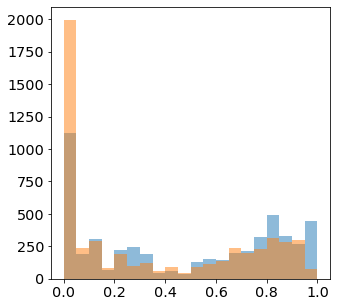

In [22]:
plt.hist([max([i/j for i,j in t.ratio_in_study]) if t is not None else 0 for t in ranked_goa_results], alpha=0.5,bins=20)
plt.hist([max([i/j for i,j in t.ratio_in_study]) if t is not None else 0 for t in rwr_ranked_goa_results],alpha=0.5,bins=20)

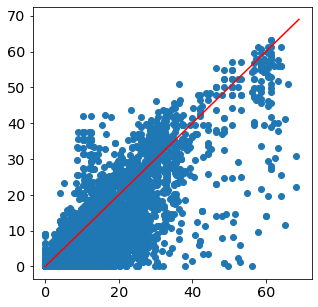

In [404]:
plt.scatter([-np.log10(t.p_fdr_bh[0]) if t is not None else 0 for t in ranked_goa_results],
           [-np.log10(t.p_fdr_bh[0]) if t is not None else 0 for t in rwr_ranked_goa_results])
plt.plot(np.arange(0,70,1),np.arange(0,70,1),'red')
#plt.axvline(-np.log10(.1))

In [415]:
prs_logp = [-np.log10(t.p_fdr_bh[0]) if t is not None else 0 for t in ranked_goa_results]
rwr_logp = [-np.log10(t.p_fdr_bh[0]) if t is not None else 0 for t in rwr_ranked_goa_results]

In [484]:
pval_comparison_prs_lg = [prs_logp[i] > rwr_logp[i] for i in range(5183)]
pval_comparison_prs_sm = [prs_logp[i] < rwr_logp[i] for i in range(5183)]
pval_comparison_prs_eq = [prs_logp[i] == rwr_logp[i] for i in range(5183)]

Text(0, 0.5, '$-log(p)_{RWR}$')

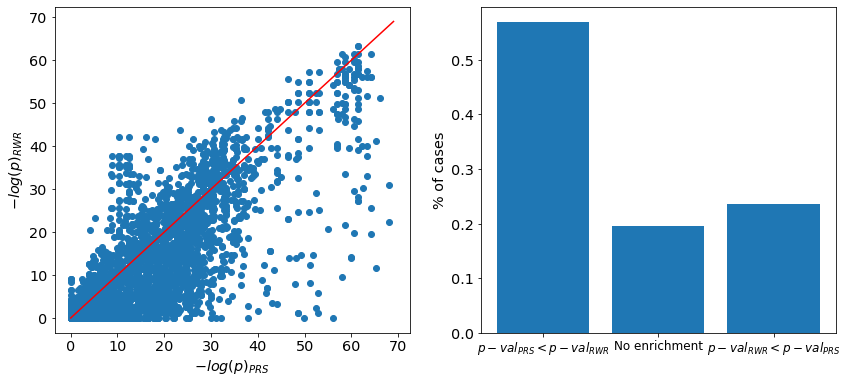

In [512]:
fig,ax = plt.subplots(1,2,figsize=(14,6))
ax[1].bar([1,2,3],[sum(pval_comparison_prs_lg)/5183,sum(pval_comparison_prs_eq)/5183,sum(pval_comparison_prs_sm)/5183],
       tick_label=[r'$p-val_{PRS}<p-val_{RWR}$','No enrichment',r'${p-val}_{RWR}<p-val_{PRS}$'])
ax[1].set_ylabel('% of cases')
ax[1].tick_params(axis='x',labelsize=12)
ax[0].scatter([-np.log10(t.p_fdr_bh[0]) if t is not None else 0 for t in ranked_goa_results],
           [-np.log10(t.p_fdr_bh[0]) if t is not None else 0 for t in rwr_ranked_goa_results])
ax[0].plot(np.arange(0,70,1),np.arange(0,70,1),'red')
ax[0].set_xlabel(r'$-log(p)_{PRS}$')
ax[0].set_ylabel(r'$-log(p)_{RWR}$')
plt.savefig('reports/figures/paper_figures_1213_pcc_only/fig6.png',)

In [24]:
e_pcc.get_prs(no_diag=False)

@> Calculating covariance matrix
@> Covariance matrix calculated in 0.0s.
@> Calculating perturbation response
@> Perturbation response matrix calculated in 0.2s.
@> Perturbation response scanning completed in 1.2s.


In [67]:
e_pcc.prs_mat_df[i].sort_values(ascending=False).to_dict().items()

dict_items([('ypl114w', 1.0), ('yor365c', 0.9996901716111258), ('pho87', 0.9953021799190103), ('ath1', 0.09894172095133004), ('ydl211c', 0.06910648938733656), ('grx1', 0.06459211205438545), ('scd6', 0.061288902991965835), ('dls1', 0.04882478595398334), ('cop1-1', 0.008692770720790938), ('gab1-1', 0.007563763891771142), ('gpi16-5001', 0.007418815020673039), ('ost3', 0.007293399154033709), ('cog5', 0.00716597923900251), ('wbp1-1', 0.006855416926043186), ('cog6', 0.0065686733821972015), ('wbp1-2', 0.006467987754691193), ('kre5-ts2', 0.00638402785997166), ('cog8', 0.006329087301461), ('yjl064w', 0.0062865749652723625), ('ypt1-3', 0.006202596535960622), ('las21', 0.005996959838149562), ('arl3', 0.005895513844941805), ('vti1-2', 0.005796065481141655), ('erv14', 0.005774036957691719), ('sys1', 0.005710229031790179), ('arl1', 0.005704538411875519), ('gpi17-5001', 0.005692657009901583), ('gab1-3', 0.0055360111116851555), ('gpi8-5001', 0.005519050010080428), ('csm3', 0.005512425152106931), ('mrc

In [69]:
len([i  for i , j in e_pcc.prs_mat_df[i].sort_values(ascending=False).to_dict().items() if j>0.0001])

1699

In [98]:
groups_with_eff_and_sens = {}
for i in e_pcc.nodes:
    highest_response=e_pcc.rwr_mat_df[i].sort_values(ascending=False)[:50].index
    l_eff =    [i for i in highest_response if i in effector_pcc.orf_name.tolist()]
    l_sens = [i for i in highest_response if i in sensors_pcc.orf_name.tolist()]
    if len(l_eff)>0 and len(l_sens)>0:
        groups_with_eff_and_sens[i]=highest_response

In [101]:
groups_with_eff_and_sens.keys()

dict_keys(['oar1', 'atp14', 'hap2', 'mrpl17-supp1', 'etr1', 'htd2', 'lip2', 'lip5', 'lpd1', 'mct1', 'mob2-11', 'rts1', 'mrpl10-supp1', 'cdc50', 'gap1', 'tda3', 'mob2-14', 'mob2-28', 'mob2-34', 'mob2-40'])

In [106]:
start_node = 'oar1'
highest_50 = groups_with_eff_and_sens[start_node]
highest_50

Index(['oar1', 'mct1', 'lip5', 'etr1', 'lpd1', 'htd2', 'lpd1-supp1', 'aim22',
       'lip2', 'cem1', 'kgd2', 'leu5', 'hfa1', 'pda1', 'pdb1', 'gcv3',
       'tom20-5009', 'abf1-102-supp1', 'ydr274c', 'hom3', 'pdx1', 'ppt2',
       'lat1', 'kgd1', 'ydr157w', 'hom2', 'ser2', 'ser1', 'atg3', 'yhr180w',
       'pot1', 'ydr455c', 'pet8', 'hom6', 'thr4', 'ixr1', 'ygl042c', 'met6',
       'bap2', 'snx3', 'msb4', 'tom70', 'ino80-5002', 'cce1', 'rpl17b',
       'rpl40b', 'tma10', 'def1', 'gep5', 'mrt4'],
      dtype='object')

In [107]:
fig, ax = plt.subplots(figsize=(10,10))
legend_elements = [Line2D([0], [0], marker='o', color='black', label='Genes',
                              markerfacecolor='black', markersize=10, linestyle="None"),
                   Line2D([0], [0], marker='o', color='#bdd7e7', label='Effectors (Respiration)',
                              markerfacecolor='#bdd7e7', markersize=10, linestyle="None"),
                   Line2D([0], [0], marker='o', color='#3182bd', label='Effectors (Chromosome Segragation)',
                              markerfacecolor='#3182bd', markersize=10, linestyle="None"),
                   Line2D([0], [0], marker='o', color='#08519c', label='Effectors (Golgi vesicle transport)',
                              markerfacecolor='#08519c', markersize=10, linestyle="None"),
                   Line2D([0], [0], marker='o', color='red', label='Sensors',
                              markerfacecolor='red', markersize=10, linestyle="None"),
                       Line2D([0], [0], marker='o', color='black', label= 'High functional similarity',
                              markerfacecolor='black', markersize=0, linestyle="-"),
                   Line2D([0], [0], marker='o', color='#018571', label= 'Edges on the\nEffector to Sensor\nPath',
                              markerfacecolor='#018571', markersize=0, linestyle="-"),
                   Line2D([0], [0], marker='o', color='#a6611a', label= 'Effector-Effector edges',
                              markerfacecolor='#a6611a', markersize=0, linestyle="-")
                       ]
e_pcc.plot_network_spring(ax=ax,
                         # node_size = [1000*i for i in e_pcc.prs_mat_df.loc['cog8',[i for i in e_pcc.graph_gc.nodes]].tolist()],
                         #node_size = [100 if i in sensors_pcc.orf_name.values or i in effector_pcc.orf_name.values else 1 for i in e_pcc.nodes],edge_color='black',
                         node_color = ['red' if i == start_node else 
                                       '#bdd7e7' if i in highest_50 else 
                                       #'#3182bd' if i in effector_pcc.loc[effector_pcc.go_group=='chromatin'].orf_name.values else 
                                       #'#08519c' if i in effector_pcc.loc[effector_pcc.go_group=='golgi'].orf_name.values else 
                                       'black' for i in e_pcc.nodes],
                         node_size = [100 if i == start_node else 
                                       75 if i in highest_50 else 
                                       #'#3182bd' if i in effector_pcc.loc[effector_pcc.go_group=='chromatin'].orf_name.values else 
                                       #'#08519c' if i in effector_pcc.loc[effector_pcc.go_group=='golgi'].orf_name.values else 
                                       1 for i in e_pcc.nodes])
nx.draw_networkx(nx.induced_subgraph(e_pcc.graph_gc, highest_50), ax=ax,width=5, pos=pos, node_color='white',with_labels=False, edgecolors='black',node_size= 2)
#for i in list(set([ item for sublist in edges for item in sublist])):
#nx.draw_networkx_edges(e_pcc.graph_gc, ax=ax, edgelist=list(set([ item for sublist in edges for item in sublist])) , pos=pos, edge_color='#018571',alpha=0.5, width = 2)
#nx.draw_networkx_edges(e_pcc.graph_gc, ax=ax , edgelist=effector_pcc.orf_name.tolist(), pos=pos, edge_color='#018571',alpha=0.5, width = 2)

ax.set_facecolor('white')
ax.set_axis_off()
#lgd = ax.legend(handles=legend_elements, fontsize=18,loc='center left', bbox_to_anchor=(1.1, 0.5))

#nx.draw_networkx_edges(nx.induced_subgraph(e_pcc.graph_gc,effector_pcc.orf_name.tolist()), ax=ax , pos=pos, edge_color='blue')
#nx.draw(sub,pos=pos,
#       node_color = ['red'  if i ==target else 'blue' if i==source  else 'black' for i in sub.nodes])# nx.draw_networkx_nodes(e_pcc.graph_gc    , pos=pos,
# node_size = [1000*i for i in prs_mat_df.loc['cox12',[i for i in e_pcc.graph_gc.nodes]].tolist()],
#        node_color = ['red' if i =='cox12' else 'blue' for i in e_pcc.graph_gc.nodes])
#plt.savefig('tmp_nw.png',bbox_inches='tight')

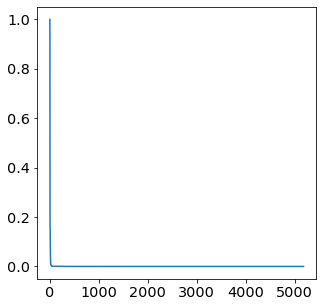

In [109]:
plt.plot(sorted(e_pcc.prs_mat_df.loc[start_node,:].tolist(),reverse=True))

In [111]:
sorted(e_pcc.prs_mat_df.loc[start_node,:].tolist(),reverse=True)

[1.0,
 0.20515430875295088,
 0.2051543087529501,
 0.1724178769037563,
 0.16791208634879867,
 0.16077663335096498,
 0.14975694815527457,
 0.11981279298818091,
 0.09542043102999677,
 0.08467337995966609,
 0.05366400245406386,
 0.04935206738311961,
 0.036588883774650624,
 0.02659509144202651,
 0.026410037366730598,
 0.012556514896569336,
 0.010839804655647966,
 0.010826504680936492,
 0.010545309959694167,
 0.006179338761453057,
 0.006114667723484684,
 0.005010156899942893,
 0.005010156899942885,
 0.005010156899942885,
 0.004909052748006514,
 0.004594815838861724,
 0.004215925651943433,
 0.003962012342715169,
 0.0036115859590738824,
 0.00361158595907386,
 0.0034424562912121906,
 0.003442456291212162,
 0.003216225217728661,
 0.002740309425312513,
 0.002676369796241075,
 0.0024318945580496533,
 0.0023765545771251718,
 0.0023115908281774716,
 0.0022226191295887992,
 0.0021850559504300424,
 0.002176687454713958,
 0.0020632358810775235,
 0.0011967468244588404,
 0.0011548385743135393,
 0.0006995

In [58]:
e_pcc.get_rwr_mat()

Residual at 6-iter: 2.130611e-01:   6%|▌         | 6/100 [00:00<00:00, 1737.73it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 28-iter: 9.301345e-05:  28%|██▊       | 28/100 [00:00<00:00, 1401.86it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 38-iter: 1.494147e-05:  38%|███▊      | 38/100 [00:00<00:00, 1868.72it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the clie

Residual at 34-iter: 4.874187e-05:  34%|███▍      | 34/100 [00:00<00:00, 1861.68it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 27-iter: 2.115193e-04:  27%|██▋       | 27/100 [00:00<00:00, 1669.98it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 40-iter: 1.245299e-05:  40%|████      | 40/100 [00:00<00:00, 1254.50it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the cl

Residual at 45-iter: 3.997045e-06:  45%|████▌     | 45/100 [00:00<00:00, 1794.74it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 42-iter: 1.304337e-05:  42%|████▏     | 42/100 [00:00<00:00, 1844.42it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Residual at 46-iter: 5.146271e-06:  46%|████▌     | 46/100 [00:00<00:00, 1149.53it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 30-iter: 9.273078e-05:  30%|███       | 30/100 [00:00<00:00, 1932.86it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 13-iter: 6.434490e-03:  13%|█▎        | 13/100 [00:00<00:00, 1678.29it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the cl

The iteration has converged at 55-iter:  55%|█████▌    | 55/100 [00:00<00:00, 1667.08it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 34-iter: 5.732673e-05:  34%|███▍      | 34/100 [00:00<00:00, 1433.14it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 3-iter: 5.239938e-01:   3%|▎         | 3/100 [00:00<00:00, 1482.44it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the

Residual at 7-iter: 3.341432e-02:   7%|▋         | 7/100 [00:00<00:00, 1689.50it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 27-iter: 2.337891e-04:  27%|██▋       | 27/100 [00:00<00:00, 1487.11it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Residual at 2-iter: 9.111607e-01:   2%|▏         | 2/100 [00:00<00:00, 1041.67it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 9-iter: 1.805779e-02:   9%|▉         | 9/100 [00:00<00:00, 1804.35it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 29-iter: 1.406172e-04:  29%|██▉       | 29/100 [00:00<00:00, 1427.92it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the clien

Residual at 36-iter: 2.485876e-05:  36%|███▌      | 36/100 [00:00<00:00, 1977.31it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 51-iter: 1.344348e-06:  51%|█████     | 51/100 [00:00<00:00, 1691.63it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 24-iter: 3.930637e-04:  24%|██▍       | 24/100 [00:00<00:00, 1869.43it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the cl

Residual at 47-iter: 2.572677e-06:  47%|████▋     | 47/100 [00:00<00:00, 1953.72it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 26-iter: 2.075126e-04:  26%|██▌       | 26/100 [00:00<00:00, 1588.80it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Residual at 6-iter: 3.439914e-02:   6%|▌         | 6/100 [00:00<00:00, 1595.60it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 35-iter: 3.727863e-05:  35%|███▌      | 35/100 [00:00<00:00, 1920.44it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 32-iter: 7.695229e-05:  32%|███▏      | 32/100 [00:00<00:00, 1894.74it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the clie

Residual at 0-iter: 1.700000e+00:   0%|          | 0/100 [00:00<?, ?it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 28-iter: 1.947666e-04:  28%|██▊       | 28/100 [00:00<00:00, 1545.64it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 0-iter: 1.700000e+00:   0%|          | 0/100 [00:00<?, ?it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid c

Residual at 11-iter: 1.045552e-02:  11%|█         | 11/100 [00:00<00:00, 1824.91it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 33-iter: 4.709196e-05:  33%|███▎      | 33/100 [00:00<00:00, 1890.13it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 18-iter: 1.580863e-03:  18%|█▊        | 18/100 [00:00<00:00, 991.30it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the cli

Residual at 48-iter: 1.638739e-06:  48%|████▊     | 48/100 [00:00<00:00, 1809.76it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 25-iter: 3.056767e-04:  25%|██▌       | 25/100 [00:00<00:00, 1918.75it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 28-iter: 1.620810e-04:  28%|██▊       | 28/100 [00:00<00:00, 1339.13it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the cl

Residual at 30-iter: 1.815256e-04:  30%|███       | 30/100 [00:00<00:00, 2020.64it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 31-iter: 7.805407e-05:  31%|███       | 31/100 [00:00<00:00, 1978.11it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 10-iter: 1.366364e-02:  10%|█         | 10/100 [00:00<00:00, 1879.25it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the cl

Residual at 19-iter: 1.136242e-03:  19%|█▉        | 19/100 [00:00<00:00, 2006.19it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 53-iter: 1.325147e-06:  53%|█████▎    | 53/100 [00:00<00:00, 1192.48it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

  0%|          | 0/100 [00:00<?, ?it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change 

Residual at 50-iter: 2.295239e-06:  50%|█████     | 50/100 [00:00<00:00, 1972.58it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 27-iter: 2.568601e-04:  27%|██▋       | 27/100 [00:00<00:00, 1876.83it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 27-iter: 1.773531e-04:  27%|██▋       | 27/100 [00:00<00:00, 1254.14it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the cl

Residual at 13-iter: 5.879754e-03:  13%|█▎        | 13/100 [00:00<00:00, 1225.63it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 10-iter: 3.819867e-02:  10%|█         | 10/100 [00:00<00:00, 1415.18it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 21-iter: 7.942189e-04:  21%|██        | 21/100 [00:00<00:00, 1951.10it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the cl

Residual at 50-iter: 1.702632e-06:  50%|█████     | 50/100 [00:00<00:00, 1945.63it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 2-iter: 1.024963e+00:   2%|▏         | 2/100 [00:00<00:00, 1495.83it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

The iteration has converged at 49-iter:  49%|████▉     | 49/100 [00:00<00:00, 1891.83it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the

Residual at 9-iter: 2.292889e-02:   9%|▉         | 9/100 [00:00<00:00, 1973.38it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 40-iter: 9.900560e-06:  40%|████      | 40/100 [00:00<00:00, 1784.83it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 26-iter: 2.487404e-04:  26%|██▌       | 26/100 [00:00<00:00, 1863.66it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the clie

Residual at 20-iter: 1.253208e-03:  20%|██        | 20/100 [00:00<00:00, 1852.81it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Residual at 30-iter: 1.754561e-04:  30%|███       | 30/100 [00:00<00:00, 1873.68it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

The iteration has converged at 54-iter:  54%|█████▍    | 54/100 [00:00<00:00, 1841.79it/s]


In [83]:
from collections import Counter, OrderedDict
rwr_counter = Counter([rwr_ranked_goa_results[i].name[0] for i in range(5183) if rwr_ranked_goa_results[i] is not None])
rwr_counter_ordered = OrderedDict(rwr_counter.most_common())

In [92]:

prs_counter = Counter([ranked_goa_results[i].name[0] for i in range(5183) if ranked_goa_results[i] is not None])
prs_counter_ordered = OrderedDict(prs_counter.most_common())




In [94]:
len(np.setdiff1d([i for i in rwr_counter_ordered.keys() ],[i for i in prs_counter_ordered.keys() ]))

158

In [95]:
len(np.setdiff1d([i for i in prs_counter_ordered.keys() ],[i for i in rwr_counter_ordered.keys()]))

42